In [462]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import matplotlib.dates as mdates
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
#yesterday1 = date.today() - timedelta(days=3)
d12f = lambda x:(date.today() - timedelta(days=x)).strftime("%Y-%m-%d")

countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

235


In [463]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [464]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [560]:
def forecastRRA(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    acoef = [0.00022402, 0.01432195]
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  (coeffs[0]*coeffs[1]*np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2]))/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]))/((acoef[0]*t+acoef[1]))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    dateSP = pd.to_datetime(dfSP['date'].values)
    dtt = pd.date_range(dateSP[0], periods=len(waveform_1)+period)
    ax2.plot(dateSP[t+8], waveform_1, dtt, allmodel, dtt, allmodel_1) 
    ax2.plot(dateSP[t[-1]+8],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.set_ylim([0,1.1*max(max(waveform_1),max(allmodel*(1+3*diffStd0)))])
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
    #formatter = mdates.ConciseDateFormatter(locator)
    locator = mdates.AutoDateLocator()
    formatter = mdates.ConciseDateFormatter(locator)
    formatter.formats = ['%y',  # ticks are mostly years
                         '%b',       # ticks are mostly months
                         '%d',       # ticks are mostly days
                         '%H:%M',    # hrs
                         '%H:%M',    # min
                         '%S.%f', ]  # secs
    # these are mostly just the level above...
    formatter.zero_formats = [''] + formatter.formats[:-1]
    # ...except for ticks that are mostly hours, then it is nice to have
    # month-day:
    formatter.zero_formats[3] = '%d-%b'

    formatter.offset_formats = ['',
                                '%Y',
                                '%b %Y',
                                '%d %b %Y',
                                '%d %b %Y',
                                '%d %b %Y %H:%M', ]
    ax2.xaxis.set_major_locator(locator)
    ax2.xaxis.set_major_formatter(formatter)
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_RA.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_RA.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x, t[-1],tt+8,allmodel 

def forecast2RRA(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a) 
    acoef = [0.00022485, 0.01425859]#[0.00022468, 0.01427208]
    def model(t, coeffs):
        coeffsUS=coeffs2#[5.34712379e+04,  1.87189938e+01, -9.10329896e+01,  2.63753359e-03]
        return  (coeffs[0]*coeffs[1]*np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2]))/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+model0(t, coeffsUS))/(acoef[0]*t+acoef[1])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  (coeffs[0]*coeffs[1]*np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2]))/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]))/(acoef[0]*t+acoef[1])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    #x0 = np.array([5.86900283e+04, 2.15711530e+01, -9.80541238e+01,  2.21893275e-03], dtype=float)
    x0 = np.array([5.40599372e+03, 4.02558326e+00, 9.34289930e+01, 9.87224726e-01], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
        
    dateSP = pd.to_datetime(dfSP['date'].values)
    dtt = pd.date_range(dateSP[0], periods=len(waveform_1)+period)
    ax2.plot(dateSP[t+8], waveform_1, dtt, allmodel,dtt, allmodel_1)
    ax2.plot(dateSP[t[-1]+8],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, date')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter = mdates.ConciseDateFormatter(locator)
    ax2.xaxis.set_major_locator(locator)
    ax2.xaxis.set_major_formatter(formatter)
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_RA.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_RA.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x, t+8,allmodel 

def forecast2RRD(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases',amc=1.0):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    dateSP = pd.to_datetime(dfSP['date'].values)
    dtt = pd.date_range(dateSP[0], periods=len(waveform_1)+period)
    dtt = pd.to_datetime(dtt.values)
    #years = mdates.YearLocator()   # every year
    #months = mdates.MonthLocator()  # every month
    #years_fmt = mdates.DateFormatter('%Y')
    # format the ticks
    #ax2.xaxis.set_major_locator(years)
    #ax2.xaxis.set_major_formatter(years_fmt)
    #ax2.xaxis.set_minor_locator(months)
    #ax2.format_xdata = mdates.DateFormatter('%Y-%m-%d')
    ax2.plot(dateSP[t[:]+8], waveform_1,dtt, allmodel,dtt, allmodel_1)
    #print (dtt)
    #print (dateSP)
    #print (dateSP[t+8])
    ax2.plot(dateSP[t[-1]+8],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, date')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
#    locator = mdates.AutoDateLocator()
#    formatter = mdates.ConciseDateFormatter(locator)
#    formatter.formats = ['%y',  # ticks are mostly years
#                         '%b',       # ticks are mostly months
#                         '%d',       # ticks are mostly days
#                         '%H:%M',    # hrs
#                         '%H:%M',    # min
#                         '%S.%f', ]  # secs
#    # these are mostly just the level above...
#    formatter.zero_formats = [''] + formatter.formats[:-1]
#    # ...except for ticks that are mostly hours, then it is nice to have
#    # month-day:
#    formatter.zero_formats[3] = '%d-%b'
#
#    formatter.offset_formats = ['',
#                                '%Y',
#                                '%b %Y',
#                                '%d %b %Y',
#                                '%d %b %Y',
#                                '%d %b %Y %H:%M', ]
    locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter = mdates.ConciseDateFormatter(locator)
    ax2.xaxis.set_major_locator(locator)
    ax2.xaxis.set_major_formatter(formatter)
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(dateSP[t[:-1]+8], np.diff(waveform_1),dtt[:-1], np.diff(allmodel))
    ax3.plot(dateSP[t[-1]+8], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(dtt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(dtt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(dtt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    locator3 = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter3 = mdates.ConciseDateFormatter(locator3)
    ax3.xaxis.set_major_locator(locator3)
    ax3.xaxis.set_major_formatter(formatter3)
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, date')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    #z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ds = 35
    ds = int(ds*amc)
    ttt20=np.array([np.sum(np.diff(allmodel[-ds+i:i])) for i in range(ds,len(allmodel))])
    ttt19=np.array([np.sum(np.diff(allmodel_1[-ds+i:i])) for i in range(ds,len(allmodel_1))])
    ax4.plot(dateSP[t[:]+8], dfSP["active"][:],dtt[ds:], ttt20,dtt[ds:], ttt19)
    #ax4.plot(dateSP[t[:-3]+8],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    #ax4.fill_between(dateSP[t[:-1]+8], 0.8078285535018691, 1.,color='r',alpha=0.2)
    diffStd0a = np.std(1-dfSP["active"].values[ds:]/ttt20[:len(dfSP["active"].values[ds:])])
    print ('diffStd0a',diffStd0a)
    ax4.fill_between(dtt[ds:], ttt20*(1-diffStd0a), ttt20*(1+diffStd0a), alpha=0.2)
    ax4.fill_between(dtt[ds:], ttt20*(1-diffStd0a), ttt20*(1+2*diffStd0a), alpha=0.2)
    ax4.fill_between(dtt[ds:], ttt20*(1-diffStd0a), ttt20*(1+3*diffStd0a), alpha=0.2)
    ax4.plot(dateSP[t[-1]+8],dfSP["active"].tail(1).values[0],'ro')
    loc = 'upper left'
    if Cntr=='USA' or Cntr=='Indonesia' or Cntr=='World':
        loc = 'upper right' 
    ax4.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc=loc) 
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('Total actives')
    ax4.set_xlabel('t, days')
    ax4.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    ax4.yaxis.tick_right()
    ax4.set_ylim([0,max(max(dfSP['active'].values),max(ttt20*(1+3*diffStd0a)))])
    locator4 = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter4 = mdates.ConciseDateFormatter(locator4)
    ax4.xaxis.set_major_locator(locator4)
    ax4.xaxis.set_major_formatter(formatter4)
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(dateSP[xt],yt,label=Cntr1)
    ax5.plot(dtt[range(x_pred12t)],y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(dtt[range(x_pred12t0)],y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(dateSP[vL], color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    locator5 = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter5 = mdates.ConciseDateFormatter(locator5)
    ax5.xaxis.set_major_locator(locator5)
    ax5.xaxis.set_major_formatter(formatter5)
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = "actives k: %d"%(ds)
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRDA(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases',amc=1.0):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    dateSP = pd.to_datetime(dfSP['date'].values)
    dtt = pd.date_range(dateSP[0], periods=len(waveform_1)+period)
    dtt = pd.to_datetime(dtt.values)
    #years = mdates.YearLocator()   # every year
    #months = mdates.MonthLocator()  # every month
    #years_fmt = mdates.DateFormatter('%Y')
    # format the ticks
    #ax2.xaxis.set_major_locator(years)
    #ax2.xaxis.set_major_formatter(years_fmt)
    #ax2.xaxis.set_minor_locator(months)
    #ax2.format_xdata = mdates.DateFormatter('%Y-%m-%d')
    ax2.plot(dateSP[t[:]+8], waveform_1,dtt, allmodel,dtt, allmodel_1)
    #print (dtt)
    #print (dateSP)
    #print (dateSP[t+8])
    ax2.plot(dateSP[t[-1]+8],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, date')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
#    locator = mdates.AutoDateLocator()
#    formatter = mdates.ConciseDateFormatter(locator)
#    formatter.formats = ['%y',  # ticks are mostly years
#                         '%b',       # ticks are mostly months
#                         '%d',       # ticks are mostly days
#                         '%H:%M',    # hrs
#                         '%H:%M',    # min
#                         '%S.%f', ]  # secs
#    # these are mostly just the level above...
#    formatter.zero_formats = [''] + formatter.formats[:-1]
#    # ...except for ticks that are mostly hours, then it is nice to have
#    # month-day:
#    formatter.zero_formats[3] = '%d-%b'
#
#    formatter.offset_formats = ['',
#                                '%Y',
#                                '%b %Y',
#                                '%d %b %Y',
#                                '%d %b %Y',
#                                '%d %b %Y %H:%M', ]
    locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter = mdates.ConciseDateFormatter(locator)
    ax2.xaxis.set_major_locator(locator)
    ax2.xaxis.set_major_formatter(formatter)
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(dateSP[t[:-1]+8], np.diff(waveform_1),dtt[:-1], np.diff(allmodel))
    ax3.plot(dateSP[t[-1]+8], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(dtt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(dtt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(dtt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    locator3 = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter3 = mdates.ConciseDateFormatter(locator3)
    ax3.xaxis.set_major_locator(locator3)
    ax3.xaxis.set_major_formatter(formatter3)
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, date')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    #z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ds = 35
    ds = int(ds*amc)
    ttt20=np.array([np.sum(np.diff(allmodel[-ds+i:i])) for i in range(ds,len(allmodel))])
    ttt19=np.array([np.sum(np.diff(allmodel_1[-ds+i:i])) for i in range(ds,len(allmodel_1))])
    ax4.plot(dateSP[t[:]+8], dfSP["active"][:],dtt[ds:], ttt20,dtt[ds:], ttt19)
    #ax4.plot(dateSP[t[:-3]+8],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    #ax4.fill_between(dateSP[t[:-1]+8], 0.8078285535018691, 1.,color='r',alpha=0.2)
    diffStd0a = np.std(1-dfSP["active"].values[ds:]/ttt20[:len(dfSP["active"].values[ds:])])
    print ('diffStd0a',diffStd0a)
    ax4.fill_between(dtt[ds:], ttt20*(1-diffStd0a), ttt20*(1+diffStd0a), alpha=0.2)
    ax4.fill_between(dtt[ds:], ttt20*(1-diffStd0a), ttt20*(1+2*diffStd0a), alpha=0.2)
    ax4.fill_between(dtt[ds:], ttt20*(1-diffStd0a), ttt20*(1+3*diffStd0a), alpha=0.2)
    ax4.plot(dateSP[t[-1]+8],dfSP["active"].tail(1).values[0],'ro')
    loc = 'upper left'
    if Cntr=='USA' or Cntr=='Indonesia' or Cntr=='World':
        loc = 'upper right' 
    ax4.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc=loc) 
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('Total actives')
    ax4.set_xlabel('t, days')
    ax4.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    ax4.yaxis.tick_right()
    ax4.set_ylim([0,max(max(dfSP['active'].values),max(ttt20*(1+3*diffStd0a)))])
    locator4 = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter4 = mdates.ConciseDateFormatter(locator4)
    ax4.xaxis.set_major_locator(locator4)
    ax4.xaxis.set_major_formatter(formatter4)
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(dateSP[xt],yt,label=Cntr1)
    ax5.plot(dtt[range(x_pred12t)],y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(dtt[range(x_pred12t0)],y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(dateSP[vL], color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    locator5 = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter5 = mdates.ConciseDateFormatter(locator5)
    ax5.xaxis.set_major_locator(locator5)
    ax5.xaxis.set_major_formatter(formatter5)
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x, t[:]+8, dtt[ds:], ttt20, diffStd0a


In [487]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly\nChange,Net\nChange,Density\n(P/Km²),Land Area\n(Km²),Migrants\n(net),Fert.\nRate,Med.\nAge,Urban\nPop %,World\nShare
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [488]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [489]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [490]:
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,13943144,3959.0,383096.0,506.0,8730177.0,"+4,096",4829871,26194.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,15378465,17810.0,271395.0,260.0,13809192.0,"+19,149",1297878,25136.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,10504498,96.0,313513.0,9.0,9498954.0,544,692031,17363.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,14723139,47075.0,338335.0,998.0,5633186.0,"+46,778",8751618,30140.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,2027128,541.0,48518.0,9.0,1709945.0,666,268665,2573.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [491]:
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
230,NaN,Total:,14723139,47075.0,338335.0,998.0,5633186.0,"+46,778",8751618,30140.0,NaN,NaN,NaN,NaN,NaN,Europe,,NaN,NaN
231,NaN,Total:,2027128,541.0,48518.0,9.0,1709945.0,666,268665,2573.0,NaN,NaN,NaN,NaN,NaN,Africa,,NaN,NaN
232,NaN,Total:,43075,11.0,1003.0,NaN,32951.0,NaN,9121,24.0,NaN,NaN,NaN,NaN,NaN,Australia/Oceania,,NaN,NaN
233,NaN,Total:,721,NaN,15.0,NaN,659.0,NaN,47,4.0,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,NaN
234,NaN,European Union,9879897,10108.0,226822.0,278.0,2835082.0,NaN,4674526,25034.0,22189.524075,509.425577,138308502.0,310630.752018,NaN,Europe,NaN,NaN,NaN


In [492]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,13943144,3959.0,383096.0,506.0,8730177.0,"+4,096",4829871,26194.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,15378465,17810.0,271395.0,260.0,13809192.0,"+19,149",1297878,25136.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,10504498,96.0,313513.0,9.0,9498954.0,544,692031,17363.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,14723139,47075.0,338335.0,998.0,5633186.0,"+46,778",8751618,30140.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,2027128,541.0,48518.0,9.0,1709945.0,666,268665,2573.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [493]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
93,87.0,Lithuania,38810,0.0,323.0,0.0,9362.0,0,29125,107.0,14335.0,119.0,1212239.0,447749.0,"2,707,410",Europe,70,"8,382",2


No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:816: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


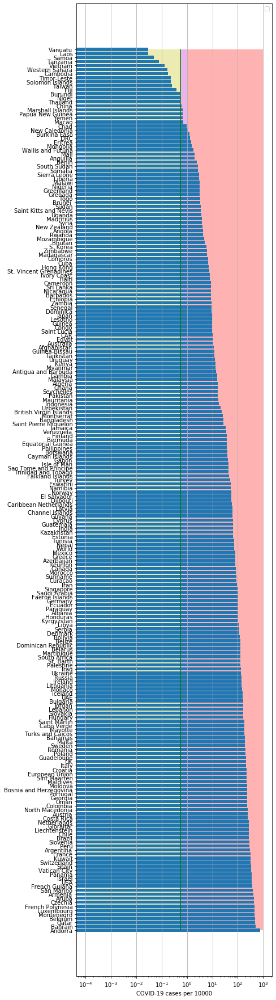

In [494]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:816: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


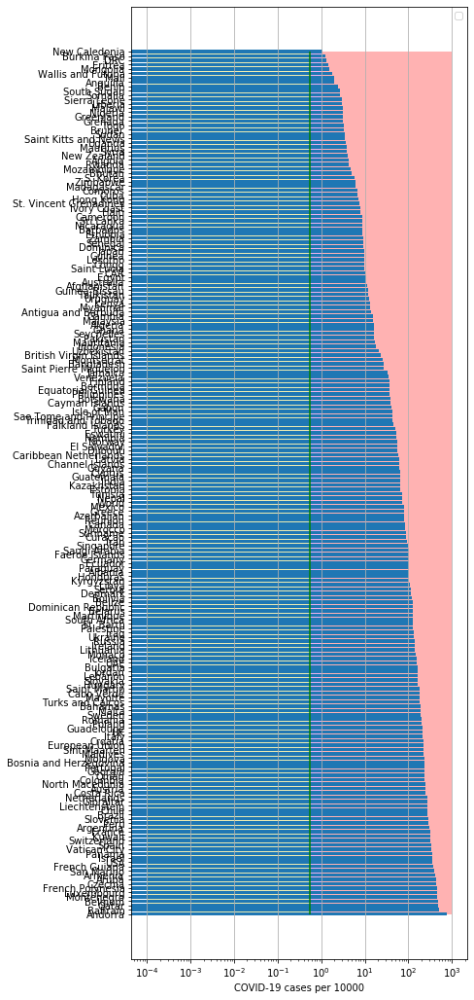

In [495]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

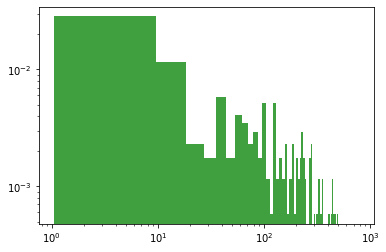

In [496]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [497]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date    cases  active    death
273 2020-11-14  1502308       0  40769.0
274 2020-11-15  1512072       0  40769.0
275 2020-11-16  1521899       0  41253.0
276 2020-11-17  1535058       0  41688.0
277 2020-11-18  1542467       0  42039.0
GB
           date    cases  active    death
262 2020-11-14  1344356       0  51766.0
263 2020-11-15  1369318       0  51934.0
264 2020-11-16  1390681       0  52147.0
265 2020-11-17  1410732       0  52745.0
266 2020-11-18  1430341       0  53274.0
IT
           date    cases  active    death
265 2020-11-14  1144552  688435  44683.0
266 2020-11-15  1178529  712490  45229.0
267 2020-11-16  1205881  717784  45733.0
268 2020-11-17  1238072  733810  46464.0
269 2020-11-18  1272352  743168  47217.0
LT
           date    cases  active  death      tests
250 2020-11-14  34758.0   26620  277.0  1183216.0
251 2020-11-15  35911.0   27744  285.0  1187674.0
252 2020-11-16  36876.0   27894  299.0  1200154.0
253 2020-11-17  38810.0   29002  323.0  121223

In [498]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [499]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5968376146717275
intercept: 1.5661605754253434
slope: [0.01675952]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


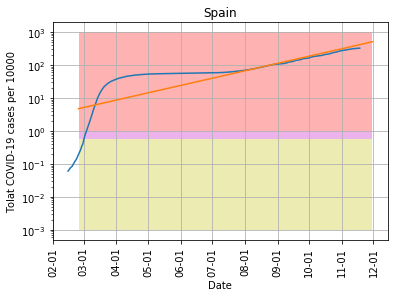

In [500]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-11-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [501]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5663871380996032
intercept: 0.012287236393405454
slope: [0.02259543]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


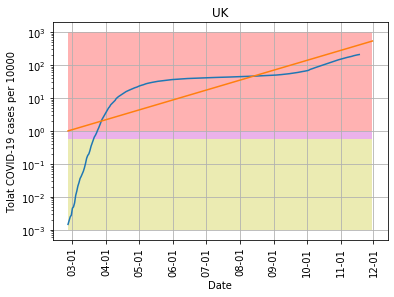

In [502]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-11-30', "pictures/coronaGB.png", model1, 'UK',1000)

In [503]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 7.01378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6694960485741578
intercept: 1.609865286552269
slope: [-0.00346197]


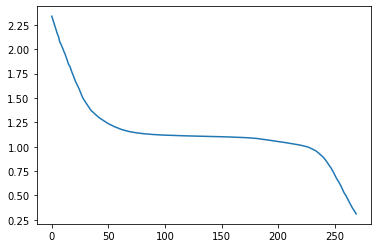

In [504]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


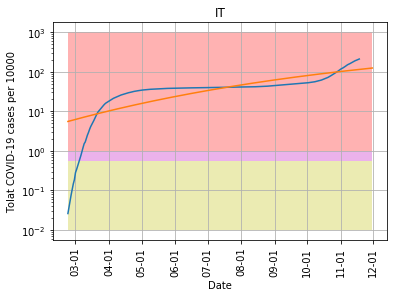

In [505]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-11-30', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [506]:
cs=y_pred11[-1]/10000.*populationIT

In [507]:
cs

751684.6280616624

In [508]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.656882738927691
intercept: -0.13466056571908713
slope: [0.01682634]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


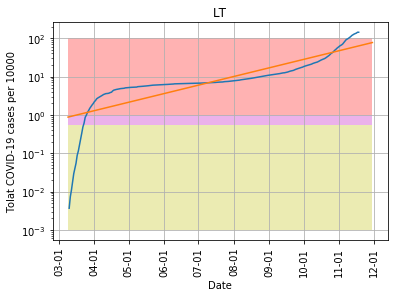

In [509]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-11-30', "pictures/coronaLT.png", model1, 'LT',100)

In [510]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7449233307308832
intercept: -1.9461166443474394
slope: [0.03049058]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


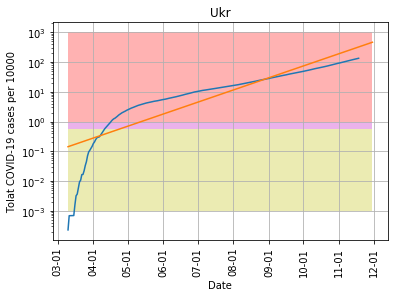

In [511]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-11-30', "pictures/coronaUkr.png", model11, 'Ukr',1000)

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  app.launch_new_instance()


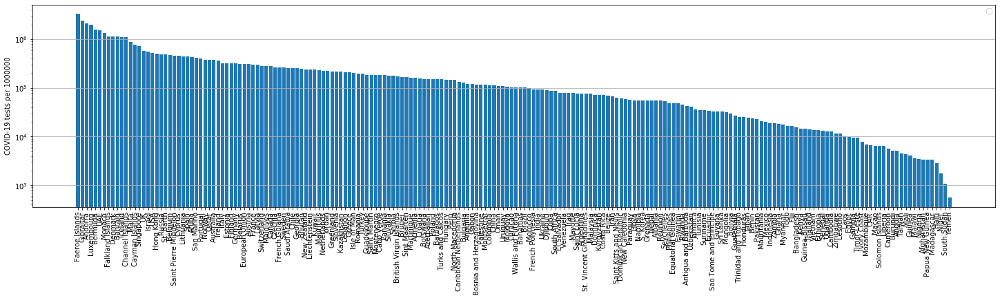

In [512]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [513]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6100828886979166
intercept: 0.5874341402151773
slope: [0.02490094]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


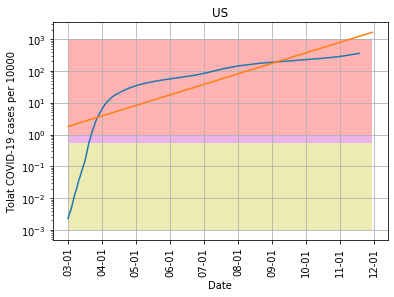

In [514]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-11-30', "pictures/coronaUS.png", model11, 'US',1000)

In [515]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
234  European Union  0.022958


Text(0.5, 1.0, 'Death rate')

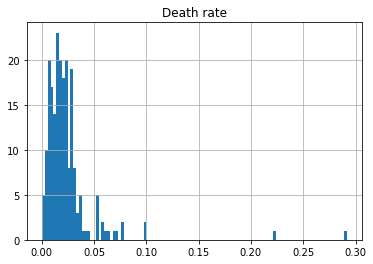

In [516]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
#plt.xlim([0,0.15])

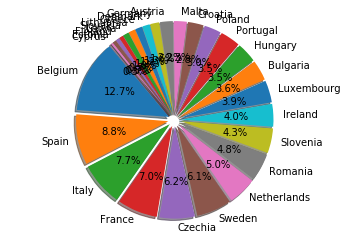

In [517]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [518]:
dfTTh.head()

,Country,Deathsper1Mpop
24,Belgium,1294.0
12,Spain,899.0
15,Italy,781.0
10,France,715.0
28,Czechia,629.0


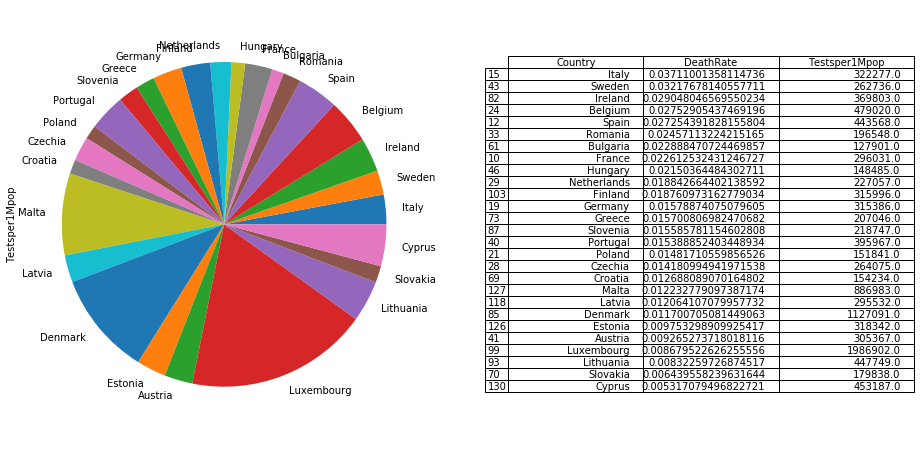

In [519]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
#dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

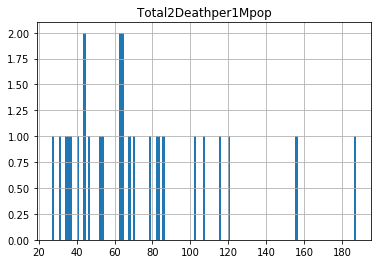

In [520]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [521]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
10,France,31611.0,715.0
12,Spain,32986.0,899.0
15,Italy,21056.0,781.0
19,Germany,10187.0,161.0
21,Poland,20429.0,303.0


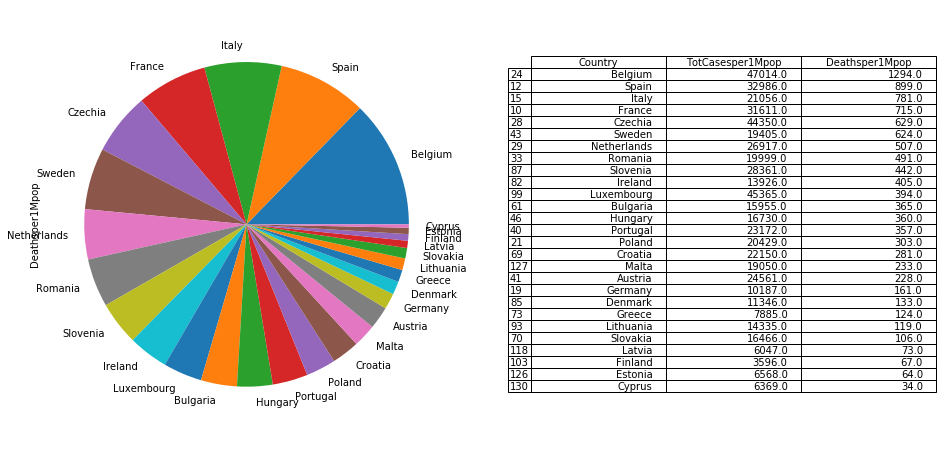

In [522]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [523]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,0.0,North America,13943144,3959.0,383096.0,506.0,8730177.0,"+4,096",4829871,26194.0,0.0,0.0,0.0,0.0,0,North America,\n,0,0
1,0.0,Asia,15378465,17810.0,271395.0,260.0,13809192.0,"+19,149",1297878,25136.0,0.0,0.0,0.0,0.0,0,Asia,\n,0,0
2,0.0,South America,10504498,96.0,313513.0,9.0,9498954.0,544,692031,17363.0,0.0,0.0,0.0,0.0,0,South America,\n,0,0
3,0.0,Europe,14723139,47075.0,338335.0,998.0,5633186.0,"+46,778",8751618,30140.0,0.0,0.0,0.0,0.0,0,Europe,\n,0,0
4,0.0,Africa,2027128,541.0,48518.0,9.0,1709945.0,666,268665,2573.0,0.0,0.0,0.0,0.0,0,Africa,\n,0,0


In [524]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
10,France,0.106783
12,Spain,0.074365
15,Italy,0.065335
19,Germany,0.032300
21,Poland,0.134542


In [525]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
     Czechia             0.167945
     Croatia             0.143613
      Poland             0.134542
    Slovenia             0.129652
    Bulgaria             0.124745
 Netherlands             0.118547
     Hungary             0.112671
      France             0.106783
     Romania             0.101751
     Belgium             0.098146
    Slovakia             0.091560
     Austria             0.080431
       Spain             0.074365
      Sweden             0.073857
       Italy             0.065335
    Portugal             0.058520
      Greece             0.038083
     Ireland             0.037658
     Germany             0.032300
   Lithuania             0.032016
  Luxembourg             0.022832
       Malta             0.021477
     Estonia             0.020632
      Latvia             0.020461
      Cyprus             0.014054
     Finland             0.011380
     Denmark             0.010067


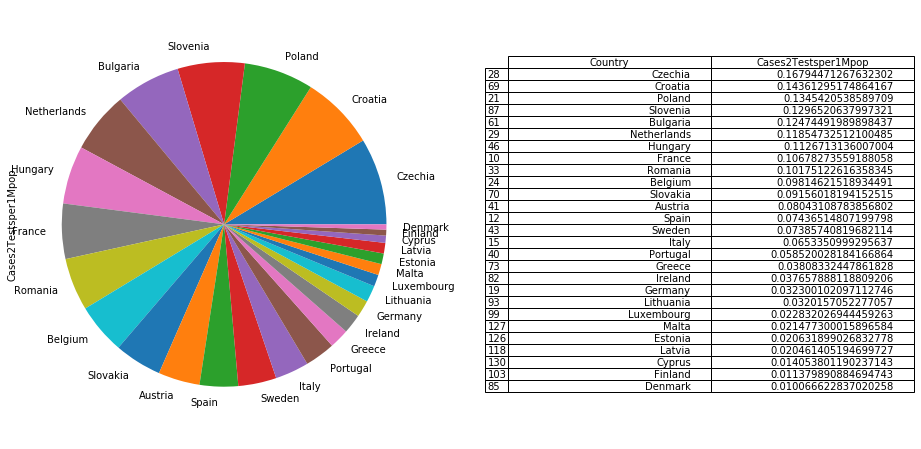

In [526]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [527]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
88,Singapore,0.000482,720498.0
169,Curaçao,0.001350,103699.0
181,Burundi,0.001560,5175.0
51,Qatar,0.001722,378607.0
177,Gibraltar,0.002160,2397097.0
...,...,...,...
109,Sudan,0.078089,0.0
17,Mexico,0.098050,20337.0
219,Western Sahara,0.100000,0.0
220,MS Zaandam,0.222222,0.0


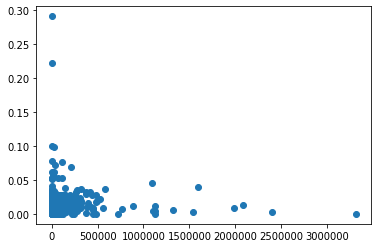

In [528]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

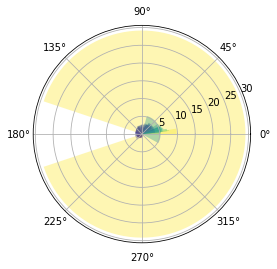

In [540]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 500/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

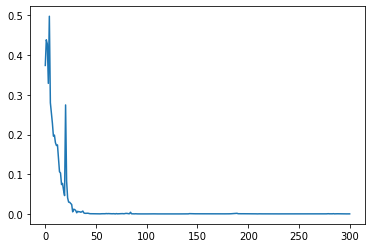

In [541]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [542]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


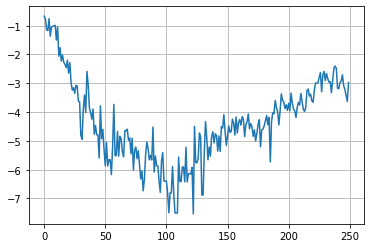

In [543]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

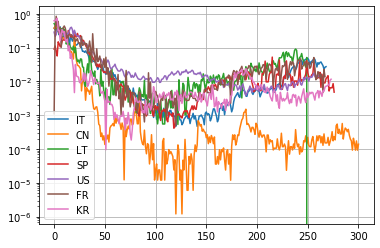

In [544]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

262 262
coefficient of determination: 0.6547047234062684
intercept: -13.603813574929337
slope: [-0.03607677]


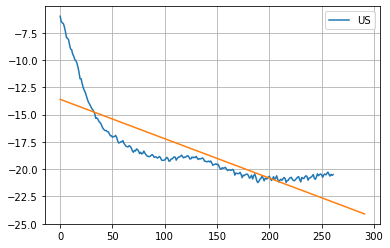

In [545]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [546]:
#np.diff(dfIT["cases"])

269 269
coefficient of determination: 0.2728828912635404
intercept: -14.601147619530984
slope: [-0.01795239]


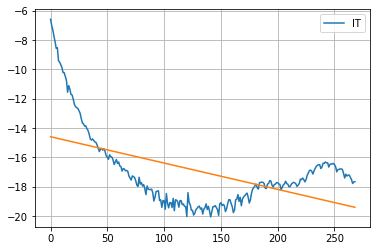

In [547]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [548]:
#model11.coef_

In [549]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

251 251
coefficient of determination: 0.8590668360916689
intercept: -16.87688585965141
slope: [-0.02620066]


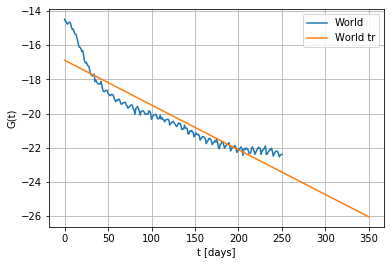

In [550]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

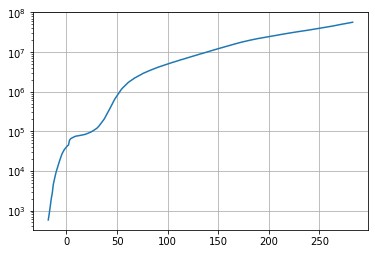

In [551]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [552]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 2.19534971e+08  3.35272237e-01 -3.88713487e+02  1.66348428e-02]


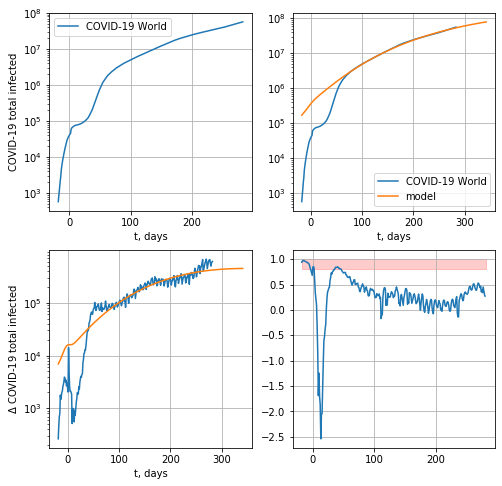

657589.7117258306


In [553]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

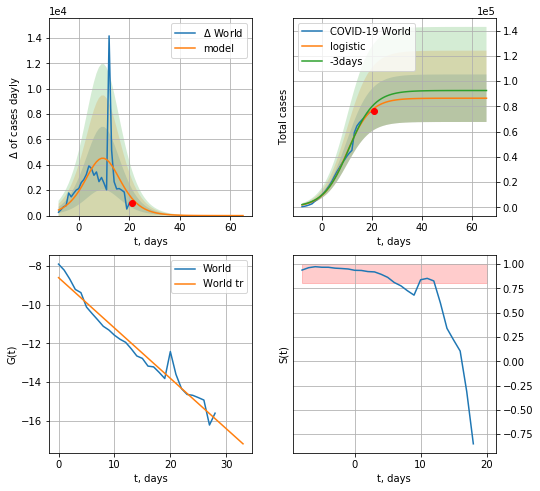

World data at: 2020-11-18
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  86472 ± 18834
	 total death:  2070 ± 1352
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


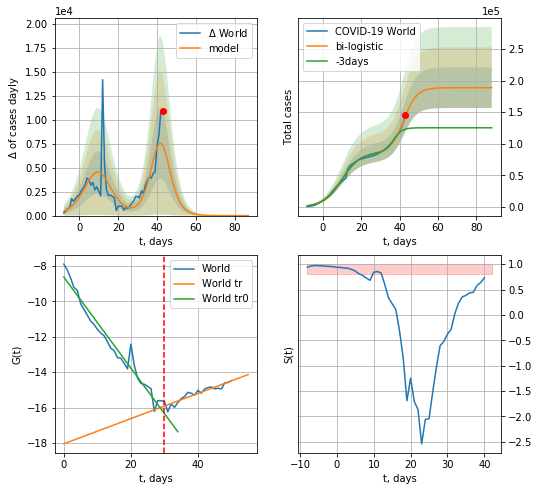

World data at: 2020-11-18
+3 day model MAPE: 0.21572977405755475
model: bi-logistic
coeffs:  [1.02227620e+05 2.95650803e-01 4.22367007e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860967254475
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  188701 ± 32065
	 total death:  4518 ± 2303
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:312: RuntimeWarning: overflow encountered in exp


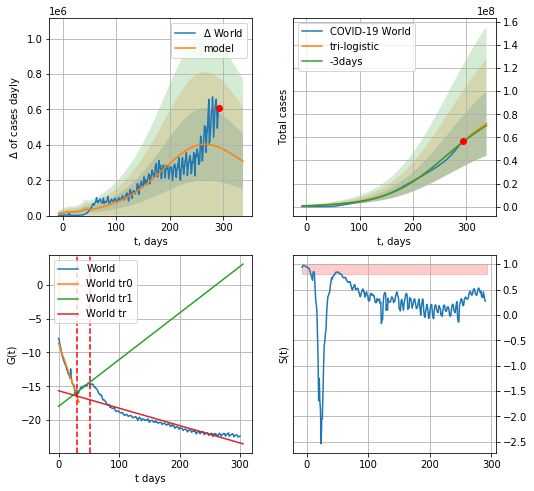

World data at: 2020-11-18
+3 day model MAPE: 0.012235574505499634
model: tri-logistic
coeffs:  [8.14626748e+07 1.83016001e-02 2.58858784e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227620e+05
 2.95650803e-01 4.22367007e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.3876991091706406
forecast at the end of period: +45 days
	 deltaDaycases:  306613
	 total cases:  71955296 ± 27897004
	 total death:  1723103 ± 2004136
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.861549
 intercept: -15.666407
 slope: -0.025742


In [554]:
vL = 30
T18 = 40
x = forecast("World",dfW[:vL],d1,7*T18-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

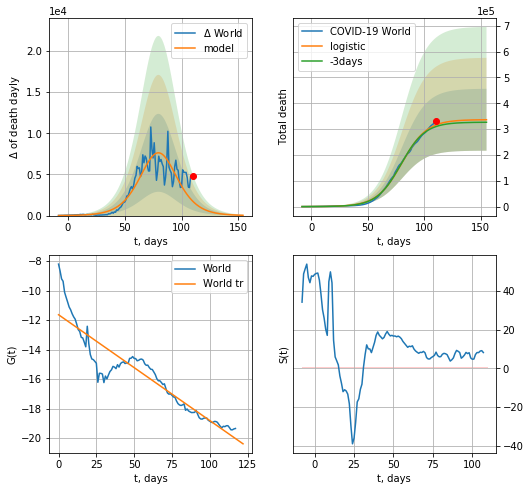

World data at: 2020-11-18
+3 day model MAPE: 0.020621037522772532
model: logistic
coeffs:  [3.36666036e+05 9.06319611e-02 8.01803344e+01]
rational stdev:  0.356220604376718
forecast at the end of period: +45 days
	 total death:  336284 ± 119791
trend coefficient of determination: 0.862243
 intercept: -11.641434
 slope: -0.071737


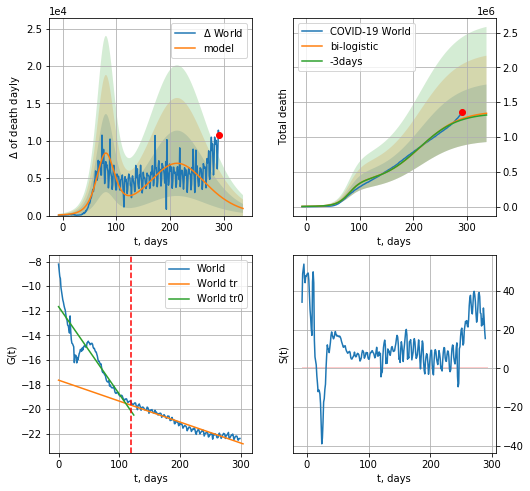

World data at: 2020-11-18
+3 day model MAPE: 0.012559151424879195
model: bi-logistic
coeffs:  [1.04025050e+06 2.69026619e-02 2.13518884e+02] [3.36666036e+05 9.06319611e-02 8.01803344e+01]
rational stdev:  0.3084697227042489
forecast at the end of period: +45 days
	 deltaDaydeath:  952
	 total death:  1340689 ± 413562
bi-logistic approximation splitting point: 120
trend0 coefficient of determination: 0.864805
 intercept: -11.666935
 slope: -0.071086
trend coefficient of determination: 0.941520
 intercept: -17.644749
 slope: -0.017028


In [555]:
vL = 120#30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [556]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


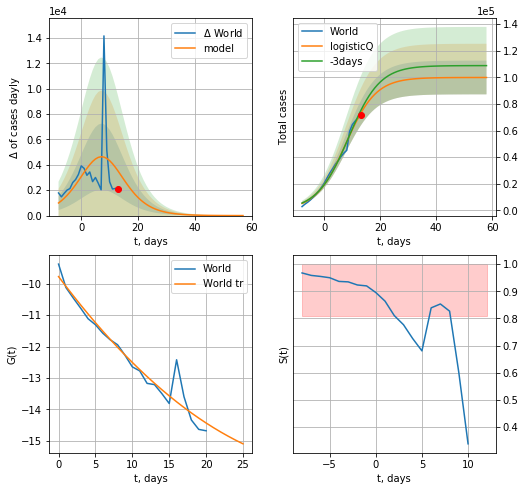

World data at: 2020-11-18
+3 day model MAPE: 0.031856
model: logisticQ
coeffs: [ 9.98643061e+04  1.79654926e-05  7.63889443e+00 -1.03374511e+04]
rational stdev: 0.126959
forecast at the end of period: +45 days
	 deltaDaycases: 1
	 total cases: 99856 ± 12677
	 total death: 2391 ± 910
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


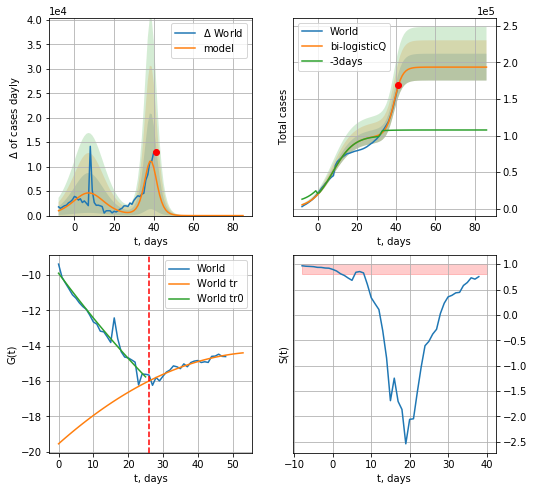

World data at: 2020-11-18
+3 day model MAPE: 0.635592
model: bi-logisticQ
coeffs: [ 9.37621522e+04  2.37764402e-05  3.89555041e+01 -2.00834102e+04]
rational stdev: 0.094698
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 193626 ± 18336
	 total death: 4636 ± 1317
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


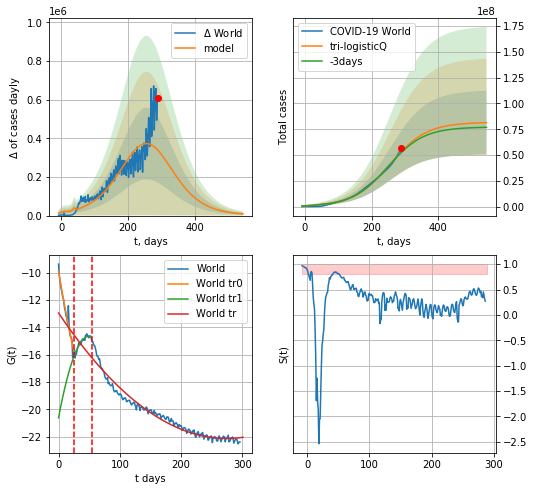

World data at: 2020-11-18
+3 day model MAPE: 0.015973
model: tri-logisticQ
coeffs: [ 8.14332243e+07  8.70000666e-08  2.54834616e+02 -2.10170002e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.380111
forecast at the end of period: +255 days
	 deltaDaycases: 8868
	 total cases: 81378793 ± 30933000
	 total death: 1948766 ± 2222244
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.963289
 intercept_: -12.952870265114127
 coeffs_: [ 0.         -0.06694838  0.00012198]


In [557]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

In [558]:
#vL = 55
#x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RRD("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

302


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


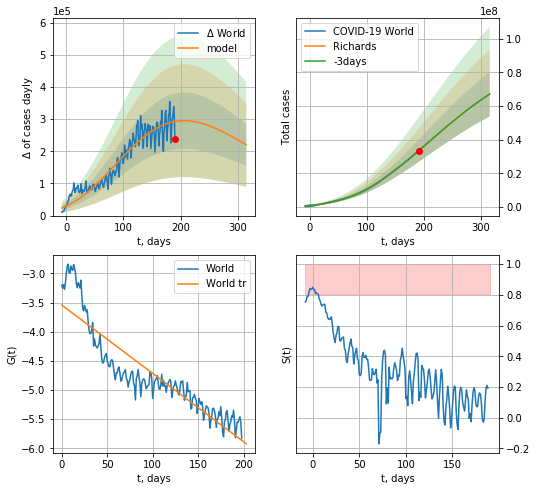

World data at: 2020-11-18
+3 day model MAPE: 0.000153
model: Richards
coeffs: [ 1.00574850e+08  1.59324796e-01 -1.56451036e+02  5.13454148e-02]
rational stdev: 0.198566
forecast at the end of period: +125 days
	 deltaDaycases: 220182
	 total cases: 67142878 ± 13332307
	 total death: 1607860 ± 957800
trend coefficient of determination: 0.817380
 intercept: -3.542094
 slope: -0.011731
diffStd0a 0.11406177979888443


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


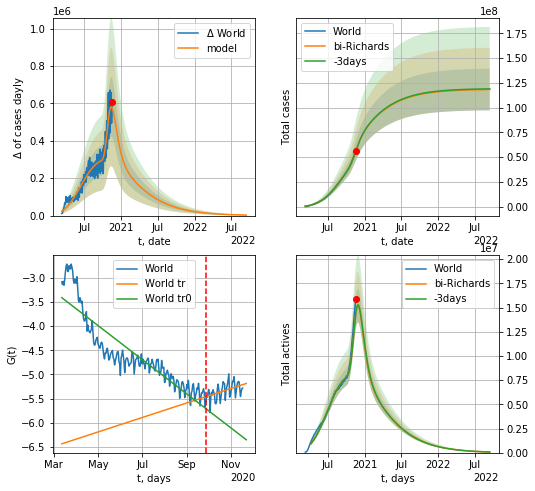

World data at: 2020-11-18
+3 day model MAPE: 0.000387
model: bi-Richards
coeffs: [1.80292484e+07 1.08569236e+00 1.68640051e+02 4.17705082e-02]
rational stdev: 0.177912
forecast at the end of period: +665 days
	 deltaDaycases: 2650
	 total cases: 118280889 ± 21043608
	 total death: 2832455 ± 1511784
bi-Richards approximation splitting point: 200
actives k: 28
trend coefficient of determination: 0.816975
 intercept: -3.412851
 slope: -0.011512
trend coefficient of determination: 0.208064
 intercept: -6.433210
 slope: 0.004890


In [561]:
print (len(dfW))
vL = 200+50
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("World",dfW[50:],d1,100*9-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-50,amc=0.8)
#x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


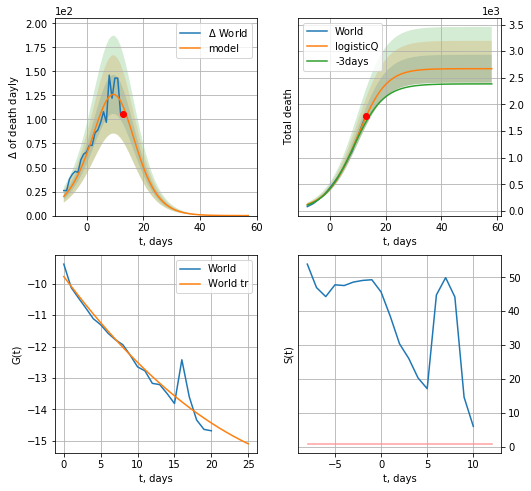

World data at: 2020-11-18
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67018329e+03  8.28113131e-04  9.49649422e+00 -2.18461064e+02]
rational stdev: 0.098000
forecast at the end of period: +45 days
	 total death: 2670 ± 261
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


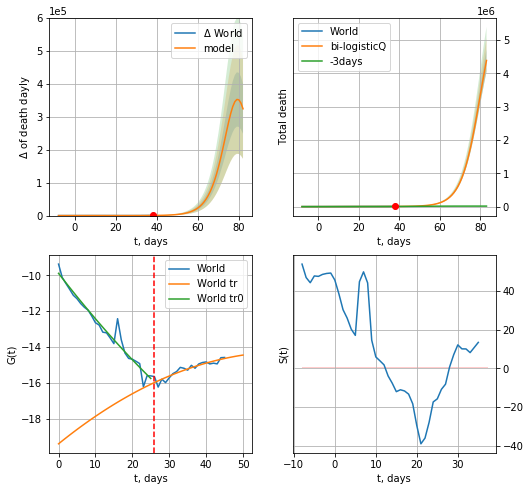

World data at: 2020-11-18
+3 day model MAPE: 0.105641
model: bi-logisticQ
coeffs: [ 6.44010385e+06  6.89934025e-04  7.95796325e+01 -2.38740330e+02]
rational stdev: 0.076590
forecast at the end of period: +45 days
	 total death: 4389612 ± 336201
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:477: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


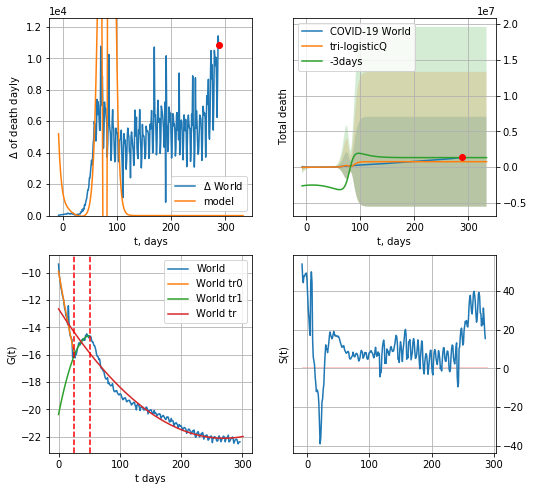

World data at: 2020-11-18
+3 day model MAPE: 0.426501
model: tri-logisticQ
coeffs: [-5.67892713e+06  2.40446551e-03 -3.19714316e+01  7.89159398e+01]
rational stdev: 8.208363
forecast at the end of period: +45 days
	 total death: 763846 ± 6269932
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.961064
 intercept_: -12.654281262411548
 coeffs_: [ 0.         -0.07025362  0.0001303 ]


In [562]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


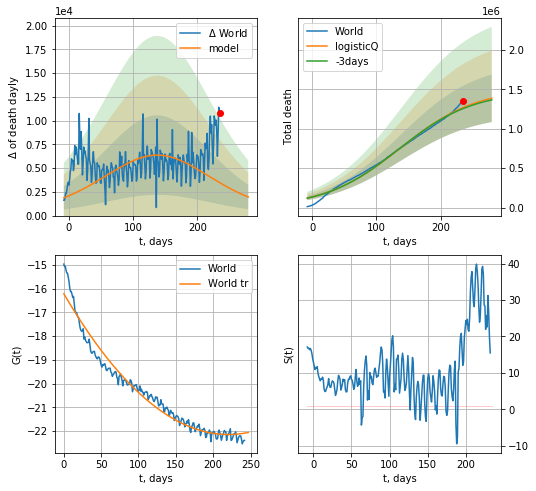

World data at: 2020-11-18
+3 day model MAPE: 0.009951
model: logisticQ
coeffs: [ 1.51186341e+06  1.85749980e-07  1.37550468e+02 -9.06062656e+04]
rational stdev: 0.217685
forecast at the end of period: +45 days
	 total death: 1386675 ± 301858
trend coefficient of determination: 0.963289
 intercept_: -16.21237026325243
 coeffs_: [ 0.         -0.05377523  0.00012198]


In [563]:
x = forecastRRR("World",dfW[58:],d1,7*T18-dT,1.0,False,cases='death')

In [564]:
#trend(dfSP,'SP',10)

In [565]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

In [566]:
try:
    dfSP = read_df(pd.DataFrame(),"SP")
    vL = 40#len(dfSP[:])-7-dT
    #x = forecast('Spain',dfSP[:vL],d1,7*T18-dT,1.0,cases='cases')
    #xx = forecast2('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')
except:
    print("Exception occurs")

SP
           date    cases  active    death
273 2020-11-14  1502308       0  40769.0
274 2020-11-15  1512072       0  40769.0
275 2020-11-16  1521899       0  41253.0
276 2020-11-17  1535058       0  41688.0
277 2020-11-18  1542467       0  42039.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: divide by zero encountered in true_divide


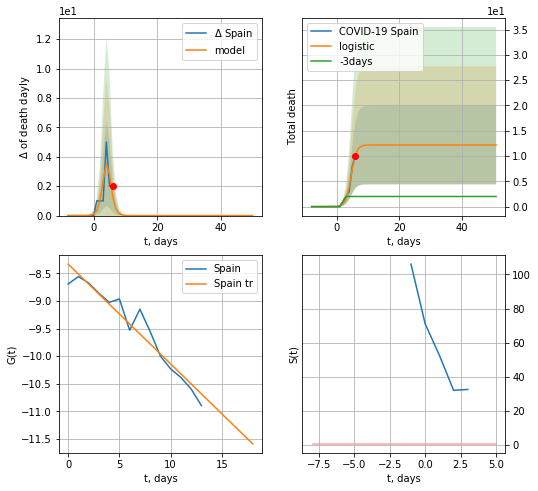

Spain data at: 2020-11-18
+3 day model MAPE: 4.756036700963932
model: logistic
coeffs:  [12.18291976  1.20295815  4.63698223]
rational stdev:  0.6384450788145528
forecast at the end of period: +45 days
	 total death:  12 ± 7
trend coefficient of determination: 0.932343
 intercept: -8.335143
 slope: -0.180548


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:252: RuntimeWarning: invalid value encountered in true_divide


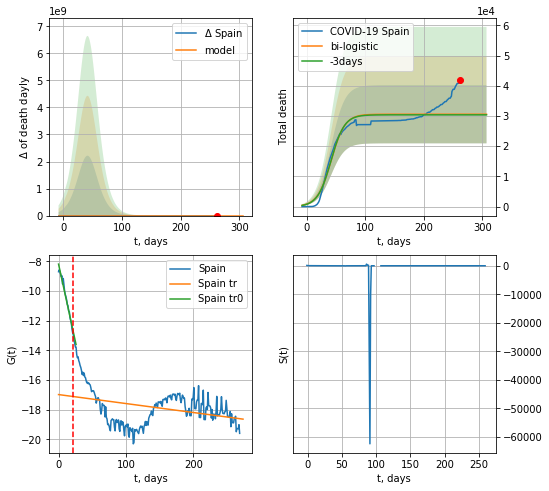

Spain data at: 2020-11-18
+3 day model MAPE: 0.0067167810599935394
model: bi-logistic
coeffs:  [3.05578392e+04 8.57462801e-02 4.17802602e+01] [12.18291976  1.20295815  4.63698223]
rational stdev:  0.3150736558065915
forecast at the end of period: +45 days
	 deltaDaydeath:  0
	 total death:  30570 ± 9631
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.977622
 intercept: -8.181737
 slope: -0.208457
trend coefficient of determination: 0.113903
 intercept: -16.974116
 slope: -0.006040


In [567]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


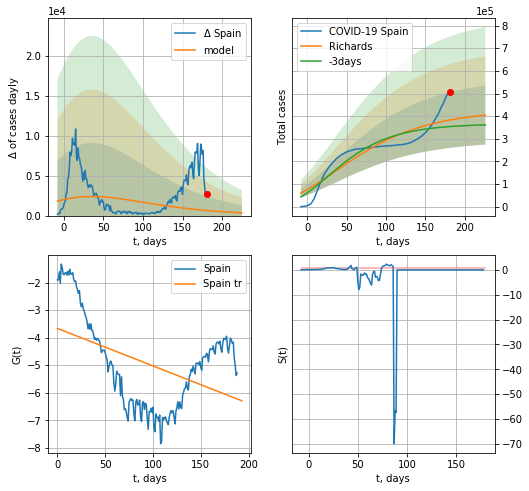

Spain data at: 2020-11-18
+3 day model MAPE: 0.082514
model: Richards
coeffs: [ 4.27280053e+05  3.16489052e+00 -3.13079673e+02  4.82672820e-03]
rational stdev: 0.320945
forecast at the end of period: +45 days
	 deltaDaycases: 341
	 total cases: 404439 ± 129803
	 total death: 11022 ± 10612
trend coefficient of determination: 0.201906
 intercept: -3.664041
 slope: -0.013609


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


diffStd0a 0.43728856395793914


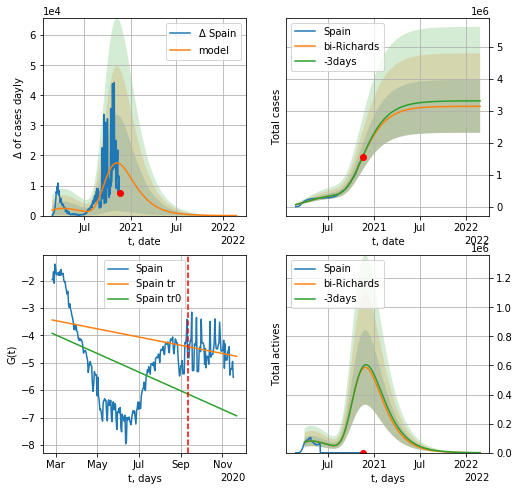

Spain data at: 2020-11-18
+3 day model MAPE: 0.007385
model: bi-Richards
coeffs: [2.71304460e+06 1.31184609e+00 2.20371629e+00 1.32885703e-02]
rational stdev: 0.263766
forecast at the end of period: +465 days
	 deltaDaycases: 12
	 total cases: 3139612 ± 828121
	 total death: 85568 ± 67709
bi-Richards approximation splitting point: 200
actives k: 35
trend coefficient of determination: 0.156657
 intercept: -3.924295
 slope: -0.011110
trend coefficient of determination: 0.032468
 intercept: -3.436364
 slope: -0.004893


In [568]:
iL = 10
vL = 200+iL#75+iL#135+1
x = forecastRR('Spain',dfSP[iL:vL-iL],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Spain',dfSP[iL:],d12f(1),7*100-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


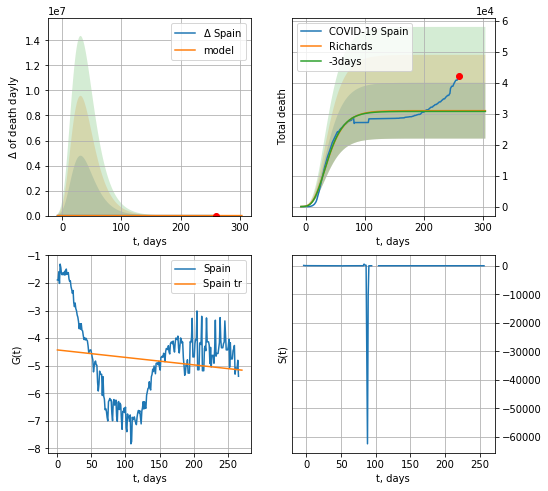

Spain data at: 2020-11-18
+3 day model MAPE: 0.007700
model: Richards
coeffs: [ 3.09543439e+04  1.69215274e+01 -7.69683663e+01  3.14133733e-03]
rational stdev: 0.291011
forecast at the end of period: +45 days
	 total death: 30954 ± 9008
trend coefficient of determination: 0.021031
 intercept: -4.429065
 slope: -0.002700


In [569]:
x = forecastRR('Spain',dfSP[10:],d1,7*T18-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

In [570]:
#x = forecastRRR('Spain',dfSP[:50],d1,7*T18-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
#xx = forecast2RRR('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


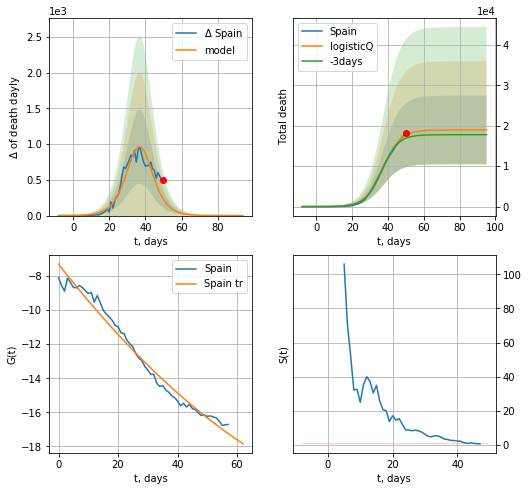

Spain data at: 2020-11-18
+3 day model MAPE: 0.047871
model: logisticQ
coeffs: [ 1.89599654e+04  5.38912704e-06  3.72491565e+01 -3.78046979e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.447682
forecast at the end of period: +45 days
	 total death: 18966 ± 8490
trend coefficient of determination: 0.978811
 intercept_: -7.301838938937334
 coeffs_: [ 0.         -0.22359908  0.00086295]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


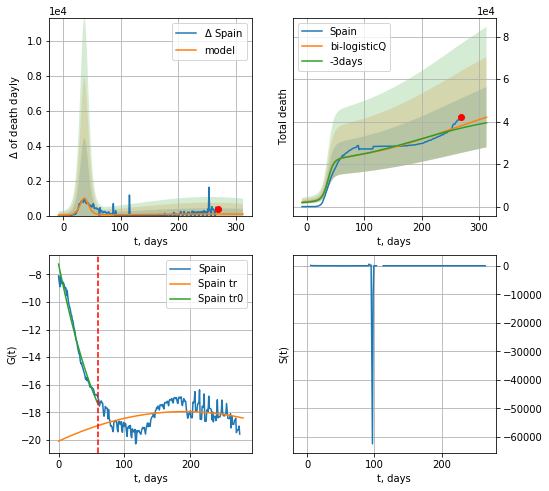

Spain data at: 2020-11-18
+3 day model MAPE: 0.030567
model: bi-logisticQ
coeffs: [ 3.49205446e+04  2.70476803e-08  2.52518380e+02 -3.94970951e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.337023
forecast at the end of period: +45 days
	 total death: 42053 ± 14172
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.978897
 intercept_: -7.2487934110171
 coeffs_: [ 0.         -0.2311524   0.00102662]
trend coefficient of determination: 0.104044
 intercept_: -20.10266119665301
 coeffs_: [ 0.00000000e+00  2.24987773e-02 -5.88759443e-05]


In [571]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

In [572]:
#x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

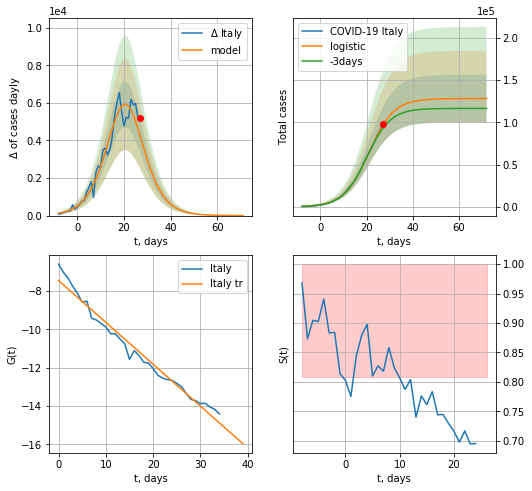

Italy data at: 2020-11-18
+3 day model MAPE: 0.0455783779571316
model: logistic
coeffs:  [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.22065596629973358
forecast at the end of period: +45 days
	 deltaDaycases:  2
	 total cases:  128128 ± 28272
	 total death:  4754 ± 3146
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


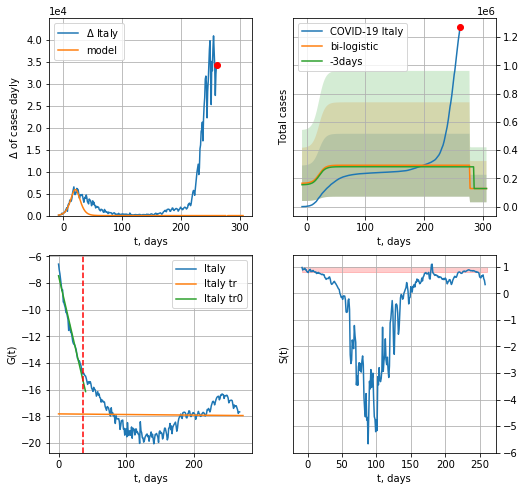

Italy data at: 2020-11-18
+3 day model MAPE: 0.037606665078902826
model: bi-logistic
coeffs:  [ 1.65012976e+05 -2.93106095e+01  2.77839390e+02] [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.7594507500298758
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  128139 ± 97315
	 total death:  4755 ± 10833
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.000607
 intercept: -17.824748
 slope: -0.000454


In [573]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,T18*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,T18*7-dT,x,1.0,vL=vL)

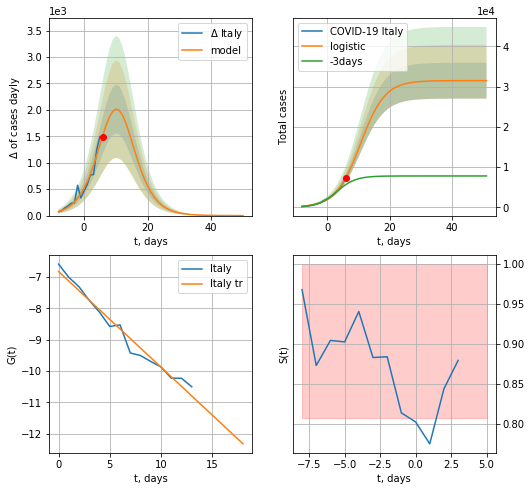

Italy data at: 2020-11-18
+3 day model MAPE: 0.4426444096966454
model: logistic
coeffs:  [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.1414781796365507
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  31496 ± 4456
	 total death:  1168 ± 495
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


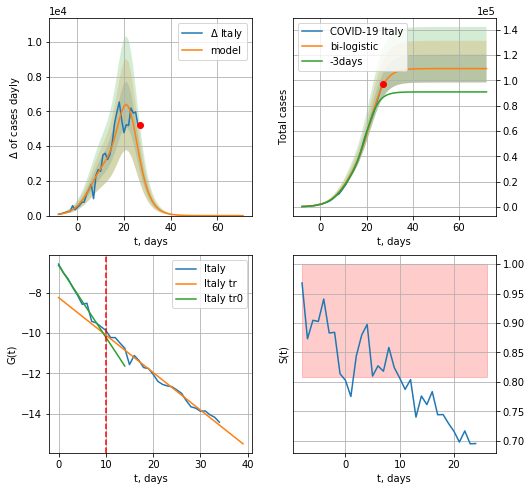

Italy data at: 2020-11-18
+3 day model MAPE: 0.1273932630183904
model: bi-logistic
coeffs:  [7.78644566e+04 3.07215545e-01 2.18188310e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.10049358712471239
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  109362 ± 10990
	 total death:  4058 ± 1223
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:312: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:354: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


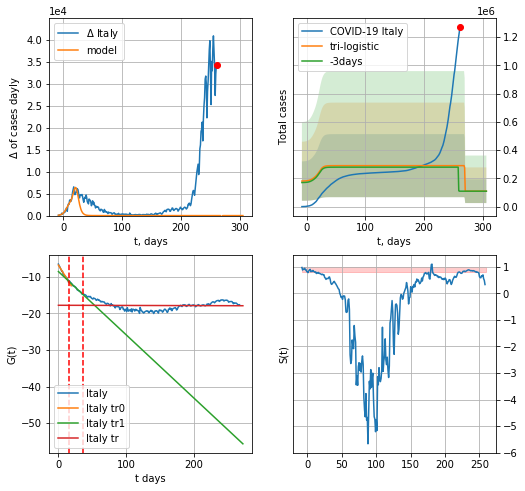

Italy data at: 2020-11-18
+3 day model MAPE: 1.6528459913743347
model: tri-logistic
coeffs:  [ 1.80759004e+05 -1.08542793e+01  2.69222749e+02] [3.14978219e+04 2.56455865e-01 1.06869170e+01 7.78644566e+04
 3.07215545e-01 2.18188310e+01]
forecast rational stdev:  0.7691716186876
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  109362 ± 84118
	 total death:  4058 ± 9363
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.000607
 intercept: -17.824748
 slope: -0.000454


In [574]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

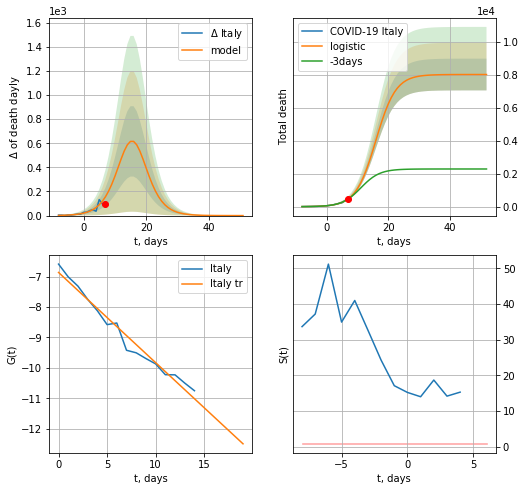

Italy data at: 2020-11-18
+3 day model MAPE: 0.04050488963495004
model: logistic
coeffs:  [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12009378173020563
forecast at the end of period: +45 days
	 total death:  8021 ± 963
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


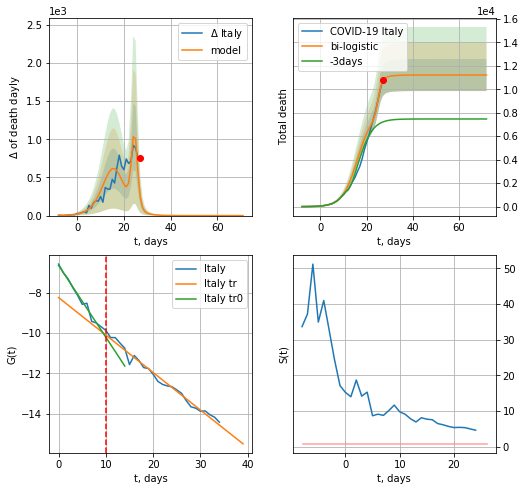

Italy data at: 2020-11-18
+3 day model MAPE: 0.5045402783114736
model: bi-logistic
coeffs:  [3.18986478e+03 1.24682064e+00 2.50159742e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12176299197618909
forecast at the end of period: +45 days
	 deltaDaydeath:  0
	 total death:  11211 ± 1365
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


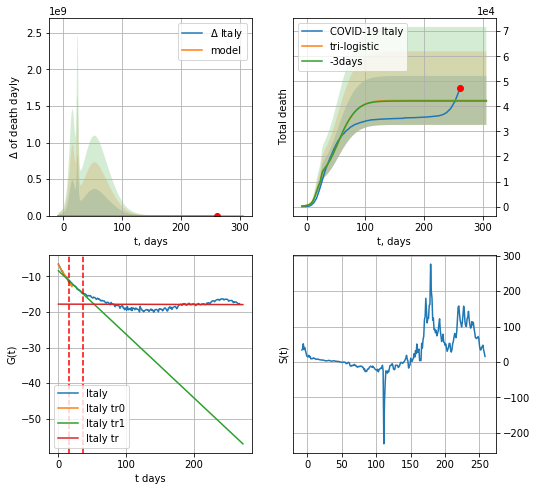

Italy data at: 2020-11-18
+3 day model MAPE: 0.006117831798838086
model: tri-logistic
coeffs:  [2.49347817e+04 7.90181839e-02 5.15760124e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01 3.18986478e+03
 1.24682064e+00 2.50159742e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.23059723944727809
forecast at the end of period: +45 days
	 deltaDaydeath:  0
	 total death:  42379 ± 9772
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.000607
 intercept: -17.824748
 slope: -0.000454


In [575]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


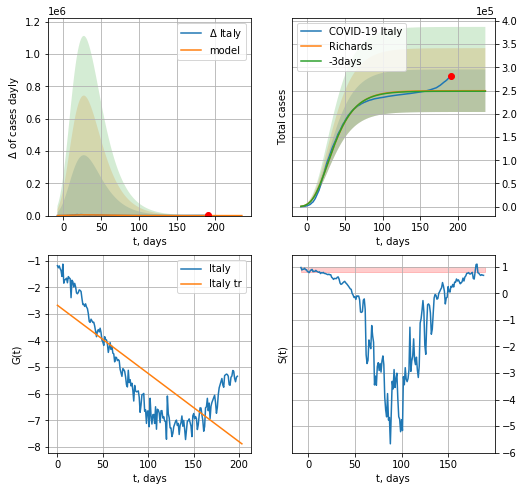

Italy data at: 2020-11-18
+3 day model MAPE: 0.004445
model: Richards
coeffs: [ 2.49818271e+05  1.03928665e+01 -7.87445552e+01  4.83991521e-03]
rational stdev: 0.183409
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 249811 ± 45817
	 total death: 9270 ± 5100
trend coefficient of determination: 0.624507
 intercept: -2.673566
 slope: -0.025683
diffStd0a 1.164983109536881


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


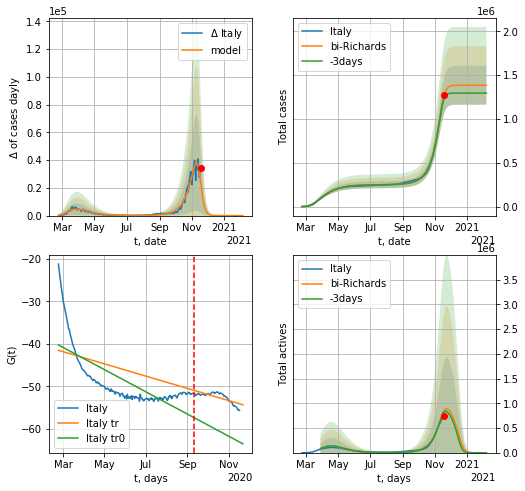

Italy data at: 2020-11-18
+3 day model MAPE: 0.029262
model: bi-Richards
coeffs: [1.13550559e+06 6.49701175e-02 2.58363006e+02 3.70149528e+00]
rational stdev: 0.160132
forecast at the end of period: +80 days
	 deltaDaycases: 0
	 total cases: 1385323 ± 221834
	 total death: 51409 ± 24696
bi-Richards approximation splitting point: 200
actives k: 35
trend coefficient of determination: 0.534501
 intercept: -40.276898
 slope: -0.085113
trend coefficient of determination: 0.572703
 intercept: -41.524159
 slope: -0.046939


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


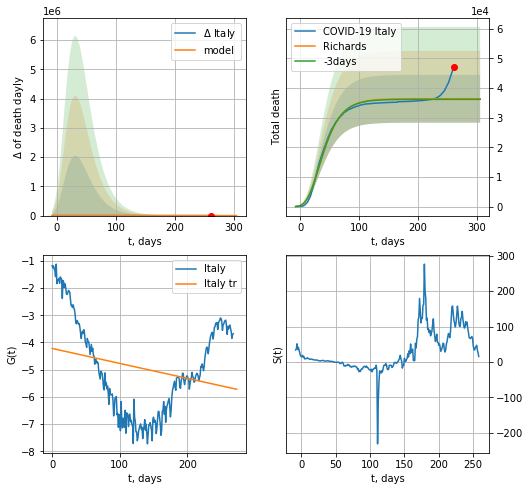

Italy data at: 2020-11-18
+3 day model MAPE: 0.005895
model: Richards
coeffs: [ 3.64110659e+04  1.06637368e+01 -8.15169363e+01  4.48000007e-03]
rational stdev: 0.221850
forecast at the end of period: +45 days
	 total death: 36410 ± 8077
trend coefficient of determination: 0.061516
 intercept: -4.219755
 slope: -0.005488


In [576]:
vL=200#152
x = forecastRR('Italy',dfIT[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Italy',dfIT[:],d1,45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,T18*7-dT,1.0,cases='death')

In [577]:
#x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


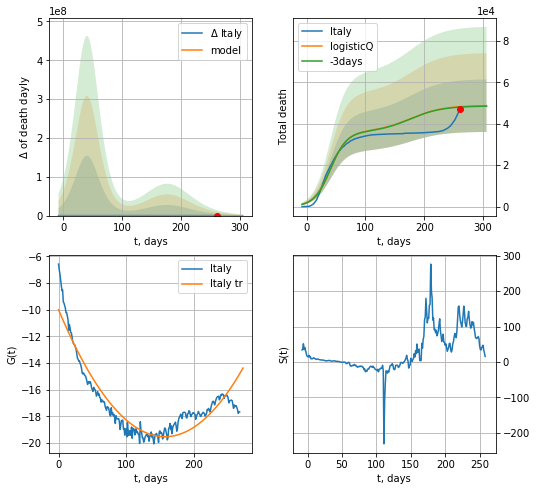

Italy data at: 2020-11-18
+3 day model MAPE: 0.004469
model: logisticQ
coeffs: [ 3.60654761e+04  9.18279540e-08  4.05409695e+01 -7.78115062e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.260118
forecast at the end of period: +45 days
	 total death: 48717 ± 12672
trend coefficient of determination: 0.878023
 intercept_: -10.010683196803441
 coeffs_: [ 0.         -0.12110904  0.00038491]


In [578]:
x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [579]:
dT

235

FR
           date      cases   active    death
273 2020-11-14  1954599.0  1771213  44246.0
274 2020-11-15  1981827.0  1797469  44548.0
275 2020-11-16  1991233.0  1805299  45054.0
276 2020-11-17  2036755.0  1847330  46273.0
277 2020-11-18  2065138.0  1873049  46698.0


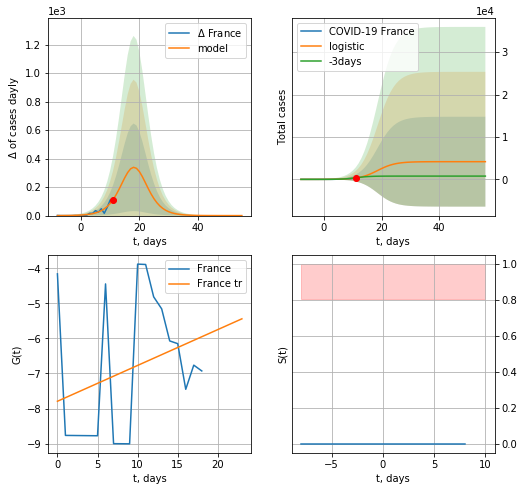

France data at: 2020-11-18
+3 day model MAPE: 0.04053351776025477
model: logistic
coeffs:  [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  2.5390566064289986
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  4173 ± 10597
	 total death:  94 ± 716
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


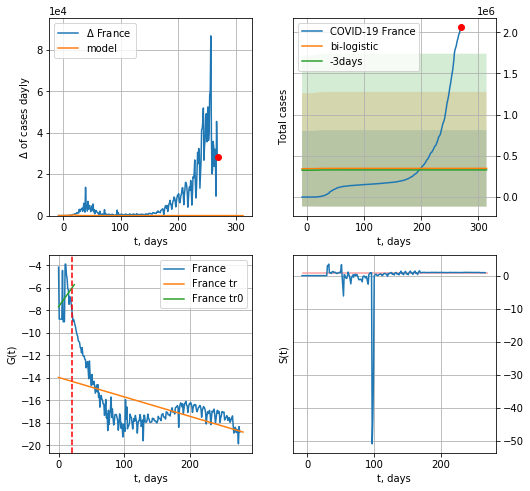

France data at: 2020-11-18
+3 day model MAPE: 0.05560176137946599
model: bi-logistic
coeffs:  [ 3.44301764e+05 -1.92039123e+01  4.66011356e+02] [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  1.3312358291113968
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  348475 ± 463903
	 total death:  7879 ± 31466
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.340945
 intercept: -13.955461
 slope: -0.017296


In [580]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
try:
    x = forecast('France',dfFR[:vL],d1,T18*7-dT,1.0)
    xx = forecast2('France',dfFR,d1,T18*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)
except:
    print ("Exception occurs")

In [581]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

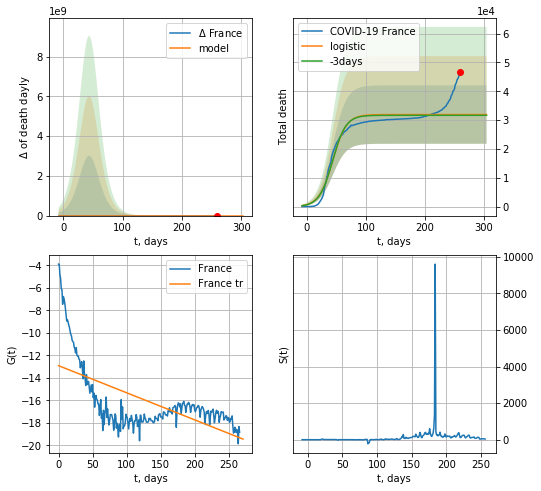

France data at: 2020-11-18
+3 day model MAPE: 0.00842500322228468
model: logistic
coeffs:  [3.19285643e+04 8.66776360e-02 4.39173692e+01]
rational stdev:  0.31726448488132114
forecast at the end of period: +45 days
	 total death:  31928 ± 10129
trend coefficient of determination: 0.391158
 intercept: -12.910735
 slope: -0.024095


In [582]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*T18-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


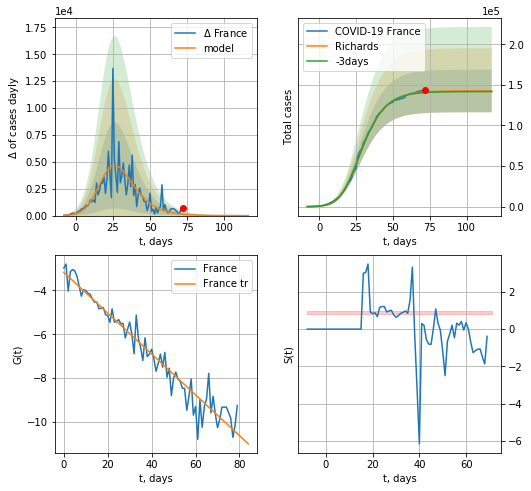

France data at: 2020-11-18
+3 day model MAPE: 0.005042
model: Richards
coeffs: [1.42540738e+05 3.12476603e-01 1.59919989e+01 3.30748014e-01]
rational stdev: 0.184343
forecast at the end of period: +45 days
	 deltaDaycases: 1
	 total cases: 142528 ± 26274
	 total death: 3222 ± 1781
trend coefficient of determination: 0.942455
 intercept: -3.170576
 slope: -0.093180
diffStd0a 0.30953184532408246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


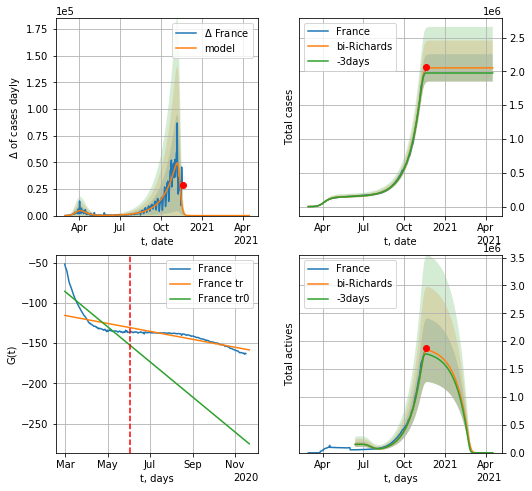

France data at: 2020-11-18
+3 day model MAPE: 0.032024
model: bi-Richards
coeffs: [1.90834057e+06 3.54218293e-02 2.49583085e+02 1.09273418e+01]
rational stdev: 0.098469
forecast at the end of period: +150 days
	 deltaDaycases: 0
	 total cases: 2050881 ± 201947
	 total death: 46375 ± 13699
bi-Richards approximation splitting point: 95
actives k: 105
trend coefficient of determination: 0.739298
 intercept: -85.817355
 slope: -0.708990
trend coefficient of determination: 0.863905
 intercept: -115.701076
 slope: -0.160405


In [583]:
vL = 95+14#100+14#86+14+40+29
x = forecastRR('France',dfFR[14:vL-14],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('France',dfFR[14:],d1,55*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14,amc=3.0)

In [584]:
#x = forecastRRR('France',dfFR[10:],d1,34*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


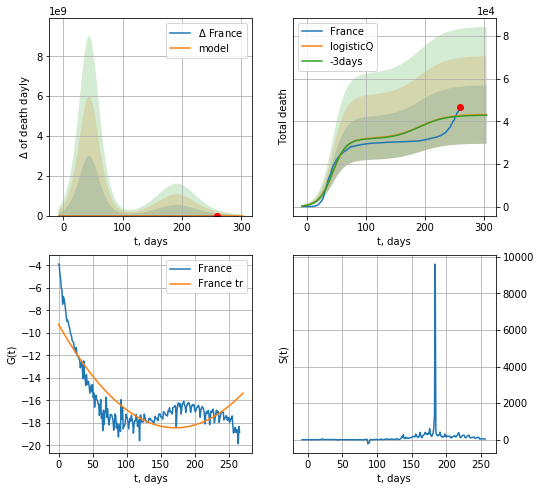

France data at: 2020-11-18
+3 day model MAPE: 0.006547
model: logisticQ
coeffs: [ 3.19286647e+04  7.73517784e-08  4.39184888e+01 -1.12015569e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.317287
forecast at the end of period: +45 days
	 total death: 43153 ± 13692
trend coefficient of determination: 0.703745
 intercept_: -9.240019576989745
 coeffs_: [ 0.         -0.10720554  0.00031245]


In [585]:
x = forecastRRR('France',dfFR[10:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [586]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [587]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

In [588]:
dfGR = read_df(pd.DataFrame(),"GR")
#x = forecast('Germany',dfGR[:],d1,7*T18-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

GR
           date   cases  active    death
264 2020-11-14  788899  273980  12619.0
265 2020-11-15  802944  287952  12692.0
266 2020-11-16  817526  289435  12891.0
267 2020-11-17  833732  290284  13248.0
268 2020-11-18  854533  294541  13492.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


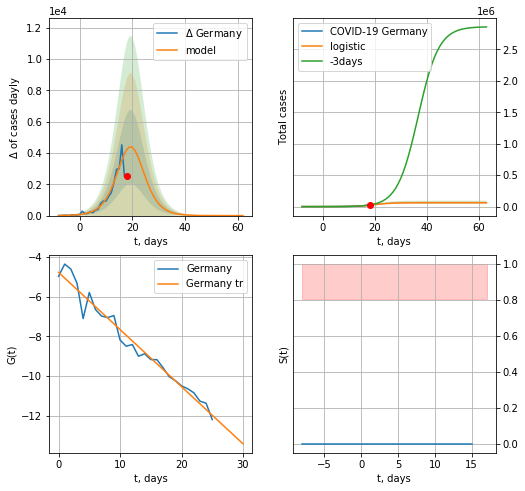

Germany data at: 2020-11-18
+3 day model MAPE: 0.1832688253569737
model: logistic
coeffs:  [6.15503848e+04 2.86340373e-01 1.98405530e+01]
rational stdev:  0.17812668621711658
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  61550 ± 10963
	 total death:  971 ± 518
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


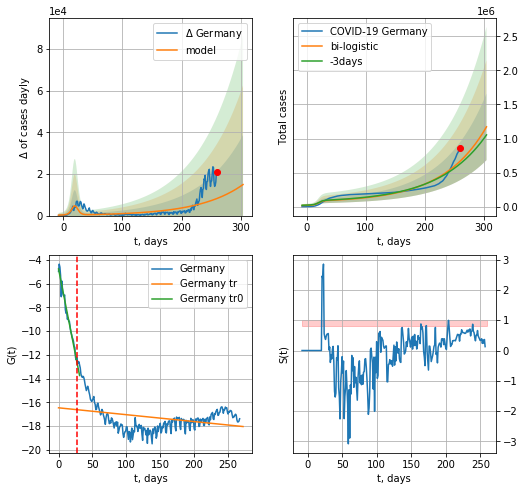

Germany data at: 2020-11-18
+3 day model MAPE: 0.06325142304383512
model: bi-logistic
coeffs:  [5.00958432e+09 1.35302780e-02 9.26877926e+02] [6.15503848e+04 2.86340373e-01 1.98405530e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.4174290058545668
forecast at the end of period: +45 days
	 deltaDaycases:  14921
	 total cases:  1172083 ± 489261
	 total death:  18505 ± 23173
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.097766
 intercept: -16.454018
 slope: -0.005792


In [589]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,T18*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*T18-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

In [590]:
dfGR = read_df(pd.DataFrame(),"GR")
#x = forecast('Germany',dfGR[14:],d1,24*7-dT,1.0,cases='death')

GR
           date   cases  active    death
264 2020-11-14  788899  273980  12619.0
265 2020-11-15  802944  287952  12692.0
266 2020-11-16  817526  289435  12891.0
267 2020-11-17  833732  290284  13248.0
268 2020-11-18  854533  294541  13492.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


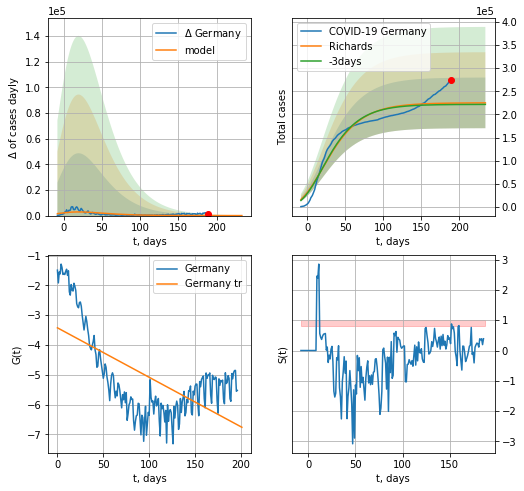

Germany data at: 2020-11-18
+3 day model MAPE: 0.014202
model: Richards
coeffs: [ 2.24991639e+05  1.08201736e+01 -1.45898747e+02  3.19943345e-03]
rational stdev: 0.243260
forecast at the end of period: +45 days
	 deltaDaycases: 4
	 total cases: 224855 ± 54698
	 total death: 3550 ± 2590
trend coefficient of determination: 0.409079
 intercept: -3.423509
 slope: -0.016610
diffStd0a 0.6075172172235149


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


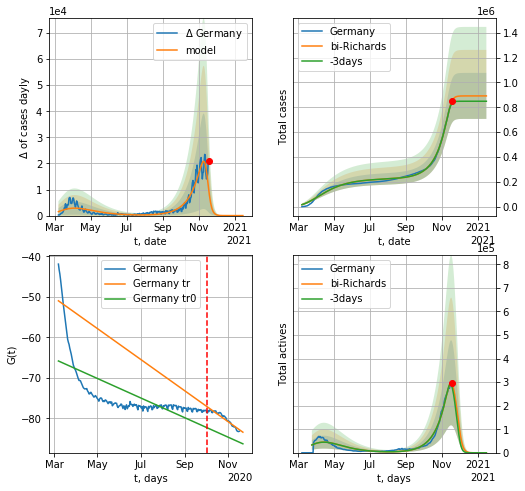

Germany data at: 2020-11-18
+3 day model MAPE: 0.025324
model: bi-Richards
coeffs: [6.66551771e+05 5.09685248e-02 2.45630245e+02 5.81934475e+00]
rational stdev: 0.207588
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 891532 ± 185071
	 total death: 14076 ± 8766
bi-Richards approximation splitting point: 210
actives k: 17
trend coefficient of determination: 0.457162
 intercept: -65.831034
 slope: -0.078751
trend coefficient of determination: 0.910929
 intercept: -50.957077
 slope: -0.124907


In [591]:
vL = 210+12#94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Germany',dfGR[12:],d1,42*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12,amc=0.5)

In [592]:
#x = forecastRRR('Germany',dfGR[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


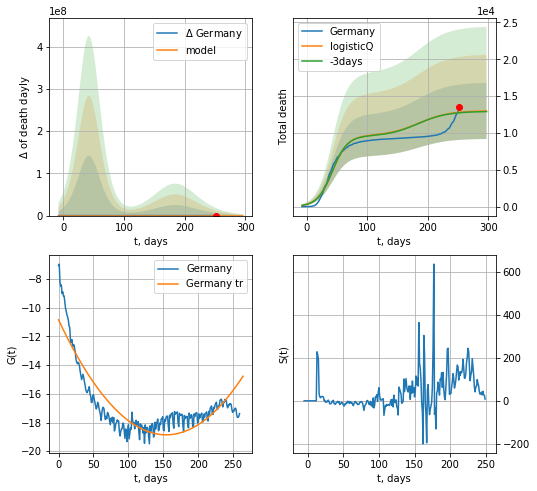

Germany data at: 2020-11-18
+3 day model MAPE: 0.005595
model: logisticQ
coeffs: [ 9.61735301e+03  1.03088723e-07  4.23619914e+01 -7.72585812e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.292902
forecast at the end of period: +45 days
	 total death: 12986 ± 3803
trend coefficient of determination: 0.792123
 intercept_: -10.837059460312947
 coeffs_: [ 0.         -0.10412433  0.00033794]


In [593]:
x = forecastRRR('Germany',dfGR[8:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date     cases   active     death
258 2020-11-14  11226218  4083931  251256.0
259 2020-11-15  11367214  4178077  251901.0
260 2020-11-16  11538280  4266264  252652.0
261 2020-11-17  11697469  4354093  254291.0
262 2020-11-18  11873863  4450605  256262.0


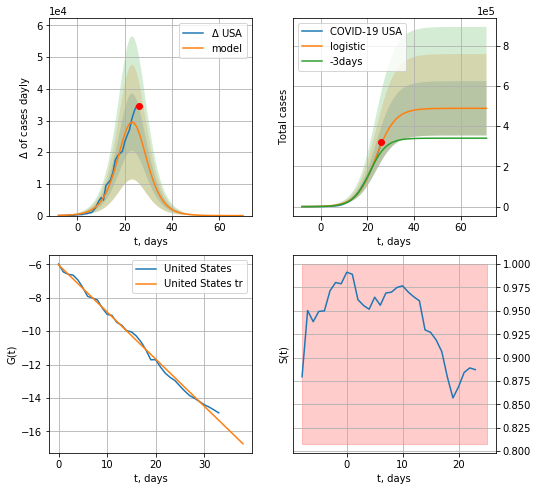

USA data at: 2020-11-18
+3 day model MAPE: 0.17962965905806133
model: logistic
coeffs:  [4.89025787e+05 2.41973856e-01 2.36121759e+01]
rational stdev:  0.27607026078318453
forecast at the end of period: +45 days
	 deltaDaycases:  1
	 total cases:  489020 ± 135004
	 total death:  10554 ± 8740
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


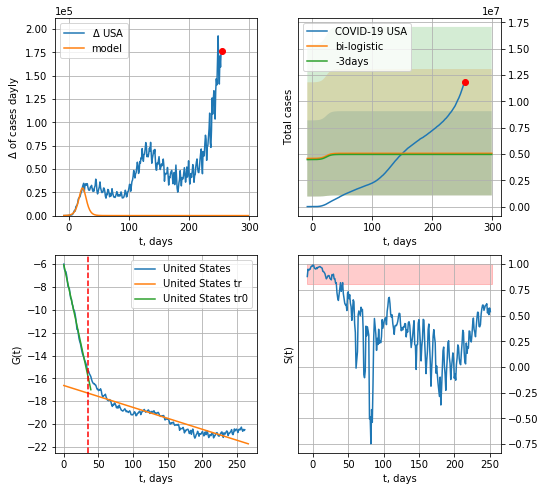

USA data at: 2020-11-18
+3 day model MAPE: 0.022002017173600452
model: bi-logistic
coeffs:  [ 3.65841259e+06 -4.10221655e+01  9.78544981e+02] [4.89025787e+05 2.41973856e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.7901501081684059
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  5062041 ± 3999772
	 total death:  109249 ± 258969
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.835943
 intercept: -16.624821
 slope: -0.019203


In [594]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

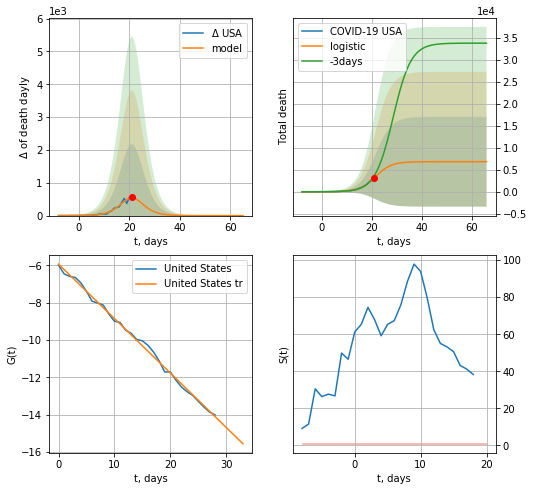

USA data at: 2020-11-18
+3 day model MAPE: 0.21421329662103625
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +45 days
	 total death:  6833 ± 10202
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


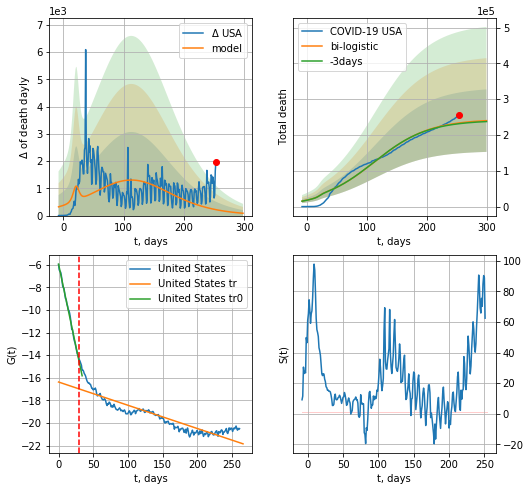

USA data at: 2020-11-18
+3 day model MAPE: 0.00886276399668152
model: bi-logistic
coeffs:  [2.37232040e+05 2.19973667e-02 1.13098920e+02] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.36342432341586534
forecast at the end of period: +45 days
	 deltaDaydeath:  85
	 total death:  240157 ± 87279
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.816544
 intercept: -16.376420
 slope: -0.020546


In [595]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*T18-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


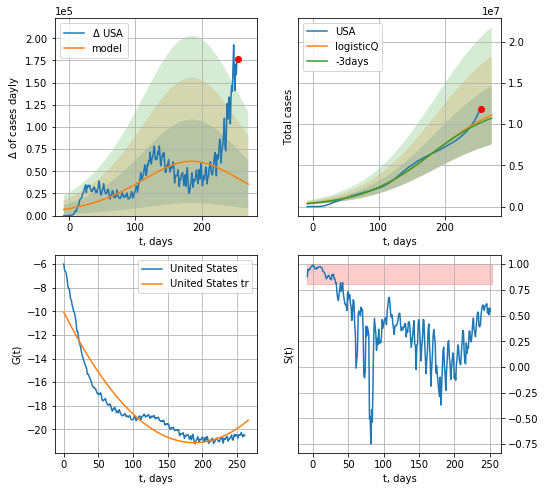

USA data at: 2020-11-18
+3 day model MAPE: 0.026769
model: logisticQ
coeffs: [ 1.33687224e+07  6.37891501e-08  1.85133638e+02 -2.86357113e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321065
forecast at the end of period: +17 days
	 deltaDaycases: 35375
	 total cases: 11100453 ± 3563964
	 total death: 239570 ± 230752
trend coefficient of determination: 0.880167
 intercept_: -10.06421353535521
 coeffs_: [ 0.         -0.11776     0.00031296]


In [596]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


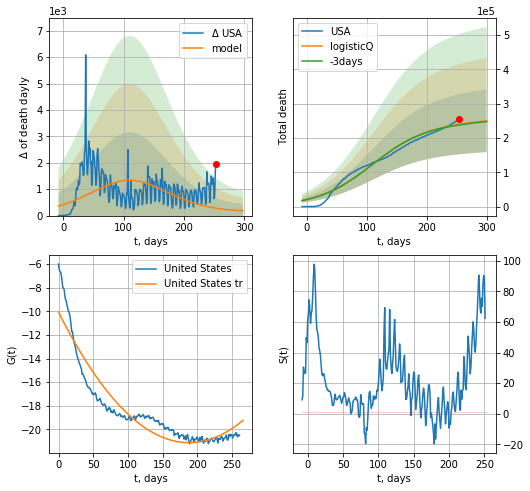

USA data at: 2020-11-18
+3 day model MAPE: 0.008216
model: logisticQ
coeffs: [ 2.43195006e+05  2.79083016e-08  1.09616842e+02 -7.80241363e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.364733
forecast at the end of period: +45 days
	 total death: 249975 ± 91174
trend coefficient of determination: 0.880167
 intercept_: -10.06421353535521
 coeffs_: [ 0.         -0.11776     0.00031296]


In [597]:
x = forecastRRR('USA',dfUS[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


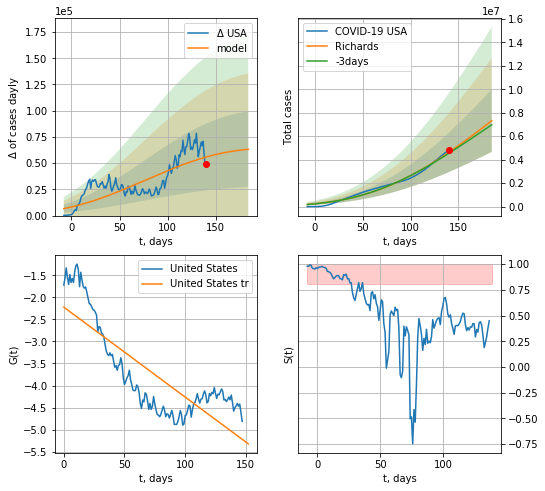

USA data at: 2020-11-18
+3 day model MAPE: 0.018711
model: Richards
coeffs: [ 2.31615491e+07  5.15148790e-01 -3.53277047e+02  1.46832715e-02]
rational stdev: 0.363581
forecast at the end of period: +45 days
	 deltaDaycases: 63207
	 total cases: 7323222 ± 2662582
	 total death: 158049 ± 172390
trend coefficient of determination: 0.668555
 intercept: -2.223272
 slope: -0.020376
diffStd0a 0.138505290452039


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


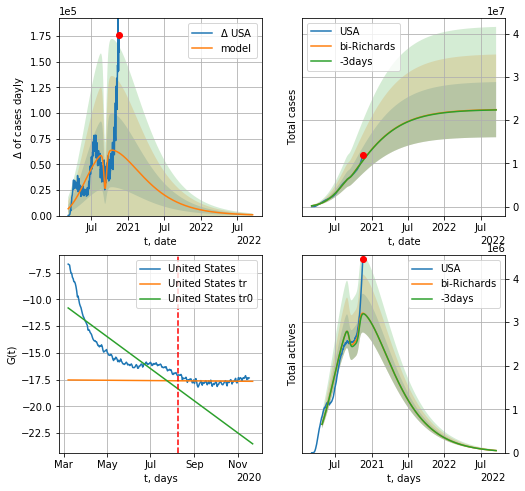

USA data at: 2020-11-18
+3 day model MAPE: 0.006142
model: bi-Richards
coeffs: [-6.50044791e+05  2.59463810e-01  1.76594172e+02  8.05884534e-01]
rational stdev: 0.284510
forecast at the end of period: +668 days
	 deltaDaycases: 806
	 total cases: 22405013 ± 6374444
	 total death: 483545 ± 412719
bi-Richards approximation splitting point: 155
actives k: 52
trend coefficient of determination: 0.702154
 intercept: -10.798219
 slope: -0.048826
trend coefficient of determination: 0.002831
 intercept: -17.527445
 slope: -0.000487


In [598]:
iL = 6
vL = 155+iL#193+iL#90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('USA',dfUS[iL:],d1,7*129-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=1.5)

In [599]:
#x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date    cases  active    death
262 2020-11-14  1344356       0  51766.0
263 2020-11-15  1369318       0  51934.0
264 2020-11-16  1390681       0  52147.0
265 2020-11-17  1410732       0  52745.0
266 2020-11-18  1430341       0  53274.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


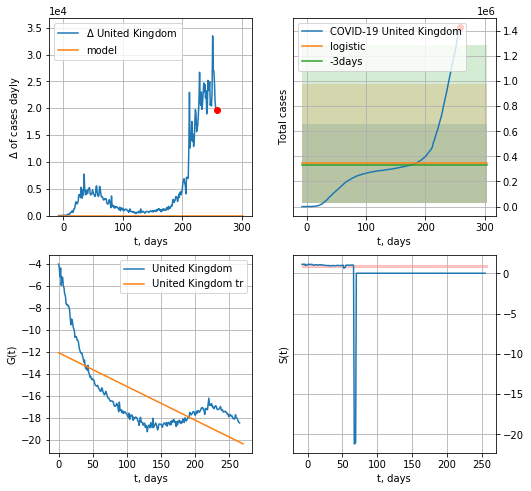

United Kingdom data at: 2020-11-18
+3 day model MAPE: 0.03649945124758553
model: logistic
coeffs:  [ 3.44141921e+05 -1.81134717e+01  4.46485692e+02]
rational stdev:  0.9124867389646397
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  344141 ± 314024
	 total death:  12817 ± 35086
trend coefficient of determination: 0.488216
 intercept: -12.082612
 slope: -0.030663


In [600]:
try:
    dfGB = read_df(pd.DataFrame(),"GB")
    x = forecast('United Kingdom',dfGB[:],d1,7*T18-dT,1.)
    #x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
    #xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)
except:
    print ("Exception occurs")

In [601]:
#x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: divide by zero encountered in true_divide


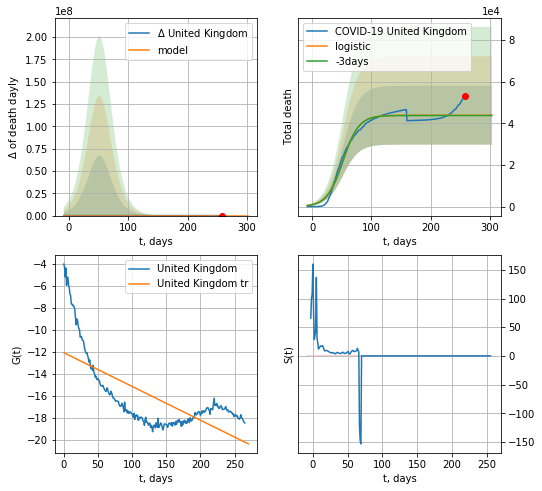

United Kingdom data at: 2020-11-18
+3 day model MAPE: 0.004030662892942145
model: logistic
coeffs:  [4.39656702e+04 7.39501040e-02 5.22623633e+01]
rational stdev:  0.32172058924637525
forecast at the end of period: +45 days
	 total death:  43965 ± 14144
trend coefficient of determination: 0.488216
 intercept: -12.082612
 slope: -0.030663


In [602]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


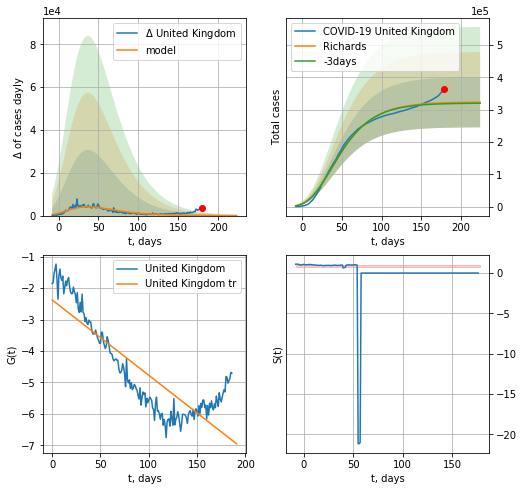

United Kingdom data at: 2020-11-18
+3 day model MAPE: 0.008801
model: Richards
coeffs: [ 3.23415604e+05  7.89136664e+00 -1.20373121e+02  4.36893740e-03]
rational stdev: 0.240393
forecast at the end of period: +45 days
	 deltaDaycases: 18
	 total cases: 322899 ± 77622
	 total death: 12026 ± 8672
trend coefficient of determination: 0.735594
 intercept: -2.373746
 slope: -0.023973
diffStd0a 0.4321869852479146


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


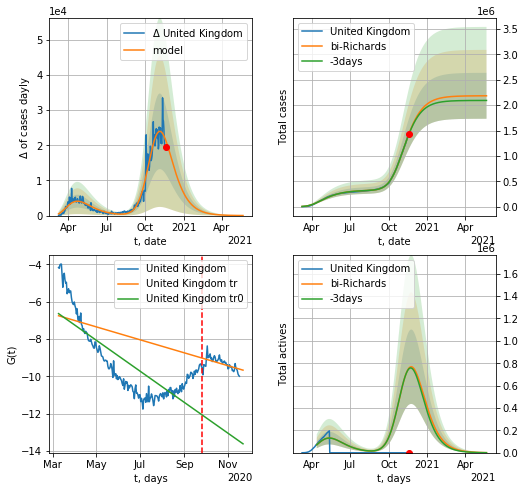

United Kingdom data at: 2020-11-18
+3 day model MAPE: 0.005162
model: bi-Richards
coeffs: [1.86182619e+06 1.03751074e-01 2.11261836e+02 4.02984745e-01]
rational stdev: 0.207214
forecast at the end of period: +185 days
	 deltaDaycases: 20
	 total cases: 2184768 ± 452715
	 total death: 81373 ± 50584
bi-Richards approximation splitting point: 200
actives k: 35
trend coefficient of determination: 0.625762
 intercept: -6.645720
 slope: -0.027039
trend coefficient of determination: 0.298049
 intercept: -6.758807
 slope: -0.011299


In [603]:
vL = 200+12#143+12
x = forecastRR('United Kingdom',dfGB[12:vL-12],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('United Kingdom',dfGB[12:],d1,60*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#x = forecastRR('United Kingdom',dfGB[:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


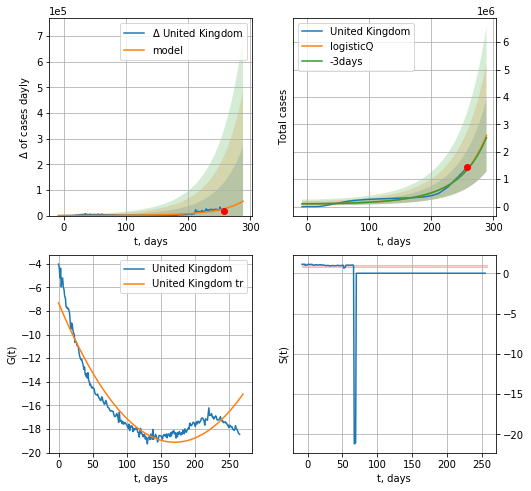

United Kingdom data at: 2020-11-18
+3 day model MAPE: 0.017217
model: logisticQ
coeffs: [ 3.55642624e+09  3.68511163e-05  5.25457936e+02 -5.39536368e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.506320
forecast at the end of period: +31 days
	 deltaDaycases: 56015
	 total cases: 2601610 ± 1317248
	 total death: 96898 ± 147184
trend coefficient of determination: 0.896741
 intercept_: -7.320673928975971
 coeffs_: [ 0.         -0.13888886  0.0004084 ]


In [604]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


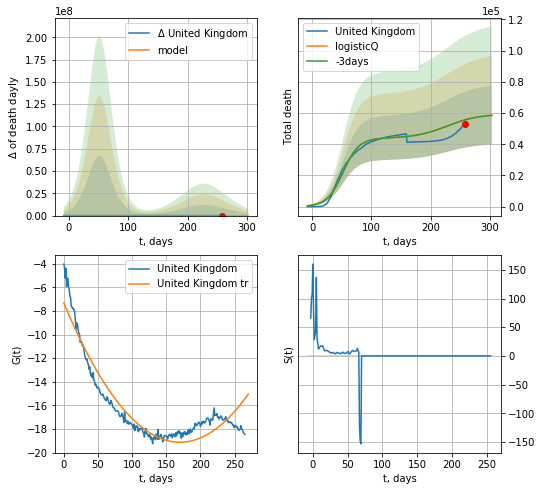

United Kingdom data at: 2020-11-18
+3 day model MAPE: 0.001869
model: logisticQ
coeffs: [ 4.39655914e+04  1.34709065e-07  5.22628720e+01 -5.48725599e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321740
forecast at the end of period: +45 days
	 total death: 58641 ± 18867
trend coefficient of determination: 0.896741
 intercept_: -7.320673928975971
 coeffs_: [ 0.         -0.13888886  0.0004084 ]


In [605]:
x = forecastRRR('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [606]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [607]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [608]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [609]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [610]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

DK
           date    cases  active  death
261 2020-11-14  61078.0   13547  757.0
262 2020-11-15  62136.0   13629  760.0
263 2020-11-16  63331.0   13871  764.0
264 2020-11-17  64551.0   13822  768.0
265 2020-11-18  65808.0   13821  770.0


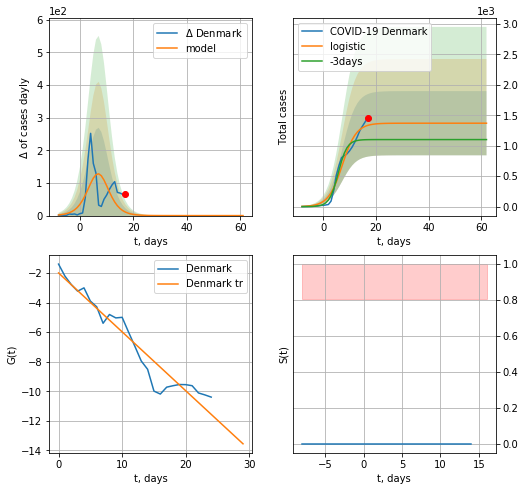

Denmark data at: 2020-11-18
+3 day model MAPE: 0.22309164797181072
model: logistic
coeffs:  [1.36966074e+03 3.75718857e-01 7.30059730e+00]
rational stdev:  0.3847660616131427
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  1369 ± 526
	 total death:  16 ± 18
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


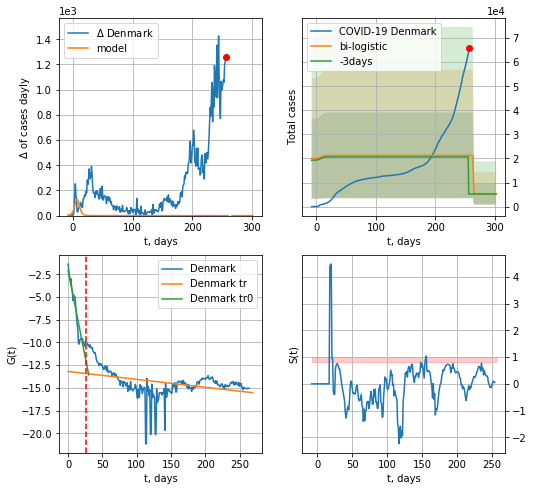

Denmark data at: 2020-11-18
+3 day model MAPE: 3.0791283421476496
model: bi-logistic
coeffs:  [ 1.59308942e+04 -4.11554272e+00  2.63802978e+02] [1.36966074e+03 3.75718857e-01 7.30059730e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8356827454600906
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  5352 ± 4472
	 total death:  62 ± 155
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.135179
 intercept: -13.195970
 slope: -0.008678


In [611]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
try:
    x = forecast('Denmark',dfDK[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Denmark',dfDK[:],d1,T18*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

In [612]:
d12f(4)

'2020-11-15'

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


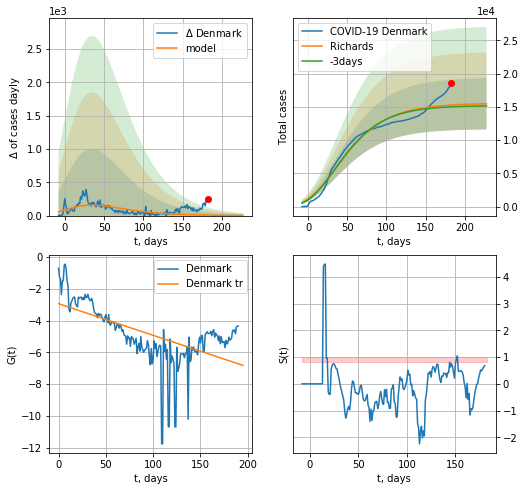

Denmark data at: 2020-11-18
+3 day model MAPE: 0.018367
model: Richards
coeffs: [ 1.55387411e+04  7.02926074e+00 -1.66867960e+02  3.90987733e-03]
rational stdev: 0.249168
forecast at the end of period: +45 days
	 deltaDaycases: 2
	 total cases: 15461 ± 3852
	 total death: 180 ± 134
trend coefficient of determination: 0.355292
 intercept: -2.934034
 slope: -0.019949
diffStd0a 0.4058667499061841


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


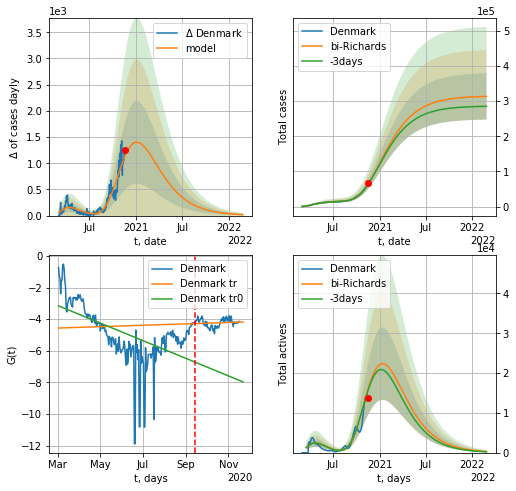

Denmark data at: 2020-11-18
+3 day model MAPE: 0.006339
model: bi-Richards
coeffs: [ 2.99061264e+05  7.49068810e-01 -1.68775415e+01  1.71427276e-02]
rational stdev: 0.210144
forecast at the end of period: +465 days
	 deltaDaycases: 17
	 total cases: 313212 ± 65819
	 total death: 3664 ± 2309
bi-Richards approximation splitting point: 196
actives k: 17
trend coefficient of determination: 0.312919
 intercept: -3.158776
 slope: -0.018157
trend coefficient of determination: 0.010701
 intercept: -4.560073
 slope: 0.001437


In [613]:
vL = 200#125+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Denmark',dfDK[4:],d1,100*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4,amc=0.5)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

In [614]:
#x = forecastRRR('Denmark',dfDK[:18],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
#x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date    cases  active  death
262 2020-11-14  28434.0   16277  294.0
263 2020-11-15  28966.0    9647  294.0
264 2020-11-16  29514.0   10195  294.0
265 2020-11-17  30114.0   10791  298.0
266 2020-11-18  30770.0   11445  300.0


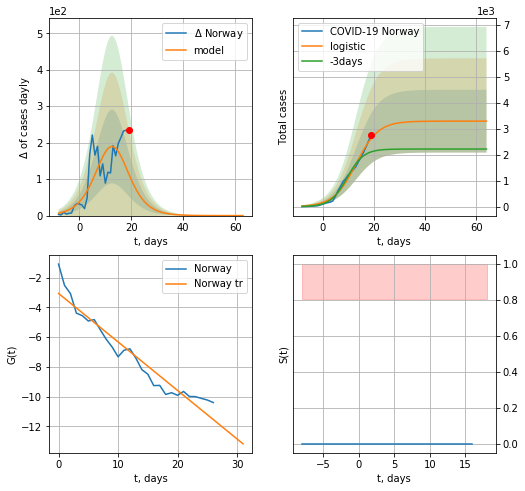

Norway data at: 2020-11-18
+3 day model MAPE: 0.28148190042351234
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.36743919108062534
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  3297 ± 1211
	 total death:  32 ± 35
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


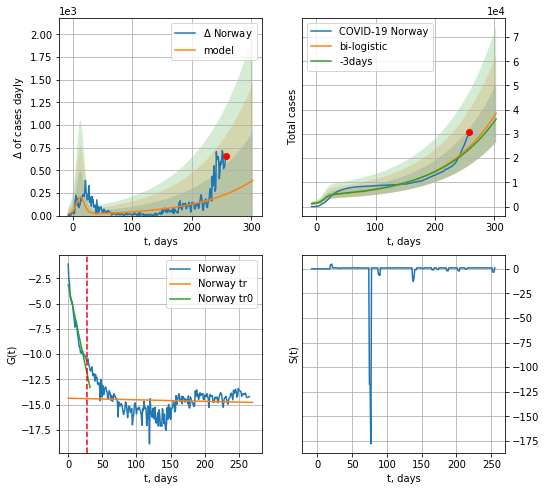

Norway data at: 2020-11-18
+3 day model MAPE: 0.039595151868223794
model: bi-logistic
coeffs:  [1.13392587e+08 1.10627703e-02 1.03302162e+03] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3083448139282254
forecast at the end of period: +45 days
	 deltaDaycases:  387
	 total cases:  38540 ± 11883
	 total death:  375 ± 346
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.007371
 intercept: -14.350194
 slope: -0.001546


In [615]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

In [616]:
vL = 28#len(dfNG)-13-dT
#x = forecast('Norway',dfNG[:-12-dT],d1,7*T18-dT,1.0)
#xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


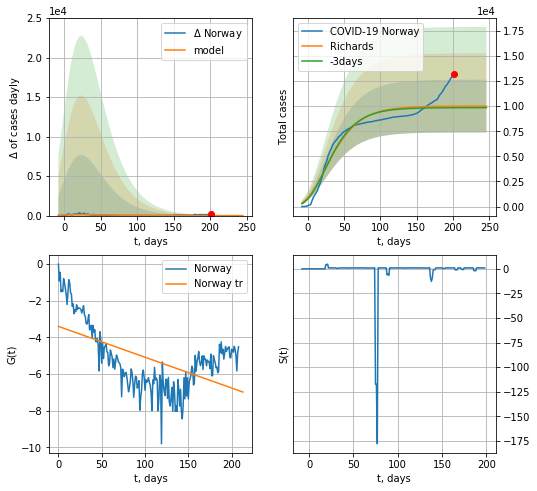

Norway data at: 2020-11-18
+3 day model MAPE: 0.015762
model: Richards
coeffs: [ 1.00040704e+04  1.30654907e+01 -1.29861253e+02  2.91049631e-03]
rational stdev: 0.262498
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 10001 ± 2625
	 total death: 97 ± 76
trend coefficient of determination: 0.314756
 intercept: -3.399379
 slope: -0.016798
diffStd0a 0.6308870285798653


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


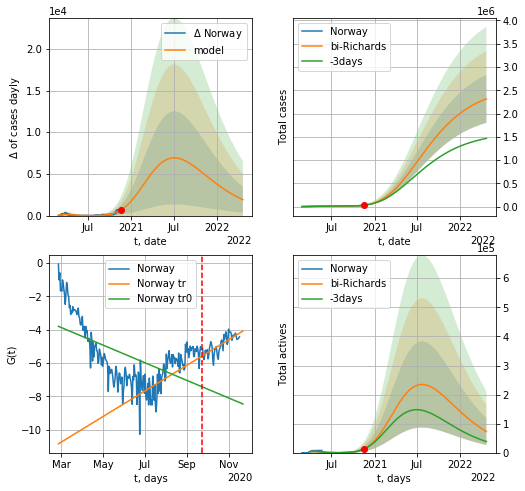

Norway data at: 2020-11-18
+3 day model MAPE: 0.013842
model: bi-Richards
coeffs: [2.57384267e+06 1.36280450e-01 1.00347284e+02 5.51371487e-02]
rational stdev: 0.222537
forecast at the end of period: +521 days
	 deltaDaycases: 1910
	 total cases: 2315057 ± 515186
	 total death: 22571 ± 15068
bi-Richards approximation splitting point: 210
actives k: 35
trend coefficient of determination: 0.317582
 intercept: -3.792165
 slope: -0.017242
trend coefficient of determination: 0.574008
 intercept: -10.837700
 slope: 0.025045


In [617]:
vL = 210#96+22#170#96+22
x = forecastRR('Norway',dfNG[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Norway',dfNG[:],d1,108*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

In [618]:
#x = forecastRRR('Norway',dfNG[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


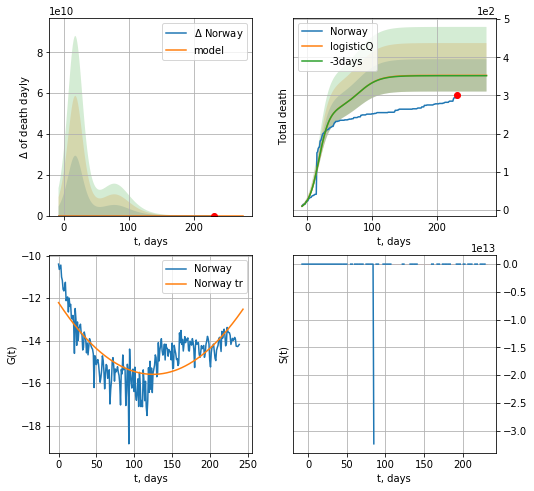

Norway data at: 2020-11-18
+3 day model MAPE: 0.002557
model: logisticQ
coeffs: [ 2.60333611e+02  1.24905814e-07  1.81250549e+01 -9.96711970e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.119983
forecast at the end of period: +45 days
	 total death: 352 ± 42
trend coefficient of determination: 0.536738
 intercept_: -12.213243069457269
 coeffs_: [ 0.         -0.05401308  0.00021618]


In [619]:
x = forecastRRR('Norway',dfNG[26:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date   cases  active   death
263 2020-11-14  181011       0  6164.0
264 2020-11-15  184743       0  6164.0
265 2020-11-16  188551       0  6164.0
266 2020-11-17  192439       0  6225.0
267 2020-11-18  196446       0  6321.0


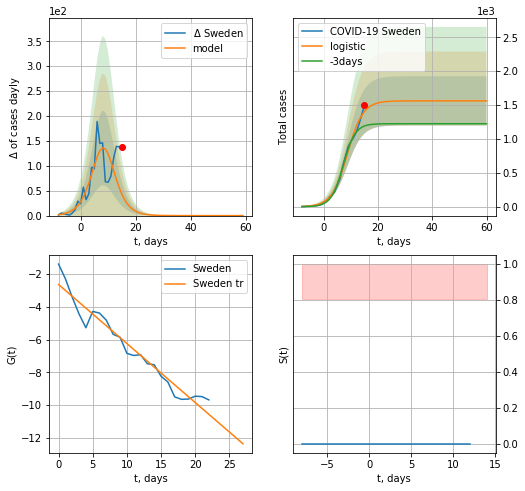

Sweden data at: 2020-11-18
+3 day model MAPE: 0.20348254679733155
model: logistic
coeffs:  [1.56232986e+03 3.49134536e-01 8.72829156e+00]
rational stdev:  0.2329336409619122
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  1562 ± 363
	 total death:  50 ± 34
trend coefficient of determination: 0.947679
 intercept: -2.633085
 slope: -0.360867


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


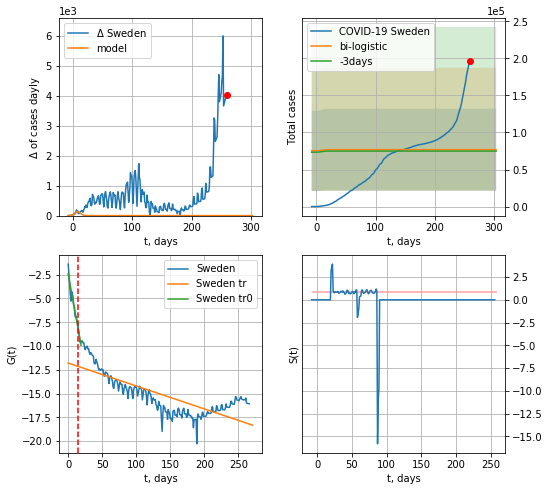

Sweden data at: 2020-11-18
+3 day model MAPE: 0.02469699734100283
model: bi-logistic
coeffs:  [ 6.01649356e+04 -2.16337889e+01  5.26817037e+02] [1.56232986e+03 3.49134536e-01 8.72829156e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7193116284595965
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  76768 ± 55220
	 total death:  2470 ± 5330
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.906612
 intercept: -2.393320
 slope: -0.396924
trend coefficient of determination: 0.609428
 intercept: -11.792152
 slope: -0.024127


In [620]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
try:
    x = forecast('Sweden',dfSW[:-9-dT],d1,7*T18-dT,1.0)
    xx = forecast2('Sweden',dfSW[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)
except:
    print ("Exception occurs")

SW
           date   cases  active   death
263 2020-11-14  181011       0  6164.0
264 2020-11-15  184743       0  6164.0
265 2020-11-16  188551       0  6164.0
266 2020-11-17  192439       0  6225.0
267 2020-11-18  196446       0  6321.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


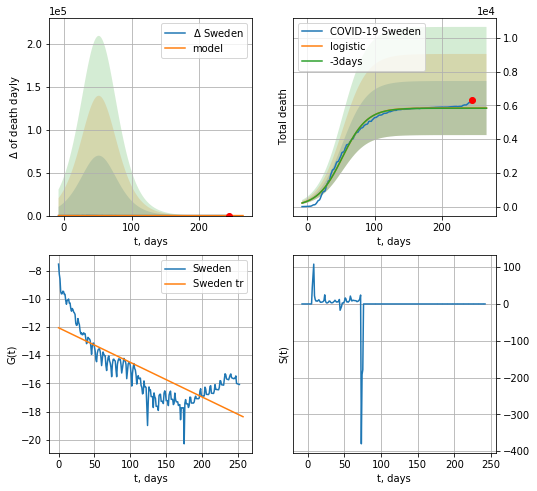

Sweden data at: 2020-11-18
+3 day model MAPE: 0.0017540049818953521
model: logistic
coeffs:  [5.83941989e+03 5.44651903e-02 5.19530089e+01]
rational stdev:  0.2742907439165576
forecast at the end of period: +21 days
	 total death:  5839 ± 1601
trend coefficient of determination: 0.610922
 intercept: -12.057829
 slope: -0.024556


In [621]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


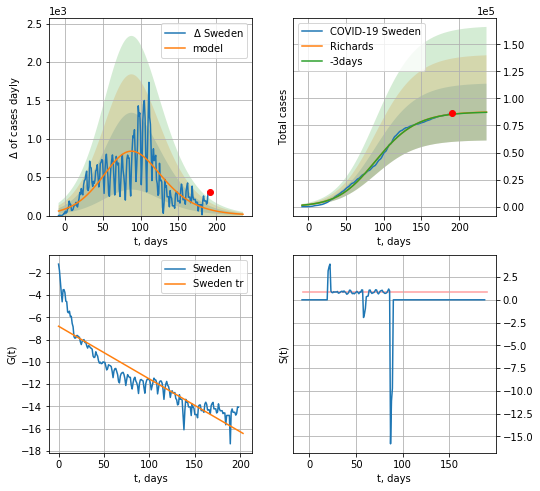

Sweden data at: 2020-11-18
+3 day model MAPE: 0.001624
model: Richards
coeffs: [8.78275804e+04 4.73720199e-02 8.00051782e+01 7.42307087e-01]
rational stdev: 0.300484
forecast at the end of period: +45 days
	 deltaDaycases: 17
	 total cases: 87339 ± 26244
	 total death: 2810 ± 2533
trend coefficient of determination: 0.834538
 intercept: -6.794116
 slope: -0.047468
diffStd0a 0.5422723992294732


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


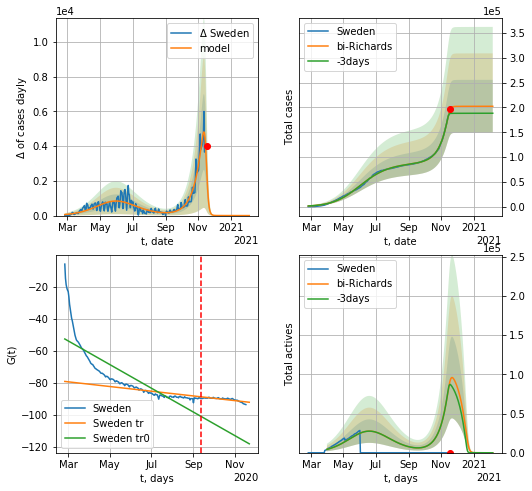

Sweden data at: 2020-11-18
+3 day model MAPE: 0.051198
model: bi-Richards
coeffs: [1.14565300e+05 6.36848576e-02 2.57685957e+02 7.34812071e+00]
rational stdev: 0.263803
forecast at the end of period: +80 days
	 deltaDaycases: 0
	 total cases: 202379 ± 53388
	 total death: 6511 ± 5152
bi-Richards approximation splitting point: 200
actives k: 35
trend coefficient of determination: 0.694184
 intercept: -52.513342
 slope: -0.241394
trend coefficient of determination: 0.659728
 intercept: -79.006249
 slope: -0.047926


In [622]:
iL = 0
vL = 200+iL
x = forecastRR('Sweden',dfSW[iL:vL-iL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Sweden',dfSW[iL:],d12f(1),45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


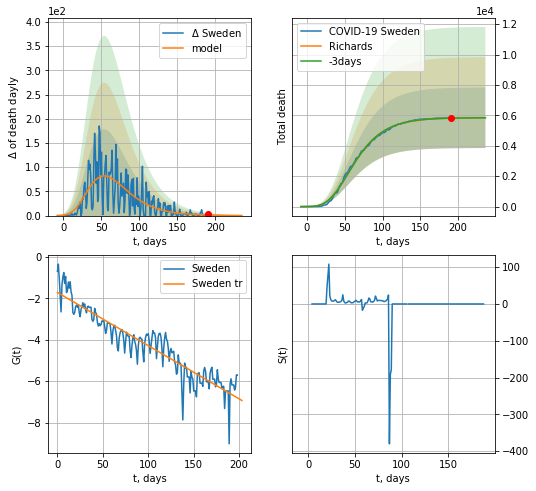

Sweden data at: 2020-11-18
+3 day model MAPE: 0.000256
model: Richards
coeffs: [ 5.85009942e+03  5.32969247e+00 -7.51000999e+01  7.17288964e-03]
rational stdev: 0.340889
forecast at the end of period: +45 days
	 total death: 5844 ± 1992
trend coefficient of determination: 0.868929
 intercept: -1.718480
 slope: -0.025701
diffStd0a 4.219254924024936


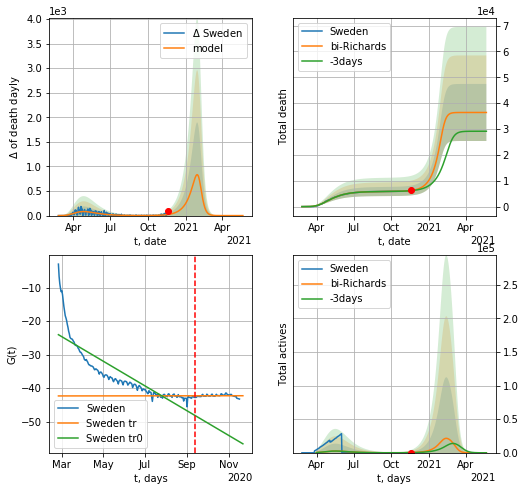

Sweden data at: 2020-11-18
+3 day model MAPE: 0.010927
model: bi-Richards
coeffs: [3.05404070e+04 5.58002016e-02 3.38134558e+02 3.23089193e+00]
rational stdev: 0.302999
forecast at the end of period: +185 days
	 total death: 36390 ± 11026
bi-Richards approximation splitting point: 200
actives k: 35
trend coefficient of determination: 0.733087
 intercept: -24.028638
 slope: -0.120360
trend coefficient of determination: 0.000122
 intercept: -42.334258
 slope: 0.000216


In [625]:
vL = 200
x = forecastRR('Sweden',dfSW[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RRD('Sweden',dfSW[:],d1,60*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

In [626]:
#x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


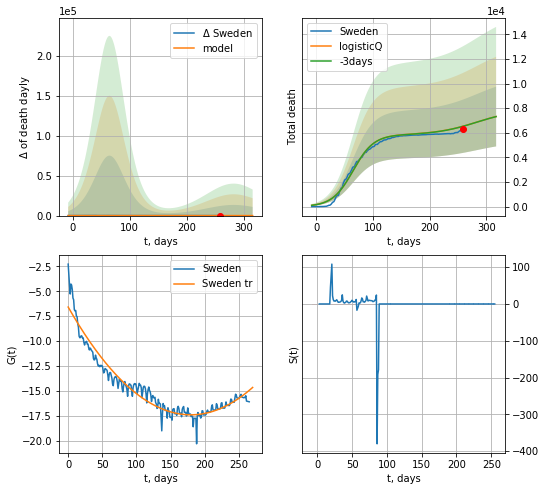

Sweden data at: 2020-11-18
+3 day model MAPE: 0.001028
model: logisticQ
coeffs: [ 5.83639212e+03  8.64089888e-08  6.49542889e+01 -6.35687842e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.331654
forecast at the end of period: +59 days
	 total death: 7321 ± 2428
trend coefficient of determination: 0.931360
 intercept_: -6.585277139980809
 coeffs_: [ 0.         -0.1203285   0.00033512]


In [627]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
297 2020-11-14  86338.0     385  4634.0
298 2020-11-15  86346.0     374  4634.0
299 2020-11-16  86361.0     353  4634.0
300 2020-11-17  86369.0     324  4634.0
301 2020-11-18  86381.0     314  4634.0


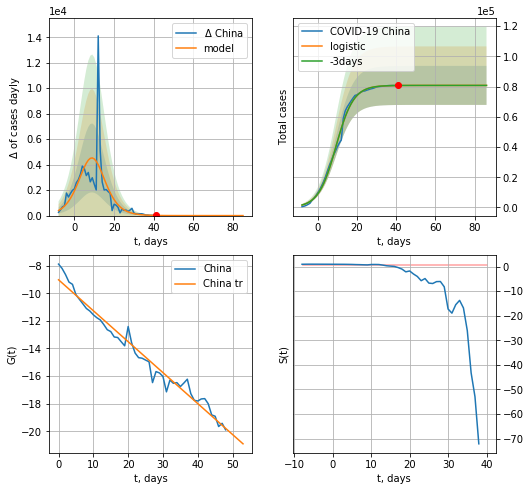

China data at: 2020-11-18
+3 day model MAPE: 0.00012785692963974442
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.159713160092933
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  80810 ± 12906
	 total death:  4335 ± 2077
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


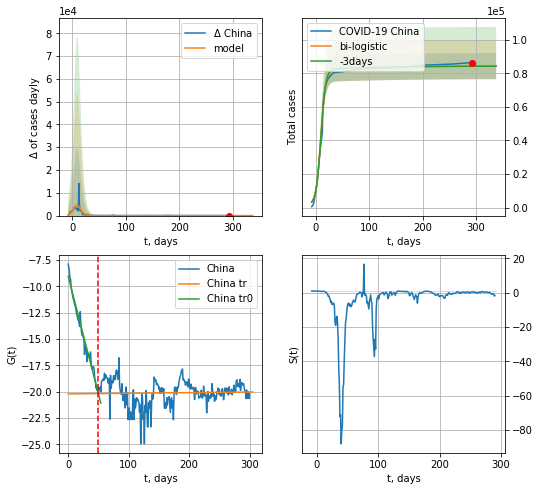

China data at: 2020-11-18
+3 day model MAPE: 0.00039964271929800123
model: bi-logistic
coeffs:  [3.61770912e+03 1.18733217e-02 1.02528656e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.09238441321099221
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  84355 ± 7793
	 total death:  4525 ± 1254
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.001448
 intercept: -20.216473
 slope: 0.000607


In [628]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*T18-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [629]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

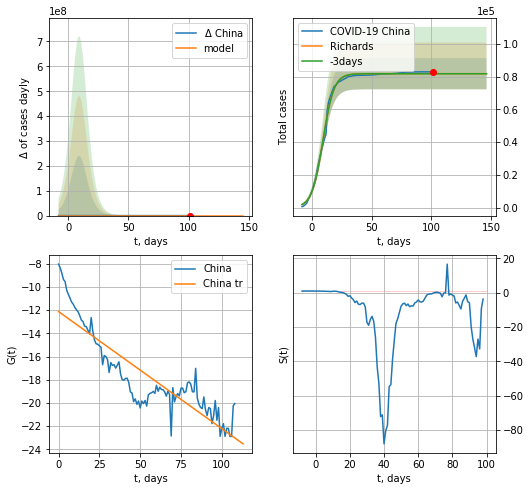

China data at: 2020-11-18
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736184e+04 2.15574455e-01 9.59539709e+00 1.02116174e+00]
rational stdev: 0.116457
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4386 ± 1532
trend coefficient of determination: 0.785239
 intercept: -12.125055
 slope: -0.100960
diffStd0a 3.61038267830115


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


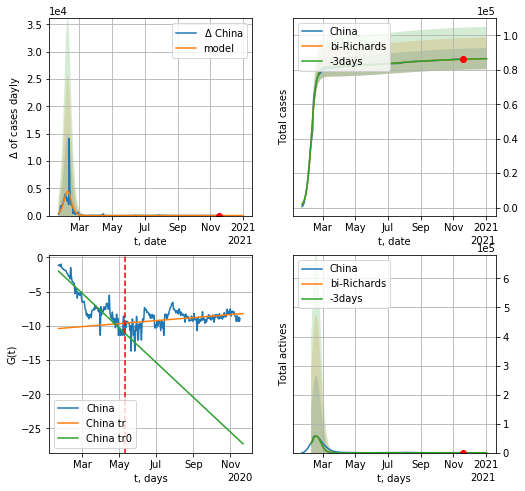

China data at: 2020-11-18
+3 day model MAPE: 0.000287
model: bi-Richards
coeffs: [ 5.25298162e+03  2.30595611e+00 -2.62725848e+02  5.39766512e-03]
rational stdev: 0.070976
forecast at the end of period: +45 days
	 deltaDaycases: 6
	 total cases: 86503 ± 6139
	 total death: 4640 ± 987
bi-Richards approximation splitting point: 110
actives k: 17
trend coefficient of determination: 0.820990
 intercept: -2.007333
 slope: -0.082728
trend coefficient of determination: 0.141186
 intercept: -10.391904
 slope: 0.007159


In [630]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,T18*7-dT,1.0)
xx = forecast2RRD('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=vL,amc=0.5)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

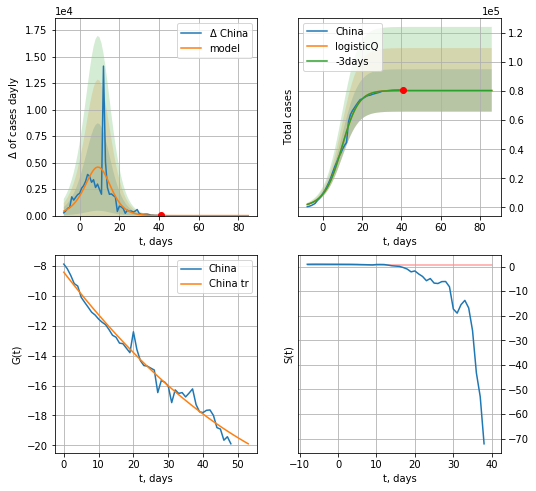

China data at: 2020-11-18
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650464e-03  9.35257489e+00 -2.02425637e+02]
rational stdev: 0.181019
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 80417 ± 14557
	 total death: 4314 ± 2342
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


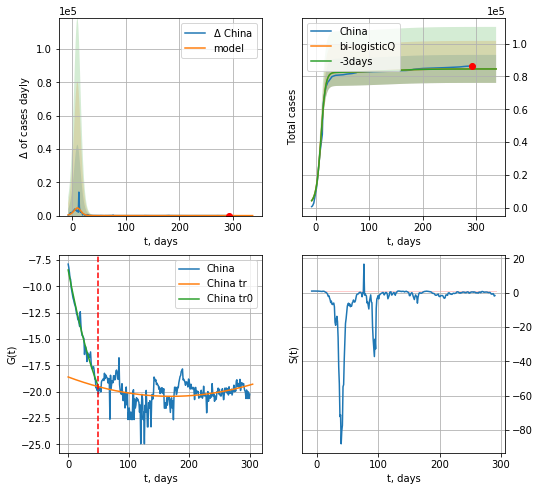

China data at: 2020-11-18
+3 day model MAPE: 0.000491
model: bi-logisticQ
coeffs: [ 4.19765102e+03  7.40537585e-05  2.47486242e+01 -5.27431278e-02]
rational stdev: 0.100962
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 84613 ± 8542
	 total death: 4539 ± 1374
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.067901
 intercept_: -18.60568374442668
 coeffs_: [ 0.00000000e+00 -2.16105595e-02  6.34794772e-05]


In [631]:
x = forecastRRR('China',dfCN[:50],d1,7*T18-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)

In [632]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
273 2020-11-14  28546  2362.0  493.0
274 2020-11-15  28769  2516.0  494.0
275 2020-11-16  28998  2644.0  494.0
276 2020-11-17  29311  2842.0  496.0
277 2020-11-18  29654  3058.0  498.0


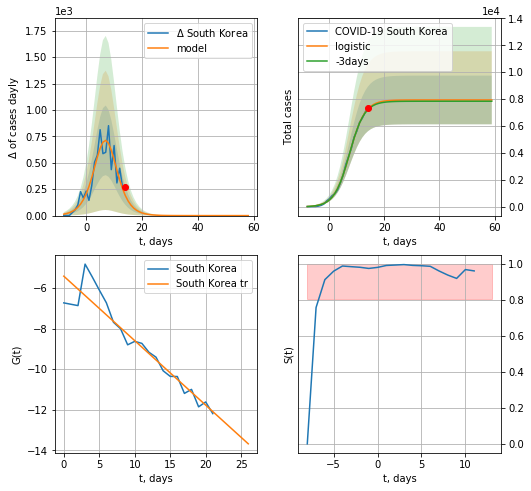

South Korea data at: 2020-11-18
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  7941 ± 1807
	 total death:  133 ± 90
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


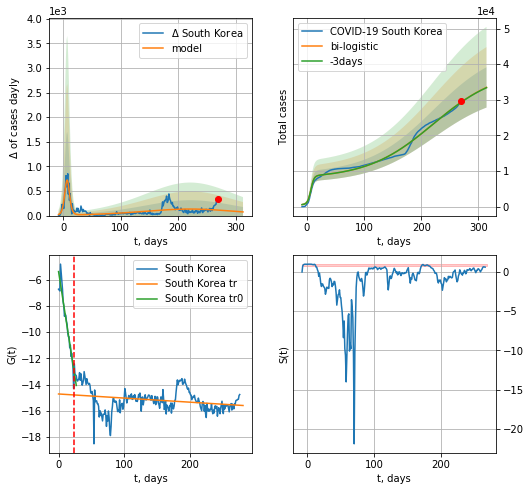

South Korea data at: 2020-11-18
+3 day model MAPE: 0.0011852755585394631
model: bi-logistic
coeffs:  [3.06633967e+04 1.73738915e-02 2.21488393e+02] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.16898073652590875
forecast at the end of period: +45 days
	 deltaDaycases:  74
	 total cases:  33484 ± 5658
	 total death:  562 ± 284
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.066334
 intercept: -14.714405
 slope: -0.003118


In [633]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*T18-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,T18*7-dT,x,1.0,vL=23)

In [634]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

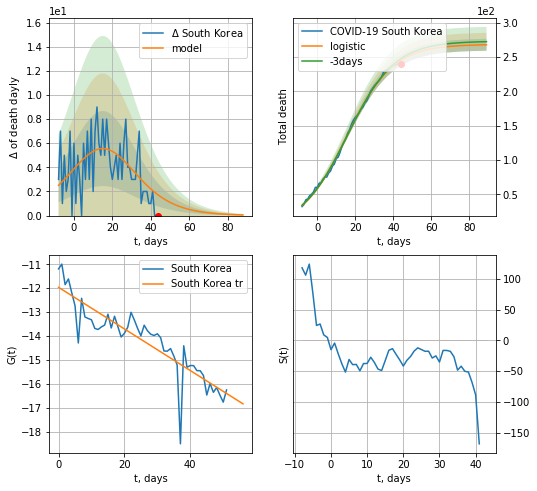

South Korea data at: 2020-11-18
model: logistic
coeffs:  [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.032418936831668854
forecast at the end of period: +45 days
	 total death:  267 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in true_divide


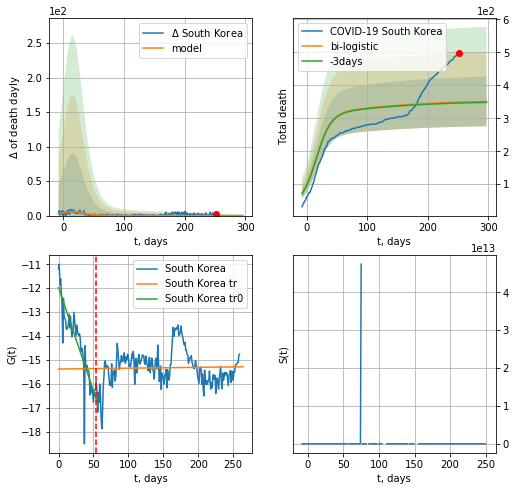

South Korea data at: 2020-11-18
+3 day model MAPE: 0.007557812236753734
model: bi-logistic
coeffs:  [8.63767198e+01 1.07780114e-02 9.76834691e+00] [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.21456553443054666
forecast at the end of period: +45 days
	 deltaDaydeath:  0
	 total death:  351 ± 75
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.000897
 intercept: -15.381400
 slope: 0.000351


In [635]:
x = forecast('South Korea',dfKR[17:70],d1,T18*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,T18*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


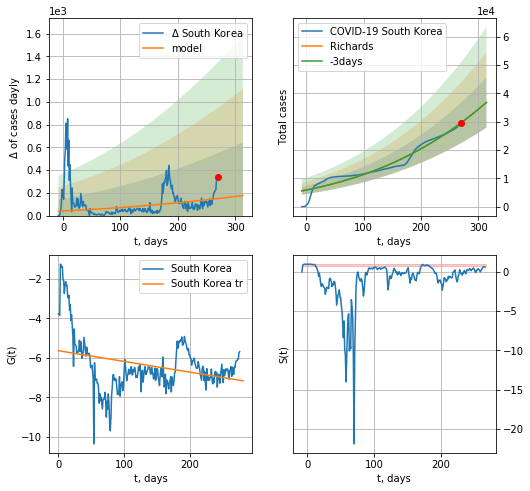

South Korea data at: 2020-11-18
+3 day model MAPE: 0.000174
model: Richards
coeffs: [ 7.99595437e+05  1.56828330e-02 -1.28130973e+02  1.18433324e-01]
rational stdev: 0.241508
forecast at the end of period: +45 days
	 deltaDaycases: 176
	 total cases: 36810 ± 8890
	 total death: 618 ± 447
trend coefficient of determination: 0.098960
 intercept: -5.632700
 slope: -0.005423


In [636]:
x = forecastRR('South Korea',dfKR[:],d1,T18*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


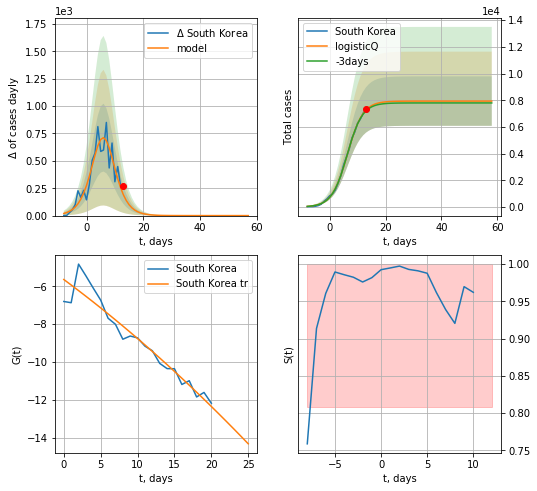

South Korea data at: 2020-11-18
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644740e+03  5.70893336e-05  6.37140939e+00 -6.30084107e+03]
rational stdev: 0.233522
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 7936 ± 1853
	 total death: 133 ± 93
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


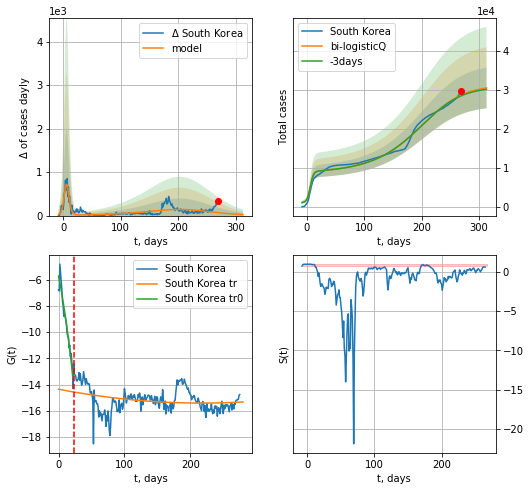

South Korea data at: 2020-11-18
+3 day model MAPE: 0.006407
model: bi-logisticQ
coeffs: [ 2.32290106e+04  4.21048317e-05  1.91186363e+02 -3.76654773e+02]
rational stdev: 0.171254
forecast at the end of period: +45 days
	 deltaDaycases: 22
	 total cases: 30508 ± 5224
	 total death: 512 ± 263
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.078170
 intercept_: -14.351137777608127
 coeffs_: [ 0.00000000e+00 -9.70109086e-03  2.22471126e-05]


In [637]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,T18*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,T18*7-dT,x,1.0,vL=vL)

In [638]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

In [639]:
#vL=25
#x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
#xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


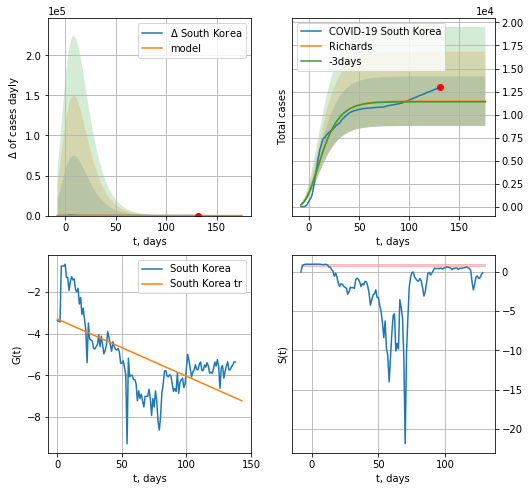

South Korea data at: 2020-11-18
+3 day model MAPE: 0.006245
model: Richards
coeffs: [ 1.14621909e+04  2.64955361e+01 -6.29475021e+01  3.05260511e-03]
rational stdev: 0.234092
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 11462 ± 2683
	 total death: 192 ± 134
trend coefficient of determination: 0.403266
 intercept: -3.307543
 slope: -0.027367
diffStd0a 1.1776110668430049


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


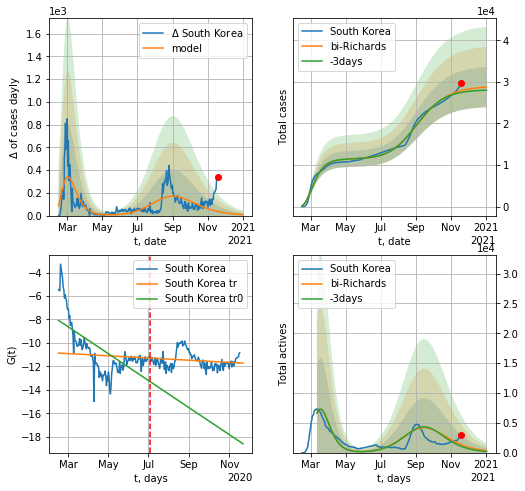

South Korea data at: 2020-11-18
+3 day model MAPE: 0.015771
model: bi-Richards
coeffs: [1.75325153e+04 5.56620060e-02 1.77386289e+02 6.19192505e-01]
rational stdev: 0.167784
forecast at the end of period: +45 days
	 deltaDaycases: 8
	 total cases: 28742 ± 4822
	 total death: 482 ± 242
bi-Richards approximation splitting point: 140
actives k: 26
trend coefficient of determination: 0.449243
 intercept: -8.073045
 slope: -0.037465
trend coefficient of determination: 0.033473
 intercept: -10.861840
 slope: -0.003073


In [640]:
iL = 0
vL = 140+iL
x = forecastRR('South Korea',dfKR[iL:vL-iL],d1,T18*7-dT,1.0)
xx=forecast2RRD('South Korea',dfKR[iL:],d1,T18*7-dT,x,1.0,vL=vL-iL,amc=0.75)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [641]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

In [642]:
#x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
296 2020-11-14  58119.0      72   28.0
297 2020-11-15  58124.0      67   28.0
298 2020-11-16  58130.0      69   28.0
299 2020-11-17  58135.0      68   28.0
300 2020-11-18  58139.0      65   28.0


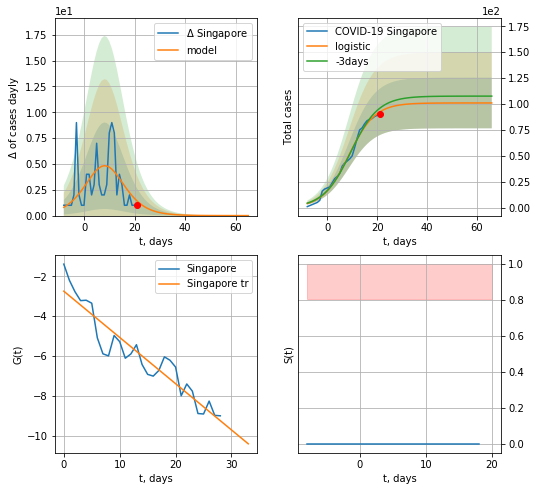

Singapore data at: 2020-11-18
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  101 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


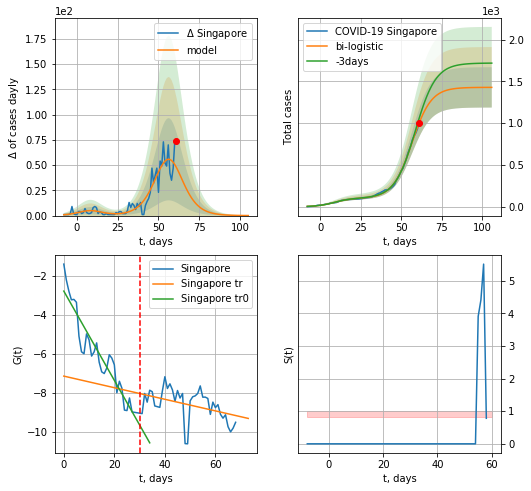

Singapore data at: 2020-11-18
+3 day model MAPE: 0.06119827726371909
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112356490856
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:354: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


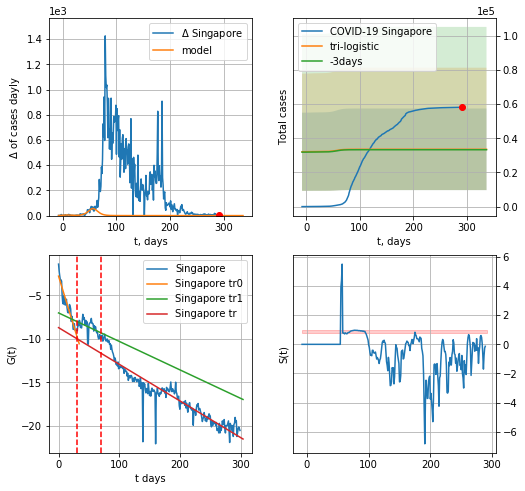

Singapore data at: 2020-11-18
+3 day model MAPE: 0.007437053382762815
model: tri-logistic
coeffs:  [ 3.21120145e+04 -1.99686979e+01  4.80971043e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.7119976436649934
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  33539 ± 23880
	 total death:  16 ± 34
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.876960
 intercept: -8.704137
 slope: -0.042219


In [643]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,T18*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

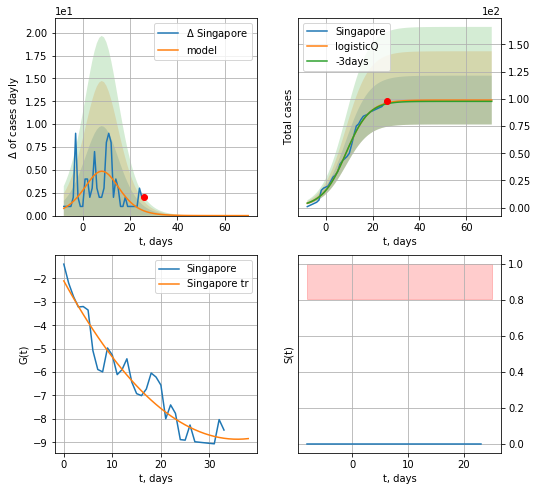

Singapore data at: 2020-11-18
+3 day model MAPE: 0.007575
model: logisticQ
coeffs: [ 9.88556613e+01  2.70689941e-04  8.43151450e+00 -7.17657610e+02]
rational stdev: 0.226599
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


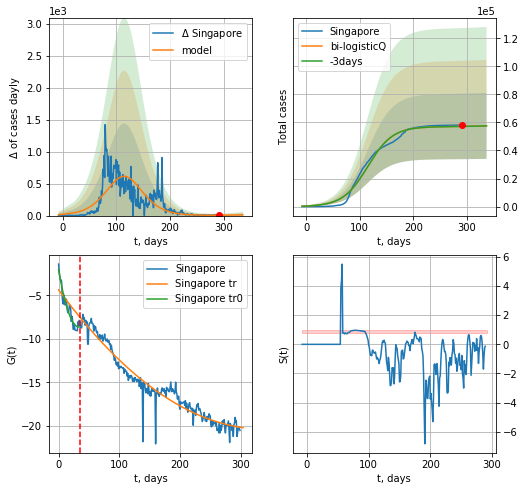

Singapore data at: 2020-11-18
+3 day model MAPE: 0.000734
model: bi-logisticQ
coeffs: [ 5.69104175e+04  5.11814549e-08  1.14802215e+02 -8.45690231e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.408480
forecast at the end of period: +45 days
	 deltaDaycases: 11
	 total cases: 57563 ± 23513
	 total death: 27 ± 33
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.942004
 intercept_: -4.345254629658189
 coeffs_: [ 0.         -0.09484592  0.00014008]


In [644]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d12f(1),T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [645]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


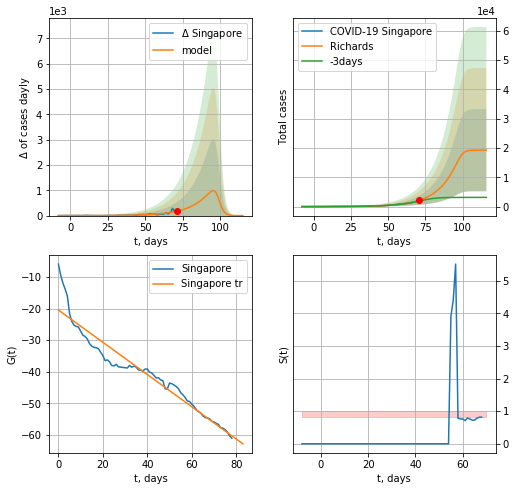

Singapore data at: 2020-11-18
+3 day model MAPE: 0.158856
model: Richards
coeffs: [1.92302023e+04 7.72500001e-02 9.92482833e+01 7.56752958e+00]
rational stdev: 0.728321
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 19230 ± 14005
	 total death: 9 ± 19
trend coefficient of determination: 0.919778
 intercept: -20.482187
 slope: -0.510333
diffStd0a 0.44696215192597555


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


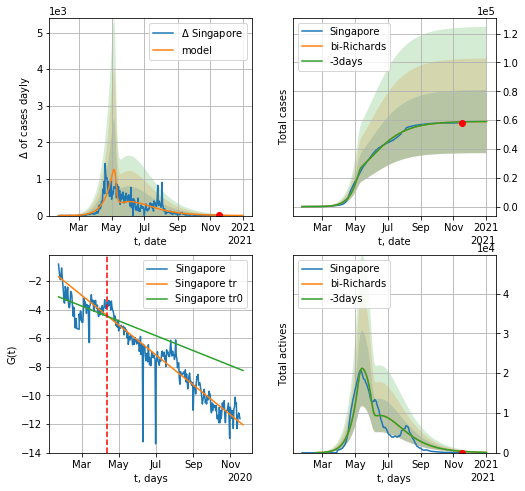

Singapore data at: 2020-11-18
+3 day model MAPE: 0.000660
model: bi-Richards
coeffs: [3.98357053e+04 1.52799283e-01 6.48222928e+01 1.86388284e-01]
rational stdev: 0.370983
forecast at the end of period: +45 days
	 deltaDaycases: 2
	 total cases: 58974 ± 21878
	 total death: 28 ± 31
bi-Richards approximation splitting point: 80
actives k: 26
trend coefficient of determination: 0.143155
 intercept: -3.108944
 slope: -0.016946
trend coefficient of determination: 0.862903
 intercept: -1.702102
 slope: -0.034074


In [646]:
iL = 0
vL = 80+iL
x = forecastRR('Singapore',dfSG[iL:vL-iL],d1,T18*7-dT,1.0)
x = forecast2RRD('Singapore',dfSG[iL:],d12f(1),T18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
#x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

In [647]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    #x = forecast('Estonia',dfES[1:7],d1,17,1.)
    #xx = forecast2('Estonia',dfES[1:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

ES
           date   cases  active  death
247 2020-11-14  7637.0    2815   81.0
248 2020-11-15  7848.0    3018   81.0
249 2020-11-16  8033.0    2973   83.0
250 2020-11-17  8304.0    3099   85.0
251 2020-11-18  8715.0    3366   85.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


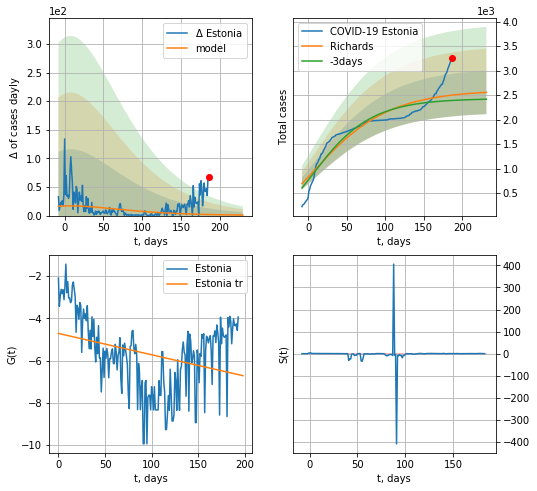

Estonia data at: 2020-11-18
+3 day model MAPE: 0.045435
model: Richards
coeffs: [ 2.60588093e+03  2.79002184e+00 -2.75729567e+02  6.38503599e-03]
rational stdev: 0.174012
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 2557 ± 445
	 total death: 24 ± 12
trend coefficient of determination: 0.100431
 intercept: -4.712830
 slope: -0.010110
diffStd0a 0.9412058201881977


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


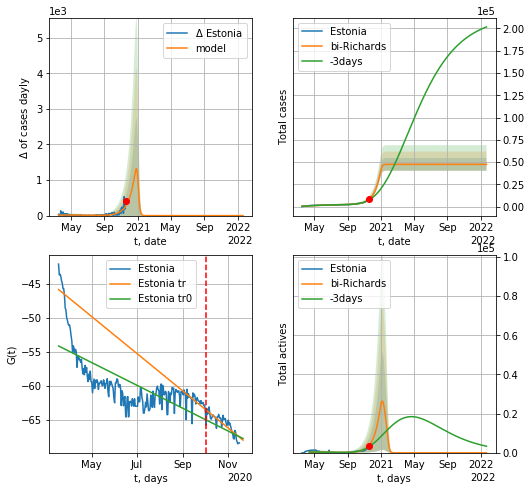

Estonia data at: 2020-11-18
+3 day model MAPE: 0.087851
model: bi-Richards
coeffs: [4.49712481e+04 4.47775087e-02 2.83469647e+02 7.20634671e+00]
rational stdev: 0.150455
forecast at the end of period: +430 days
	 deltaDaycases: 0
	 total cases: 47577 ± 7158
	 total death: 464 ± 209
bi-Richards approximation splitting point: 200
actives k: 26
trend coefficient of determination: 0.500034
 intercept: -54.138544
 slope: -0.054565
trend coefficient of determination: 0.713177
 intercept: -45.812938
 slope: -0.088844


In [648]:
iL = 5
vL=200+iL
x = forecastRR('Estonia',dfES[iL:vL-iL],d1,7*T18-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RRD('Estonia',dfES[iL:],d12f(1),7*95-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)

In [649]:
#x = forecastRRR('Estonia',dfES[:],d1,7*T18-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date    cases  active  death
252 2020-11-14  10231.0    8595  121.0
253 2020-11-15  10547.0    8909  123.0
254 2020-11-16  10636.0    8995  126.0
255 2020-11-17  10914.0    9225  132.0
256 2020-11-18  11356.0    9662  137.0


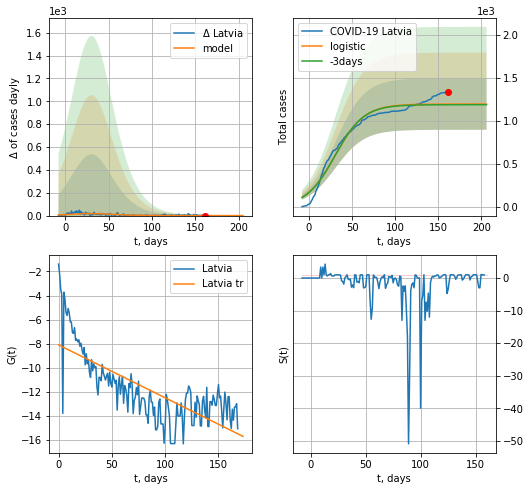

Latvia data at: 2020-11-18
+3 day model MAPE: 0.006385594006530808
model: logistic
coeffs:  [1.19448476e+03 5.92278882e-02 3.05409104e+01]
rational stdev:  0.2505192877675996
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  1194 ± 299
	 total death:  14 ± 10
trend coefficient of determination: 0.548772
 intercept: -8.111036
 slope: -0.044049


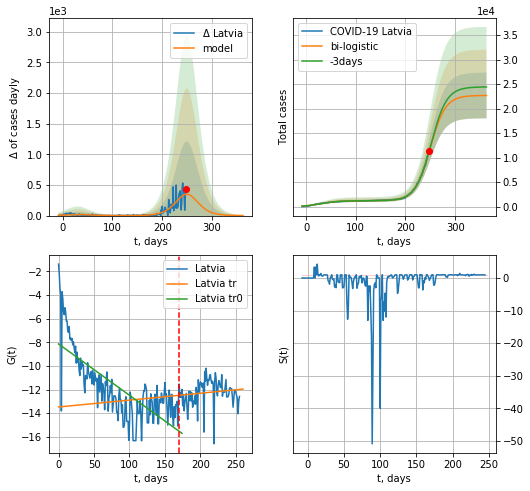

Latvia data at: 2020-11-18
+3 day model MAPE: 0.012165211070621202
model: bi-logistic
coeffs:  [2.15140227e+04 6.50147107e-02 2.49643079e+02] [1.19448476e+03 5.92278882e-02 3.05409104e+01]
rational stdev:  0.20564825115463953
forecast at the end of period: +115 days
	 deltaDaycases:  0
	 total cases:  22694 ± 4667
	 total death:  273 ± 168
bi-logistic approximation splitting point: 170
trend0 coefficient of determination: 0.544306
 intercept: -8.141730
 slope: -0.043501
trend coefficient of determination: 0.018506
 intercept: -13.478961
 slope: 0.005819


In [650]:
vL=170
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,T18*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,50*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


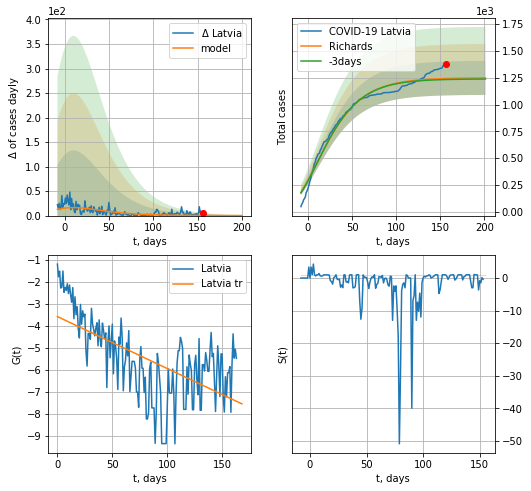

Latvia data at: 2020-11-18
+3 day model MAPE: 0.007772
model: Richards
coeffs: [ 1.24930626e+03  6.40625024e+00 -1.35573848e+02  5.54745387e-03]
rational stdev: 0.126894
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 1247 ± 158
	 total death: 15 ± 5
trend coefficient of determination: 0.384319
 intercept: -3.580648
 slope: -0.023612


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


diffStd0a 1.0275437958701206


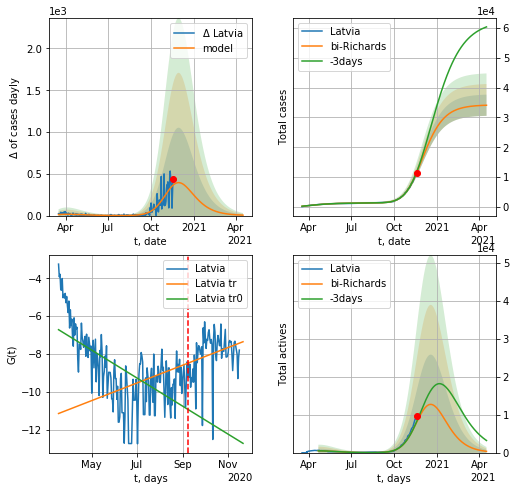

Latvia data at: 2020-11-18
+3 day model MAPE: 0.020304
model: bi-Richards
coeffs: [3.29901868e+04 8.25563466e-02 2.31625712e+02 4.86754386e-01]
rational stdev: 0.104452
forecast at the end of period: +150 days
	 deltaDaycases: 5
	 total cases: 34113 ± 3563
	 total death: 411 ± 128
bi-Richards approximation splitting point: 175
actives k: 35
trend coefficient of determination: 0.387973
 intercept: -6.712681
 slope: -0.024024
trend coefficient of determination: 0.079496
 intercept: -11.142246
 slope: 0.015173


In [651]:
iL=10
vL = 175+iL
x = forecastRR('Latvia',dfLV[iL:vL-iL],d1,7*T18-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Latvia',dfLV[iL:],d12f(1),7*55-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

In [652]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
#x = forecastRRR('Latvia',dfLV[:],d1,7*T18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


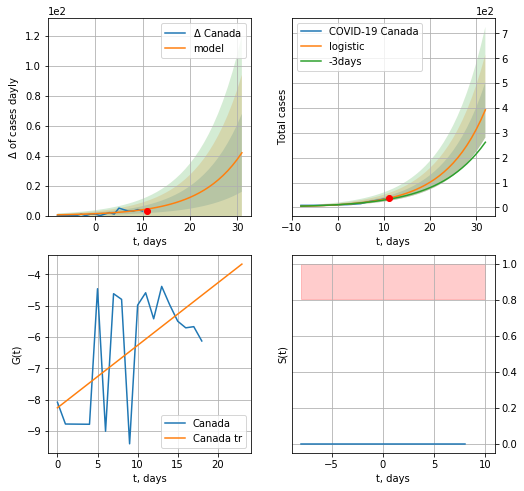

Canada data at: 2020-11-18
+3 day model MAPE: 0.14133490187696762
model: logistic
coeffs:  [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2833740936364515
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  14 ± 11
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


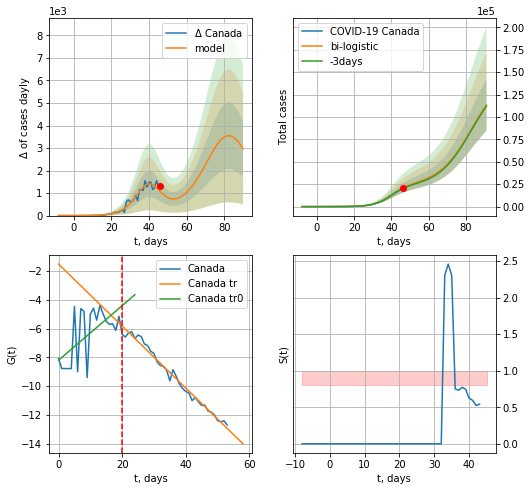

Canada data at: 2020-11-18
+3 day model MAPE: 0.029367009846107475
model: bi-logistic
coeffs:  [2.40153999e+04 2.16961374e-01 4.02658690e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2549294005106464
forecast at the end of period: +45 days
	 deltaDaycases:  2964
	 total cases:  113561 ± 28950
	 total death:  4083 ± 3122
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


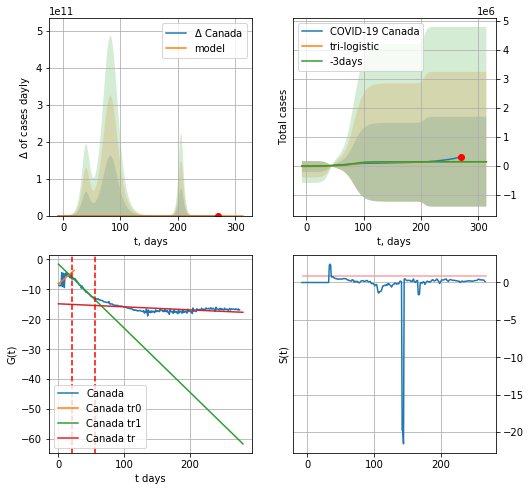

Canada data at: 2020-11-18
+3 day model MAPE: 0.035196905971392856
model: tri-logistic
coeffs:  [-1.82411804e+04 -3.58318013e-01  2.05885124e+02] [1.25342997e+05 1.13222116e-01 8.29018541e+01 2.40153999e+04
 2.16961374e-01 4.02658690e+01]
forecast rational stdev:  10.342572560723035
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  149358 ± 1544750
	 total death:  5370 ± 166618
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.305909
 intercept: -14.826873
 slope: -0.010088


In [653]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,T18*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active    death
273 2020-11-14  291931.0   48125  10891.0
274 2020-11-15  296077.0   49723  10953.0
275 2020-11-16  302192.0   50878  11027.0
276 2020-11-17  306468.0   51230  11086.0
277 2020-11-18  311109.0   51602  11186.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


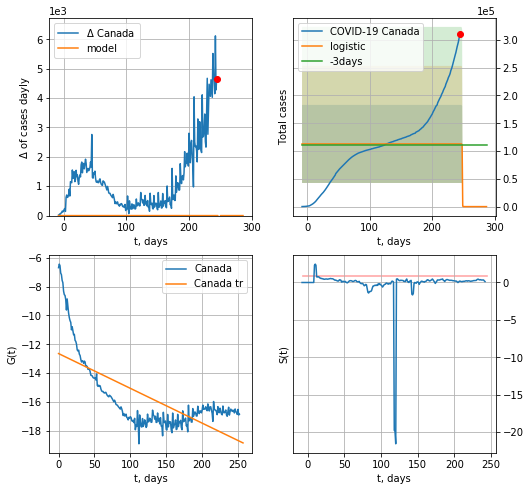

Canada data at: 2020-11-18
+3 day model MAPE: 0.020982636116273653
model: logistic
coeffs:  [ 1.12738831e+05 -9.30884085e+00  2.48474301e+02]
rational stdev:  0.6225174651476251
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.484563
 intercept: -12.647498
 slope: -0.024107


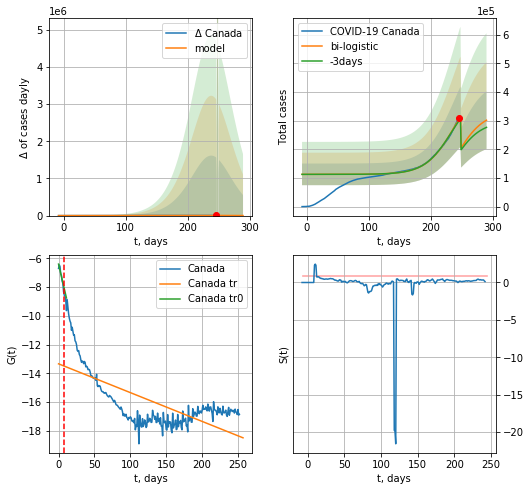

Canada data at: 2020-11-18
+3 day model MAPE: 0.0186242872262298
model: bi-logistic
coeffs:  [3.32760336e+05 4.40798424e-02 2.38255391e+02] [ 1.12738831e+05 -9.30884085e+00  2.48474301e+02]
rational stdev:  0.3352741765259965
forecast at the end of period: +45 days
	 deltaDaycases:  1256
	 total cases:  301907 ± 101221
	 total death:  10855 ± 10918
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.462264
 intercept: -13.335404
 slope: -0.020044


In [654]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,T18*7-dT,x,1.,vL=31-24,cases='cases')

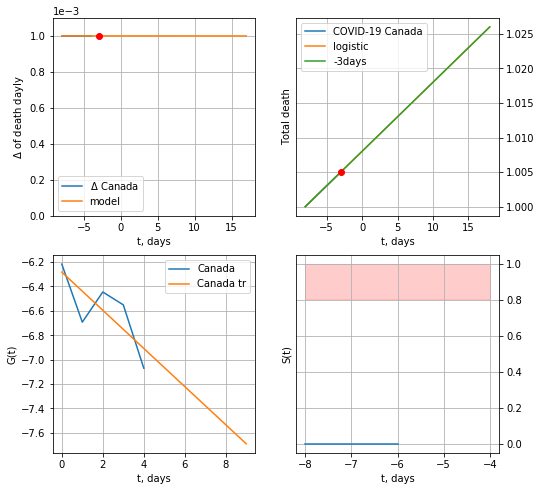

Canada data at: 2020-11-18
+3 day model MAPE: 6.189159426418585e-07
model: logistic
coeffs:  [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  1.593569349221903e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


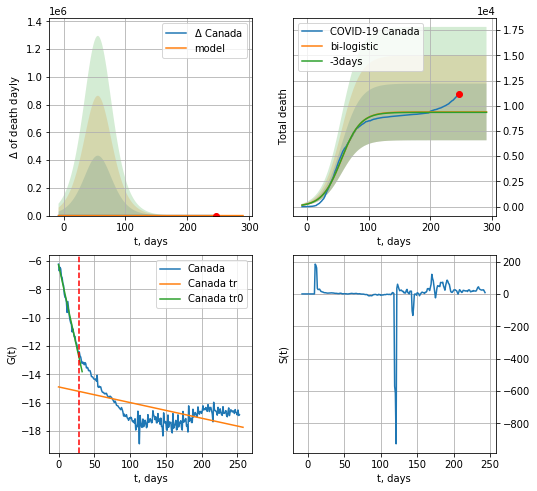

Canada data at: 2020-11-18
+3 day model MAPE: 0.004462507668339508
model: bi-logistic
coeffs:  [9.39021759e+03 6.40749956e-02 5.59217920e+01] [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  0.29933061486486867
forecast at the end of period: +45 days
	 deltaDaydeath:  0
	 total death:  9391 ± 2811
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.333190
 intercept: -14.887098
 slope: -0.011048


In [655]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,T18*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


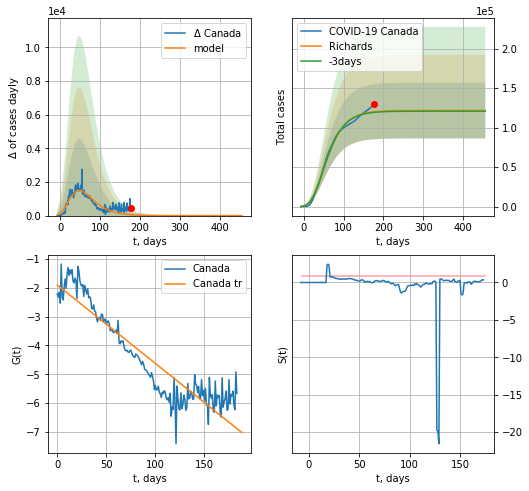

Canada data at: 2020-11-18
+3 day model MAPE: 0.006183
model: Richards
coeffs: [ 1.21659605e+05  6.14824851e+00 -1.08149315e+02  5.44441705e-03]
rational stdev: 0.289891
forecast at the end of period: +280 days
	 deltaDaycases: 0
	 total cases: 121659 ± 35267
	 total death: 4374 ± 3803
trend coefficient of determination: 0.846084
 intercept: -1.903764
 slope: -0.027207
diffStd0a 0.9781000167417565


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


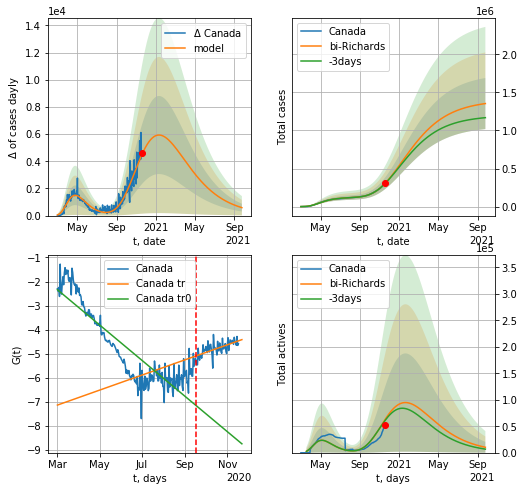

Canada data at: 2020-11-18
+3 day model MAPE: 0.008140
model: bi-Richards
coeffs: [1.27780450e+06 4.22086170e-01 3.46094814e+01 3.03499180e-02]
rational stdev: 0.247960
forecast at the end of period: +311 days
	 deltaDaycases: 585
	 total cases: 1353195 ± 335538
	 total death: 48654 ± 36192
bi-Richards approximation splitting point: 200
actives k: 17
trend coefficient of determination: 0.775402
 intercept: -2.341524
 slope: -0.024080
trend coefficient of determination: 0.391379
 intercept: -7.136701
 slope: 0.010227


In [656]:
iL = 15
vL = 200 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,T18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Canada',dfCA[iL:],d1,78*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)
#x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

In [657]:
#x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date   cases  active   death
257 2020-11-14  211266   85444  3305.0
258 2020-11-15  217301   88854  3381.0
259 2020-11-16  225672   80045  3472.0
260 2020-11-17  230124   77126  3553.0
261 2020-11-18  236015   78681  3632.0


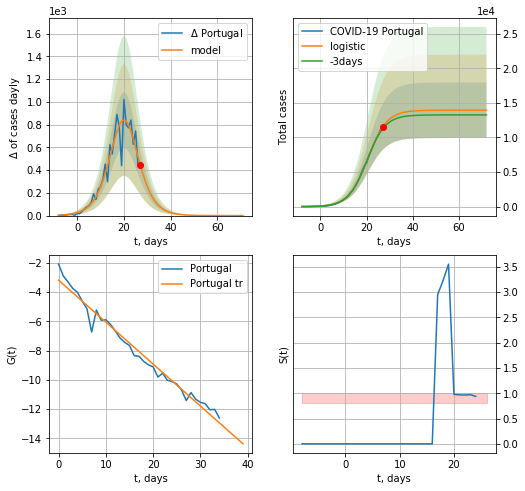

Portugal data at: 2020-11-18
+3 day model MAPE: 0.02876881186141646
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.28806592053196767
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  13943 ± 4016
	 total death:  214 ± 184
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


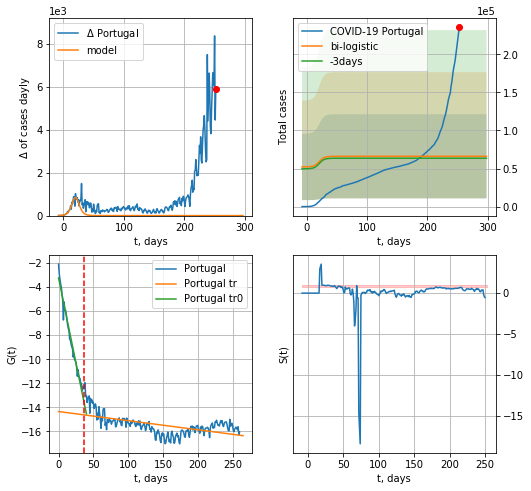

Portugal data at: 2020-11-18
+3 day model MAPE: 0.03986328367928651
model: bi-logistic
coeffs:  [ 4.17073801e+04 -1.49842936e+01  3.66356430e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.8359277676796315
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  66077 ± 55236
	 total death:  1016 ± 2547
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.322442
 intercept: -14.356225
 slope: -0.007583


In [658]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,T18*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


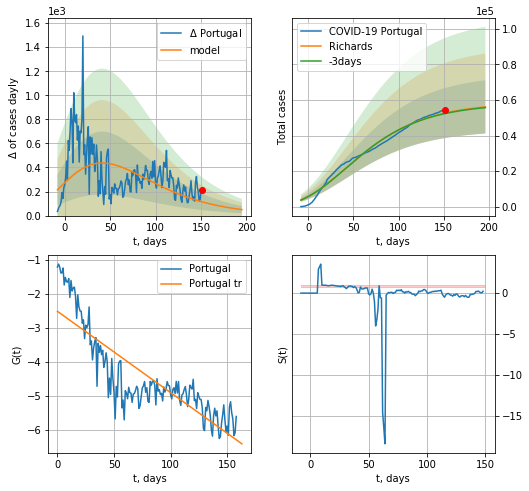

Portugal data at: 2020-11-18
+3 day model MAPE: 0.005487
model: Richards
coeffs: [ 5.85732808e+04  3.00313335e+00 -2.03470726e+02  6.78095718e-03]
rational stdev: 0.266912
forecast at the end of period: +45 days
	 deltaDaycases: 49
	 total cases: 56095 ± 14972
	 total death: 863 ± 691
trend coefficient of determination: 0.725401
 intercept: -2.517362
 slope: -0.023928
diffStd0a 0.6124367149109182


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


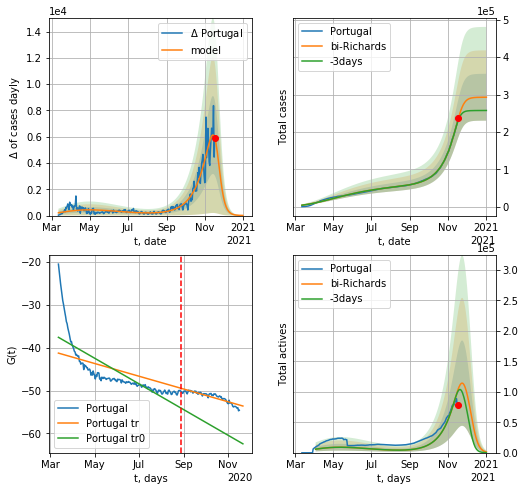

Portugal data at: 2020-11-18
+3 day model MAPE: 0.026299
model: bi-Richards
coeffs: [2.34617293e+05 4.82025421e-02 2.46710025e+02 4.11366364e+00]
rational stdev: 0.214193
forecast at the end of period: +45 days
	 deltaDaycases: 11
	 total cases: 292787 ± 62712
	 total death: 4505 ± 2894
bi-Richards approximation splitting point: 170
actives k: 22
trend coefficient of determination: 0.627170
 intercept: -37.606838
 slope: -0.097282
trend coefficient of determination: 0.809200
 intercept: -41.285308
 slope: -0.048330


In [659]:
iL = 10
vL=170+iL
x = forecastRR('Portugal',dfPT[iL:vL-iL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Portugal',dfPT[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.65)

In [660]:
#x = forecastRRR('Portugal',dfPT[:],d1,T18*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

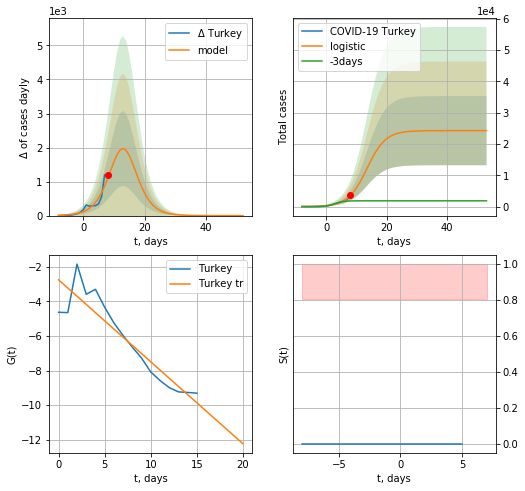

Turkey data at: 2020-11-18
+3 day model MAPE: 1.5246812178063545
model: logistic
coeffs:  [2.42671393e+04 3.25610709e-01 1.34529674e+01]
rational stdev:  0.45520285261707166
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  24267 ± 11046
	 total death:  673 ± 919
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


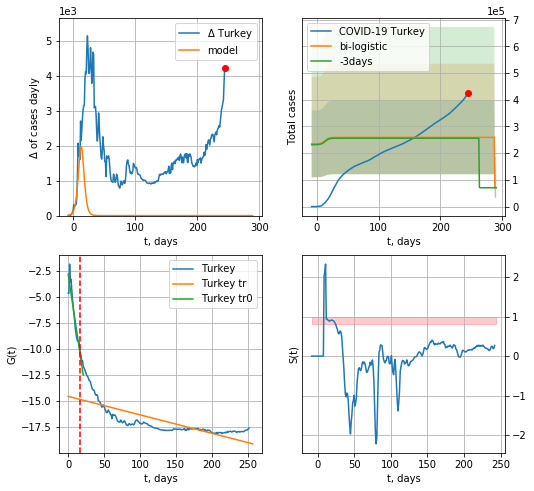

Turkey data at: 2020-11-18
+3 day model MAPE: 0.012233410183954869
model: bi-logistic
coeffs:  [ 1.87776089e+05 -7.32282998e+01  2.87245244e+02] [2.42671393e+04 3.25610709e-01 1.34529674e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5320023047249277
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  71211 ± 37884
	 total death:  1977 ± 3155
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.573960
 intercept: -14.552147
 slope: -0.017749


In [661]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*T18-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,T18*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


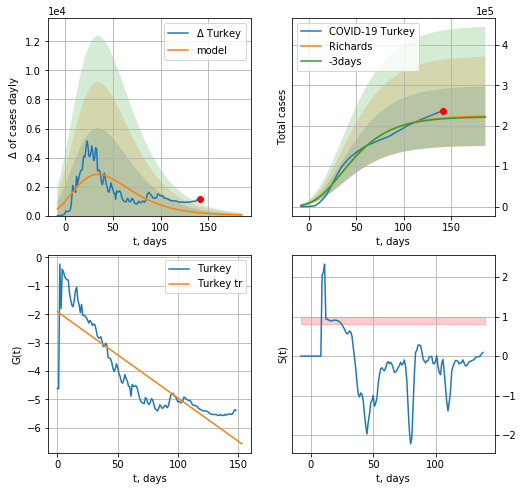

Turkey data at: 2020-11-18
+3 day model MAPE: 0.010024
model: Richards
coeffs: [ 2.24869506e+05  7.42525106e+00 -1.21298446e+02  4.63492339e-03]
rational stdev: 0.329029
forecast at the end of period: +45 days
	 deltaDaycases: 43
	 total cases: 223634 ± 73582
	 total death: 6210 ± 6129
trend coefficient of determination: 0.759895
 intercept: -1.911026
 slope: -0.030386
diffStd0a 0.2976156391580262


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


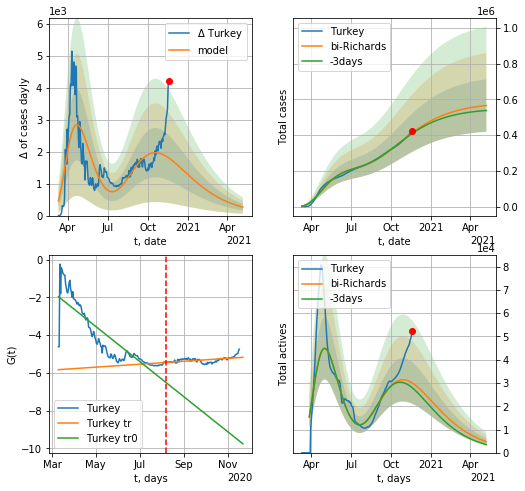

Turkey data at: 2020-11-18
+3 day model MAPE: 0.009457
model: bi-Richards
coeffs: [ 3.59403619e+05  1.49940290e+00 -9.51511003e+01  9.89049335e-03]
rational stdev: 0.258952
forecast at the end of period: +171 days
	 deltaDaycases: 262
	 total cases: 566200 ± 146618
	 total death: 15723 ± 12214
bi-Richards approximation splitting point: 150
actives k: 17
trend coefficient of determination: 0.758656
 intercept: -1.967897
 slope: -0.030303
trend coefficient of determination: 0.263199
 intercept: -5.830901
 slope: 0.002541


In [663]:
vL = 150#75
x = forecastRR('Turkey',dfTR[:vL],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Turkey',dfTR[:],d1,58*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)

In [664]:
#x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

In [665]:
#x = forecastRRR('Turkey',dfTR[:],d1,T18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [666]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0],dfTT[dfTT.Country=='%s'%("Lithuania")][0].values[0]

(0.012064107079957732, 0.00832259726874517)

In [667]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date     cases  active    death
255 2020-11-14  691118.0  386290  10045.0
256 2020-11-15  712972.0  407841  10348.0
257 2020-11-16  733788.0  417810  10848.0
258 2020-11-17  752940.0  418489  11451.0
259 2020-11-18  772823.0  418489  11451.0


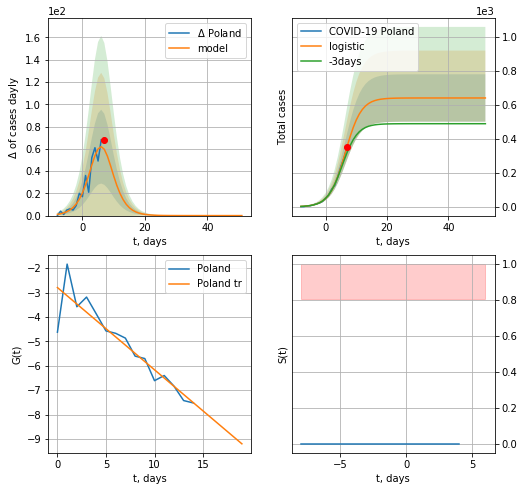

Poland data at: 2020-11-18
+3 day model MAPE: 0.14646235252259687
model: logistic
coeffs:  [6.41107575e+02 3.87606717e-01 6.46563504e+00]
rational stdev:  0.2177068805945458
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  641 ± 139
	 total death:  9 ± 5
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


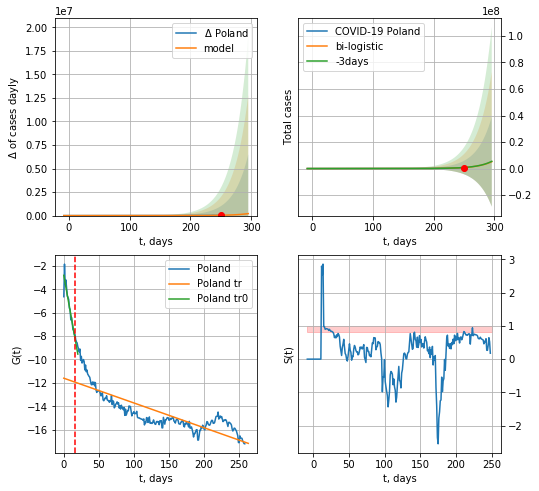

Poland data at: 2020-11-18
+3 day model MAPE: 0.016148313350733356
model: bi-logistic
coeffs:  [1.75992314e+09 4.15951339e-02 4.36048632e+02] [6.41107575e+02 3.87606717e-01 6.46563504e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  6.539965134511568
forecast at the end of period: +45 days
	 deltaDaycases:  210432
	 total cases:  5180285 ± 33878885
	 total death:  76756 ± 1505944
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.672118
 intercept: -11.600797
 slope: -0.021209


In [668]:
vL=16
vL1=38
try:
    dfPL = read_df(pd.DataFrame(),"PL")
    x =  forecast('Poland',dfPL[:vL],d1,7*T18-dT,1.)
    xx = forecast2('Poland',dfPL[:],d1,T18*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


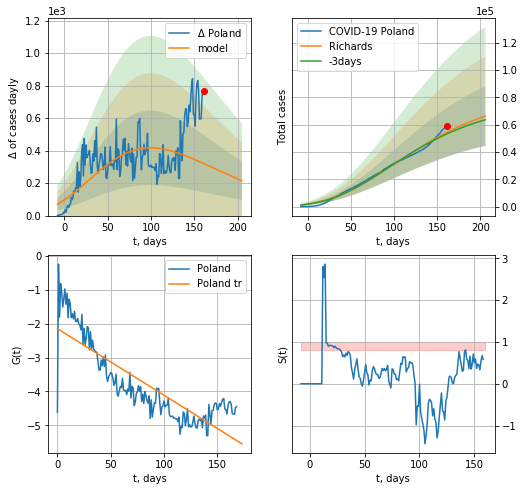

Poland data at: 2020-11-18
+3 day model MAPE: 0.021663
model: Richards
coeffs: [ 8.41741058e+04  1.47966569e+00 -2.46676717e+02  9.14859854e-03]
rational stdev: 0.328700
forecast at the end of period: +45 days
	 deltaDaycases: 214
	 total cases: 66334 ± 21804
	 total death: 982 ± 968
trend coefficient of determination: 0.711205
 intercept: -2.146265
 slope: -0.019650
diffStd0a 0.32727403275389566


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


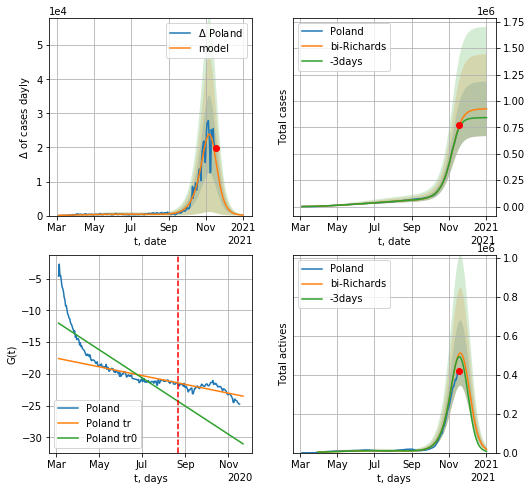

Poland data at: 2020-11-18
+3 day model MAPE: 0.030433
model: bi-Richards
coeffs: [8.48267153e+05 8.39158748e-02 2.43451724e+02 1.55599056e+00]
rational stdev: 0.279193
forecast at the end of period: +45 days
	 deltaDaycases: 154
	 total cases: 926141 ± 258572
	 total death: 13722 ± 11493
bi-Richards approximation splitting point: 170
actives k: 26
trend coefficient of determination: 0.702438
 intercept: -12.024823
 slope: -0.072181
trend coefficient of determination: 0.406012
 intercept: -17.592762
 slope: -0.022495


In [669]:
vL = 170
x =  forecastRR('Poland',dfPL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RRD('Poland',dfPL[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.75)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

In [670]:
#x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date     cases  active   death
266 2020-11-14  323460.0    7916  2721.0
267 2020-11-15  324135.0    7767  2732.0
268 2020-11-16  325035.0    8030  2735.0
269 2020-11-17  325537.0    8150  2736.0
270 2020-11-18  326331.0    8274  2739.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


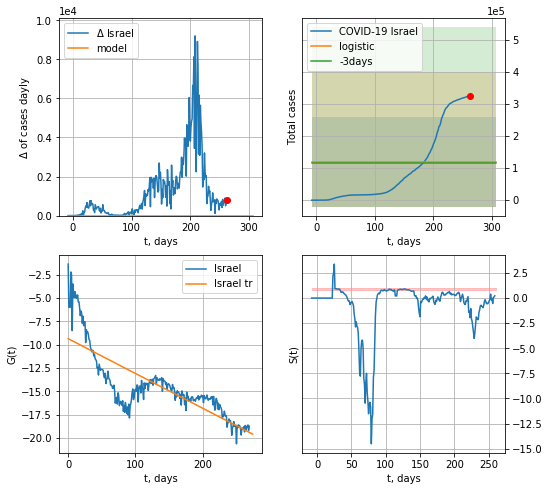

Israel data at: 2020-11-18
+3 day model MAPE: 0.027487441977477677
model: logistic
coeffs:  [ 9.60614574e+04 -4.05729968e+01  9.74425888e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.1666150964370925
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  120076 ± 140083
	 total death:  1007 ± 3524
trend coefficient of determination: 0.647292
 intercept: -9.359312
 slope: -0.037236


In [671]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


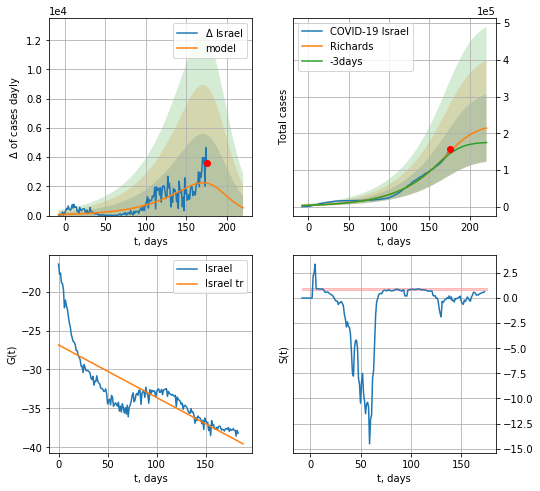

Israel data at: 2020-11-18
+3 day model MAPE: 0.043052
model: Richards
coeffs: [2.22982517e+05 2.18053289e-02 1.87753593e+02 2.87495191e+00]
rational stdev: 0.429268
forecast at the end of period: +45 days
	 deltaDaycases: 530
	 total cases: 214071 ± 91893
	 total death: 1796 ± 2312
trend coefficient of determination: 0.666990
 intercept: -26.852072
 slope: -0.067481
diffStd0a 2.0246088342440003


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


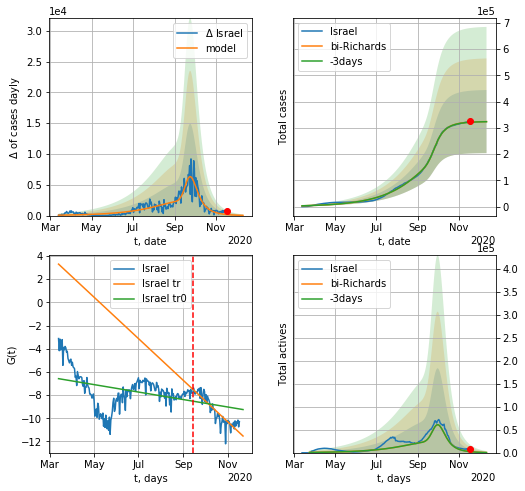

Israel data at: 2020-11-18
+3 day model MAPE: 0.001688
model: bi-Richards
coeffs: [1.01654605e+05 4.08243941e-01 1.79889965e+02 3.36320339e-01]
rational stdev: 0.371017
forecast at the end of period: +24 days
	 deltaDaycases: 37
	 total cases: 324063 ± 120232
	 total death: 2719 ± 3026
bi-Richards approximation splitting point: 185
actives k: 11
trend coefficient of determination: 0.127625
 intercept: -6.582270
 slope: -0.010492
trend coefficient of determination: 0.799981
 intercept: 3.301303
 slope: -0.058392


In [672]:
vL = 185+20
x = forecastRR('Israel',dfIS[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Israel',dfIS[20:],d1,37*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20,amc=0.33)

In [673]:
#x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

In [674]:
#x = forecastRRR('Israel',dfIS[27:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

SZ
           date     cases  active   death
263 2020-11-14  261345.0  112784  3351.0
264 2020-11-15  265624.0  112766  3369.0
265 2020-11-16  269974.0  125438  3536.0
266 2020-11-17  274534.0  101770  3664.0
267 2020-11-18  280648.0   96183  3765.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


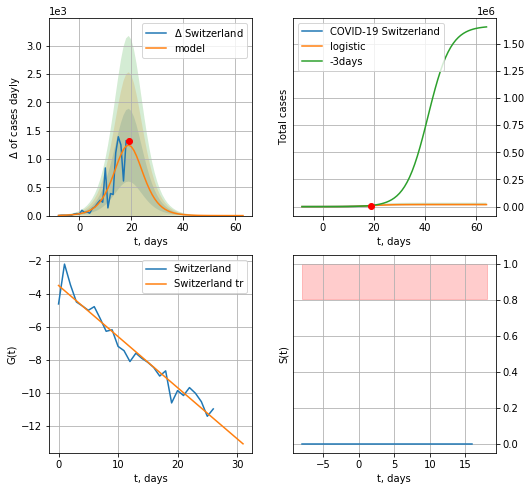

Switzerland data at: 2020-11-18
+3 day model MAPE: 0.24949882905970236
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.3060478989718857
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  18705 ± 5724
	 total death:  250 ± 229
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


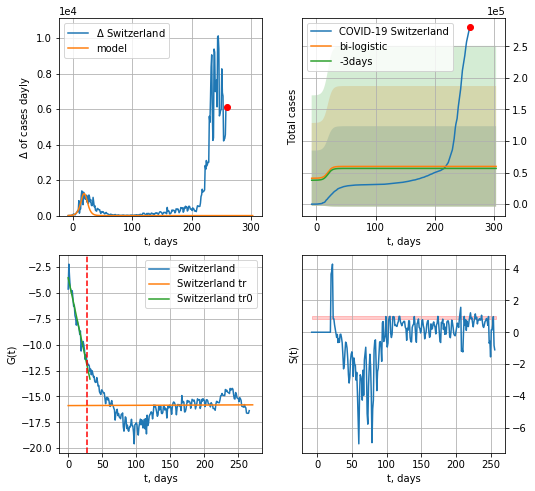

Switzerland data at: 2020-11-18
+3 day model MAPE: 0.05587812139135807
model: bi-logistic
coeffs:  [ 3.28458023e+04 -1.38572655e+01  3.38927677e+02] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.064805744448358
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  59763 ± 63636
	 total death:  801 ± 2558
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.000192
 intercept: -15.882775
 slope: 0.000265


In [675]:
vL= 28
try:
    dfSZ = read_df(pd.DataFrame(),"SZ")
    x = forecast('Switzerland',dfSZ[:vL],d1,7*T18-dT)
    xx = forecast2('Switzerland',dfSZ[:],d1,7*T18-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


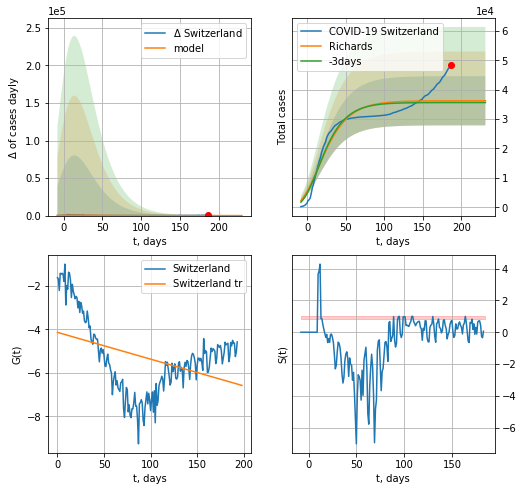

Switzerland data at: 2020-11-18
+3 day model MAPE: 0.017011
model: Richards
coeffs: [ 3.62432935e+04  1.60636037e+01 -1.13737864e+02  2.85003887e-03]
rational stdev: 0.231139
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 36241 ± 8376
	 total death: 486 ± 337
trend coefficient of determination: 0.162726
 intercept: -4.134057
 slope: -0.012335
diffStd0a 2.2061179543284437


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


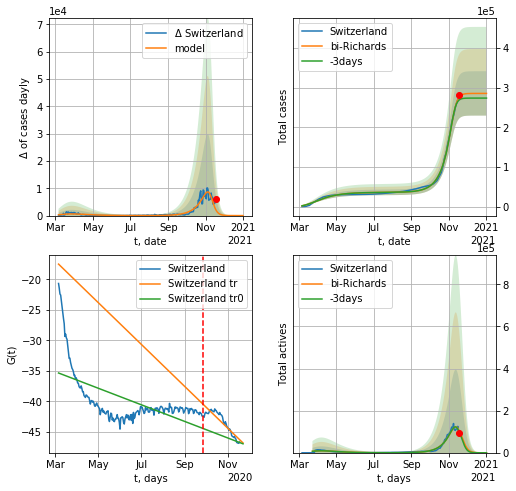

Switzerland data at: 2020-11-18
+3 day model MAPE: 0.027955
model: bi-Richards
coeffs: [2.49547743e+05 6.94105434e-02 2.41056430e+02 3.41509602e+00]
rational stdev: 0.195723
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 285790 ± 55935
	 total death: 3833 ± 2250
bi-Richards approximation splitting point: 205
actives k: 17
trend coefficient of determination: 0.360165
 intercept: -35.353951
 slope: -0.044429
trend coefficient of determination: 0.819914
 intercept: -17.525091
 slope: -0.112204


In [676]:
iL = 10
vL = 205 + iL#175 + iL#85 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*T18-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Switzerland',dfSZ[iL:],d12f(1),7*40-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

In [677]:
#x = forecastRRR('Switzerland',dfSZ[:],d1,7*T18-dT,addpred=False,xcoef=koreaCoeffs)

In [678]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date     cases  active    death
249 2020-11-14  535857.0  284810   9603.0
250 2020-11-15  545689.0  291795   9697.0
251 2020-11-16  557657.0  296818   9856.0
252 2020-11-17  570153.0  300962  10112.0
253 2020-11-18  583510.0  306662  10369.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:87: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


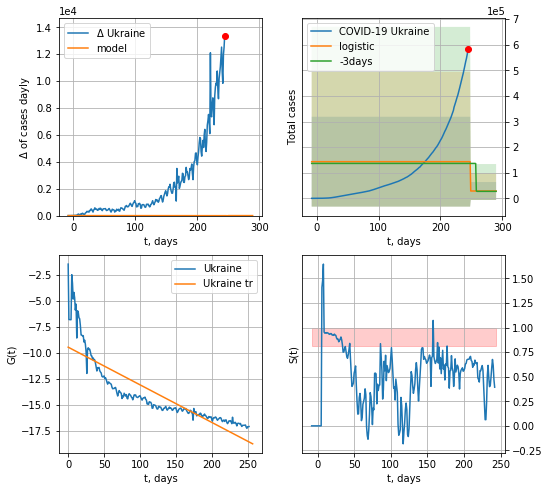

Ukraine data at: 2020-11-18
+3 day model MAPE: 0.04996815948818937
model: logistic
coeffs:  [ 1.14506827e+05 -2.09221003e+01  2.48478433e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.2256835717395984
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  28626 ± 35087
	 total death:  508 ± 1867
trend coefficient of determination: 0.731950
 intercept: -9.455932
 slope: -0.035998


In [679]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


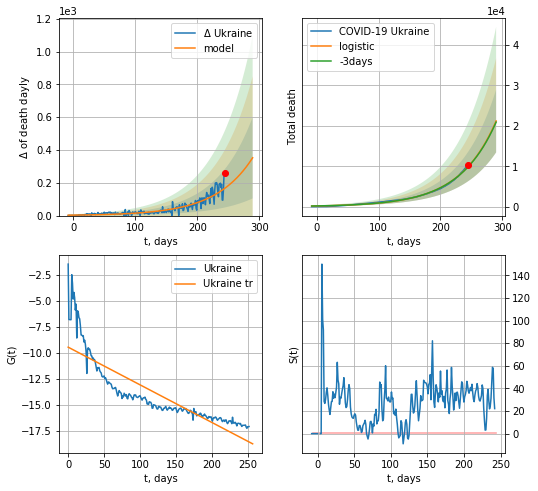

Ukraine data at: 2020-11-18
+3 day model MAPE: 0.007800236965335557
model: logistic
coeffs:  [1.20301517e+07 1.68023643e-02 6.67293940e+02]
rational stdev:  0.36633479110187356
forecast at the end of period: +45 days
	 total death:  21199 ± 7766
trend coefficient of determination: 0.731950
 intercept: -9.455932
 slope: -0.035998


In [680]:
x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


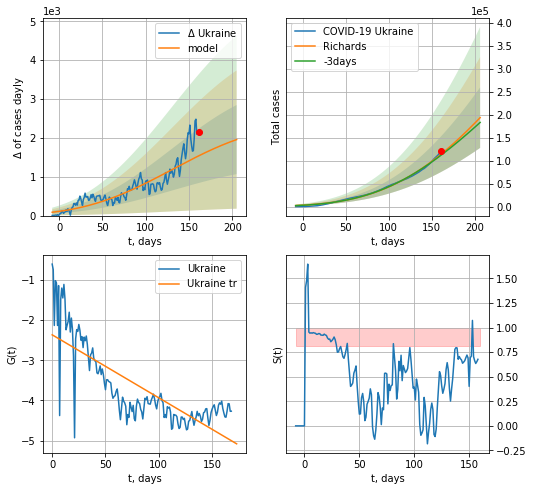

Ukraine data at: 2020-11-18
+3 day model MAPE: 0.020951
model: Richards
coeffs: [ 9.71556496e+05  3.24855332e-01 -3.33588886e+02  1.96162664e-02]
rational stdev: 0.340033
forecast at the end of period: +45 days
	 deltaDaycases: 1956
	 total cases: 193947 ± 65948
	 total death: 3446 ± 3515
trend coefficient of determination: 0.622475
 intercept: -2.366387
 slope: -0.015671
diffStd0a 0.15215081176154088


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


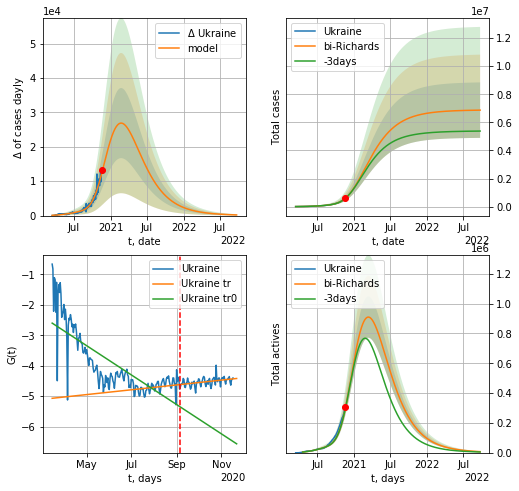

Ukraine data at: 2020-11-18
+3 day model MAPE: 0.002832
model: bi-Richards
coeffs: [5.92322151e+06 2.47331618e-01 7.55053949e+01 4.70233601e-02]
rational stdev: 0.287572
forecast at the end of period: +675 days
	 deltaDaycases: 193
	 total cases: 6870343 ± 1975721
	 total death: 122086 ± 105325
bi-Richards approximation splitting point: 175
actives k: 35
trend coefficient of determination: 0.618821
 intercept: -2.599384
 slope: -0.015731
trend coefficient of determination: 0.166968
 intercept: -5.068346
 slope: 0.002582


In [681]:
vL = 180#65+5 +55
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*T18-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RRD('Ukraine',dfUR[5:],d1,7*130-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [682]:
#x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [683]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

In [684]:
dfIN = read_df(pd.DataFrame(),"IN")
#x = forecast('Iran',dfIN[:18],d1,7*T18-dT)
#xx = forecast2('Iran',dfIN[:],d1,T18*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

IN
           date   cases  active    death
269 2020-11-14  749525  155744  41034.0
270 2020-11-15  762068  161757  41493.0
271 2020-11-16  775121  168443  41979.0
272 2020-11-17  788473  175238  42461.0
273 2020-11-18  801894  181970  42941.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


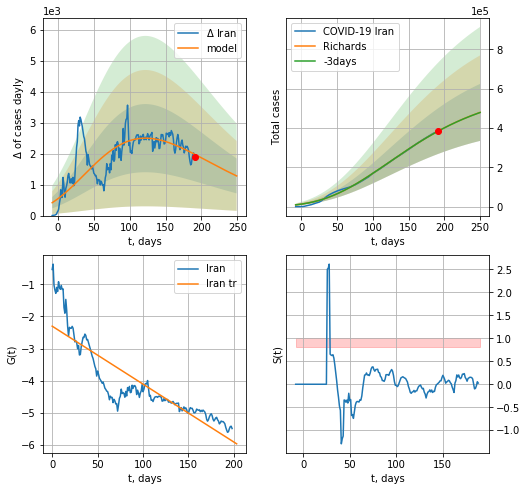

Iran data at: 2020-11-18
+3 day model MAPE: 0.000431
model: Richards
coeffs: [ 6.07518429e+05  7.96228644e-01 -2.54493530e+02  1.41818761e-02]
rational stdev: 0.302382
forecast at the end of period: +59 days
	 deltaDaycases: 1283
	 total cases: 479660 ± 145040
	 total death: 25685 ± 23300
trend coefficient of determination: 0.763759
 intercept: -2.302474
 slope: -0.018078
diffStd0a 0.3563028426170322


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


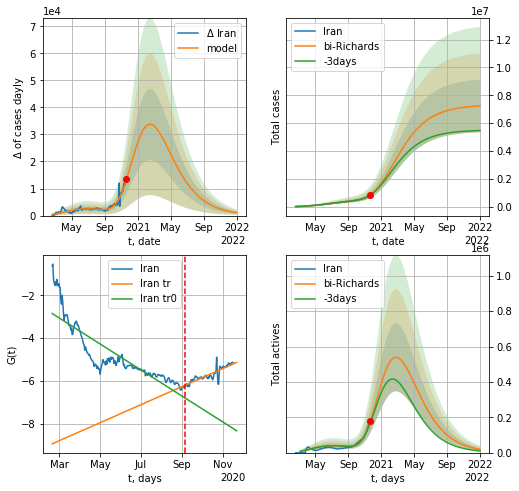

Iran data at: 2020-11-18
+3 day model MAPE: 0.006411
model: bi-Richards
coeffs: [6.70248949e+06 1.80827317e-01 1.72378744e+02 7.75992920e-02]
rational stdev: 0.261691
forecast at the end of period: +409 days
	 deltaDaycases: 1071
	 total cases: 7233504 ± 1892943
	 total death: 387350 ± 304098
bi-Richards approximation splitting point: 200
actives k: 17
trend coefficient of determination: 0.758134
 intercept: -2.850995
 slope: -0.019733
trend coefficient of determination: 0.756505
 intercept: -8.925150
 slope: 0.013686


In [685]:
vL = 200
x = forecastRR('Iran',dfIN[:vL],d1,42*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Iran',dfIN[:],d12f(1),92*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)

In [686]:
#x = forecastRRR('Iran',dfIN[:17],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR('Iran',dfIN[:],d1,66*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date      cases  active    death
259 2020-11-14  1903253.0  452654  33186.0
260 2020-11-15  1925825.0  461265  33489.0
261 2020-11-16  1948603.0  461178  33931.0
262 2020-11-17  1971013.0  456528  34387.0
263 2020-11-18  1991998.0  454102  34850.0


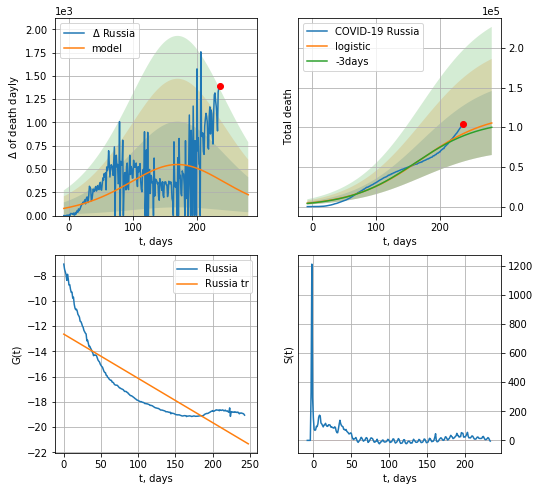

Russia data at: 2020-11-18
+3 day model MAPE: 0.03141387507873763
model: logistic
coeffs:  [1.18951651e+05 1.84444726e-02 1.70069050e+02]
rational stdev:  0.3829253429057229
forecast at the end of period: +45 days
	 total death:  105337 ± 40336
trend coefficient of determination: 0.678026
 intercept: -12.632728
 slope: -0.035076


In [689]:
try:
    dfRS = read_df(pd.DataFrame(),"RS")
    x = forecast('Russia',dfRS[19:],d1,T18*7-dT,shift=3.,cases='death')
    #xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]
except:
    print ("Exeption occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


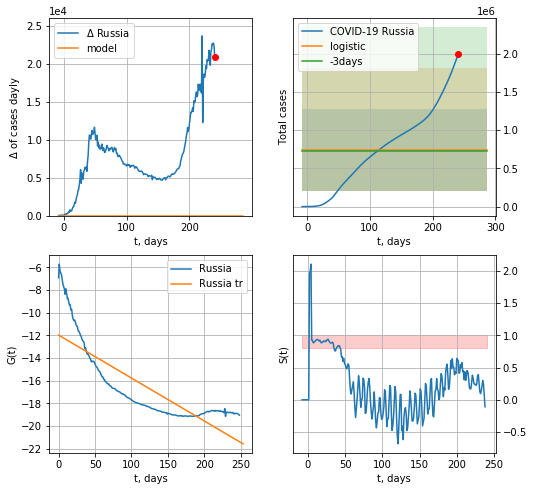

Russia data at: 2020-11-18
+3 day model MAPE: 0.02058613559895128
model: logistic
coeffs:  [ 7.40598555e+05 -1.84721831e+01  4.51734047e+02]
rational stdev:  0.7248266510271214
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  740598 ± 536805
	 total death:  12804 ± 27842
trend coefficient of determination: 0.678092
 intercept: -11.974328
 slope: -0.037980


In [690]:
x = forecast('Russia',dfRS[14:],d1,T18*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


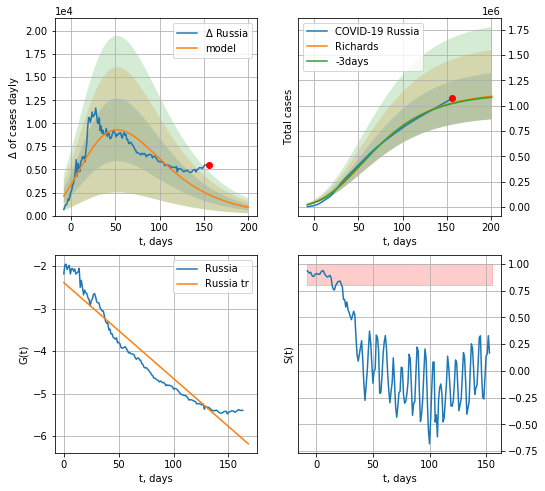

Russia data at: 2020-11-18
+3 day model MAPE: 0.006482
model: Richards
coeffs: [ 1.13371514e+06  2.45412243e+00 -1.57034582e+02  9.12424388e-03]
rational stdev: 0.208462
forecast at the end of period: +45 days
	 deltaDaycases: 894
	 total cases: 1093478 ± 227948
	 total death: 18906 ± 11823
trend coefficient of determination: 0.926508
 intercept: -2.389804
 slope: -0.022577
diffStd0a 0.17886020938693659


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


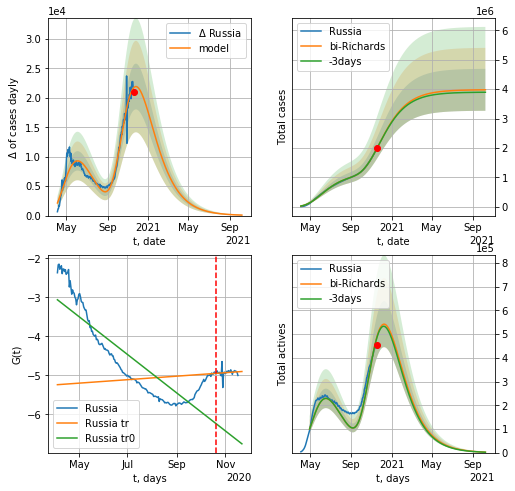

Russia data at: 2020-11-18
+3 day model MAPE: 0.001689
model: bi-Richards
coeffs: [2.84758067e+06 6.68511302e-01 6.14527772e+01 3.10748142e-02]
rational stdev: 0.179312
forecast at the end of period: +325 days
	 deltaDaycases: 83
	 total cases: 3977303 ± 713178
	 total death: 68767 ± 36992
bi-Richards approximation splitting point: 200
actives k: 26
trend coefficient of determination: 0.731575
 intercept: -3.062875
 slope: -0.015922
trend coefficient of determination: 0.014636
 intercept: -5.240760
 slope: 0.001457


In [691]:
vL = 200 + 35
x = forecastRR('Russia',dfRS[35:vL-35],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
xx = forecast2RRD('Russia',dfRS[35:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-35,amc=0.75)
#x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

In [692]:
#x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date     cases  active   death
297 2020-11-14  114983.0   11114  1880.0
298 2020-11-15  116677.0   11957  1883.0
299 2020-11-16  118136.0   12577  1885.0
300 2020-11-17  119326.0   12786  1903.0
301 2020-11-18  120815.0   13205  1913.0


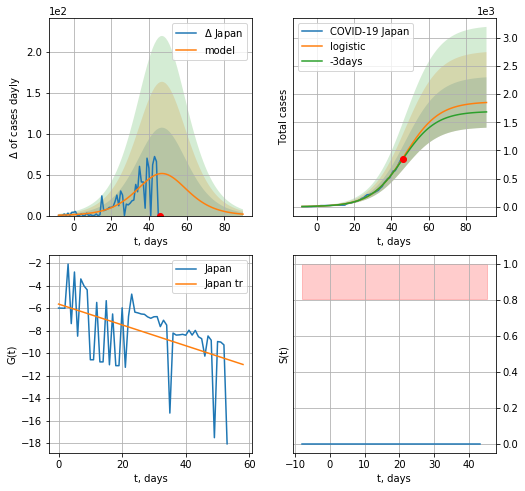

Japan data at: 2020-11-18
+3 day model MAPE: 0.024413899387998084
model: logistic
coeffs:  [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.24188431732788906
forecast at the end of period: +45 days
	 deltaDaycases:  1
	 total cases:  1851 ± 447
	 total death:  29 ± 21
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


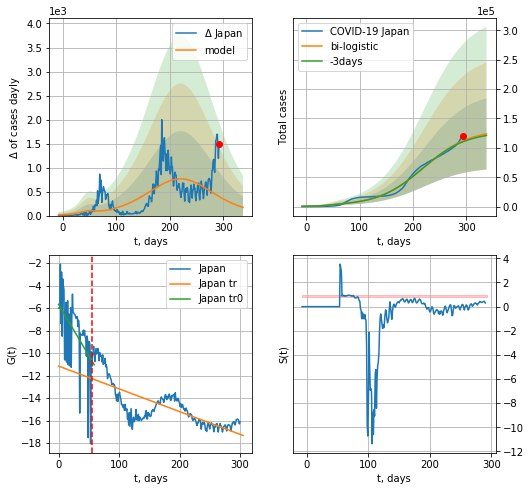

Japan data at: 2020-11-18
+3 day model MAPE: 0.014287637688670425
model: bi-logistic
coeffs:  [1.29423501e+05 2.36618650e-02 2.20486308e+02] [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.49034601557975144
forecast at the end of period: +45 days
	 deltaDaycases:  170
	 total cases:  123734 ± 60672
	 total death:  1959 ± 2881
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.580572
 intercept: -11.158766
 slope: -0.020219


In [693]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*T18-dT)
    xx = forecast2('Japan',dfJP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


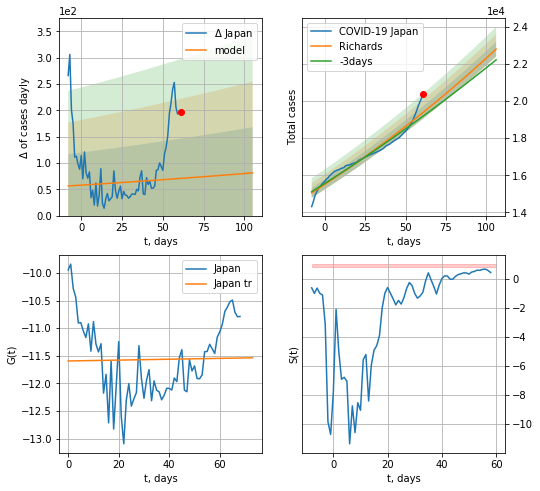

Japan data at: 2020-11-18
+3 day model MAPE: 0.010772
model: Richards
coeffs: [3.67644970e+05 4.33696686e-03 6.73727229e+02 6.19728498e-01]
rational stdev: 0.017509
forecast at the end of period: +45 days
	 deltaDaycases: 81
	 total cases: 22815 ± 399
	 total death: 361 ± 18
trend coefficient of determination: 0.000525
 intercept: -11.593639
 slope: 0.000790
diffStd0a 1.8002757810429029


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


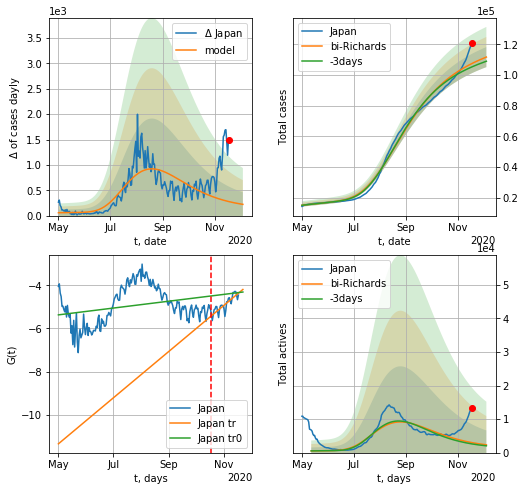

Japan data at: 2020-11-18
+3 day model MAPE: 0.021119
model: bi-Richards
coeffs: [ 8.30156820e+04  5.32366718e+00 -8.85710856e+01  5.18804745e-03]
rational stdev: 0.058700
forecast at the end of period: +17 days
	 deltaDaycases: 221
	 total cases: 111649 ± 6553
	 total death: 1767 ± 311
bi-Richards approximation splitting point: 170
actives k: 11
trend coefficient of determination: 0.085266
 intercept: -5.372243
 slope: 0.005166
trend coefficient of determination: 0.714279
 intercept: -11.353864
 slope: 0.034925


In [694]:
iL = 50+50
vL = 170+iL
x = forecastRR('Japan',dfJP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Japan',dfJP[iL:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.33)

In [695]:
#x = forecastRRR('Japan',dfJP[54:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

NL
           date     cases  active   death
261 2020-11-14  442458.0       0  8443.0
262 2020-11-15  447871.0       0  8486.0
263 2020-11-16  452701.0       0  8530.0
264 2020-11-17  457003.0       0  8616.0
265 2020-11-18  461612.0       0  8698.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


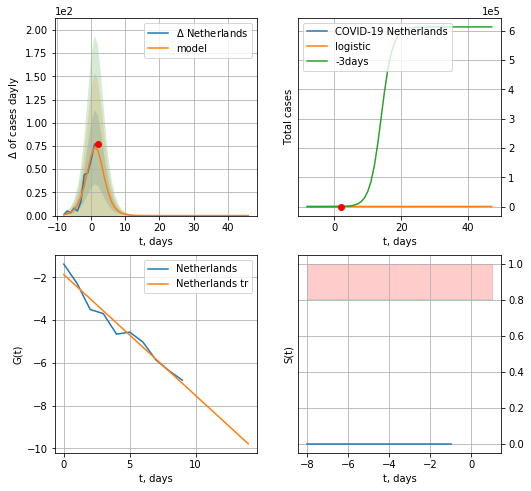

Netherlands data at: 2020-11-18
model: logistic
coeffs:  [487.7470779    0.61204075   1.72557626]
rational stdev:  0.23761281134430468
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  487 ± 115
	 total death:  9 ± 6
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


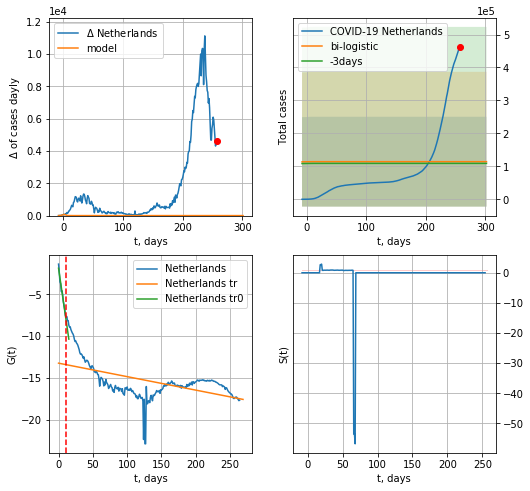

Netherlands data at: 2020-11-18
+3 day model MAPE: 0.047874778196937445
model: bi-logistic
coeffs:  [ 9.09151004e+04 -1.81508572e+01  4.59760171e+02] [487.7470779    0.61204075   1.72557626]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.194534940910633
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  114131 ± 136334
	 total death:  2150 ± 7704
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.289845
 intercept: -13.220915
 slope: -0.016094


In [696]:
vL=11
vL1=32
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[:vL],d1,T18*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


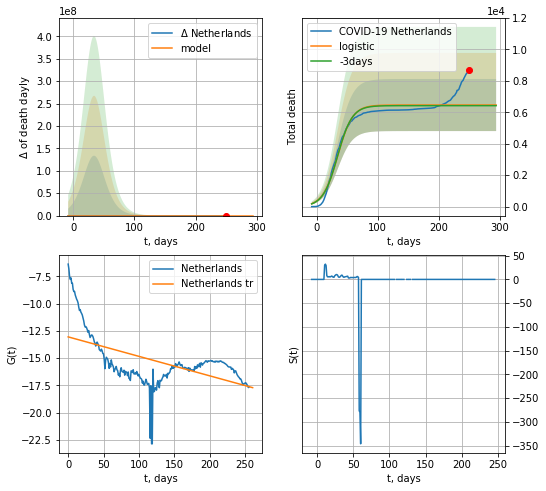

Netherlands data at: 2020-11-18
+3 day model MAPE: 0.006297757311501734
model: logistic
coeffs:  [6.46415619e+03 8.26120820e-02 3.46562616e+01]
rational stdev:  0.25629511512293107
forecast at the end of period: +45 days
	 total death:  6464 ± 1656
trend coefficient of determination: 0.313184
 intercept: -13.051354
 slope: -0.017835


In [697]:
x = forecast('Netherlands',dfNL[8:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


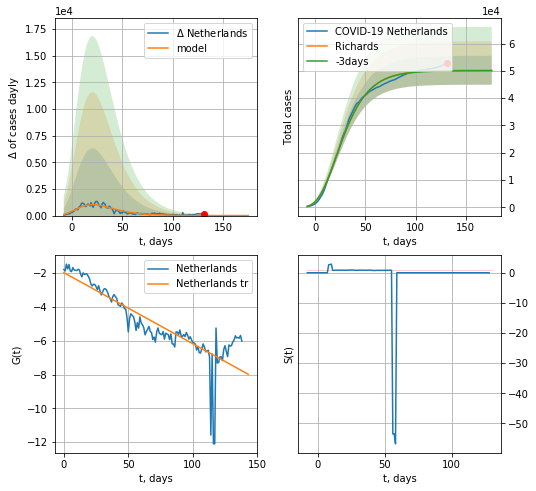

Netherlands data at: 2020-11-18
+3 day model MAPE: 0.003437
model: Richards
coeffs: [ 5.02415869e+04  8.73155449e+00 -6.99416502e+01  6.38067202e-03]
rational stdev: 0.105306
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 50232 ± 5289
	 total death: 946 ± 298
trend coefficient of determination: 0.744376
 intercept: -1.967578
 slope: -0.042068
diffStd0a 0.4153917377222872


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


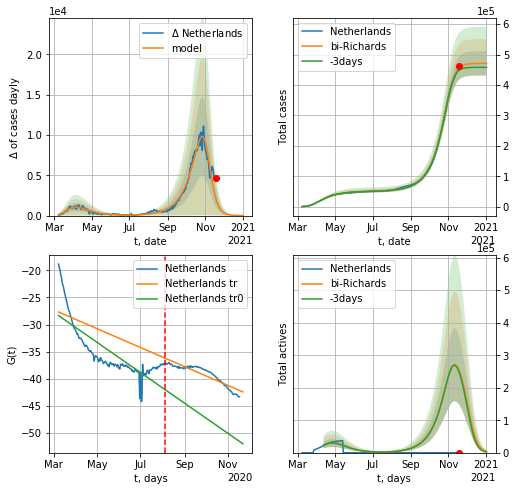

Netherlands data at: 2020-11-18
+3 day model MAPE: 0.017041
model: bi-Richards
coeffs: [4.20802340e+05 4.97427146e-02 2.32965546e+02 2.96588603e+00]
rational stdev: 0.084817
forecast at the end of period: +45 days
	 deltaDaycases: 3
	 total cases: 471020 ± 39950
	 total death: 8875 ± 2258
bi-Richards approximation splitting point: 150
actives k: 35
trend coefficient of determination: 0.647259
 intercept: -28.340201
 slope: -0.091185
trend coefficient of determination: 0.834935
 intercept: -27.683590
 slope: -0.056840


In [698]:
iL = 10
vL = 150+iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Netherlands',dfNL[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [699]:
#x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


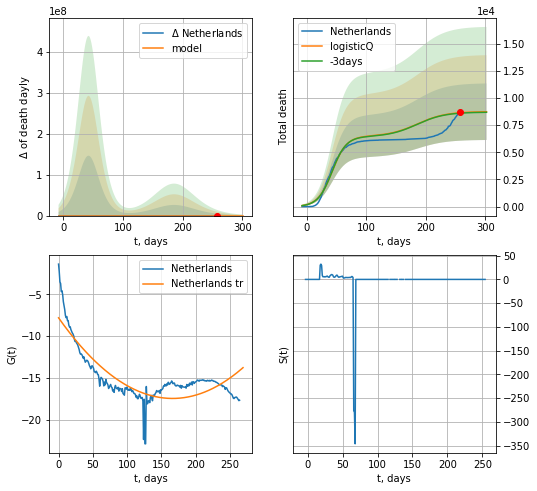

Netherlands data at: 2020-11-18
+3 day model MAPE: 0.005043
model: logisticQ
coeffs: [ 6.46289498e+03  1.11259304e-07  4.26562262e+01 -7.46666155e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.297980
forecast at the end of period: +45 days
	 total death: 8734 ± 2602
trend coefficient of determination: 0.714837
 intercept_: -7.803327475787285
 coeffs_: [ 0.         -0.11588574  0.00034851]


In [700]:
#x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [701]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

AT
           date     cases  active   death
262 2020-11-14  198291.0   77130  1746.0
263 2020-11-15  203956.0   76453  1829.0
264 2020-11-16  208613.0   77055  1887.0
265 2020-11-17  214597.0   76165  1945.0
266 2020-11-18  221688.0   76896  2054.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


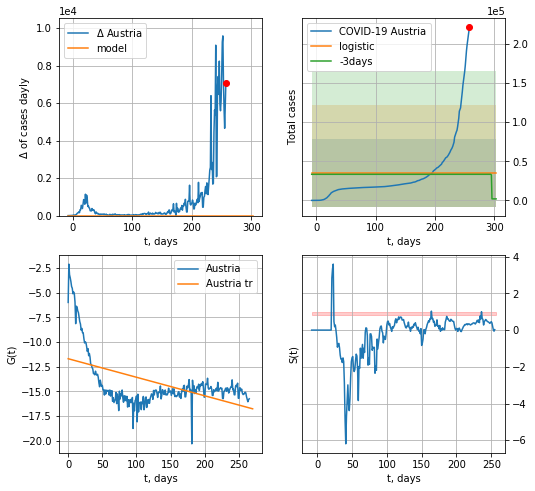

Austria data at: 2020-11-18
+3 day model MAPE: 0.06570399468267482
model: logistic
coeffs:  [ 3.34552621e+04 -1.17180229e+01  3.15005013e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  1.2227475014888771
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  35546 ± 43464
	 total death:  329 ± 1206
trend coefficient of determination: 0.265044
 intercept: -11.696941
 slope: -0.018772


In [702]:
dfAT = read_df(pd.DataFrame(),"AT")
try:
    x = forecast('Austria',dfAT[:],d1,7*T18-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
except:
    print ("Exception occurs")
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


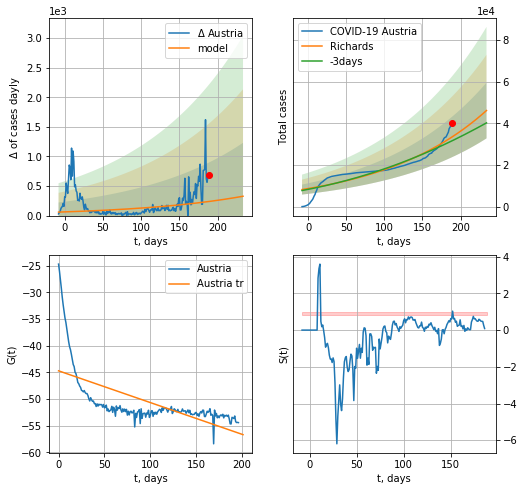

Austria data at: 2020-11-18
+3 day model MAPE: 0.060222
model: Richards
coeffs: [7.79127383e+05 7.10721944e-03 6.31550628e+02 4.75199089e+00]
rational stdev: 0.289325
forecast at the end of period: +45 days
	 deltaDaycases: 327
	 total cases: 46186 ± 13362
	 total death: 427 ± 370
trend coefficient of determination: 0.406393
 intercept: -44.706119
 slope: -0.059607
diffStd0a 1.3652820891837871


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


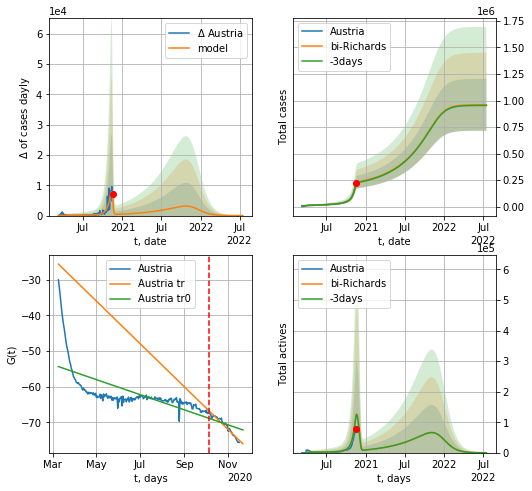

Austria data at: 2020-11-18
+3 day model MAPE: 0.012297
model: bi-Richards
coeffs: [1.81017912e+05 6.77735911e-02 2.44008537e+02 5.85998229e+00]
rational stdev: 0.254742
forecast at the end of period: +605 days
	 deltaDaycases: 3
	 total cases: 960046 ± 244564
	 total death: 8895 ± 6797
bi-Richards approximation splitting point: 210
actives k: 22
trend coefficient of determination: 0.444438
 intercept: -54.353611
 slope: -0.068738
trend coefficient of determination: 0.940212
 intercept: -25.673584
 slope: -0.194964


In [703]:
vL=210+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Austria',dfAT[12:],d12f(1),120*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12,amc=0.65)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

In [704]:
#vL = 68
#x = forecastRRR('Austria',dfAT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date     cases  active    death
258 2020-11-14  531280.0  484271  14303.0
259 2020-11-15  535939.0  488609  14421.0
260 2020-11-16  537871.0  490223  14616.0
261 2020-11-17  540605.0  492079  14839.0
262 2020-11-18  545787.0  496513  15025.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


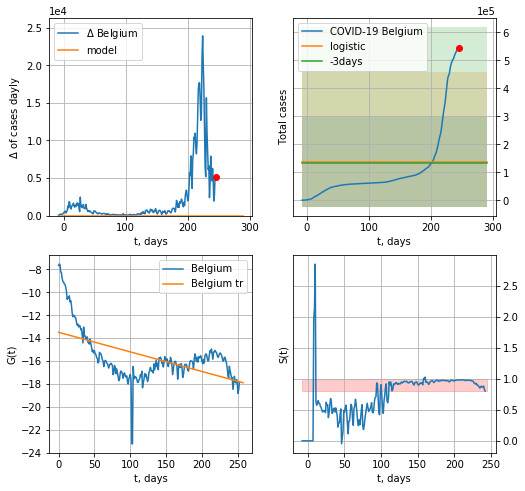

Belgium data at: 2020-11-18
+3 day model MAPE: 0.04901334908561726
model: logistic
coeffs:  [ 1.10287449e+05 -2.86273301e+01  7.44195916e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  1.16427578316846
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  137859 ± 160506
	 total death:  3795 ± 13255
trend coefficient of determination: 0.298149
 intercept: -13.486556
 slope: -0.017140


In [705]:
vL=9
try:
    dfBG = read_df(pd.DataFrame(),"BG")
    x = forecast('Belgium',dfBG[vL:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,3.])
    #xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

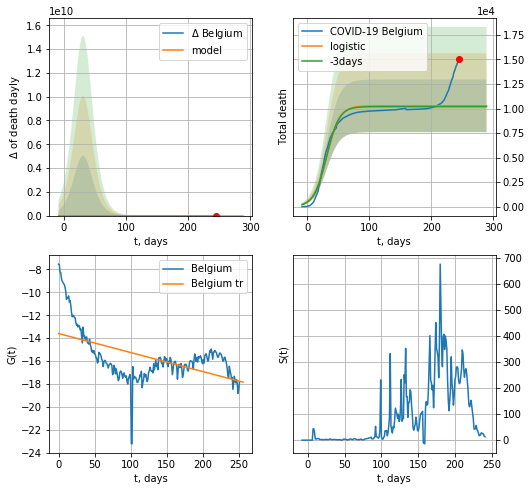

Belgium data at: 2020-11-18
+3 day model MAPE: 0.008199515879819085
model: logistic
coeffs:  [1.02742356e+04 9.62663510e-02 3.17520494e+01]
rational stdev:  0.2608680923685978
forecast at the end of period: +45 days
	 total death:  10274 ± 2680
trend coefficient of determination: 0.289897
 intercept: -13.596361
 slope: -0.016586


In [706]:
#dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


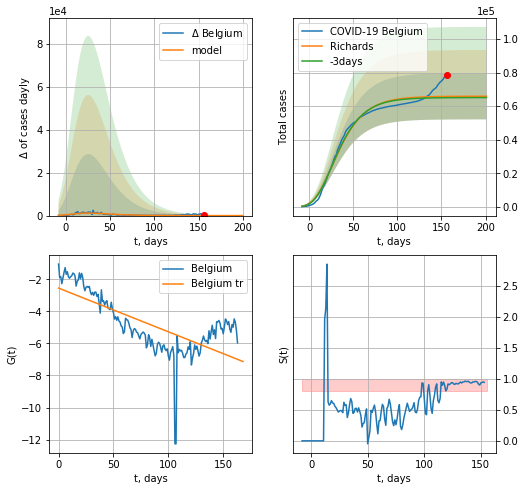

Belgium data at: 2020-11-18
+3 day model MAPE: 0.011690
model: Richards
coeffs: [ 6.59502350e+04  1.16564107e+01 -8.64901843e+01  4.18089404e-03]
rational stdev: 0.209120
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 65937 ± 13788
	 total death: 1815 ± 1138
trend coefficient of determination: 0.496391
 intercept: -2.551765
 slope: -0.027253
diffStd0a 5.832291149551708


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


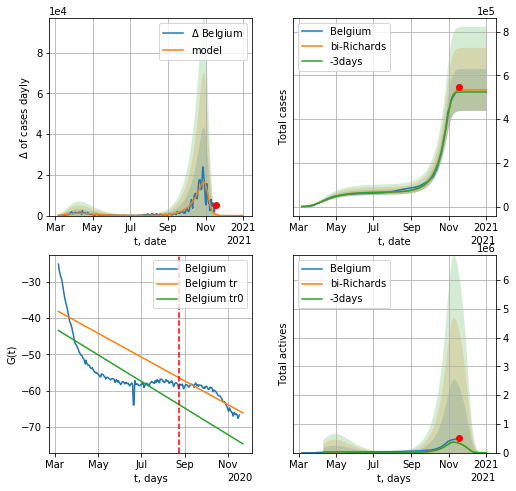

Belgium data at: 2020-11-18
+3 day model MAPE: 0.016645
model: bi-Richards
coeffs: [4.67974281e+05 6.22307182e-02 2.34912928e+02 4.70238443e+00]
rational stdev: 0.179873
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 533924 ± 96038
	 total death: 14698 ± 7931
bi-Richards approximation splitting point: 170
actives k: 35
trend coefficient of determination: 0.559669
 intercept: -43.456478
 slope: -0.119691
trend coefficient of determination: 0.797769
 intercept: -38.212412
 slope: -0.107124


In [707]:
iL = 5
vL = 170+ iL
x = forecastRR('Belgium',dfBG[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Belgium',dfBG[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [708]:
#x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [709]:
dfBZ.tail()

,date,cases,active,death
263,2020-11-14,5848959.0,391775,165673.0
264,2020-11-15,5863093.0,405771,165811.0
265,2020-11-16,5876740.0,388267,166067.0
266,2020-11-17,5911758.0,383423,166743.0
267,2020-11-18,5947403.0,390043,167497.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


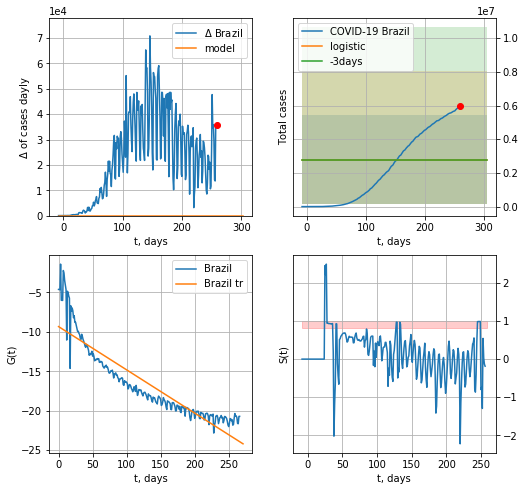

Brazil data at: 2020-11-18
+3 day model MAPE: 0.018962343551546964
model: logistic
coeffs:  [ 2.23613227e+06 -3.89869183e+01  9.28676134e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9384880983671259
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  2795165 ± 2623229
	 total death:  78720 ± 221633
trend coefficient of determination: 0.825182
 intercept: -9.335779
 slope: -0.054843


In [710]:
x = forecast('Brazil',dfBZ[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


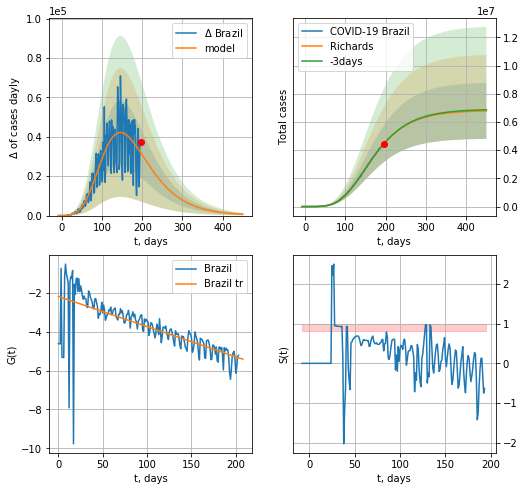

Brazil data at: 2020-11-18
+3 day model MAPE: 0.002583
model: Richards
coeffs: [ 6.82795585e+06  5.83841281e-01 -6.12360298e+01  2.91606457e-02]
rational stdev: 0.292338
forecast at the end of period: +255 days
	 deltaDaycases: 652
	 total cases: 6789866 ± 1984933
	 total death: 191223 ± 167705
trend coefficient of determination: 0.490475
 intercept: -2.194254
 slope: -0.015503
diffStd0a 0.3310994948052646


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


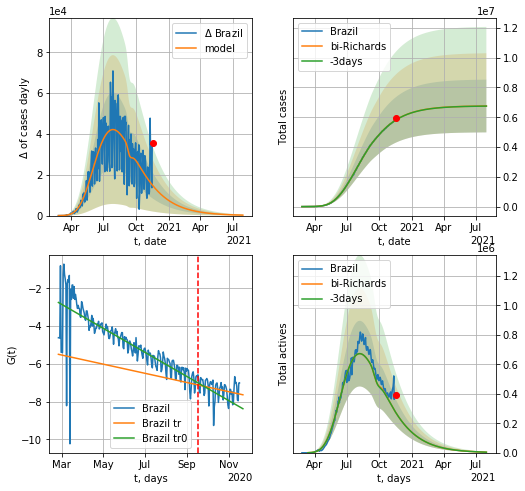

Brazil data at: 2020-11-18
+3 day model MAPE: 0.001121
model: bi-Richards
coeffs: [-6.02759110e+04  1.47916370e+00  1.82546004e+02  1.20978535e-01]
rational stdev: 0.262078
forecast at the end of period: +255 days
	 deltaDaycases: 223
	 total cases: 6754624 ± 1770236
	 total death: 190230 ± 149565
bi-Richards approximation splitting point: 205
actives k: 17
trend coefficient of determination: 0.653143
 intercept: -2.751525
 slope: -0.020743
trend coefficient of determination: 0.074833
 intercept: -5.494807
 slope: -0.007898


In [711]:
vL = 205
x = forecastRR('Brazil',dfBZ[:vL],d1,70*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Brazil',dfBZ[:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)
#x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

In [712]:
#x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [713]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date    cases  active  death
273 2020-11-14  27728.0    1331  907.0
274 2020-11-15  27750.0    1345  907.0
275 2020-11-16  27756.0    1351  907.0
276 2020-11-17  27777.0    1364  907.0
277 2020-11-18  27785.0    1372  907.0


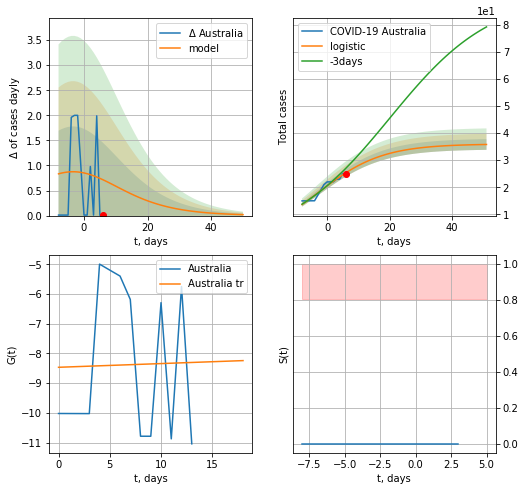

Australia data at: 2020-11-18
model: logistic
coeffs:  [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.05518162900834631
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  35 ± 1
	 total death:  1 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


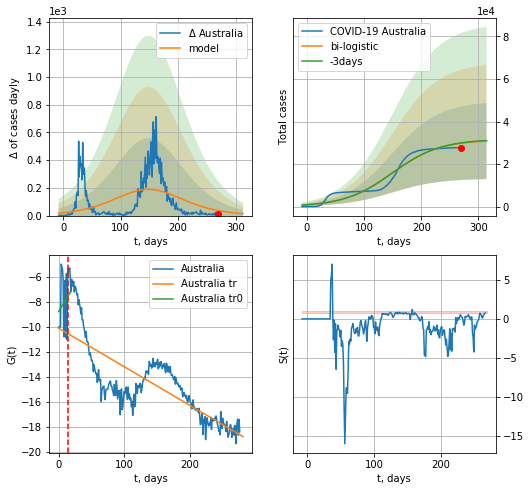

Australia data at: 2020-11-18
+3 day model MAPE: 0.005565525466580398
model: bi-logistic
coeffs:  [3.13669665e+04 2.41362276e-02 1.48907172e+02] [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.5797733926959191
forecast at the end of period: +45 days
	 deltaDaycases:  13
	 total cases:  30830 ± 17874
	 total death:  1006 ± 1749
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.616045
 intercept: -10.109976
 slope: -0.030855


In [714]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,T18*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


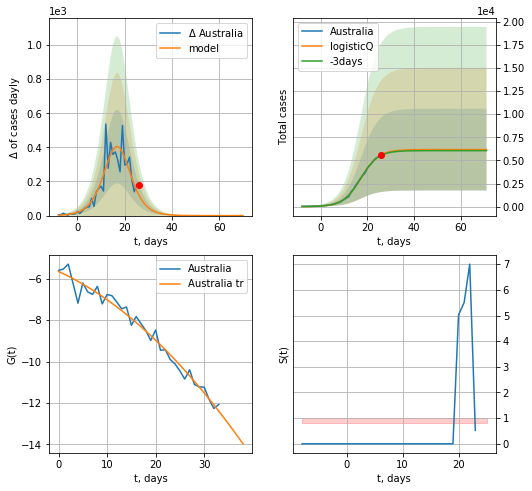

Australia data at: 2020-11-18
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16826027e+03  4.63150668e-05  1.72354354e+01 -5.67232010e+03]
rational stdev: 0.716727
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 6168 ± 4420
	 total death: 201 ± 432
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


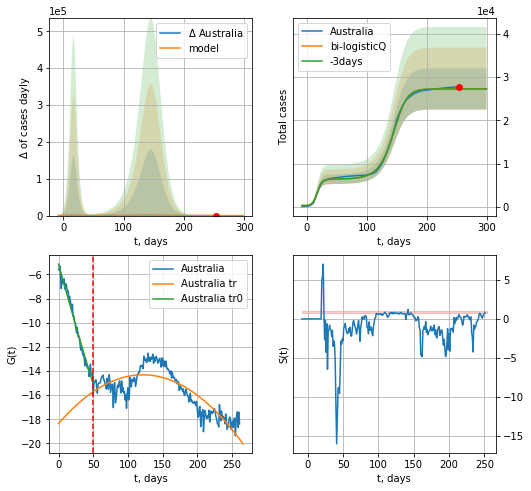

Australia data at: 2020-11-18
+3 day model MAPE: 0.000779
model: bi-logisticQ
coeffs: [ 2.11141967e+04  3.64539336e-04  1.43169016e+02 -8.57540204e+01]
rational stdev: 0.175312
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 27282 ± 4782
	 total death: 890 ± 468
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.697815
 intercept_: -18.358487655481007
 coeffs_: [ 0.          0.06652506 -0.00027373]


In [715]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,T18*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


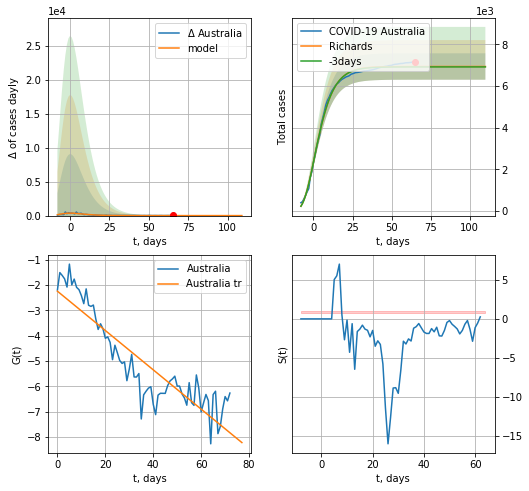

Australia data at: 2020-11-18
+3 day model MAPE: 0.002782
model: Richards
coeffs: [ 6.93376739e+03  1.41182137e+01 -3.14466269e+01  1.01384170e-02]
rational stdev: 0.091309
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 6933 ± 633
	 total death: 226 ± 61
trend coefficient of determination: 0.809708
 intercept: -2.241214
 slope: -0.077557
diffStd0a 12.663033769661439


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


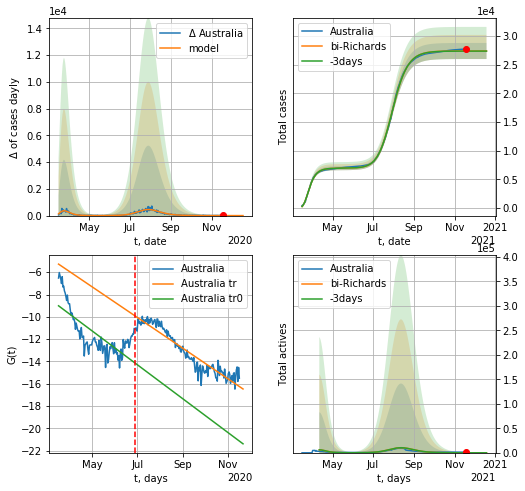

Australia data at: 2020-11-18
+3 day model MAPE: 0.000770
model: bi-Richards
coeffs: [2.04731060e+04 1.12958330e-01 1.23151542e+02 7.17855448e-01]
rational stdev: 0.051157
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 27406 ± 1402
	 total death: 894 ± 137
bi-Richards approximation splitting point: 104
actives k: 26
trend coefficient of determination: 0.544135
 intercept: -9.009426
 slope: -0.049267
trend coefficient of determination: 0.890613
 intercept: -5.274521
 slope: -0.044573


In [716]:
iL = 20+10
vL = 104+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Australia',dfAS[iL:],d1,38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)

ML
           date    cases  active  death
261 2020-11-14  46209.0   12131  306.0
262 2020-11-15  47417.0   12323  309.0
263 2020-11-16  48520.0   12601  313.0
264 2020-11-17  50390.0   12814  322.0
265 2020-11-18  50390.0   12814  322.0
Exception occurs


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:486: RuntimeWarning: divide by zero encountered in log


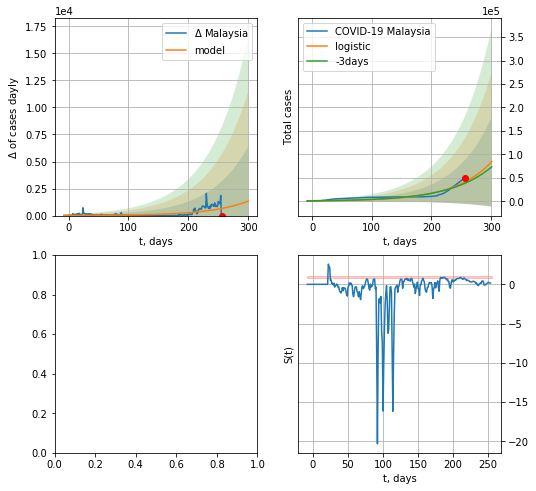

In [717]:
try:
    dfML = read_df(pd.DataFrame(),"ML")
    x = forecast('Malaysia',dfML[1:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


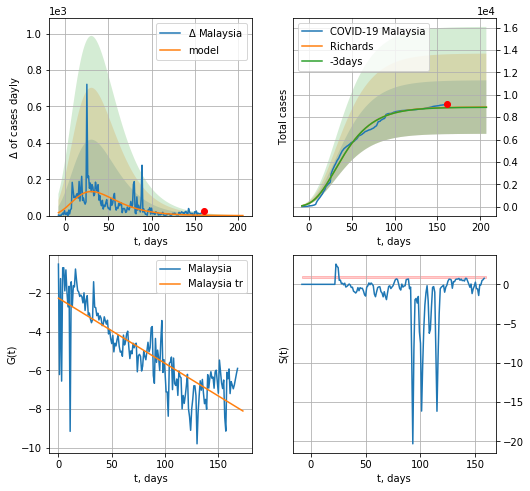

Malaysia data at: 2020-11-17
+3 day model MAPE: 0.002240
model: Richards
coeffs: [ 8.90988900e+03  9.44653085e+00 -1.04060324e+02  4.28353192e-03]
rational stdev: 0.268624
forecast at the end of period: +46 days
	 deltaDaycases: 0
	 total cases: 8902 ± 2391
	 total death: 56 ± 45
trend coefficient of determination: 0.661509
 intercept: -2.276525
 slope: -0.033689
diffStd0a 0.9141349487198971


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


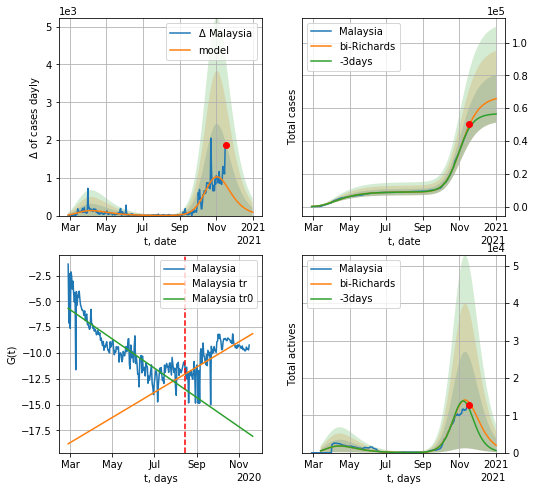

Malaysia data at: 2020-11-17
+3 day model MAPE: 0.036002
model: bi-Richards
coeffs: [5.83609047e+04 1.10282907e-01 2.31740474e+02 5.48602371e-01]
rational stdev: 0.221627
forecast at the end of period: +46 days
	 deltaDaycases: 90
	 total cases: 65784 ± 14579
	 total death: 420 ± 279
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.731211
 intercept: -5.679148
 slope: -0.046177
trend coefficient of determination: 0.457708
 intercept: -18.793032
 slope: 0.039793


In [308]:
vL = 170
x = forecastRR('Malaysia',dfML[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Malaysia',dfML[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.45)

In [309]:
#x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
260 2020-11-14  2001.0      58   25.0
261 2020-11-15  2001.5      58   25.0
262 2020-11-16  2005.0      61   25.0
263 2020-11-17  2008.0      64   25.0
264 2020-11-18  2010.0      37   25.0


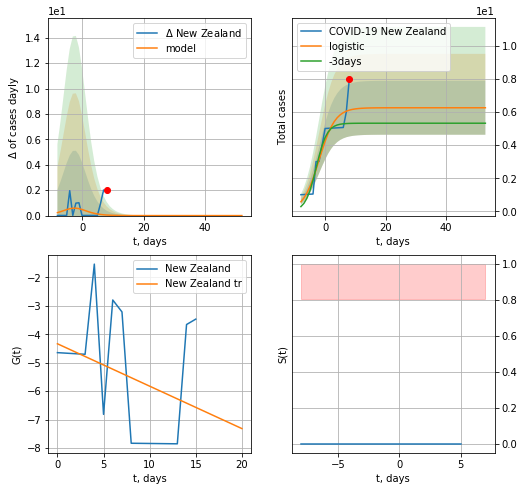

New Zealand data at: 2020-11-18
model: logistic
coeffs:  [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.26005250706023997
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


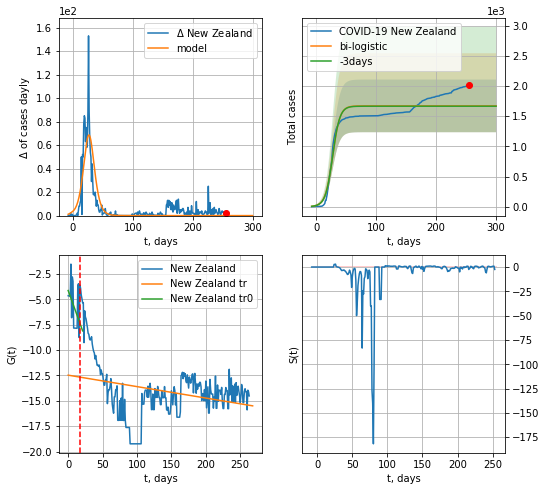

New Zealand data at: 2020-11-18
+3 day model MAPE: 0.0031112457757309893
model: bi-logistic
coeffs:  [1.66453215e+03 1.65120627e-01 2.71713065e+01] [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.26119326591568803
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  1670 ± 436
	 total death:  20 ± 15
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.081685
 intercept: -12.473204
 slope: -0.011281


In [718]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

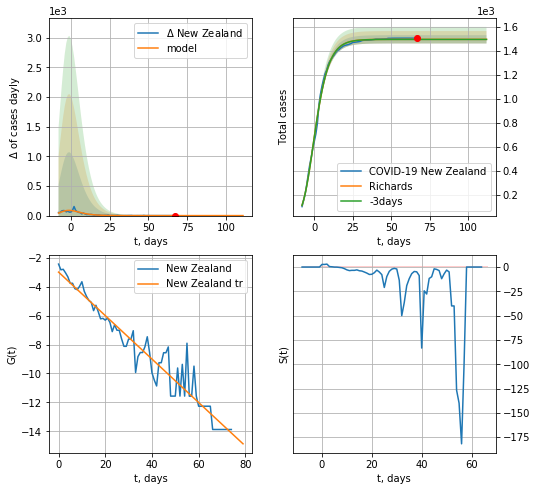

New Zealand data at: 2020-11-18
+3 day model MAPE: 0.000505
model: Richards
coeffs: [ 1.49487953e+03  6.79159620e-01 -8.03485752e+00  2.67314239e-01]
rational stdev: 0.023076
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 1494 ± 34
	 total death: 18 ± 1
trend coefficient of determination: 0.938641
 intercept: -2.993592
 slope: -0.150300
diffStd0a 1.814329234068433


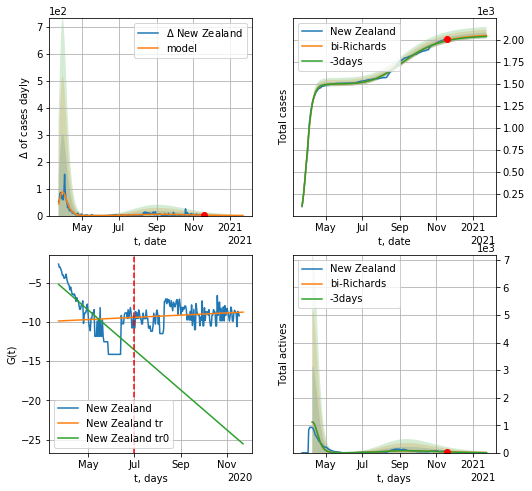

New Zealand data at: 2020-11-18
+3 day model MAPE: 0.002489
model: bi-Richards
coeffs: [5.67070847e+02 8.85075360e-02 1.11802860e+02 3.02633356e-01]
rational stdev: 0.015672
forecast at the end of period: +66 days
	 deltaDaycases: 0
	 total cases: 2049 ± 32
	 total death: 25 ± 1
bi-Richards approximation splitting point: 100
actives k: 17
trend coefficient of determination: 0.542963
 intercept: -5.204296
 slope: -0.083376
trend coefficient of determination: 0.026208
 intercept: -9.876577
 slope: 0.004633


In [719]:
iL = 24
vL = 100+iL
x = forecastRR('New Zealand',dfZL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('New Zealand',dfZL[iL:],d12f(1),43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)

In [720]:
#x = forecastRRR('New Zealand',dfZL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

In [721]:
dfBR = read_df(pd.DataFrame(),"BR")
#x = forecast('Belarus',dfBR[:35],d1,7*T18-dT)
#xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date     cases  active   death
260 2020-11-14  112870.0   17494  1039.0
261 2020-11-15  114185.0   17296  1046.0
262 2020-11-16  115448.0   17933  1053.0
263 2020-11-17  116699.0   18623  1067.0
264 2020-11-18  118008.0   18623  1067.0


BR
           date     cases  active   death
260 2020-11-14  112870.0   17494  1039.0
261 2020-11-15  114185.0   17296  1046.0
262 2020-11-16  115448.0   17933  1053.0
263 2020-11-17  116699.0   18623  1067.0
264 2020-11-18  118008.0   18623  1067.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


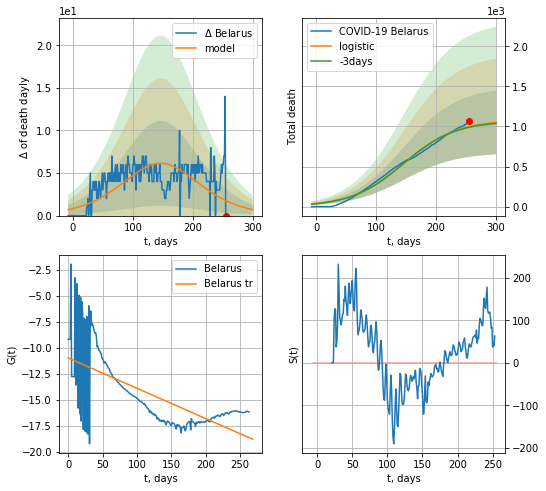

Belarus data at: 2020-11-18
+3 day model MAPE: 0.008761707497689793
model: logistic
coeffs:  [1.08164162e+03 2.27072167e-02 1.46732751e+02]
rational stdev:  0.37839452498406617
forecast at the end of period: +45 days
	 total death:  1050 ± 397
trend coefficient of determination: 0.463401
 intercept: -10.999921
 slope: -0.029175


In [722]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


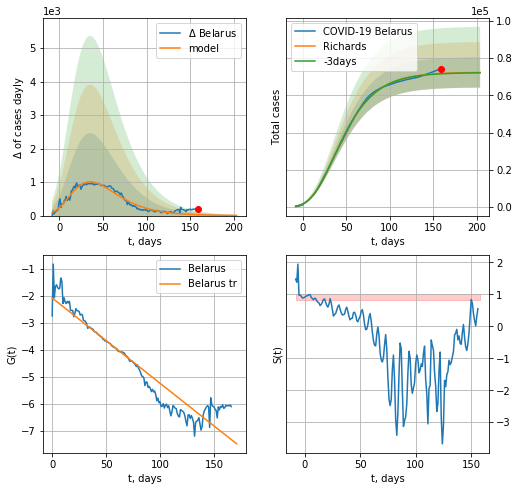

Belarus data at: 2020-11-18
+3 day model MAPE: 0.002728
model: Richards
coeffs: [ 7.24389440e+04  3.51273037e+00 -8.31196937e+01  1.08274995e-02]
rational stdev: 0.112826
forecast at the end of period: +45 days
	 deltaDaycases: 4
	 total cases: 72318 ± 8159
	 total death: 653 ± 221
trend coefficient of determination: 0.901412
 intercept: -2.084164
 slope: -0.031594


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


diffStd0a 0.3557054445709654


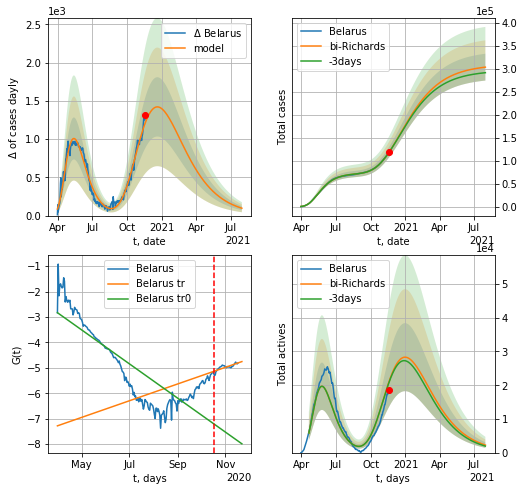

Belarus data at: 2020-11-18
+3 day model MAPE: 0.001958
model: bi-Richards
coeffs: [2.36953648e+05 6.26031907e-01 3.56741647e+01 2.63776070e-02]
rational stdev: 0.096135
forecast at the end of period: +255 days
	 deltaDaycases: 96
	 total cases: 303524 ± 29179
	 total death: 2744 ± 791
bi-Richards approximation splitting point: 200
actives k: 21
trend coefficient of determination: 0.690620
 intercept: -2.829322
 slope: -0.021854
trend coefficient of determination: 0.652571
 intercept: -7.279742
 slope: 0.010708


In [723]:
iL=32
vL = 200+iL#145+iL
x = forecastRR('Belarus',dfBR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Belarus',dfBR[iL:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.625)
#x = forecastRRR('Belarus',dfBR[iL:],d1,30*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


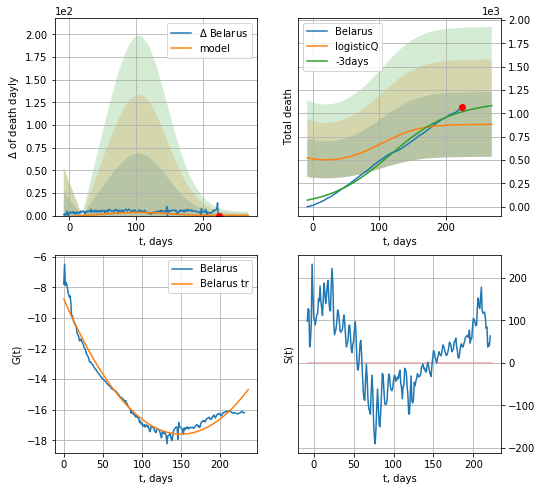

Belarus data at: 2020-11-18
+3 day model MAPE: 0.137608
model: logisticQ
coeffs: [7.44968003e+02 1.44544413e-04 3.26828781e+01 5.35358795e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.394140
forecast at the end of period: +45 days
	 total death: 882 ± 347
trend coefficient of determination: 0.964778
 intercept_: -8.767728800215853
 coeffs_: [ 0.         -0.11774942  0.00039288]


In [724]:
x = forecastRRR('Belarus',dfBR[32:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

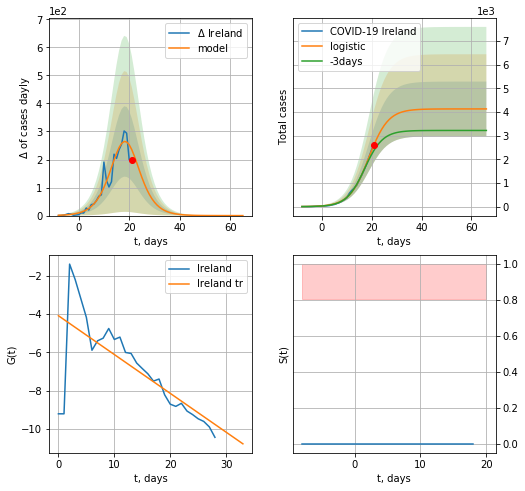

Ireland data at: 2020-11-18
+3 day model MAPE: 0.12282208937722881
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  4127 ± 1154
	 total death:  119 ± 99
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


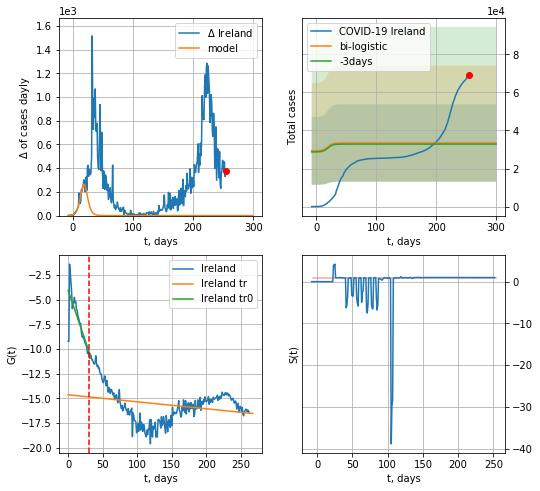

Ireland data at: 2020-11-18
+3 day model MAPE: 0.018016561954282126
model: bi-logistic
coeffs:  [ 2.34235609e+04 -1.72157776e+01  4.22253730e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6081779122517128
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  33406 ± 20317
	 total death:  970 ± 1769
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.068462
 intercept: -14.630298
 slope: -0.007081


In [725]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,T18*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


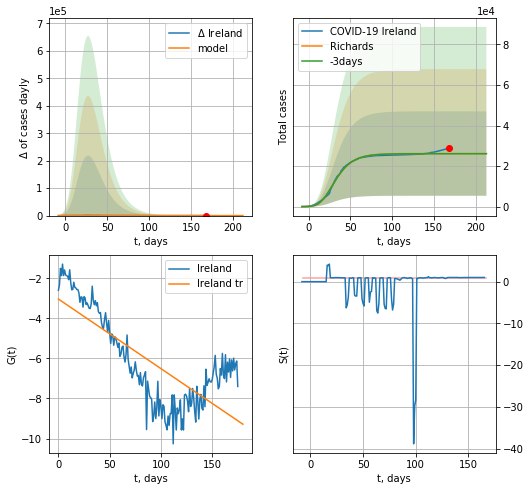

Ireland data at: 2020-11-18
+3 day model MAPE: 0.004030
model: Richards
coeffs: [ 2.61775984e+04  9.17020717e-01 -6.58016651e+00  8.00580200e-02]
rational stdev: 0.795180
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 26177 ± 20815
	 total death: 760 ± 1813
trend coefficient of determination: 0.587901
 intercept: -3.038276
 slope: -0.034699
diffStd0a 0.7286841319174238


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


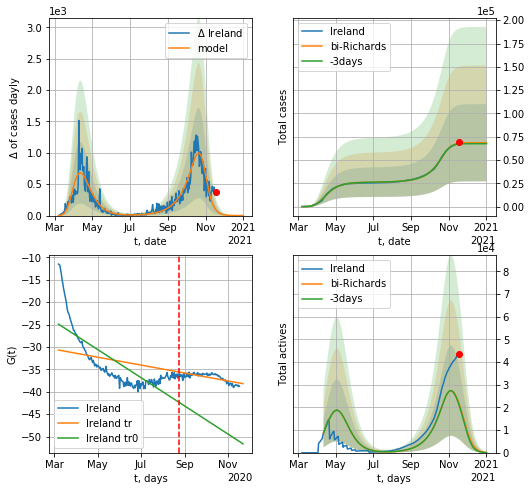

Ireland data at: 2020-11-18
+3 day model MAPE: 0.011384
model: bi-Richards
coeffs: [4.23429659e+04 4.97382150e-02 2.27707520e+02 3.00848197e+00]
rational stdev: 0.604690
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 68519 ± 41433
	 total death: 1990 ± 3610
bi-Richards approximation splitting point: 170
actives k: 35
trend coefficient of determination: 0.601262
 intercept: -24.909817
 slope: -0.102670
trend coefficient of determination: 0.530938
 intercept: -30.688150
 slope: -0.028829


In [726]:
ivL = 7
vL = 170 +ivL
x = forecastRR('Ireland',dfIR[ivL:vL+ivL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Ireland',dfIR[ivL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
#x = forecastRRR('Ireland',dfIR[3:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active    death
256 2020-11-14  529676    9656  14777.0
257 2020-11-15  531273    9754  14819.0
258 2020-11-16  532604    9674  14863.0
259 2020-11-17  533610    9326  14883.0
260 2020-11-18  534558    8895  14897.0


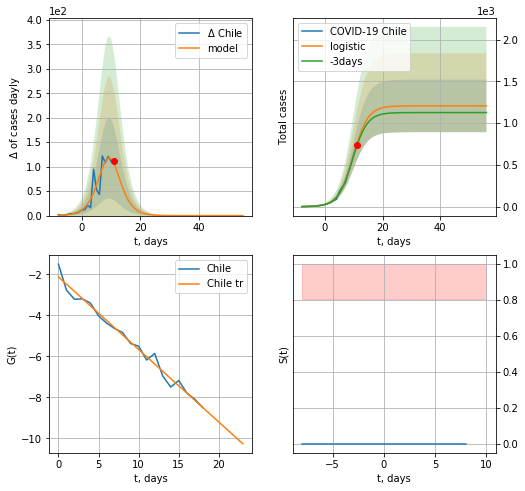

Chile data at: 2020-11-18
+3 day model MAPE: 0.03908993891192624
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  1207 ± 315
	 total death:  33 ± 25
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


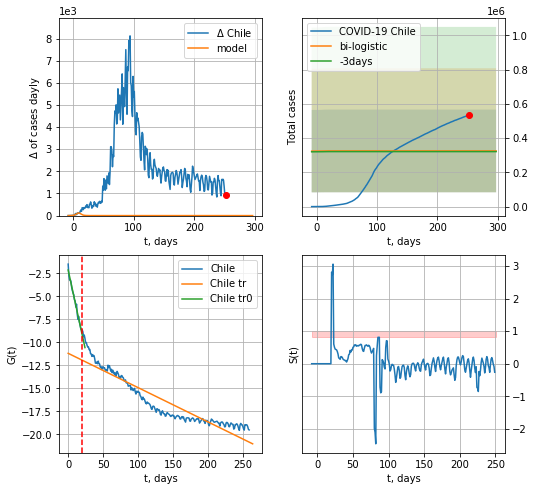

Chile data at: 2020-11-18
+3 day model MAPE: 0.012376670432285698
model: bi-logistic
coeffs:  [ 2.59029075e+05 -5.01570673e+01  1.19654373e+03] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7424977195770103
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  324993 ± 241307
	 total death:  9056 ± 20172
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.865506
 intercept: -11.198373
 slope: -0.037245


In [727]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*T18-dT)
xx = forecast2('Chile',dfCL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


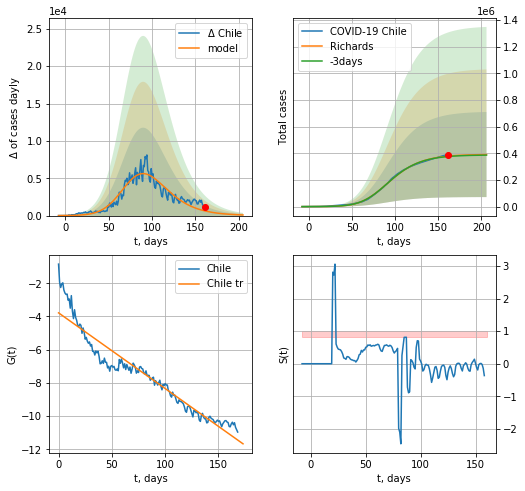

Chile data at: 2020-11-18
+3 day model MAPE: 0.007583
model: Richards
coeffs: [3.92652491e+05 1.16049666e-01 7.04582771e+01 4.00939983e-01]
rational stdev: 0.816952
forecast at the end of period: +45 days
	 deltaDaycases: 84
	 total cases: 390871 ± 319323
	 total death: 10892 ± 26694
trend coefficient of determination: 0.916357
 intercept: -3.781163
 slope: -0.045598
diffStd0a 0.7331934662732255


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:339: RuntimeWarning: overflow encountered in power


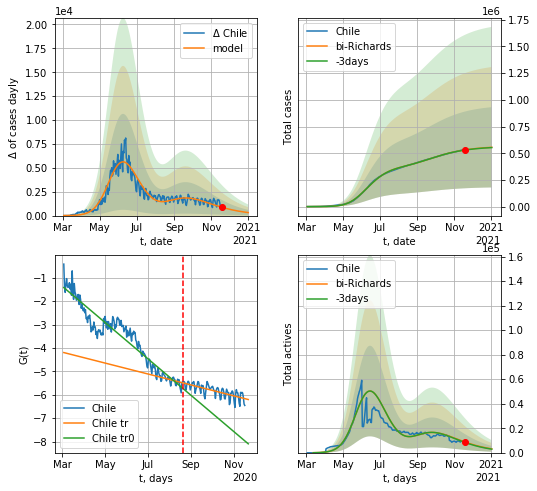

Chile data at: 2020-11-18
+3 day model MAPE: 0.002375
model: bi-Richards
coeffs: [1.75088713e+05 2.88325941e+00 2.35748192e+01 9.28652363e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.676554
forecast at the end of period: +45 days
	 deltaDaycases: 315
	 total cases: 555682 ± 375949
	 total death: 15485 ± 31429
bi-Richards approximation splitting point: 170
actives k: 10
trend coefficient of determination: 0.912746
 intercept: -1.417770
 slope: -0.025301
trend coefficient of determination: 0.520165
 intercept: -4.196571
 slope: -0.007603


In [728]:
vL = 170
x = forecastRR('Chile',dfCL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Chile',dfCL[:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL,amc=0.3)
#x = forecastRRR('Chile',dfCL[:],d1,24*7-dT,addpred=False,xcoef=koreaCoeffs)

In [729]:
#x = forecast('Czechia',dfCH[:],d1,T18*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

CH
           date     cases  active   death
258 2020-11-14  458229.0  129788  6058.0
259 2020-11-15  460116.0  126602  6208.0
260 2020-11-16  465523.0  117858  6416.0
261 2020-11-17  469769.0  109417  6558.0
262 2020-11-18  475284.0  100970  6740.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


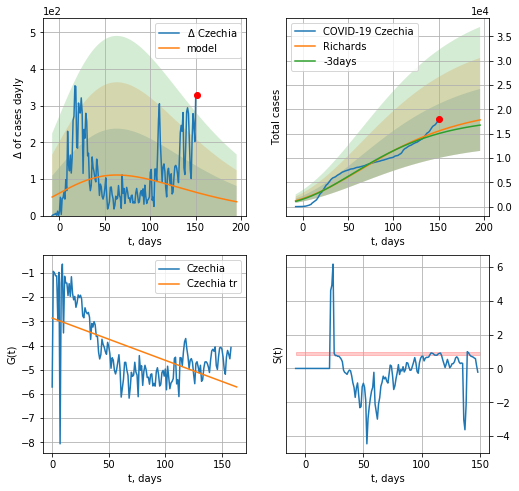

Czechia data at: 2020-11-18
+3 day model MAPE: 0.036194
model: Richards
coeffs: [ 2.05903469e+04  1.92716393e+00 -2.68842410e+02  7.61388243e-03]
rational stdev: 0.357386
forecast at the end of period: +45 days
	 deltaDaycases: 37
	 total cases: 17843 ± 6376
	 total death: 253 ± 271
trend coefficient of determination: 0.344405
 intercept: -2.865835
 slope: -0.017469
diffStd0a 0.901498270733812


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


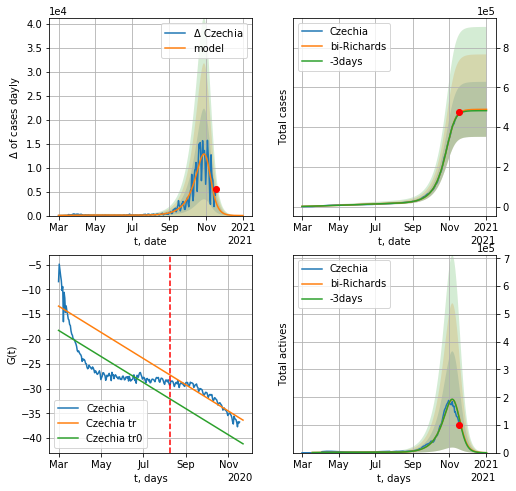

Czechia data at: 2020-11-18
+3 day model MAPE: 0.008283
model: bi-Richards
coeffs: [4.69625710e+05 6.36927411e-02 2.39504825e+02 2.47066238e+00]
rational stdev: 0.282526
forecast at the end of period: +45 days
	 deltaDaycases: 12
	 total cases: 489559 ± 138313
	 total death: 6942 ± 5883
bi-Richards approximation splitting point: 160
actives k: 17
trend coefficient of determination: 0.566440
 intercept: -18.263269
 slope: -0.086022
trend coefficient of determination: 0.892579
 intercept: -13.368003
 slope: -0.086454


In [730]:
vL= 160
dfCH = read_df(pd.DataFrame(),"CH")
x = forecastRR('Czechia',dfCH[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Czechia',dfCH[:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)
#x = forecastRRR('Czechia',dfCH[:],d1,60*7-dT,addpred=True,xcoef=koreaCoeffs)

In [731]:
dfMX = read_df(pd.DataFrame(),"MX")
#x = forecast('Mexico',dfMX[:],d1,T18*7-dT,addpred=True,xcoef=[.25,1.,2.])#

MX
           date    cases  active    death
251 2020-11-14  1003253  159633  98259.0
252 2020-11-15  1006522  157790  98542.0
253 2020-11-16  1009396  156335  98861.0
254 2020-11-17  1011153  154176  99026.0
255 2020-11-18  1015071  153518  99528.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


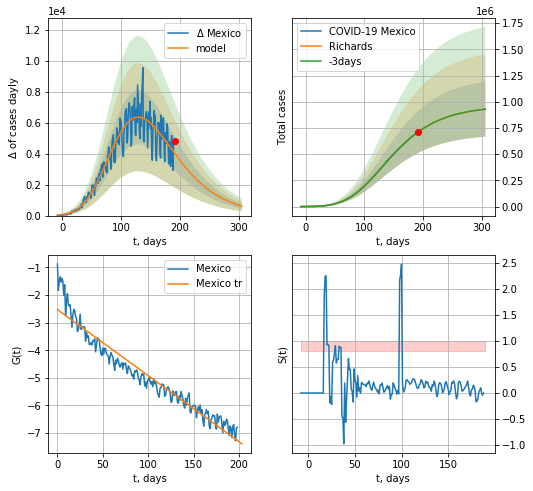

Mexico data at: 2020-11-18
+3 day model MAPE: 0.000227
model: Richards
coeffs: [9.60430195e+05 1.43865442e-01 2.46288519e+01 1.33315498e-01]
rational stdev: 0.281932
forecast at the end of period: +115 days
	 deltaDaycases: 608
	 total cases: 928399 ± 261745
	 total death: 91029 ± 76992
trend coefficient of determination: 0.932535
 intercept: -2.525774
 slope: -0.023953
diffStd0a 0.5485131707469098


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


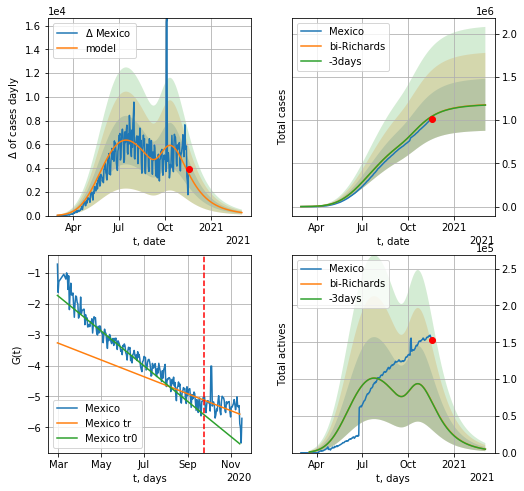

Mexico data at: 2020-11-18
+3 day model MAPE: 0.000608
model: bi-Richards
coeffs: [2.29852902e+05 3.55908334e+00 1.10197514e+02 1.10166755e-02]
rational stdev: 0.255209
forecast at the end of period: +115 days
	 deltaDaycases: 255
	 total cases: 1178129 ± 300668
	 total death: 115515 ± 88441
bi-Richards approximation splitting point: 200
actives k: 17
trend coefficient of determination: 0.946093
 intercept: -1.723940
 slope: -0.018578
trend coefficient of determination: 0.149460
 intercept: -3.262123
 slope: -0.008925


In [732]:
vL = 200#60
x = forecastRR('Mexico',dfMX[:vL],d1,50*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RRD('Mexico',dfMX[:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)
#x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=False,xcoef=koreaCoeffs)#

LT
           date    cases  active  death      tests
250 2020-11-14  34758.0   26620  277.0  1183216.0
251 2020-11-15  35911.0   27744  285.0  1187674.0
252 2020-11-16  36876.0   27894  299.0  1200154.0
253 2020-11-17  38810.0   29002  323.0  1212239.0
254 2020-11-18  38810.0   29125  323.0        NaN
Exception occurs


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:486: RuntimeWarning: divide by zero encountered in log


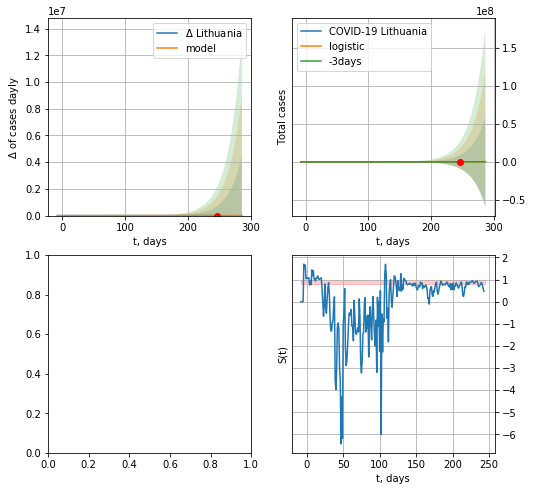

In [733]:
vL = 1
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [450]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [451]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:486: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

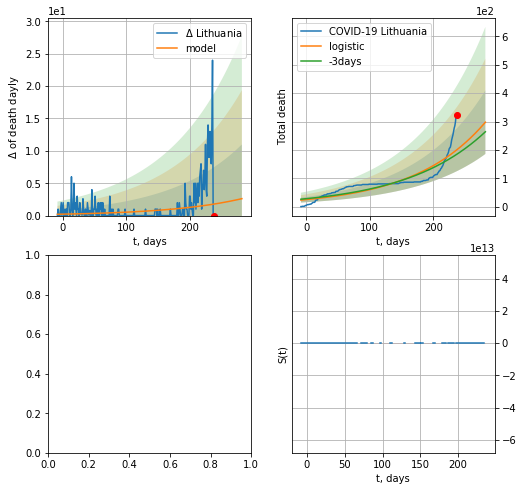

In [734]:
x = forecast('Lithuania',dfLT[9:],d1,7*T18-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


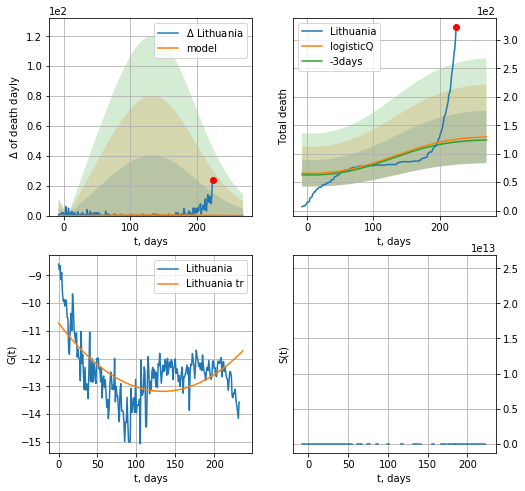

Lithuania data at: 2020-11-17
+3 day model MAPE: 0.038051
model: logisticQ
coeffs: [1.31103223e+02 6.41968746e-05 1.05297758e+01 1.96359508e+00]
rational stdev: 0.355906
forecast at the end of period: +46 days
	 total death: 129 ± 46
trend coefficient of determination: 0.348085
 intercept_: -10.721513119114233
 coeffs_: [ 0.         -0.03676164  0.00013746]


In [453]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
#x = forecastRRR('Lithuania',dfLT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


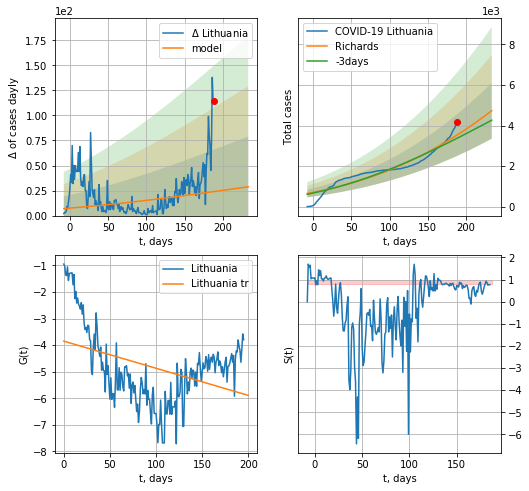

Lithuania data at: 2020-11-17
+3 day model MAPE: 0.047775
model: Richards
coeffs: [ 5.54183199e+04  1.08265666e-01 -8.74523027e+02  2.35063639e-02]
rational stdev: 0.291066
forecast at the end of period: +46 days
	 deltaDaycases: 28
	 total cases: 4732 ± 1377
	 total death: 38 ± 33
trend coefficient of determination: 0.159230
 intercept: -3.851608
 slope: -0.010200
diffStd0a 0.6938750984327917


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


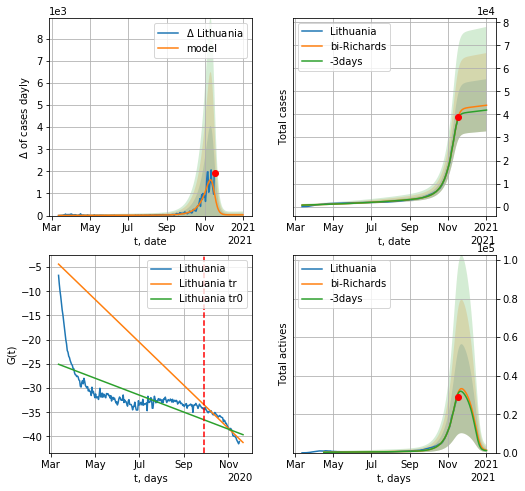

Lithuania data at: 2020-11-17
+3 day model MAPE: 0.018649
model: bi-Richards
coeffs: [3.75550127e+04 8.27382257e-02 2.39833897e+02 3.60202289e+00]
rational stdev: 0.257617
forecast at the end of period: +46 days
	 deltaDaycases: 34
	 total cases: 43995 ± 11334
	 total death: 356 ± 275
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.454409
 intercept: -25.084214
 slope: -0.057288
trend coefficient of determination: 0.925109
 intercept: -4.390155
 slope: -0.145072


In [454]:
iL = 3
vL =200+iL#170+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RRD('Lithuania',dfLT[iL:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


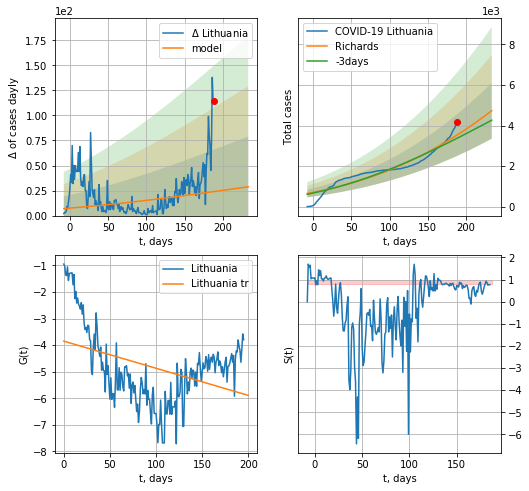

Lithuania data at: 2020-11-17
+3 day model MAPE: 0.047775
model: Richards
coeffs: [ 5.54183199e+04  1.08265666e-01 -8.74523027e+02  2.35063639e-02]
rational stdev: 0.291066
forecast at the end of period: +46 days
	 deltaDaycases: 28
	 total cases: 4732 ± 1377
	 total death: 38 ± 33
trend coefficient of determination: 0.159230
 intercept: -3.851608
 slope: -0.010200
diffStd0a 0.6938750984327917


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:551: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:551: RuntimeWarning: divide by zero encountered in true_divide


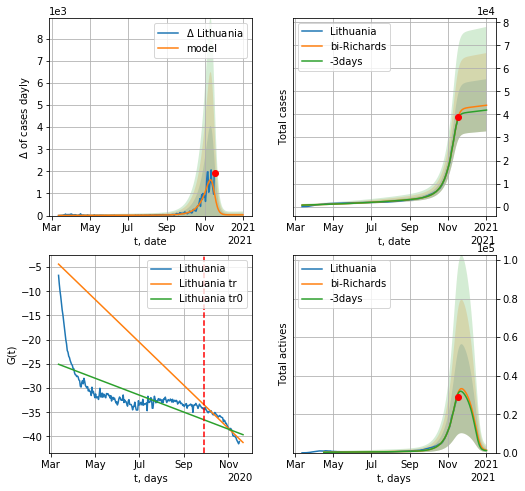

Lithuania data at: 2020-11-17
+3 day model MAPE: 0.018649
model: bi-Richards
coeffs: [3.75550127e+04 8.27382257e-02 2.39833897e+02 3.60202289e+00]
rational stdev: 0.257617
forecast at the end of period: +46 days
	 deltaDaycases: 34
	 total cases: 43995 ± 11334
	 total death: 356 ± 275
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.454409
 intercept: -25.084214
 slope: -0.057288
trend coefficient of determination: 0.925109
 intercept: -4.390155
 slope: -0.145072


In [455]:
iL = 3
vL =200+iL#170+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx, t, dtt, ttt20, diffStd0a = forecast2RRDA('Lithuania',dfLT[iL:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,cases='cases',vL=vL-iL)#
#xx = forecast2RRA('Lithuania',dfLT[iL:],d1,90*7-dT,x,addpred=False,xcoef=RAkoreaCoeffs,vL=vL-iL,cases='active')#

In [457]:
t, dtt, ttt20, diffStd0a
import datetime
a=zip(dtt, ttt20)
print (t[35])
i = -1
stdevc = 0.867612
for a1,a2 in a:
    i = i + 1
    if i<215: continue
    print (i,a1,int(a2),'±',int(a2*diffStd0a))
    print (i,'8%',a1,int(a2*0.08),'±',int(0.08*a2*diffStd0a))
    print (i,'5%',a1,int(a2*0.05),'±',int(0.05*a2*diffStd0a))
    
#dfLT['date'][tt]

35
215 2020-11-17 00:00:00 30837 ± 21397
215 8% 2020-11-17 00:00:00 2466 ± 1711
215 5% 2020-11-17 00:00:00 1541 ± 1069
216 2020-11-18 00:00:00 31657 ± 21966
216 8% 2020-11-18 00:00:00 2532 ± 1757
216 5% 2020-11-18 00:00:00 1582 ± 1098
217 2020-11-19 00:00:00 32300 ± 22412
217 8% 2020-11-19 00:00:00 2584 ± 1792
217 5% 2020-11-19 00:00:00 1615 ± 1120
218 2020-11-20 00:00:00 32772 ± 22739
218 8% 2020-11-20 00:00:00 2621 ± 1819
218 5% 2020-11-20 00:00:00 1638 ± 1136
219 2020-11-21 00:00:00 33084 ± 22956
219 8% 2020-11-21 00:00:00 2646 ± 1836
219 5% 2020-11-21 00:00:00 1654 ± 1147
220 2020-11-22 00:00:00 33252 ± 23073
220 8% 2020-11-22 00:00:00 2660 ± 1845
220 5% 2020-11-22 00:00:00 1662 ± 1153
221 2020-11-23 00:00:00 33295 ± 23102
221 8% 2020-11-23 00:00:00 2663 ± 1848
221 5% 2020-11-23 00:00:00 1664 ± 1155
222 2020-11-24 00:00:00 33227 ± 23055
222 8% 2020-11-24 00:00:00 2658 ± 1844
222 5% 2020-11-24 00:00:00 1661 ± 1152
223 2020-11-25 00:00:00 33063 ± 22942
223 8% 2020-11-25 00:00:00 2645

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


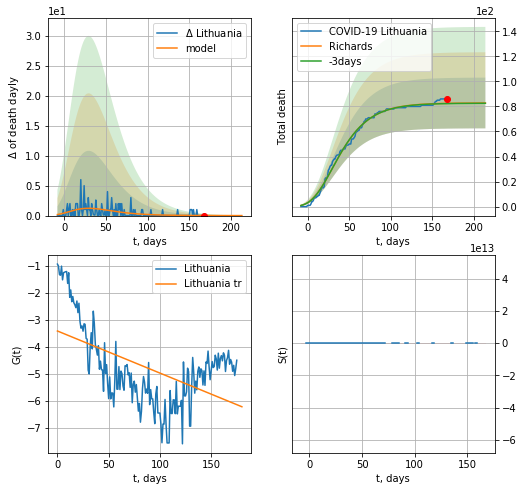

Lithuania data at: 2020-11-17
+3 day model MAPE: 0.002495
model: Richards
coeffs: [ 8.28105392e+01  6.19948354e+00 -9.53688137e+01  6.48963991e-03]
rational stdev: 0.244736
forecast at the end of period: +46 days
	 total death: 82 ± 20
trend coefficient of determination: 0.280445
 intercept: -3.404567
 slope: -0.015594
diffStd0a 125.31278231731885


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


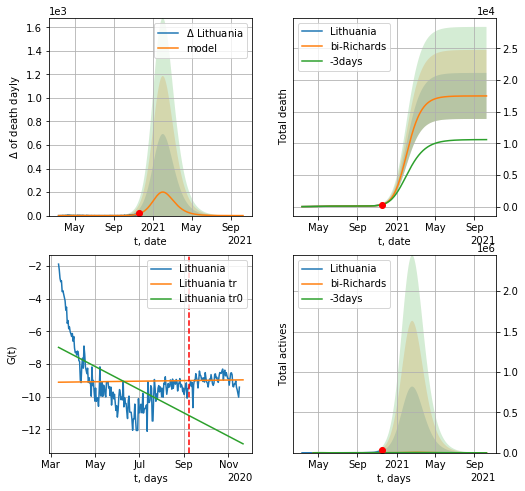

Lithuania data at: 2020-11-17
+3 day model MAPE: 0.016981
model: bi-Richards
coeffs: [1.74080242e+04 6.64532477e-02 3.05002272e+02 6.06878099e-01]
rational stdev: 0.207930
forecast at the end of period: +326 days
	 total death: 17490 ± 3636
bi-Richards approximation splitting point: 180
trend coefficient of determination: 0.362992
 intercept: -6.980499
 slope: -0.023208
trend coefficient of determination: 0.000814
 intercept: -9.110511
 slope: 0.000566


In [458]:
iL = 3
vL =180+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs,cases='death')#
xx = forecast2RRD('Lithuania',dfLT[iL:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,cases='death')#

In [331]:
#x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date    cases  active  death
252 2020-11-14  26544.0   10894  222.0
253 2020-11-15  27092.0   11438  226.0
254 2020-11-16  27256.0    9286  236.0
255 2020-11-17  27681.0    9417  240.0
256 2020-11-18  28573.0    9821  248.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


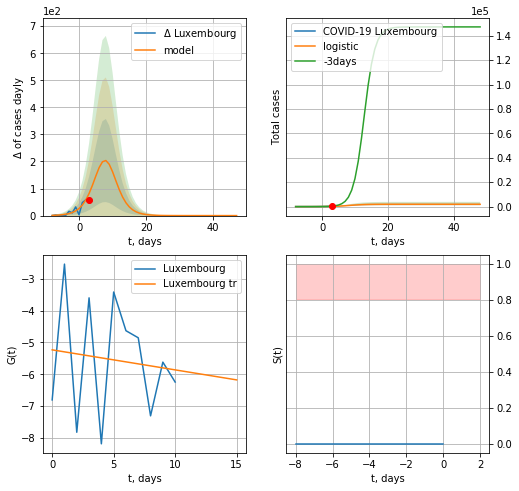

Luxembourg data at: 2020-11-18
model: logistic
coeffs:  [1.87757966e+03 4.36654344e-01 8.24919508e+00]
rational stdev:  0.35795936969501296
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  1877 ± 672
	 total death:  16 ± 17
trend coefficient of determination: 0.012091
 intercept: -5.231862
 slope: -0.063083


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


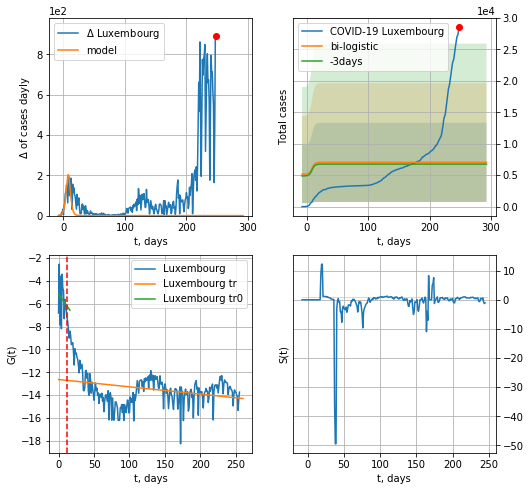

Luxembourg data at: 2020-11-18
+3 day model MAPE: 0.04203981749249652
model: bi-logistic
coeffs:  [4587.71340934  -26.53557193  659.13319694] [1.87757966e+03 4.36654344e-01 8.24919508e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.894019333249406
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  7038 ± 6292
	 total death:  61 ± 163
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.030158
 intercept: -5.146907
 slope: -0.088569
trend coefficient of determination: 0.087219
 intercept: -12.628159
 slope: -0.006404


In [735]:
try:
    dfLX = read_df(pd.DataFrame(),"LX")
    x = forecast("Luxembourg",dfLX[:12],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Luxembourg",dfLX[:],d1,T18*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


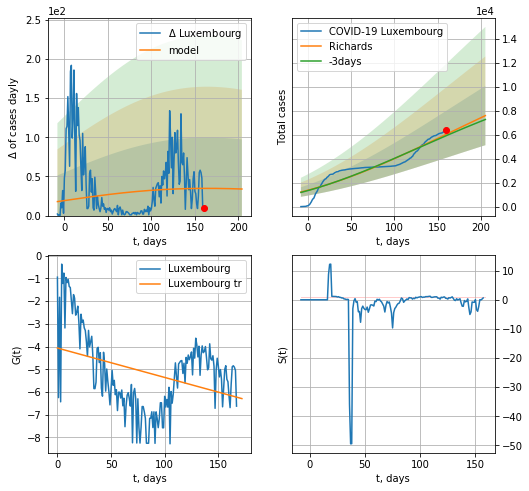

Luxembourg data at: 2020-11-18
+3 day model MAPE: 0.019794
model: Richards
coeffs: [ 1.66800613e+04  3.06060203e-01 -5.31170358e+02  1.86938235e-02]
rational stdev: 0.324841
forecast at the end of period: +45 days
	 deltaDaycases: 33
	 total cases: 7594 ± 2466
	 total death: 65 ± 63
trend coefficient of determination: 0.129435
 intercept: -4.066706
 slope: -0.012924
diffStd0a 1.27503139464524


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


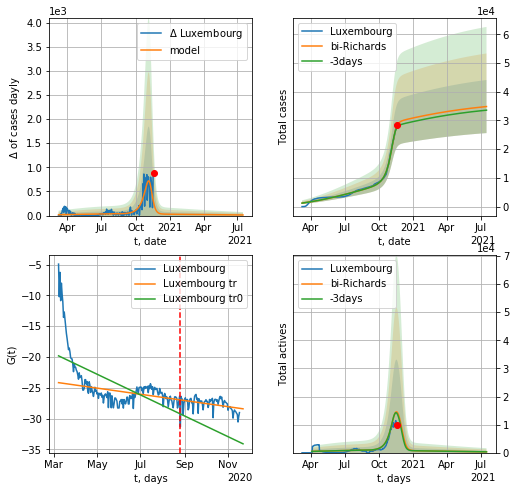

Luxembourg data at: 2020-11-18
+3 day model MAPE: 0.023714
model: bi-Richards
coeffs: [2.05732528e+04 7.73878281e-02 2.38966500e+02 2.49095086e+00]
rational stdev: 0.265256
forecast at the end of period: +241 days
	 deltaDaycases: 12
	 total cases: 34833 ± 9239
	 total death: 302 ± 240
bi-Richards approximation splitting point: 170
actives k: 26
trend coefficient of determination: 0.392783
 intercept: -19.816542
 slope: -0.055129
trend coefficient of determination: 0.145900
 intercept: -24.167515
 slope: -0.016389


In [736]:
iL=1
vL = 170+iL#105+iL-10
x = forecastRR("Luxembourg",dfLX[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Luxembourg",dfLX[iL:],d1,68*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


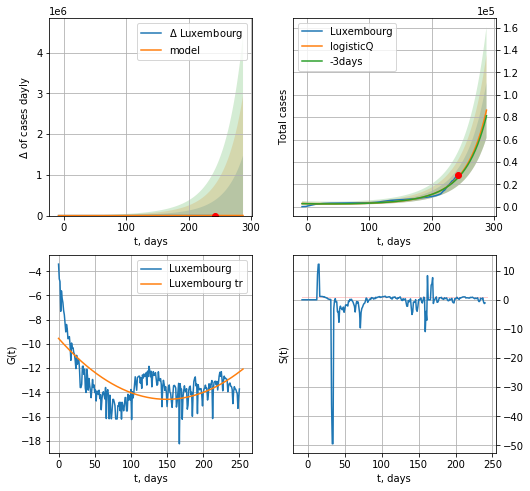

Luxembourg data at: 2020-11-18
+3 day model MAPE: 0.025033
model: logisticQ
coeffs: [ 7.55887183e+07  5.69717336e-05  4.63715041e+02 -3.88711276e+02]
rational stdev: 0.287590
forecast at the end of period: +45 days
	 deltaDaycases: 2420
	 total cases: 86272 ± 24810
	 total death: 748 ± 645
trend coefficient of determination: 0.436230
 intercept_: -9.54549721715419
 coeffs_: [ 0.         -0.0672942   0.00022497]


In [737]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)

In [738]:
dfED = read_df(pd.DataFrame(),"ED")
#x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

ED
           date     cases   active    death
259 2020-11-14  179627.0  11674.0  12997.0
260 2020-11-15  180295.0   6648.0  13008.0
261 2020-11-16  180676.0   7021.0  13016.0
262 2020-11-17  181104.0   7440.0  13025.0
263 2020-11-18  182250.0   8559.0  13052.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


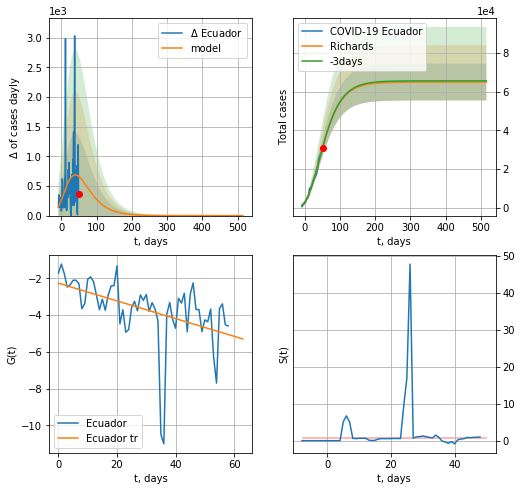

Ecuador data at: 2020-11-18
+3 day model MAPE: 0.001443
model: Richards
coeffs: [ 6.49031363e+04  1.85787235e+00 -1.03613231e+02  1.55703468e-02]
rational stdev: 0.146273
forecast at the end of period: +465 days
	 deltaDaycases: 0
	 total cases: 64903 ± 9493
	 total death: 4648 ± 2039
trend coefficient of determination: 0.218364
 intercept: -2.268609
 slope: -0.048096
diffStd0a 0.729439988436471


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


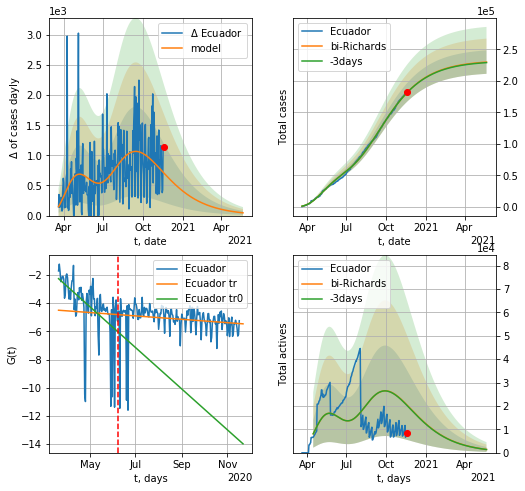

Ecuador data at: 2020-11-18
+3 day model MAPE: 0.001324
model: bi-Richards
coeffs: [ 1.67475742e+05  1.17265537e+00 -7.77668207e+01  1.43197257e-02]
rational stdev: 0.080947
forecast at the end of period: +185 days
	 deltaDaycases: 45
	 total cases: 229659 ± 18590
	 total death: 16447 ± 3994
bi-Richards approximation splitting point: 80
actives k: 26
trend coefficient of determination: 0.275268
 intercept: -2.255088
 slope: -0.047502
trend coefficient of determination: 0.029626
 intercept: -4.498155
 slope: -0.003909


In [739]:
vL = 80+20
x = forecastRR("Ecuador",dfED[20:vL-20],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Ecuador",dfED[20:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20,amc=0.75)

In [740]:
#x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date    cases  active  death
263 2020-11-14  19102.0    4733  369.0
264 2020-11-15  19315.0    4946  369.0
265 2020-11-16  19419.0    5048  371.0
266 2020-11-17  19647.0    5276  371.0
267 2020-11-18  19935.0    4261  374.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


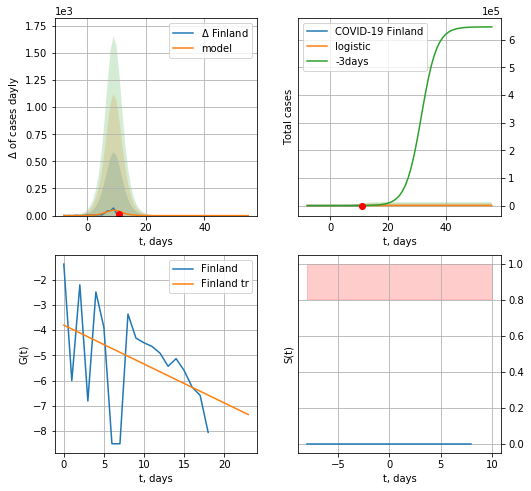

Finland data at: 2020-11-18
+3 day model MAPE: 0.3536795630191518
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  373 ± 4115
	 total death:  7 ± 231
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


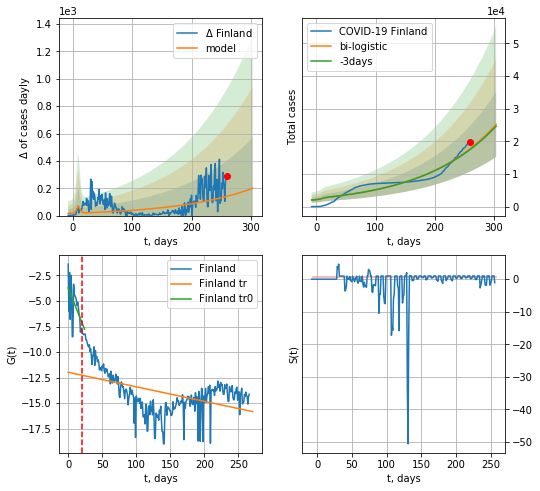

Finland data at: 2020-11-18
+3 day model MAPE: 0.014881970476781293
model: bi-logistic
coeffs:  [3.01971536e+07 8.10546990e-03 1.18031939e+03] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3953589694268351
forecast at the end of period: +45 days
	 deltaDaycases:  200
	 total cases:  25197 ± 9962
	 total death:  472 ± 559
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.224385
 intercept: -11.986136
 slope: -0.014214


In [741]:
try:
    dfFI = read_df(pd.DataFrame(),"FI")
    vL=20
    x = forecast("Finland",dfFI[:vL],d1,7*T18-dT)
    xx = forecast2("Finland",dfFI[:],d1,T18*7-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


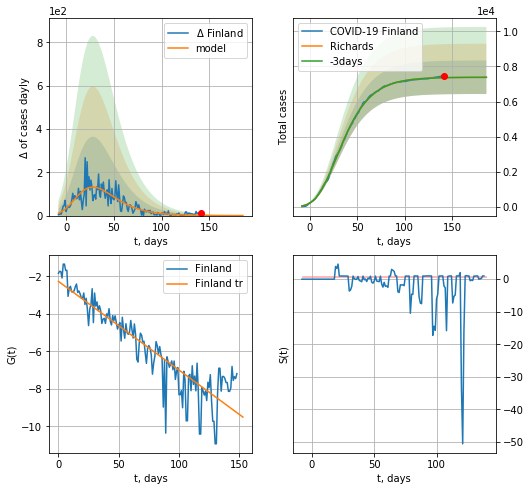

Finland data at: 2020-11-18
+3 day model MAPE: 0.001103
model: Richards
coeffs: [ 7.38854164e+03  5.39963308e-01 -1.81801816e+01  9.38814747e-02]
rational stdev: 0.129256
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 7386 ± 954
	 total death: 138 ± 53
trend coefficient of determination: 0.823115
 intercept: -2.267352
 slope: -0.047318
diffStd0a 0.2972928590914451


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


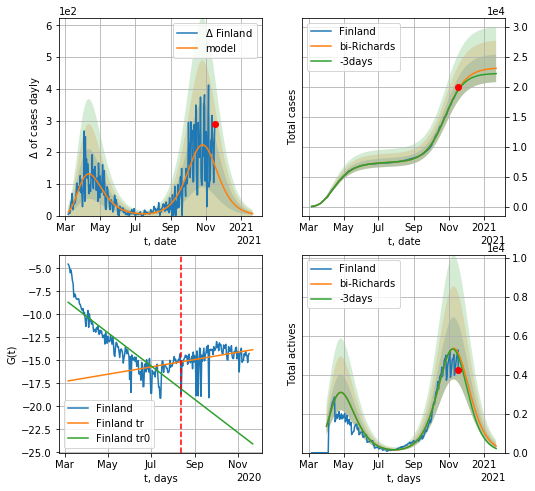

Finland data at: 2020-11-18
+3 day model MAPE: 0.009238
model: bi-Richards
coeffs: [1.58461561e+04 5.59077104e-02 2.27244140e+02 1.01231633e+00]
rational stdev: 0.099747
forecast at the end of period: +66 days
	 deltaDaycases: 6
	 total cases: 23126 ± 2306
	 total death: 433 ± 129
bi-Richards approximation splitting point: 160
actives k: 26
trend coefficient of determination: 0.753520
 intercept: -8.685696
 slope: -0.058929
trend coefficient of determination: 0.090605
 intercept: -17.232199
 slope: 0.012988


In [742]:
vL = 170#96 + 10 + 25
x = forecastRR("Finland",dfFI[10:vL-10],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Finland",dfFI[10:],d12f(1),43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10,amc=0.75)

In [743]:
## x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date   cases   active   death
249 2020-11-14   97435  66539.0  2091.0
250 2020-11-15   98251  66746.0  2130.0
251 2020-11-16  101770  69171.0  2282.0
252 2020-11-17  106598  72649.0  2413.0
253 2020-11-18  110536  75526.0  2530.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


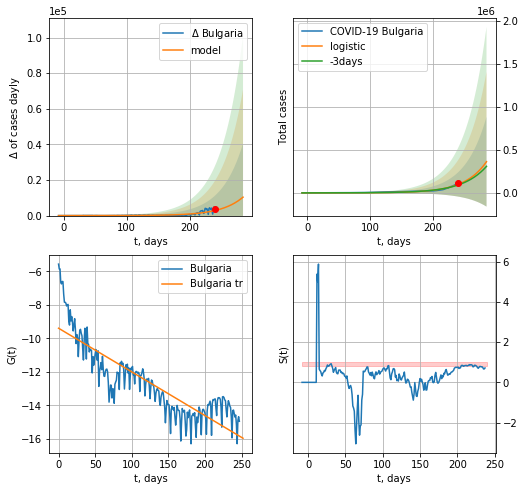

Bulgaria data at: 2020-11-18
+3 day model MAPE: 0.06948172316104254
model: logistic
coeffs:  [7.47589701e+08 2.89968114e-02 5.48178046e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  1.4406350423712668
forecast at the end of period: +45 days
	 deltaDaycases:  10353
	 total cases:  362418 ± 522113
	 total death:  8295 ± 35850
trend coefficient of determination: 0.741038
 intercept: -9.388856
 slope: -0.026070


In [744]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,T18*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


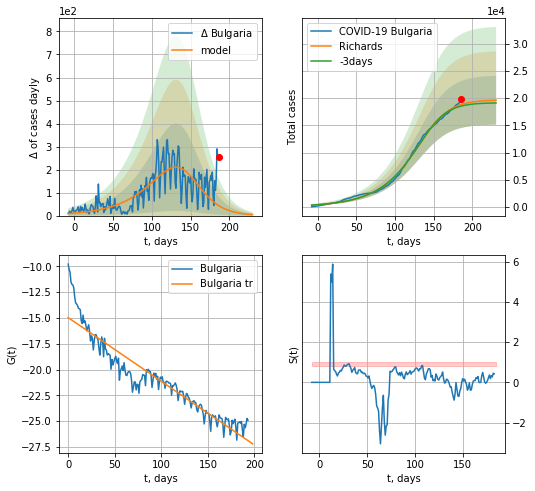

Bulgaria data at: 2020-11-18
+3 day model MAPE: 0.015854
model: Richards
coeffs: [1.96955662e+04 2.71935660e-02 1.44494444e+02 2.07644343e+00]
rational stdev: 0.229297
forecast at the end of period: +45 days
	 deltaDaycases: 4
	 total cases: 19624 ± 4499
	 total death: 449 ± 308
trend coefficient of determination: 0.884878
 intercept: -14.971872
 slope: -0.061709
diffStd0a 0.3491111386359664


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


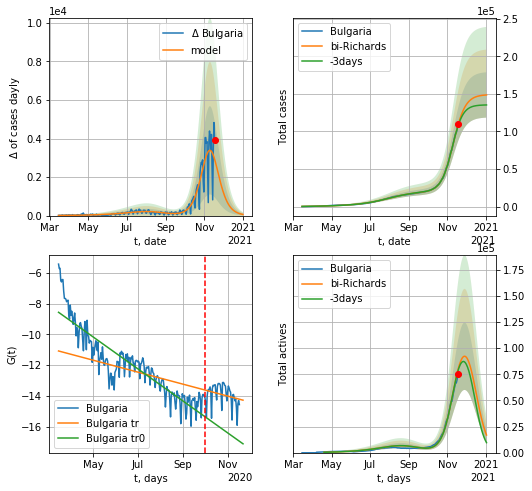

Bulgaria data at: 2020-11-18
+3 day model MAPE: 0.016255
model: bi-Richards
coeffs: [1.29431865e+05 1.07078408e-01 2.31780635e+02 9.67094590e-01]
rational stdev: 0.203008
forecast at the end of period: +45 days
	 deltaDaycases: 58
	 total cases: 148585 ± 30163
	 total death: 3400 ± 2070
bi-Richards approximation splitting point: 200
actives k: 35
trend coefficient of determination: 0.816276
 intercept: -8.563923
 slope: -0.033931
trend coefficient of determination: 0.065621
 intercept: -11.079000
 slope: -0.012690


In [745]:
vL = 200+5#71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,T18*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Bulgaria',dfBL[5:],d1,40*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [746]:
#x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
261 2020-11-14  3874.0    99.0   60.0
262 2020-11-15  3875.0    94.0   60.0
263 2020-11-16  3878.0    94.0   60.0
264 2020-11-17  3880.0    91.0   60.0
265 2020-11-18  3888.0    86.0   60.0


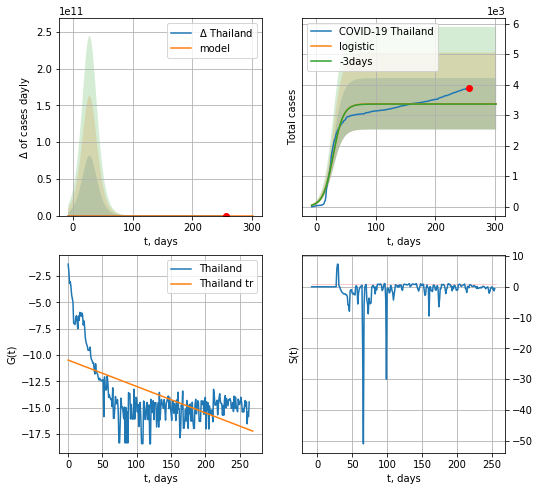

Thailand data at: 2020-11-18
+3 day model MAPE: 0.002516193699195567
model: logistic
coeffs:  [3.36925108e+03 1.17373495e-01 2.82134129e+01]
rational stdev:  0.24929345684488283
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  3369 ± 839
	 total death:  51 ± 38
trend coefficient of determination: 0.359422
 intercept: -10.485149
 slope: -0.025008


In [747]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [748]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


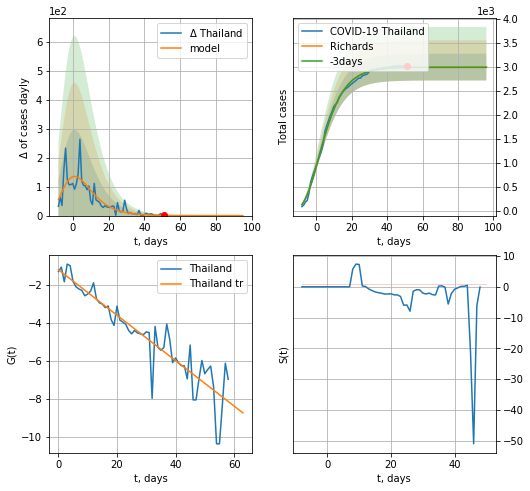

Thailand data at: 2020-11-18
+3 day model MAPE: 0.001958
model: Richards
coeffs: [ 2.99625224e+03  1.57427901e+01 -3.79340304e+01  7.81992540e-03]
rational stdev: 0.093292
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 2996 ± 279
	 total death: 46 ± 12
trend coefficient of determination: 0.845848
 intercept: -1.208254
 slope: -0.119672
diffStd0a 0.4294990559020159


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


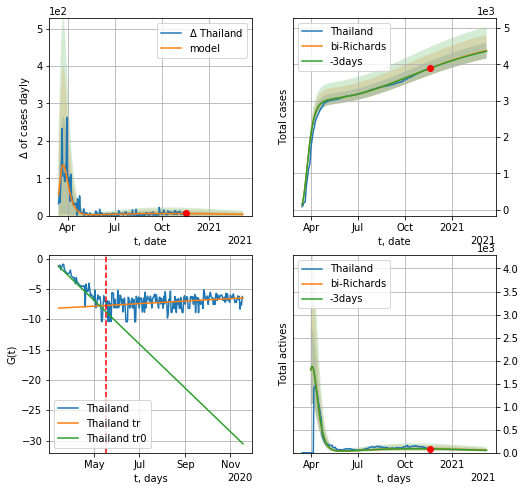

Thailand data at: 2020-11-18
+3 day model MAPE: 0.000930
model: bi-Richards
coeffs: [ 1.83989798e+03  8.86455877e-01 -3.56349563e+02  9.42136165e-03]
rational stdev: 0.049627
forecast at the end of period: +115 days
	 deltaDaycases: 3
	 total cases: 4378 ± 217
	 total death: 67 ± 9
bi-Richards approximation splitting point: 60
actives k: 17
trend coefficient of determination: 0.843409
 intercept: -1.259732
 slope: -0.117611
trend coefficient of determination: 0.100364
 intercept: -8.176460
 slope: 0.006770


In [749]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Thailand",dfTH[20:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20,amc=0.5)

In [750]:
#x = forecastRRR("Thailand",dfTH[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

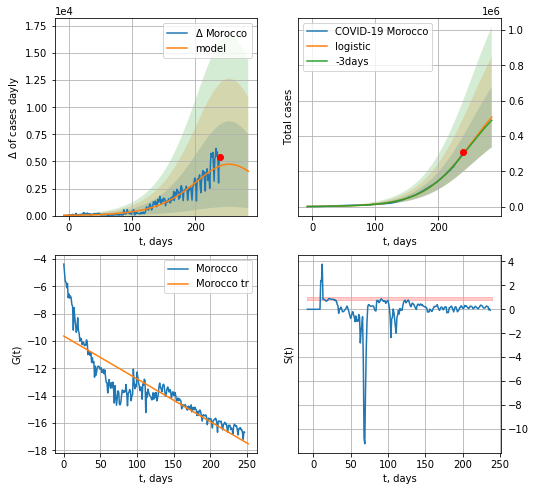

Morocco data at: 2020-11-18
+3 day model MAPE: 0.009979064070968184
model: logistic
coeffs:  [7.37244471e+05 2.57482171e-02 2.54324839e+02]
rational stdev:  0.3363179275077447
forecast at the end of period: +45 days
	 deltaDaycases:  4095
	 total cases:  507073 ± 170537
	 total death:  8280 ± 8354
trend coefficient of determination: 0.771273
 intercept: -9.631377
 slope: -0.031306


In [751]:
x = forecast("Morocco",dfMR[5:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


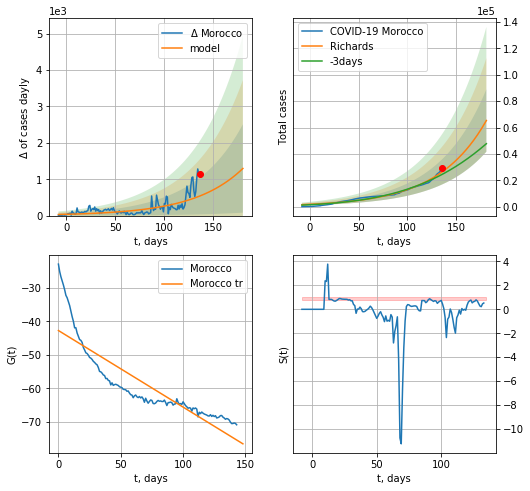

Morocco data at: 2020-11-18
+3 day model MAPE: 0.084312
model: Richards
coeffs: [2.79033948e+05 2.00180443e-02 2.53488041e+02 6.56605643e+00]
rational stdev: 0.361985
forecast at the end of period: +45 days
	 deltaDaycases: 1295
	 total cases: 65382 ± 23667
	 total death: 1067 ± 1158
trend coefficient of determination: 0.761351
 intercept: -42.734375
 slope: -0.228487
diffStd0a 1.3073237712024504


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


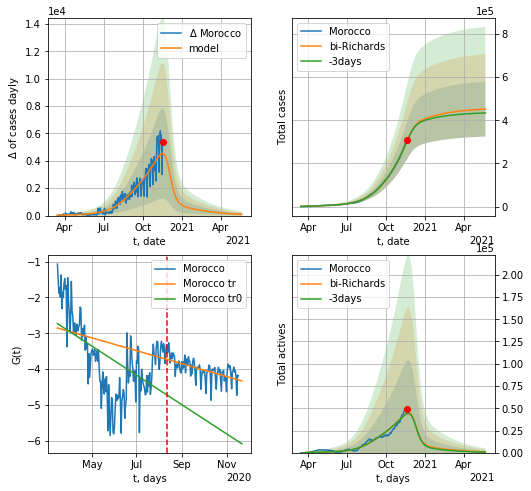

Morocco data at: 2020-11-18
+3 day model MAPE: 0.007549
model: bi-Richards
coeffs: [ 1.78274851e+05  1.38147574e+00 -6.19381446e+01  1.16787203e-02]
rational stdev: 0.281113
forecast at the end of period: +185 days
	 deltaDaycases: 92
	 total cases: 451494 ± 126920
	 total death: 7372 ± 6217
bi-Richards approximation splitting point: 150
actives k: 11
trend coefficient of determination: 0.297431
 intercept: -2.731516
 slope: -0.013318
trend coefficient of determination: 0.345870
 intercept: -2.851841
 slope: -0.005869


In [752]:
vL = 155 
x = forecastRR("Morocco",dfMR[5:vL-5],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Morocco",dfMR[5:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5,amc=0.33)

In [753]:
#x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [754]:
dfRM = read_df(pd.DataFrame(),"RM")
#x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

RM
           date     cases  active   death
262 2020-11-14  353185.0  105321  8813.0
263 2020-11-15  360281.0  107523  8926.0
264 2020-11-16  365212.0  109504  9075.0
265 2020-11-17  373474.0  110969  9261.0
266 2020-11-18  383743.0  112927  9429.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


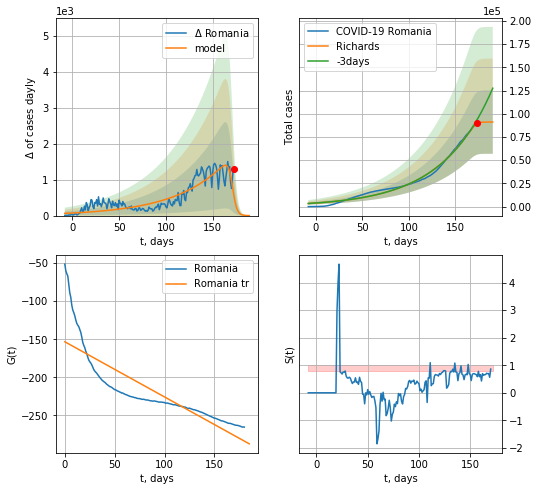

Romania data at: 2020-11-18
+3 day model MAPE: 0.053954
model: Richards
coeffs: [9.10483361e+04 1.84517813e-02 1.71468019e+02 2.28787361e+01]
rational stdev: 0.374976
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 91046 ± 34140
	 total death: 2237 ± 2516
trend coefficient of determination: 0.713660
 intercept: -153.246272
 slope: -0.723824
diffStd0a 0.9369834398137362


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


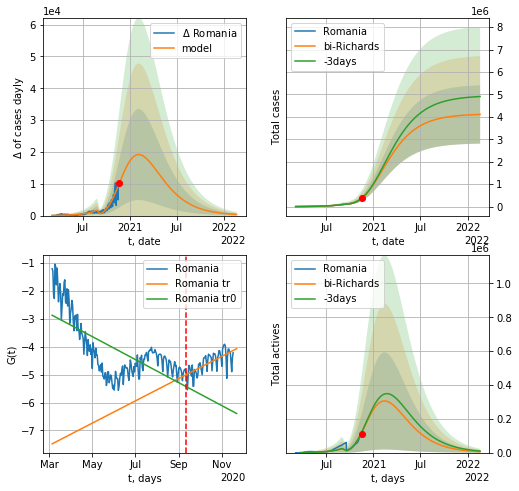

Romania data at: 2020-11-18
+3 day model MAPE: 0.005465
model: bi-Richards
coeffs: [4.04296965e+06 2.86014996e-01 9.44315119e+01 4.61190872e-02]
rational stdev: 0.316528
forecast at the end of period: +458 days
	 deltaDaycases: 353
	 total cases: 4107325 ± 1300084
	 total death: 100921 ± 95833
bi-Richards approximation splitting point: 190
actives k: 17
trend coefficient of determination: 0.483981
 intercept: -2.870916
 slope: -0.013449
trend coefficient of determination: 0.463528
 intercept: -7.481227
 slope: 0.013020


In [755]:
vL = 190+8#87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Romania",dfRM[8:],d12f(1),99*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8,amc=0.5)

In [756]:
#xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [757]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

In [758]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
#x = forecast("European Union",dfEU[:vL],d1,T18*7-dT)
#xx = forecast2("European Union",dfEU[:vL1],d1,T18*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("European Union",dfEU,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

EU
           date    cases   active     death
280 2020-11-14  9217952  4444102  213626.0
281 2020-11-15  9362946  4544427  215750.0
282 2020-11-16  9531287  4562090  219124.0
283 2020-11-17  9723556  4622698  223741.0
284 2020-11-18  9879897  4674526  226822.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


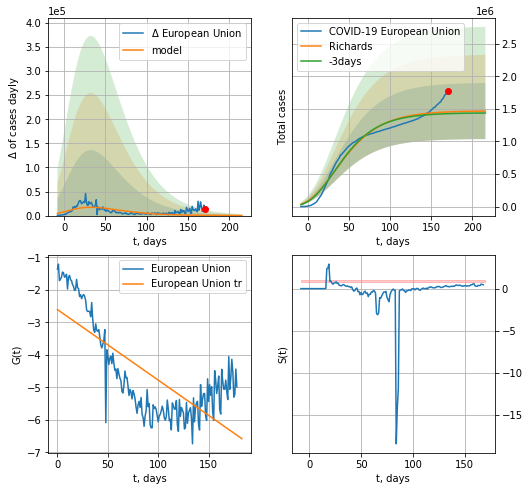

European Union data at: 2020-11-18
+3 day model MAPE: 0.018821
model: Richards
coeffs: [ 1.47108264e+06  9.68553883e+00 -1.45516242e+02  3.30701527e-03]
rational stdev: 0.293203
forecast at the end of period: +45 days
	 deltaDaycases: 135
	 total cases: 1466926 ± 430107
	 total death: 33677 ± 29622
trend coefficient of determination: 0.571524
 intercept: -2.605625
 slope: -0.021726
diffStd0a 0.30700809975340565


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


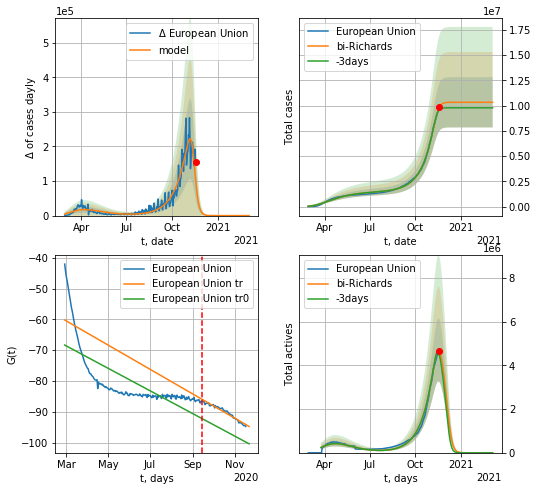

European Union data at: 2020-11-18
+3 day model MAPE: 0.028257
model: bi-Richards
coeffs: [8.85821521e+06 4.13897489e-02 2.52262388e+02 5.62616576e+00]
rational stdev: 0.240852
forecast at the end of period: +108 days
	 deltaDaycases: 1
	 total cases: 10329261 ± 2487820
	 total death: 237138 ± 171345
bi-Richards approximation splitting point: 200
actives k: 26
trend coefficient of determination: 0.535816
 intercept: -68.331806
 slope: -0.119565
trend coefficient of determination: 0.956024
 intercept: -60.206465
 slope: -0.128913


In [759]:
vL = 200+20#83+20+17
x = forecastRR("European Union",dfEU[20:vL-20],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("European Union",dfEU[20:],d1,49*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20,amc=0.75)

In [760]:
#x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [761]:
#x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [762]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [763]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [764]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [765]:
#dfIC[:]

IC
           date   cases  active  death
258 2020-11-14  5186.0     394   25.0
259 2020-11-15  5189.0     351   25.0
260 2020-11-16  5205.0     340   25.0
261 2020-11-17  5215.0     302   25.0
262 2020-11-18  5226.0     267   25.0


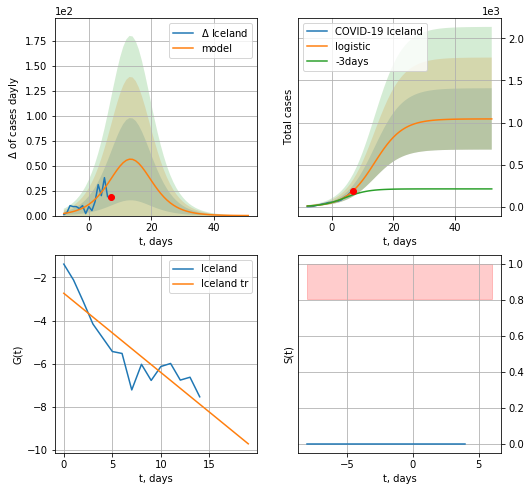

Iceland data at: 2020-11-18
+3 day model MAPE: 0.4751648041928849
model: logistic
coeffs:  [1.04285054e+03 2.17199299e-01 1.38649769e+01]
rational stdev:  0.34947878303574653
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  1042 ± 364
	 total death:  4 ± 4
trend coefficient of determination: 0.782203
 intercept: -2.736046
 slope: -0.366728


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


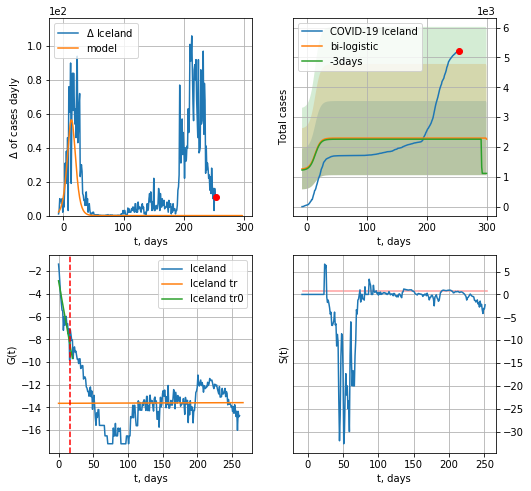

Iceland data at: 2020-11-18
+3 day model MAPE: 0.016220744241450587
model: bi-logistic
coeffs:  [1180.98372922  -11.11063141  299.31592884] [1.04285054e+03 2.17199299e-01 1.38649769e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.5407688239131869
forecast at the end of period: +45 days
	 deltaDaycases:  -34
	 total cases:  2263 ± 1223
	 total death:  10 ± 16
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.774693
 intercept: -2.854940
 slope: -0.341251
trend coefficient of determination: 0.000061
 intercept: -13.634101
 slope: 0.000220


In [766]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


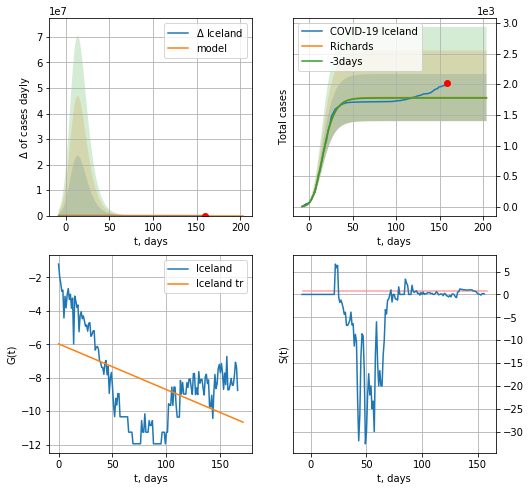

Iceland data at: 2020-11-18
+3 day model MAPE: 0.003798
model: Richards
coeffs: [1.78218704e+03 4.15281218e-01 4.51711528e+00 2.96176572e-01]
rational stdev: 0.215516
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 1782 ± 384
	 total death: 8 ± 5
trend coefficient of determination: 0.246093
 intercept: -5.976231
 slope: -0.027410
diffStd0a 0.5824231548867947


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


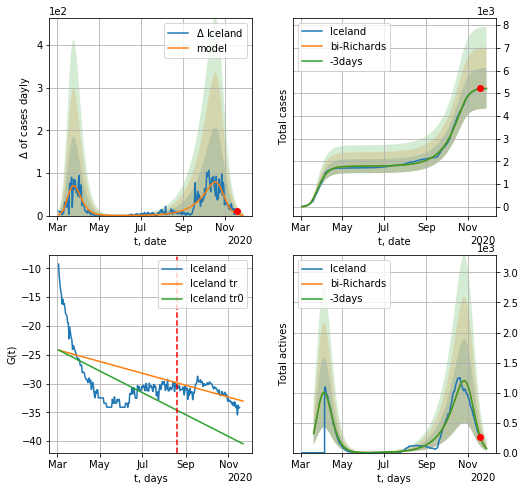

Iceland data at: 2020-11-18
+3 day model MAPE: 0.002711
model: bi-Richards
coeffs: [3.44254922e+03 4.67121919e-02 2.28918754e+02 3.27026571e+00]
rational stdev: 0.172631
forecast at the end of period: +10 days
	 deltaDaycases: 1
	 total cases: 5218 ± 900
	 total death: 24 ± 12
bi-Richards approximation splitting point: 170
actives k: 17
trend coefficient of determination: 0.356811
 intercept: -24.174376
 slope: -0.061668
trend coefficient of determination: 0.401496
 intercept: -24.184334
 slope: -0.033552


In [767]:
vL = 170+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Iceland",dfIC[2:],d1,35*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2,amc=0.5)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

In [768]:
#x = forecastRRR("Iceland",dfIC[5:],d1,T18*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date   cases   active   death
249 2020-11-14  145309  18171.0  2867.0
250 2020-11-15  146653  18410.0  2873.0
251 2020-11-16  147667  18040.0  2881.0
252 2020-11-17  148721  17586.0  2893.0
253 2020-11-18  149833  17171.0  2907.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


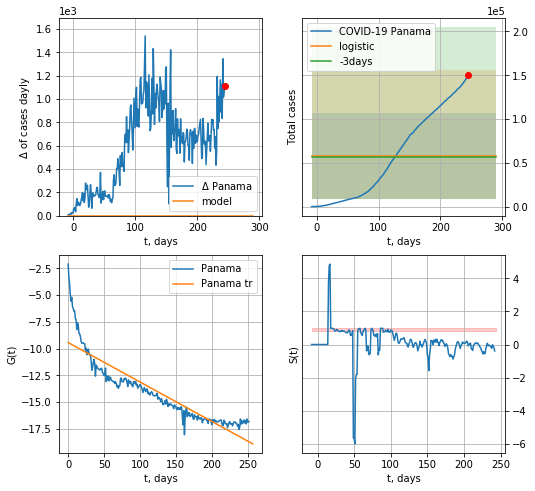

Panama data at: 2020-11-18
+3 day model MAPE: 0.019354012030993503
model: logistic
coeffs:  [ 5.74610669e+04 -4.78643528e+01  1.15528871e+03]
rational stdev:  0.8571700508239558
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  57461 ± 49253
	 total death:  1114 ± 2864
trend coefficient of determination: 0.815004
 intercept: -9.437910
 slope: -0.036859


In [769]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


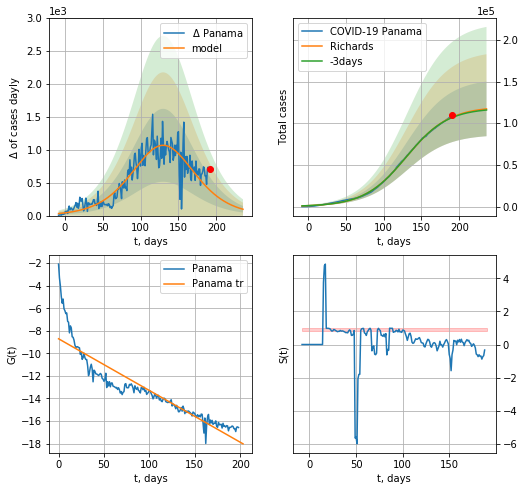

Panama data at: 2020-11-18
+3 day model MAPE: 0.005567
model: Richards
coeffs: [1.19896601e+05 3.57923760e-02 1.30053496e+02 9.93824719e-01]
rational stdev: 0.279661
forecast at the end of period: +45 days
	 deltaDaycases: 96
	 total cases: 117174 ± 32769
	 total death: 2273 ± 1907
trend coefficient of determination: 0.824637
 intercept: -8.707636
 slope: -0.045883
diffStd0a 0.43244126409826716


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


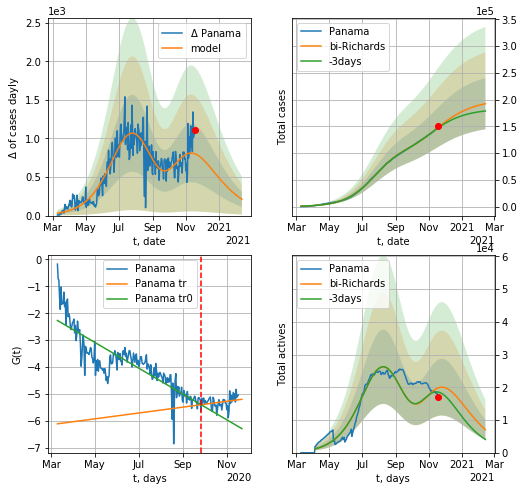

Panama data at: 2020-11-18
+3 day model MAPE: 0.008691
model: bi-Richards
coeffs: [8.13035769e+04 2.19667702e+00 6.22190965e+01 1.12157825e-02]
rational stdev: 0.248890
forecast at the end of period: +87 days
	 deltaDaycases: 211
	 total cases: 192227 ± 47843
	 total death: 3729 ± 2784
bi-Richards approximation splitting point: 200
actives k: 26
trend coefficient of determination: 0.737234
 intercept: -2.268808
 slope: -0.015629
trend coefficient of determination: 0.061902
 intercept: -6.106175
 slope: 0.003541


In [770]:
vL = 200#70
x = forecastRR("Panama",dfPM[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Panama",dfPM[:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.75)

In [771]:
#x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


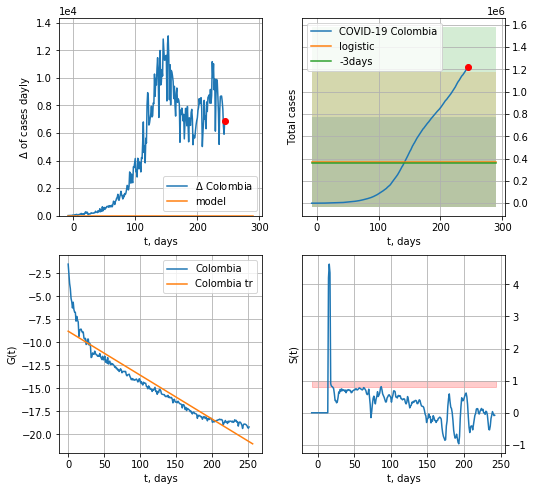

Colombia data at: 2020-11-18
+3 day model MAPE: 0.027699415580246703
model: logistic
coeffs:  [ 3.72174890e+05 -2.71330817e+01  6.50653997e+02]
rational stdev:  1.082298395348878
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  372174 ± 402804
	 total death:  10561 ± 34290
trend coefficient of determination: 0.895286
 intercept: -8.791276
 slope: -0.047584


In [772]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


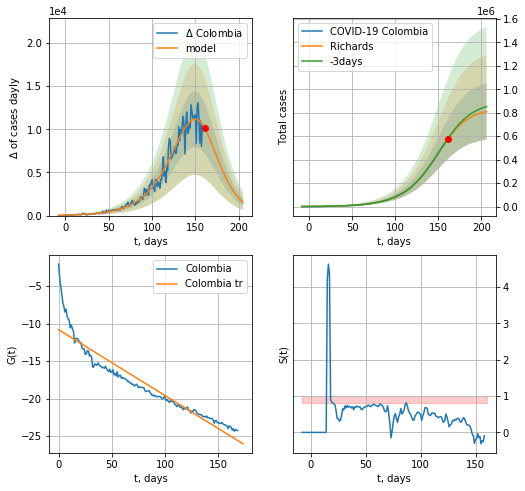

Colombia data at: 2020-11-18
+3 day model MAPE: 0.007195
model: Richards
coeffs: [8.34733445e+05 4.05910499e-02 1.56797482e+02 1.52613261e+00]
rational stdev: 0.296867
forecast at the end of period: +45 days
	 deltaDaycases: 1532
	 total cases: 809755 ± 240389
	 total death: 22978 ± 20464
trend coefficient of determination: 0.889696
 intercept: -10.819712
 slope: -0.087917
diffStd0a 0.5379982601979519


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


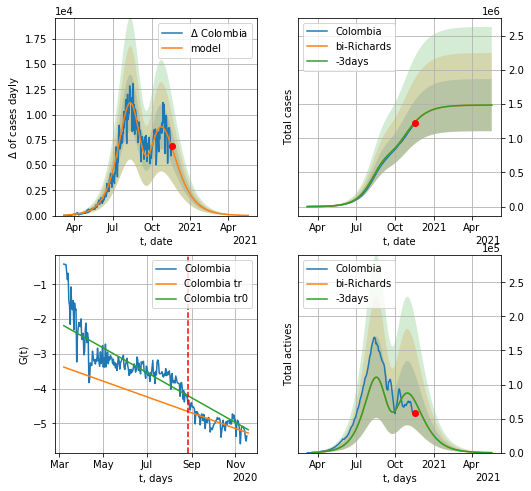

Colombia data at: 2020-11-18
+3 day model MAPE: 0.000180
model: bi-Richards
coeffs: [6.52301378e+05 2.59429516e+00 1.02827693e+02 1.34315982e-02]
rational stdev: 0.256842
forecast at the end of period: +185 days
	 deltaDaycases: 19
	 total cases: 1486491 ± 381794
	 total death: 42181 ± 32501
bi-Richards approximation splitting point: 170
actives k: 11
trend coefficient of determination: 0.636292
 intercept: -2.192083
 slope: -0.011646
trend coefficient of determination: 0.501994
 intercept: -3.383110
 slope: -0.007386


In [773]:
vL = 170#41
x = forecastRR("Colombia",dfCB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Colombia",dfCB[:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.333)

In [774]:
#x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases  active   death
255 2020-11-14  66819.0   20481  2139.0
256 2020-11-15  67679.0   20892  2154.0
257 2020-11-16  68589.0   21273  2168.0
258 2020-11-17  69591.0   22257  2186.0
259 2020-11-18  70629.0   22097  2206.0


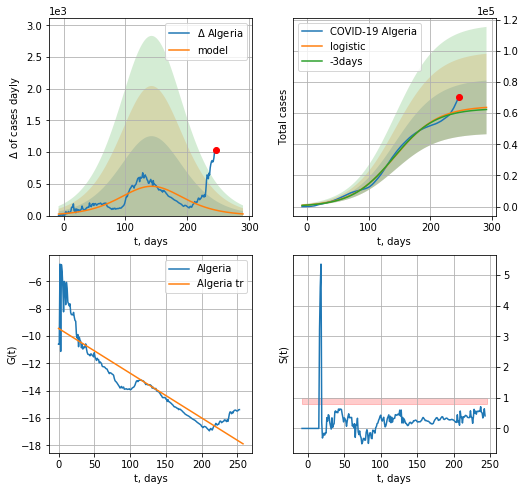

Algeria data at: 2020-11-18
+3 day model MAPE: 0.01677733127724292
model: logistic
coeffs:  [6.45913416e+04 2.86201390e-02 1.42751769e+02]
rational stdev:  0.27045012507457494
forecast at the end of period: +45 days
	 deltaDaycases:  26
	 total cases:  63676 ± 17221
	 total death:  1988 ± 1612
trend coefficient of determination: 0.816895
 intercept: -9.438699
 slope: -0.032758


In [775]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,T18*7-dT)
#dfAG

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


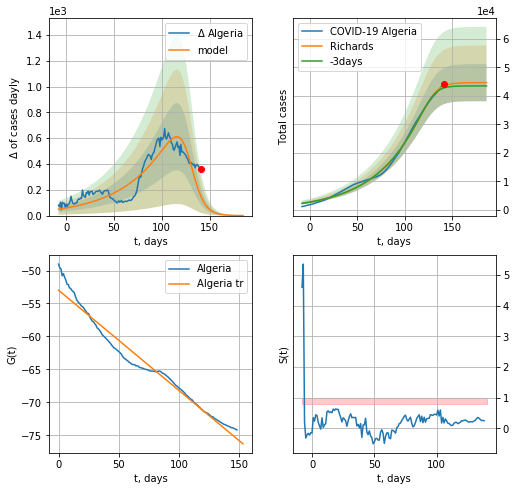

Algeria data at: 2020-11-18
+3 day model MAPE: 0.015957
model: Richards
coeffs: [4.46472187e+04 2.15635914e-02 1.29583000e+02 6.48850976e+00]
rational stdev: 0.145963
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 44644 ± 6516
	 total death: 1394 ± 610
trend coefficient of determination: 0.966080
 intercept: -52.986797
 slope: -0.152377
diffStd0a 0.639841234572252


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


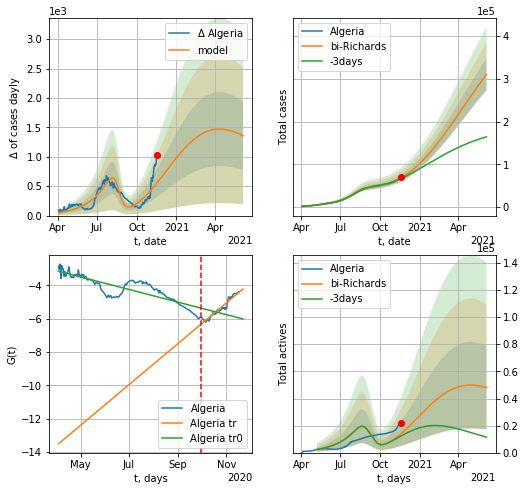

Algeria data at: 2020-11-18
+3 day model MAPE: 0.023754
model: bi-Richards
coeffs: [ 5.06411879e+05  6.11359119e-01 -1.81322425e+02  1.30031030e-02]
rational stdev: 0.118791
forecast at the end of period: +199 days
	 deltaDaycases: 1356
	 total cases: 310918 ± 36934
	 total death: 9711 ± 3460
bi-Richards approximation splitting point: 180
actives k: 35
trend coefficient of determination: 0.705911
 intercept: -3.150610
 slope: -0.012283
trend coefficient of determination: 0.929522
 intercept: -13.507362
 slope: 0.039891


In [776]:
iL = 30
vL = 180+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Algeria",dfAR[iL:],d1,62*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [777]:
#x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date   cases  active    death
250 2020-11-14  467113   59911  15211.0
251 2020-11-15  470648   59909  15296.0
252 2020-11-16  474455   60426  15393.0
253 2020-11-17  478720   60870  15503.0
254 2020-11-18  483518   61306  15600.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


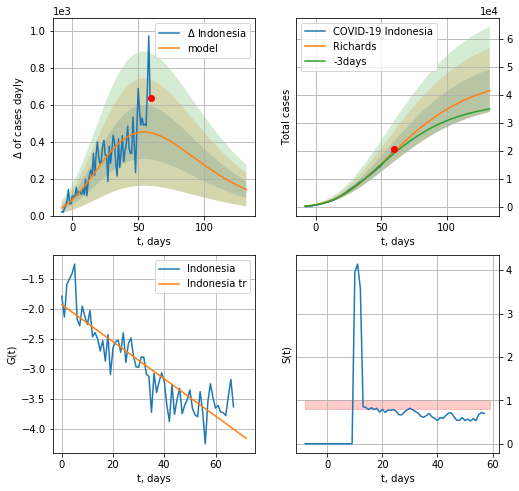

Indonesia data at: 2020-11-18
+3 day model MAPE: 0.038052
model: Richards
coeffs: [ 4.71241400e+04  1.80052285e+00 -1.05975004e+02  1.46057737e-02]
rational stdev: 0.182929
forecast at the end of period: +73 days
	 deltaDaycases: 140
	 total cases: 41480 ± 7588
	 total death: 1338 ± 734
trend coefficient of determination: 0.798542
 intercept: -1.926266
 slope: -0.031064


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


diffStd0a 0.36922065790693476


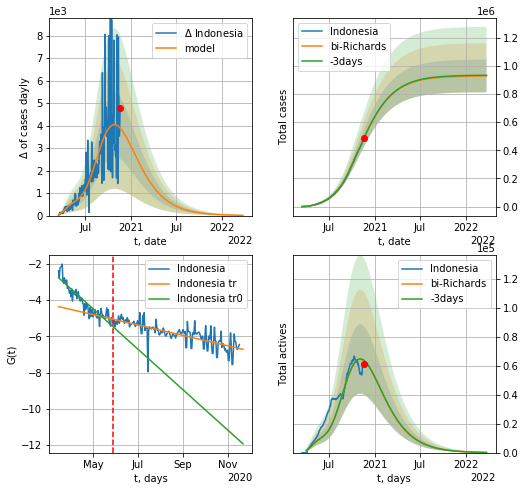

Indonesia data at: 2020-11-18
+3 day model MAPE: 0.000374
model: bi-Richards
coeffs: [8.81200043e+05 9.48177457e-02 6.93834780e+01 1.40188991e-01]
rational stdev: 0.125087
forecast at the end of period: +493 days
	 deltaDaycases: 12
	 total cases: 927397 ± 116005
	 total death: 29921 ± 11228
bi-Richards approximation splitting point: 75
actives k: 17
trend coefficient of determination: 0.838830
 intercept: -2.764061
 slope: -0.036346
trend coefficient of determination: 0.591151
 intercept: -4.359986
 slope: -0.009343


In [778]:
dfIE = read_df(pd.DataFrame(),"IE")
try:
    #x = forecast("Indonesia",dfIE[5:],d1,T18*7-dT)
    vL = 75+6
    x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("Indonesia",dfIE[6:],d12f(1),104*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6,amc=0.5)
except:
    print ("Exception occurs")

In [779]:
#x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

In [780]:
vL=10
vL1=25
try:
    dfPH = read_df(pd.DataFrame(),"PH").fillna(0)
    #x = forecast("Philippines",dfPH[4:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
    #xx = forecast2("Philippines",dfPH[:],d1,T18*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Philippines",dfPH,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])
except:
    print ("Exception occurs")

PH
           date   cases   active   death
252 2020-11-14  407838  25677.0  7832.0
253 2020-11-15  409574  27369.0  7839.0
254 2020-11-16  410718  28313.0  7862.0
255 2020-11-17  412097  29474.0  7957.0
256 2020-11-18  413430  30493.0  7998.0


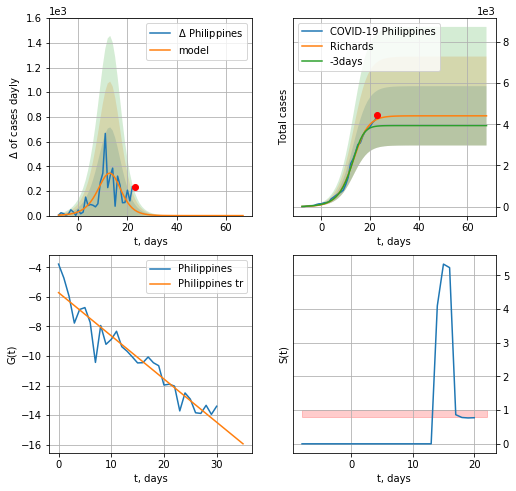

Philippines data at: 2020-11-18
+3 day model MAPE: 0.095041
model: Richards
coeffs: [4.40831989e+03 2.70678377e-01 1.39356489e+01 1.24523177e+00]
rational stdev: 0.326084
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 4408 ± 1437
	 total death: 85 ± 83
trend coefficient of determination: 0.911495
 intercept: -5.712821
 slope: -0.292234
diffStd0a 0.8119006450563877


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


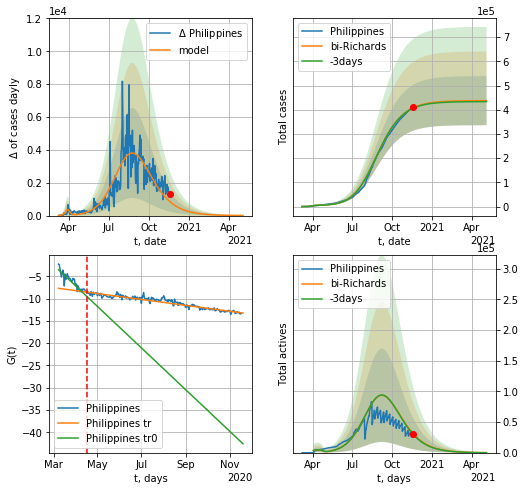

Philippines data at: 2020-11-18
+3 day model MAPE: 0.004439
model: bi-Richards
coeffs: [4.33485110e+05 5.21040077e-02 1.43908945e+02 5.88201568e-01]
rational stdev: 0.231912
forecast at the end of period: +171 days
	 deltaDaycases: 5
	 total cases: 437711 ± 101510
	 total death: 8467 ± 5890
bi-Richards approximation splitting point: 36
actives k: 26
trend coefficient of determination: 0.818938
 intercept: -3.534104
 slope: -0.152599
trend coefficient of determination: 0.916437
 intercept: -7.703205
 slope: -0.021687


In [781]:
vL = 36 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Philippines",dfPH[4:],d12f(1),58*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4,amc=0.75)

In [782]:
#x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

In [783]:
dfGC = read_df(pd.DataFrame(),"GC")
#x = forecast("Greece",dfGC[:10],d1,T18*7-dT)
#xx = forecast2("Greece",dfGC[:],d1,T18*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

GC
           date    cases  active   death
259 2020-11-14  72510.0   61486  1035.0
260 2020-11-15  74205.0   63110  1106.0
261 2020-11-16  76403.0   65249  1165.0
262 2020-11-17  78825.0   67608  1228.0
263 2020-11-18  82034.0   70757  1288.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


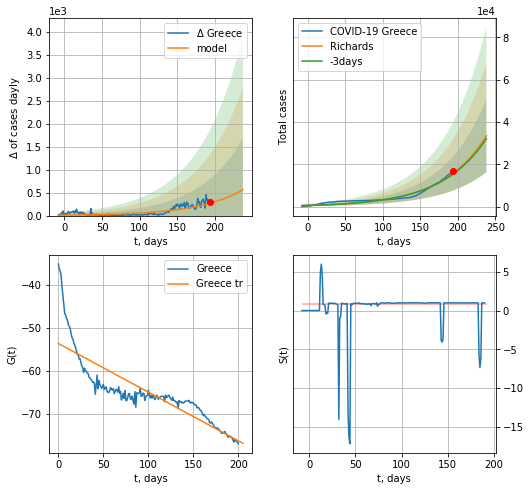

Greece data at: 2020-11-18
+3 day model MAPE: 0.022680
model: Richards
coeffs: [1.22839764e+05 1.69681107e-02 3.14569453e+02 7.48237291e+00]
rational stdev: 0.511475
forecast at the end of period: +45 days
	 deltaDaycases: 563
	 total cases: 33502 ± 17135
	 total death: 526 ± 807
trend coefficient of determination: 0.729021
 intercept: -53.624106
 slope: -0.113112
diffStd0a 0.39731929913686326


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


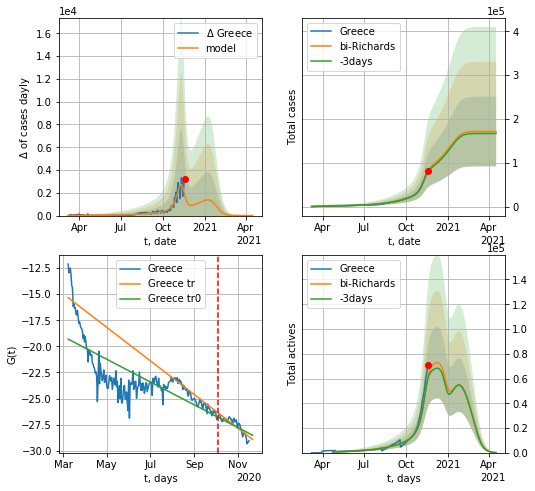

Greece data at: 2020-11-18
+3 day model MAPE: 0.022262
model: bi-Richards
coeffs: [4.86236965e+04 1.07836420e-01 2.43116418e+02 2.27813030e+00]
rational stdev: 0.463682
forecast at the end of period: +150 days
	 deltaDaycases: 0
	 total cases: 171462 ± 79504
	 total death: 2692 ± 3744
bi-Richards approximation splitting point: 210
actives k: 46
trend coefficient of determination: 0.562309
 intercept: -19.308423
 slope: -0.035526
trend coefficient of determination: 0.764340
 intercept: -15.344817
 slope: -0.052356


In [784]:
iL = 8
vL = 210+iL
x = forecastRR("Greece",dfGC[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Greece",dfGC[iL:],d1,55*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=1.33)

In [785]:
#x = forecastRRR("Greece",dfGC[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

In [786]:
dfHG = read_df(pd.DataFrame(),"HG").fillna(0)
#try:
#    x = forecast("Hungary",dfHG[:],d1,T18*7-dT,addpred=True,xcoef=[.35,.5,4,1])
#except:
#    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

HG
           date     cases  active   death
253 2020-11-14  140961.0  106265  3097.0
254 2020-11-15  147456.0  110256  3190.0
255 2020-11-16  152659.0  115193  3281.0
256 2020-11-17  156949.0  118723  3380.0
257 2020-11-18  161461.0  121644  3472.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


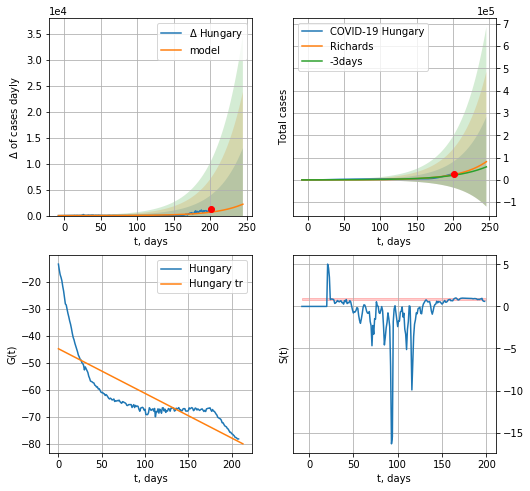

Hungary data at: 2020-11-18
+3 day model MAPE: 0.145721
model: Richards
coeffs: [1.69960015e+05 2.73419286e-02 2.72689391e+02 7.30777798e+00]
rational stdev: 2.462186
forecast at the end of period: +45 days
	 deltaDaycases: 2198
	 total cases: 81872 ± 201585
	 total death: 1760 ± 13000
trend coefficient of determination: 0.621950
 intercept: -44.694459
 slope: -0.165218
diffStd0a 2.943146398128933


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


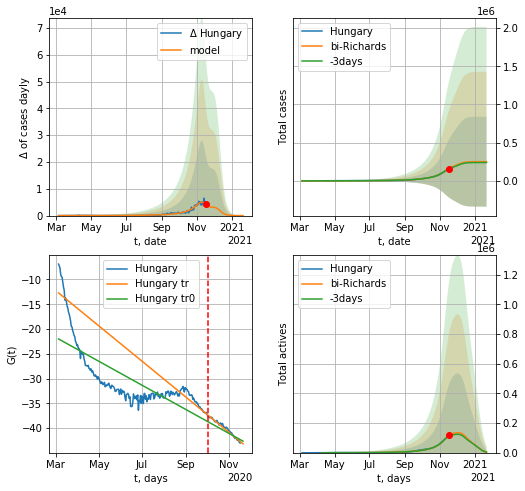

Hungary data at: 2020-11-18
+3 day model MAPE: 0.033914
model: bi-Richards
coeffs: [8.10274940e+04 7.69115455e-02 2.45996914e+02 3.28825767e+00]
rational stdev: 2.343938
forecast at the end of period: +66 days
	 deltaDaycases: 1
	 total cases: 250982 ± 588287
	 total death: 5397 ± 37950
bi-Richards approximation splitting point: 210
actives k: 35
trend coefficient of determination: 0.585031
 intercept: -22.013280
 slope: -0.079064
trend coefficient of determination: 0.971811
 intercept: -12.719090
 slope: -0.116729


In [787]:
vL = 210#130
x = forecastRR("Hungary",dfHG[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Hungary",dfHG[:],d1,43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [788]:
#x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


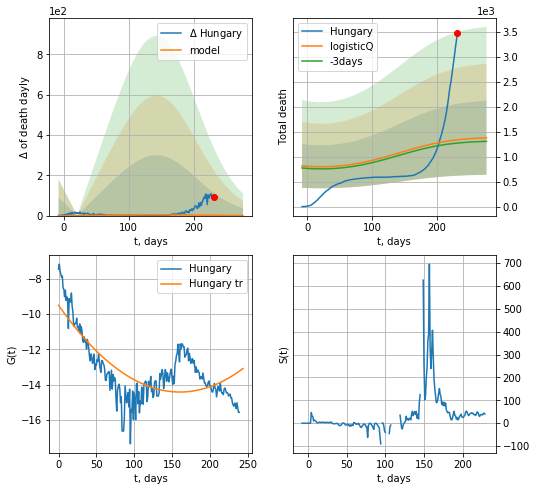

Hungary data at: 2020-11-18
+3 day model MAPE: 0.050835
model: logisticQ
coeffs: [1.18548382e+03 6.90461263e-05 2.75933999e+01 1.19225814e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.534231
forecast at the end of period: +45 days
	 total death: 1384 ± 739
trend coefficient of determination: 0.542690
 intercept_: -9.509389491950746
 coeffs_: [ 0.         -0.06118591  0.00019063]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: divide by zero encountered in true_divide


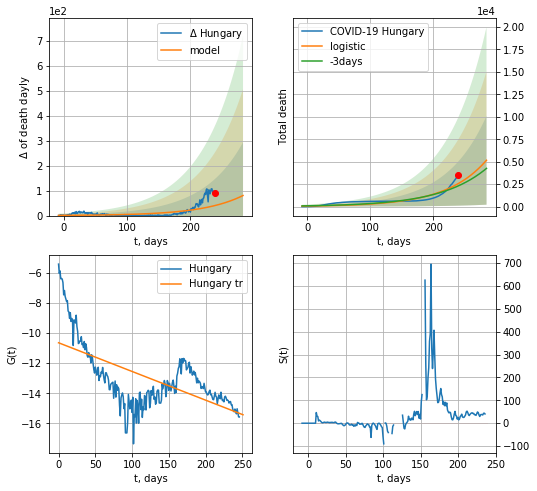

Hungary data at: 2020-11-18
+3 day model MAPE: 0.11265265615699417
model: logistic
coeffs:  [2.29318064e+07 1.56787574e-02 8.19633257e+02]
rational stdev:  0.9582037433018394
forecast at the end of period: +45 days
	 total death:  5165 ± 4949
trend coefficient of determination: 0.395411
 intercept: -10.644379
 slope: -0.019031


In [789]:
x = forecastRRR("Hungary",dfHG[17:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,T18*7-dT,cases='death')

In [790]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    #x = forecast("Malta",dfMT[:15],d1,7*T18-dT,pMAPE=False)
    #xx = forecast2("Malta",dfMT[:],d1,7*T18-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

MT
           date   cases  active  death
251 2020-11-14  7917.0    2120   95.0
252 2020-11-15  8034.0    2172   97.0
253 2020-11-16  8137.0    2151   98.0
254 2020-11-17  8247.0    2097  101.0
255 2020-11-18  8420.0    2133  103.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


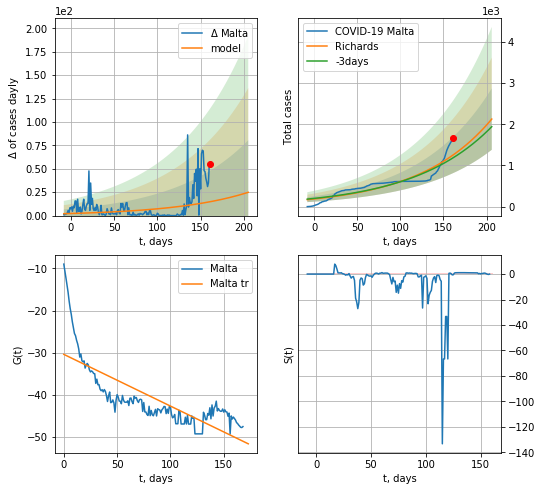

Malta data at: 2020-11-18
+3 day model MAPE: 0.058506
model: Richards
coeffs: [1.79480999e+04 1.17638464e-02 3.87365718e+02 5.94374794e+00]
rational stdev: 0.350416
forecast at the end of period: +45 days
	 deltaDaycases: 24
	 total cases: 2125 ± 744
	 total death: 25 ± 26
trend coefficient of determination: 0.590889
 intercept: -30.386213
 slope: -0.122562
diffStd0a 1.7341301993280278


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


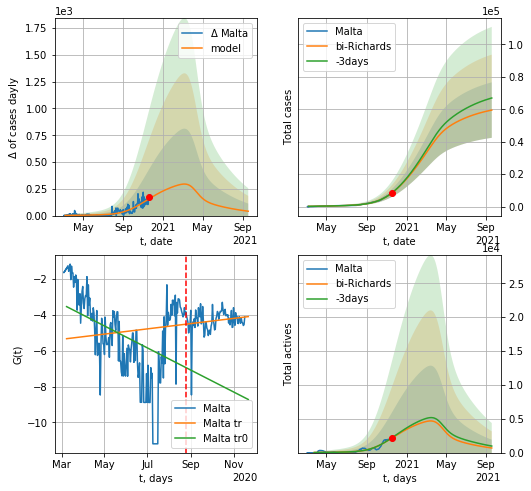

Malta data at: 2020-11-18
+3 day model MAPE: 0.007721
model: bi-Richards
coeffs: [ 4.56218160e+04  4.23132440e-01 -2.85456892e+01  2.47480368e-02]
rational stdev: 0.287209
forecast at the end of period: +304 days
	 deltaDaycases: 40
	 total cases: 59502 ± 17089
	 total death: 727 ± 626
bi-Richards approximation splitting point: 170
actives k: 17
trend coefficient of determination: 0.173545
 intercept: -3.538719
 slope: -0.019994
trend coefficient of determination: 0.035047
 intercept: -5.328077
 slope: 0.004756


In [791]:
vL = 170#112
x = forecastRR("Malta",dfMT[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Malta",dfMT[:],d12f(1),77*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)

In [792]:
#x = forecastRRR("Malta",dfMT[:30],d1,T18*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
#xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

In [793]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
#try:
#    x = forecast("Slovakia",dfSL[:10],d1,T18*7-dT,pMAPE=False)
#    xx = forecast2("Slovakia",dfSL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
#except:
#    print("Exception ocurs")

SL
           date    cases   active  death
249 2020-11-14  86767.0  55738.0  510.0
250 2020-11-15  87276.0  55697.0  526.0
251 2020-11-16  88602.0  54139.0  557.0
252 2020-11-17  89913.0  53410.0  579.0
253 2020-11-18  89913.0  53410.0  579.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


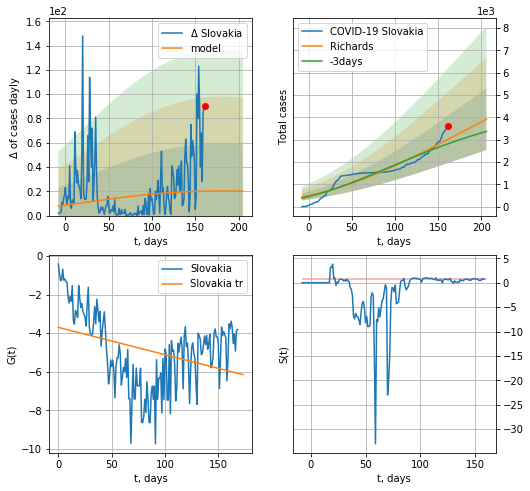

Slovakia data at: 2020-11-18
+3 day model MAPE: 0.071099
model: Richards
coeffs: [ 9.22154238e+03  4.41676744e-01 -5.31921240e+02  1.36332717e-02]
rational stdev: 0.352489
forecast at the end of period: +45 days
	 deltaDaycases: 20
	 total cases: 3912 ± 1379
	 total death: 25 ± 26
trend coefficient of determination: 0.127387
 intercept: -3.700946
 slope: -0.014153
diffStd0a 0.7056446152849837


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


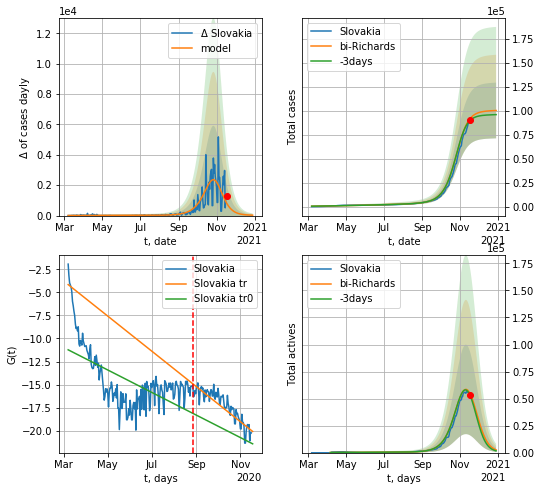

Slovakia data at: 2020-11-17
+3 day model MAPE: 0.018052
model: bi-Richards
coeffs: [9.48580670e+04 7.90416709e-02 2.28503708e+02 1.40285768e+00]
rational stdev: 0.289856
forecast at the end of period: +45 days
	 deltaDaycases: 26
	 total cases: 100251 ± 29058
	 total death: 645 ± 560
bi-Richards approximation splitting point: 170
actives k: 30
trend coefficient of determination: 0.362127
 intercept: -11.228887
 slope: -0.039776
trend coefficient of determination: 0.787340
 intercept: -4.165134
 slope: -0.062127


In [795]:
vL = 170
x = forecastRR("Slovakia",dfSL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Slovakia",dfSL[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.875)

In [390]:
#x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

In [796]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
#try:
#    x = forecast("Slovenia",dfSV[:10],d1,7*T18-dT,pMAPE=False)
#    xx = forecast2("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
#except:
#    print ("Exception occurs")

SV
           date    cases   active  death
254 2020-11-14  54122.0  19809.0  765.0
255 2020-11-15  55042.0  19381.0  797.0
256 2020-11-16  55544.0  19326.0  831.0
257 2020-11-17  56937.0  19542.0  876.0
258 2020-11-18  58964.0  19538.0  919.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


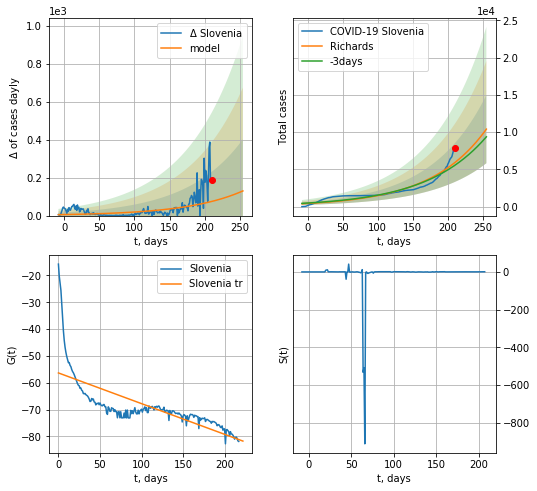

Slovenia data at: 2020-11-18
+3 day model MAPE: 0.066613
model: Richards
coeffs: [6.19400354e+04 1.25703185e-02 3.96986872e+02 8.71056283e+00]
rational stdev: 0.439769
forecast at the end of period: +45 days
	 deltaDaycases: 129
	 total cases: 10395 ± 4571
	 total death: 162 ± 213
trend coefficient of determination: 0.532544
 intercept: -56.360415
 slope: -0.114437
diffStd0a 2.8676718534611285


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


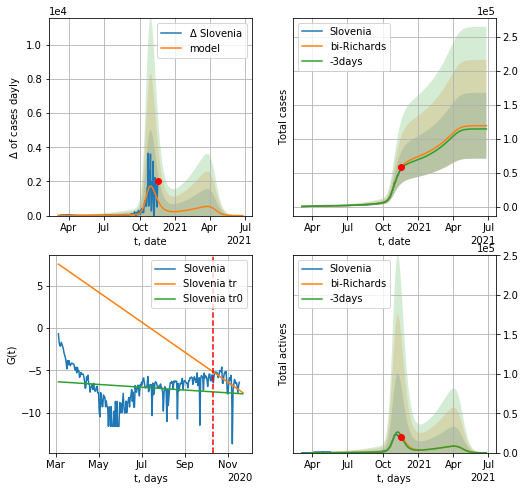

Slovenia data at: 2020-11-18
+3 day model MAPE: 0.025918
model: bi-Richards
coeffs: [5.72008975e+04 3.18708590e-01 2.16258873e+02 2.75829859e-01]
rational stdev: 0.407138
forecast at the end of period: +220 days
	 deltaDaycases: 0
	 total cases: 119138 ± 48505
	 total death: 1856 ± 2266
bi-Richards approximation splitting point: 219
actives k: 17
trend coefficient of determination: 0.027613
 intercept: -6.351088
 slope: -0.005407
trend coefficient of determination: 0.200584
 intercept: 7.551151
 slope: -0.057951


In [797]:
vL = 219
x = forecastRR("Slovenia",dfSV[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Slovenia",dfSV[:],d12f(1),65*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)

In [798]:
#print(koreaCoeffs)
#x = forecastRRR("Slovenia",dfSV[:10],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases   active   death
249 2020-11-14  81086  48561.0   989.0
250 2020-11-15  84568  52023.0  1009.0
251 2020-11-16  87381  54815.0  1030.0
252 2020-11-17  92375  59785.0  1054.0
253 2020-11-18  97988  65371.0  1081.0


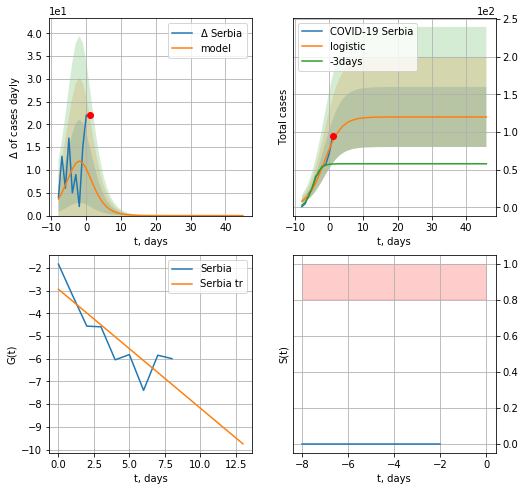

Serbia data at: 2020-11-18
model: logistic
coeffs:  [119.86808879   0.40041875  -1.48148474]
rational stdev:  0.33210329199703215
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  119 ± 39
	 total death:  1 ± 0
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


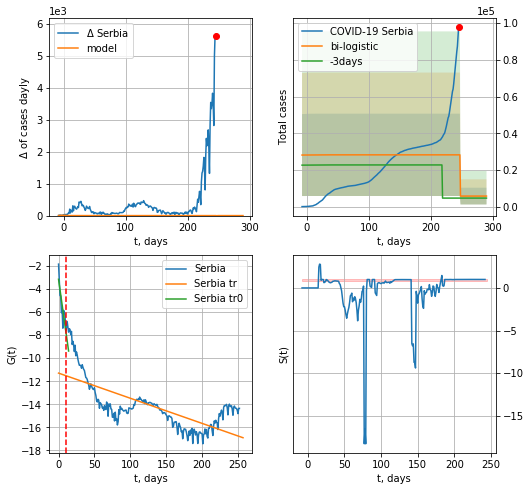

Serbia data at: 2020-11-18
+3 day model MAPE: 5.0830052455831565
model: bi-logistic
coeffs:  [22486.12282562   -59.45221589   247.52228997] [119.86808879   0.40041875  -1.48148474]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.7948184963196763
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  5741 ± 4563
	 total death:  63 ± 150
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.507882
 intercept: -11.294570
 slope: -0.021825


In [799]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,T18*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


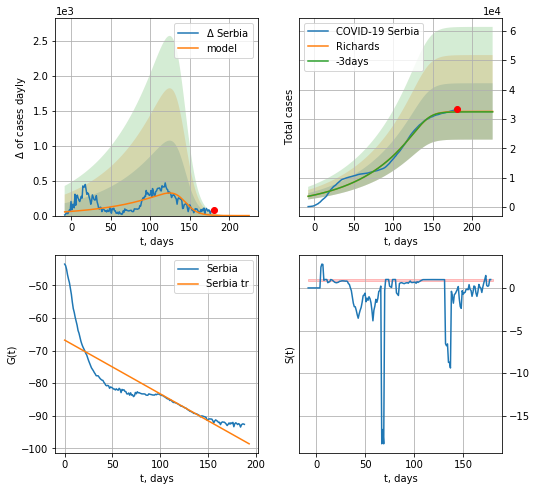

Serbia data at: 2020-11-18
+3 day model MAPE: 0.004519
model: Richards
coeffs: [3.25426107e+04 1.45493984e-02 1.42626705e+02 8.31390497e+00]
rational stdev: 0.294904
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 32542 ± 9596
	 total death: 359 ± 317
trend coefficient of determination: 0.722028
 intercept: -66.812798
 slope: -0.164829
diffStd0a 0.7563151319965993


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


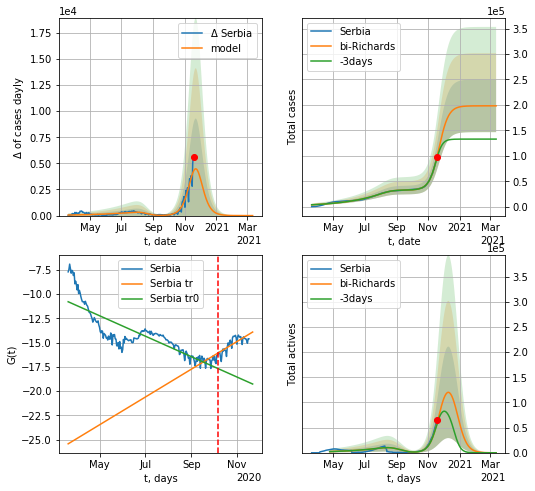

Serbia data at: 2020-11-18
+3 day model MAPE: 0.029424
model: bi-Richards
coeffs: [1.65569773e+05 1.06659780e-01 2.39471164e+02 1.02236186e+00]
rational stdev: 0.260896
forecast at the end of period: +115 days
	 deltaDaycases: 0
	 total cases: 198111 ± 51686
	 total death: 2185 ± 1710
bi-Richards approximation splitting point: 200
actives k: 35
trend coefficient of determination: 0.716576
 intercept: -10.797896
 slope: -0.034266
trend coefficient of determination: 0.616227
 intercept: -25.414205
 slope: 0.046559


In [800]:
iL=10
vL=200+iL
x = forecastRR("Serbia",dfSB[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Serbia",dfSB[iL:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [801]:
#x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

In [802]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    #x = forecast("Croatia",dfCT[:10],d1,T18*7-dT,pMAPE=False)
    #xx = forecast2("Croatia",dfCT[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

CT
           date    cases   active   death
259 2020-11-14  81844.0  17090.0  1006.0
260 2020-11-15  84206.0  16926.0  1049.0
261 2020-11-16  85519.0  15699.0  1082.0
262 2020-11-17  87464.0  15371.0  1113.0
263 2020-11-18  90715.0  16891.0  1151.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


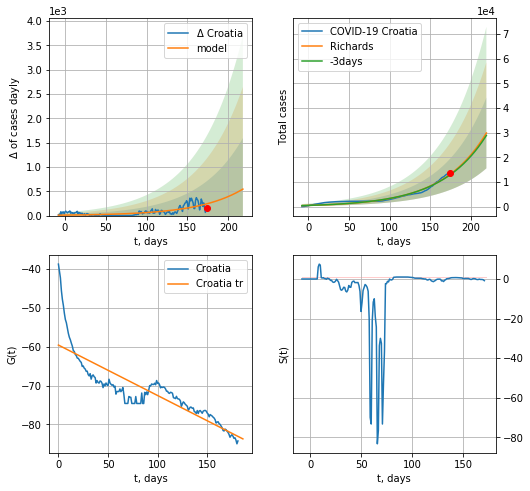

Croatia data at: 2020-11-18
+3 day model MAPE: 0.018027
model: Richards
coeffs: [1.05375743e+05 1.83779062e-02 2.87513636e+02 8.37165434e+00]
rational stdev: 0.479243
forecast at the end of period: +45 days
	 deltaDaycases: 544
	 total cases: 29915 ± 14337
	 total death: 379 ± 544
trend coefficient of determination: 0.727056
 intercept: -59.566484
 slope: -0.130027
diffStd0a 2.393156047534119


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


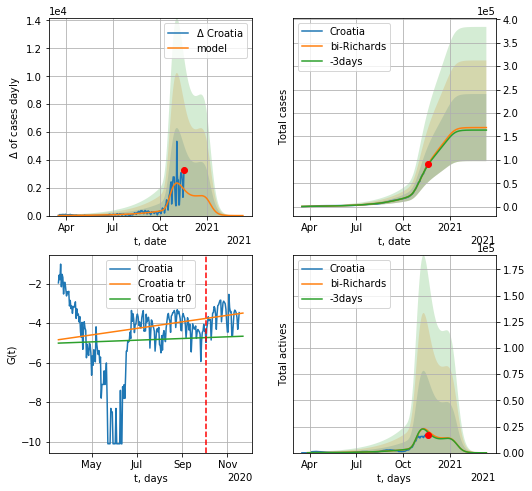

Croatia data at: 2020-11-18
+3 day model MAPE: 0.017156
model: bi-Richards
coeffs: [6.34949428e+04 6.16708523e+00 1.63931472e+02 1.22097666e-02]
rational stdev: 0.424396
forecast at the end of period: +115 days
	 deltaDaycases: 0
	 total cases: 168866 ± 71666
	 total death: 2142 ± 2727
bi-Richards approximation splitting point: 200
actives k: 11
trend coefficient of determination: 0.001621
 intercept: -5.013733
 slope: 0.001397
trend coefficient of determination: 0.015384
 intercept: -4.841357
 slope: 0.005399


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power


In [803]:
iL = 17
vL = 200+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Croatia",dfCT[iL:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.33)

In [804]:
#x = forecastRRR("Croatia",dfCT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

In [805]:
dfEG = read_df(pd.DataFrame(),"EG")
#x = forecast("Egypt",dfEG[:8],d1,7*T18-dT)
#xx = forecast2("Egypt",dfEG[:],d1,30*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

EG
           date   cases  active   death
253 2020-11-14  110547    3159  6442.0
254 2020-11-15  110767    3268  6453.0
255 2020-11-16  111009    3365  6465.0
256 2020-11-17  111284    3515  6481.0
257 2020-11-18  111613    3697  6495.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


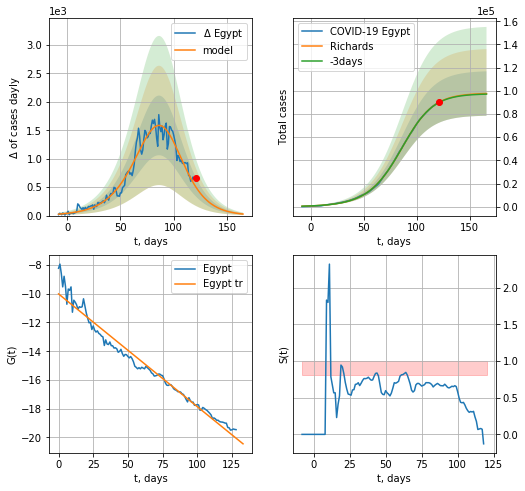

Egypt data at: 2020-11-18
+3 day model MAPE: 0.002349
model: Richards
coeffs: [9.80452652e+04 5.49784423e-02 9.01515288e+01 1.27472002e+00]
rational stdev: 0.196169
forecast at the end of period: +45 days
	 deltaDaycases: 27
	 total cases: 97668 ± 19159
	 total death: 5683 ± 3344
trend coefficient of determination: 0.969341
 intercept: -10.012670
 slope: -0.078415
diffStd0a 0.4838940041138771


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


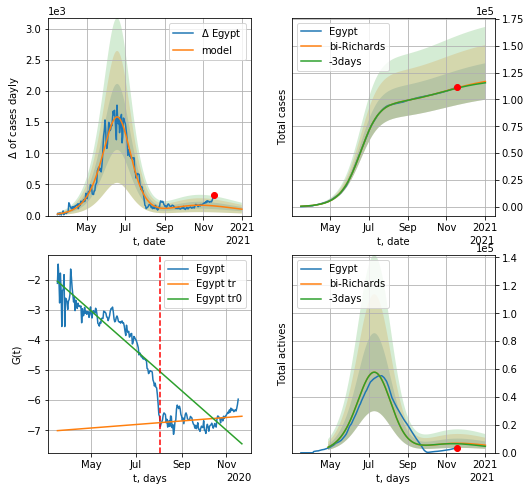

Egypt data at: 2020-11-18
+3 day model MAPE: 0.002980
model: bi-Richards
coeffs: [ 2.53775411e+04  1.49480400e+00 -2.91246551e+01  1.19740913e-02]
rational stdev: 0.145296
forecast at the end of period: +45 days
	 deltaDaycases: 103
	 total cases: 116717 ± 16958
	 total death: 6792 ± 2960
bi-Richards approximation splitting point: 140
actives k: 43
trend coefficient of determination: 0.798915
 intercept: -2.053629
 slope: -0.021492
trend coefficient of determination: 0.058799
 intercept: -7.010909
 slope: 0.001902


In [806]:
iL = 10
vL = 140+iL
x = forecastRR("Egypt",dfEG[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Egypt",dfEG[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=1.25)

In [807]:
#x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date   cases   active    death
256 2020-11-14  516915  61066.0  11623.0
257 2020-11-15  519152  60443.0  11670.0
258 2020-11-16  521542  60265.0  11712.0
259 2020-11-17  524503  59726.0  11752.0
260 2020-11-18  526852  59881.0  11795.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


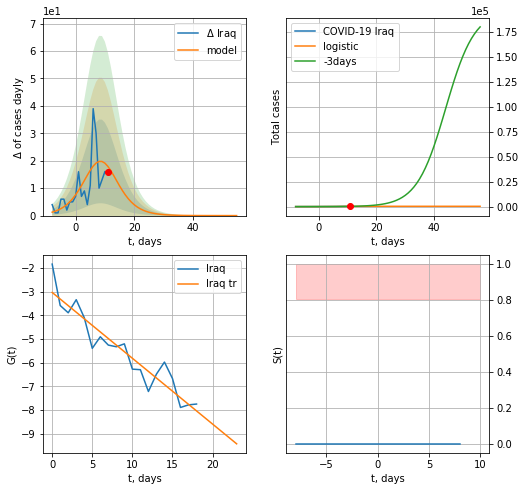

Iraq data at: 2020-11-18
+3 day model MAPE: 0.34474037669474106
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  317 ± 65
	 total death:  7 ± 4
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


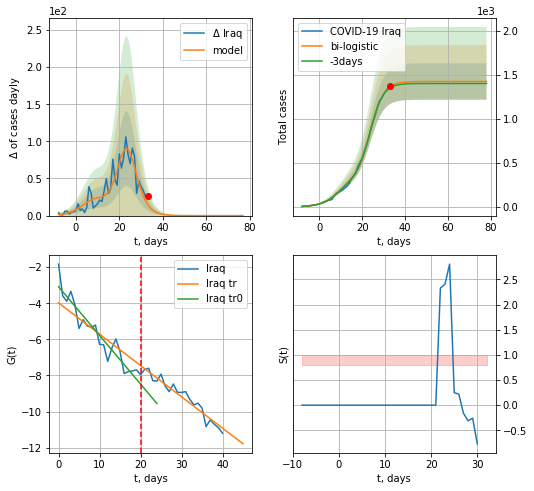

Iraq data at: 2020-11-18
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  31 ± 13
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:354: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


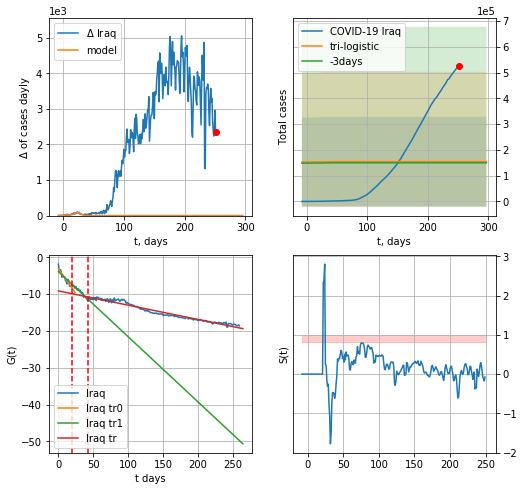

Iraq data at: 2020-11-18
+3 day model MAPE: 0.028698765555694634
model: tri-logistic
coeffs:  [ 1.52814271e+05 -1.39993011e+01  3.40720602e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  1.1297727832859736
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  154240 ± 174256
	 total death:  3453 ± 11703
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.959362
 intercept: -9.115617
 slope: -0.038819


In [808]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,T18*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


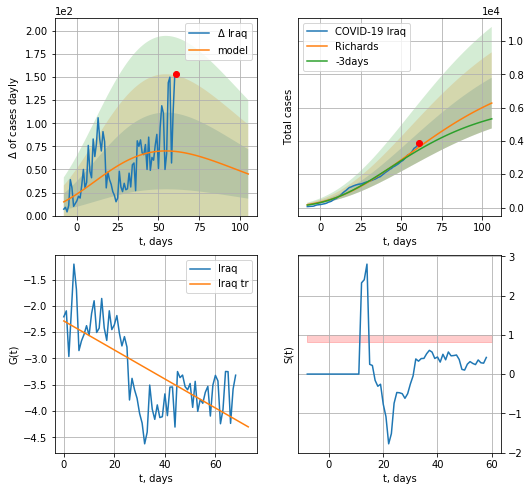

Iraq data at: 2020-11-18
+3 day model MAPE: 0.049876
model: Richards
coeffs: [ 8.66913850e+03  2.11659471e+00 -1.51652885e+02  1.04324891e-02]
rational stdev: 0.242987
forecast at the end of period: +45 days
	 deltaDaycases: 45
	 total cases: 6272 ± 1524
	 total death: 140 ± 102
trend coefficient of determination: 0.498225
 intercept: -2.287589
 slope: -0.027573
diffStd0a 0.2745141822282052


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


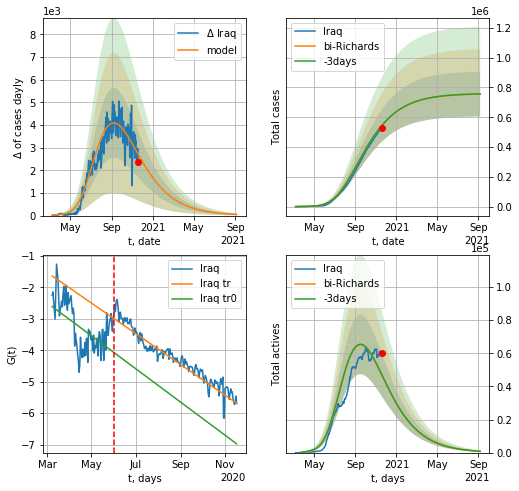

Iraq data at: 2020-11-18
+3 day model MAPE: 0.000618
model: bi-Richards
coeffs: [ 7.50429582e+05  7.07816585e-01 -8.31735363e+01  2.11082246e-02]
rational stdev: 0.198746
forecast at the end of period: +297 days
	 deltaDaycases: 48
	 total cases: 755841 ± 150220
	 total death: 16921 ± 10088
bi-Richards approximation splitting point: 80
actives k: 17
trend coefficient of determination: 0.286459
 intercept: -2.608731
 slope: -0.017185
trend coefficient of determination: 0.933220
 intercept: -1.634675
 slope: -0.015929


In [809]:
iL = 10
vL=80+iL#25+10
x = forecastRR("Iraq",dfIQ[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Iraq",dfIQ[iL:],d1,76*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)

In [810]:
#x = forecastRRR("Iraq",dfIQ[9:42],d1,T18*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
#xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [811]:
#len(dfAR)

AR
           date    cases  active   death
255 2020-11-14  66819.0   20481  2139.0
256 2020-11-15  67679.0   20892  2154.0
257 2020-11-16  68589.0   21273  2168.0
258 2020-11-17  69591.0   22257  2186.0
259 2020-11-18  70629.0   22097  2206.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


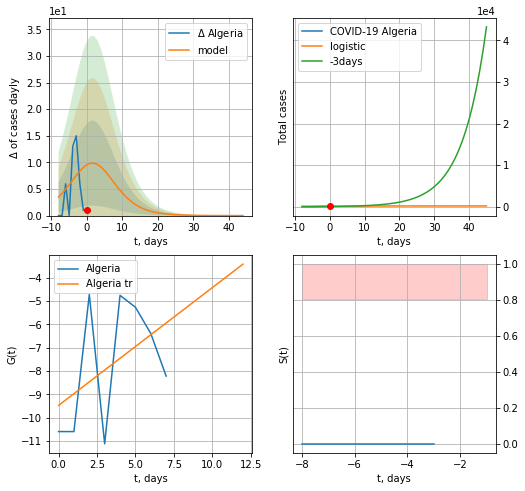

Algeria data at: 2020-11-18
+3 day model MAPE: 0.16392519582549905
model: logistic
coeffs:  [169.67149558   0.23328995   2.04236169]
rational stdev:  0.1546785167835457
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  169 ± 26
	 total death:  5 ± 2
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


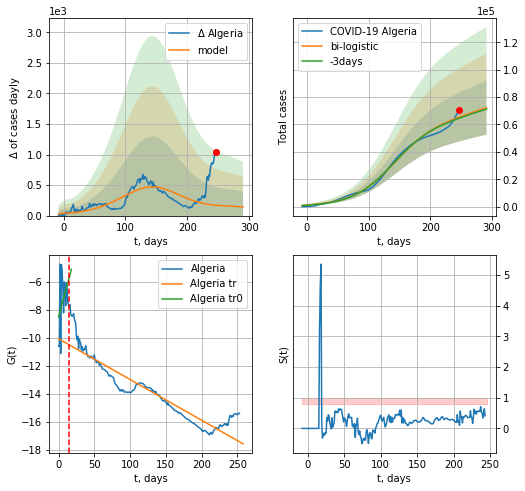

Algeria data at: 2020-11-18
+3 day model MAPE: 0.01296794207318775
model: bi-logistic
coeffs:  [6.42564240e+04 2.88966431e-02 1.42760663e+02] [169.67149558   0.23328995   2.04236169]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2722087973323359
forecast at the end of period: +45 days
	 deltaDaycases:  140
	 total cases:  72218 ± 19658
	 total death:  2255 ± 1841
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.855064
 intercept: -10.063352
 slope: -0.029121


In [812]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*T18-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*T18-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


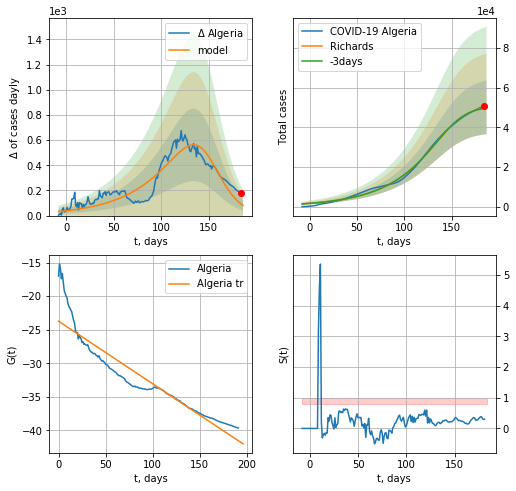

Algeria data at: 2020-11-18
+3 day model MAPE: 0.005813
model: Richards
coeffs: [5.12320244e+04 2.27589775e-02 1.50468918e+02 3.13865465e+00]
rational stdev: 0.269869
forecast at the end of period: +3 days
	 deltaDaycases: 80
	 total cases: 50086 ± 13516
	 total death: 1564 ± 1266
trend coefficient of determination: 0.872474
 intercept: -23.731544
 slope: -0.093154
diffStd0a 0.6984992926329872


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


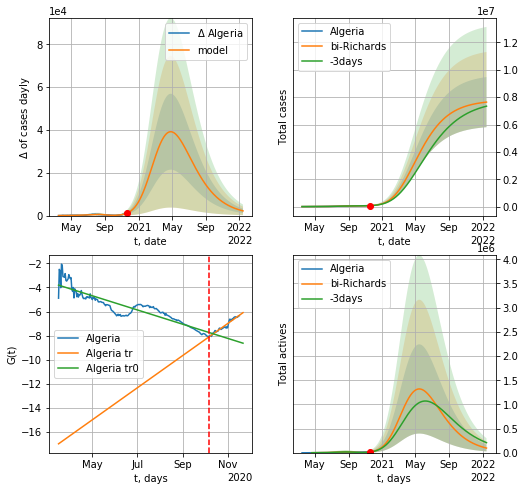

Algeria data at: 2020-11-18
+3 day model MAPE: 0.006119
model: bi-Richards
coeffs: [7.73517289e+06 7.93799406e-02 2.88876356e+02 1.89682213e-01]
rational stdev: 0.239902
forecast at the end of period: +423 days
	 deltaDaycases: 2195
	 total cases: 7639985 ± 1832846
	 total death: 238624 ± 171739
bi-Richards approximation splitting point: 205
actives k: 35
trend coefficient of determination: 0.824023
 intercept: -3.807086
 slope: -0.019180
trend coefficient of determination: 0.948995
 intercept: -16.965747
 slope: 0.043332


In [813]:
vL =205+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Algeria",dfAR[12:],d1,94*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

In [814]:
#x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
247 2020-11-14  7051.0  4991.0   39.0
248 2020-11-15  7178.0  5118.0   39.0
249 2020-11-16  7285.0  5224.0   40.0
250 2020-11-17  7513.0  5452.0   40.0
251 2020-11-18  7711.0  5649.0   41.0


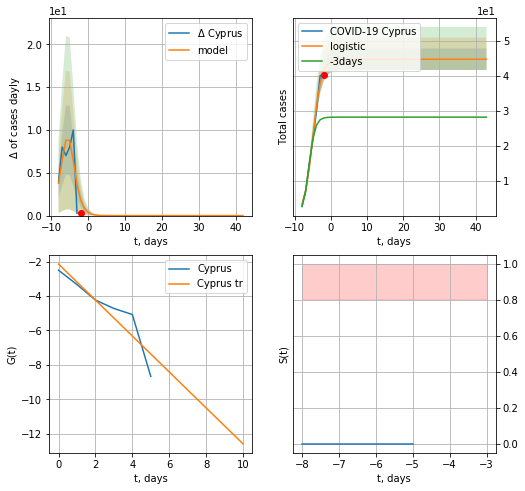

Cyprus data at: 2020-11-18
+3 day model MAPE: 0.5347775670777937
model: logistic
coeffs:  [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.06852146203610965
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  44 ± 3
	 total death:  0 ± 0
trend coefficient of determination: 0.837222
 intercept: -2.149855
 slope: -1.042802


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


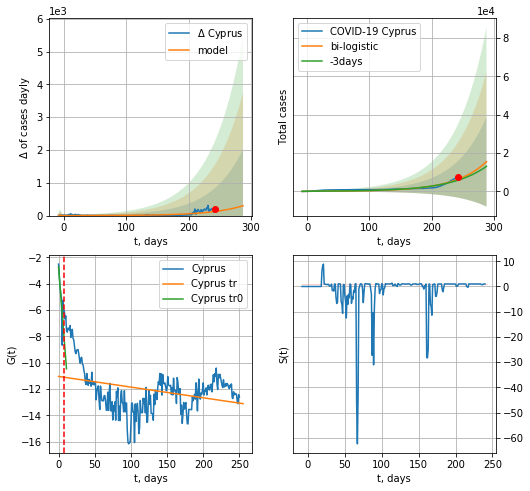

Cyprus data at: 2020-11-18
+3 day model MAPE: 0.08583057421223109
model: bi-logistic
coeffs:  [6.59658107e+07 1.96485423e-02 7.13363077e+02] [44.71273924  0.83168064 -5.024159  ]
rational stdev:  1.5081466858365422
forecast at the end of period: +45 days
	 deltaDaycases:  300
	 total cases:  15514 ± 23398
	 total death:  82 ± 371
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.605369
 intercept: -2.714226
 slope: -0.704180
trend coefficient of determination: 0.103202
 intercept: -11.038134
 slope: -0.008118


In [815]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*T18-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


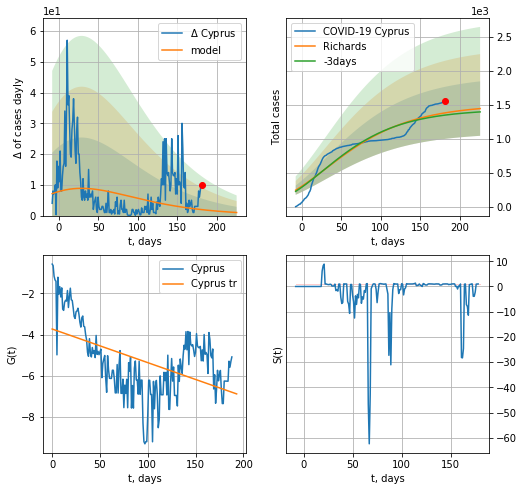

Cyprus data at: 2020-11-18
+3 day model MAPE: 0.024435
model: Richards
coeffs: [ 1.50521752e+03  2.72486761e+00 -2.90172794e+02  5.89172949e-03]
rational stdev: 0.277159
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 1442 ± 399
	 total death: 7 ± 5
trend coefficient of determination: 0.254348
 intercept: -3.732430
 slope: -0.016375
diffStd0a 0.8494080639714697


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


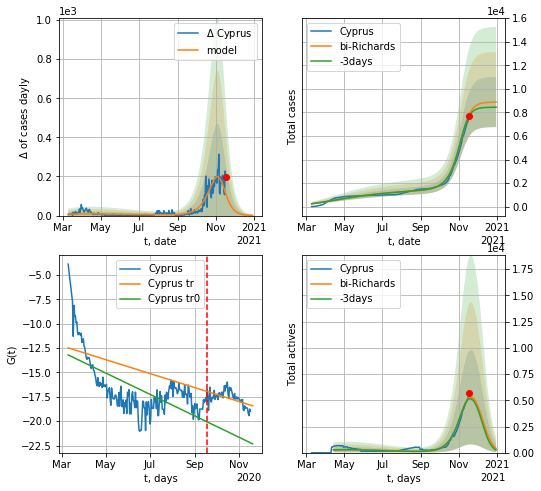

Cyprus data at: 2020-11-18
+3 day model MAPE: 0.015393
model: bi-Richards
coeffs: [7.40261819e+03 7.58609376e-02 2.35306740e+02 1.71065681e+00]
rational stdev: 0.239495
forecast at the end of period: +45 days
	 deltaDaycases: 1
	 total cases: 8879 ± 2126
	 total death: 47 ± 33
bi-Richards approximation splitting point: 190
actives k: 35
trend coefficient of determination: 0.431132
 intercept: -13.205529
 slope: -0.035760
trend coefficient of determination: 0.287290
 intercept: -12.480180
 slope: -0.023307


In [816]:
iL = 0
vL=190+iL
x = forecastRR("Cyprus",dfCP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RRD("Cyprus",dfCP[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [817]:
#vL=33
#x = forecastRRR("Cyprus",dfCP[:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases   active    death
252 2020-11-14  934899  38705.0  35177.0
253 2020-11-15  937011  38660.0  35231.0
254 2020-11-16  938268  37649.0  35271.0
255 2020-11-17  939931  37308.0  35317.0
256 2020-11-18  941951  37384.0  35402.0


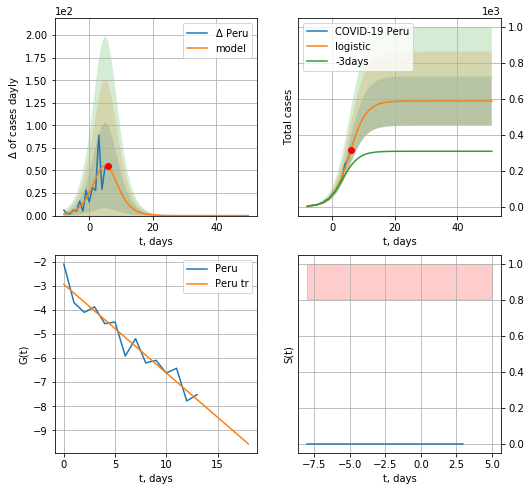

Peru data at: 2020-11-18
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  588 ± 137
	 total death:  22 ± 15
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


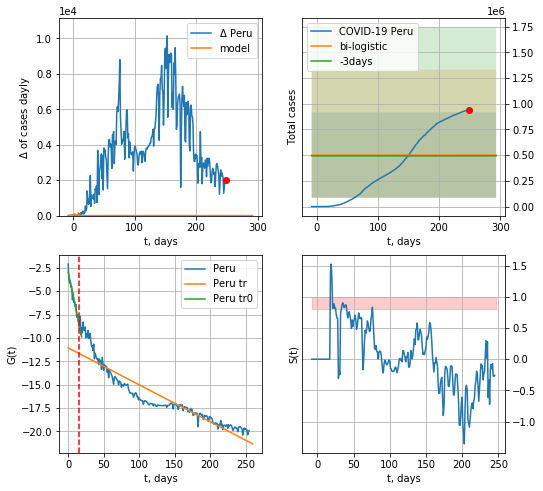

Peru data at: 2020-11-18
+3 day model MAPE: 0.016132466271386814
model: bi-logistic
coeffs:  [ 4.00490150e+05 -4.51171684e+01  1.07623109e+03] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.827965596324039
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  501201 ± 414977
	 total death:  18837 ± 46789
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.860979
 intercept: -11.056146
 slope: -0.039497


In [818]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*T18-dT)
xx = forecast2("Peru",dfPU[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


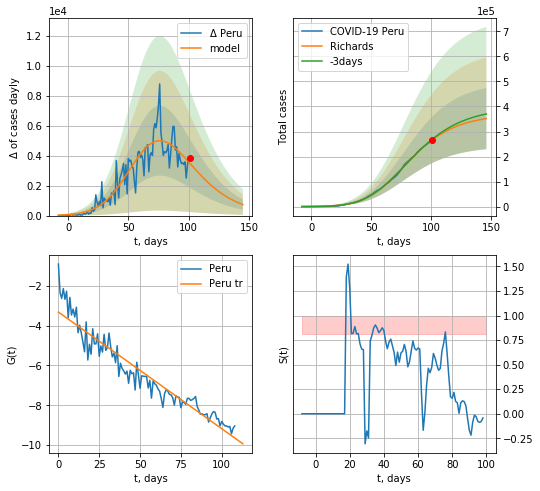

Peru data at: 2020-11-18
+3 day model MAPE: 0.011915
model: Richards
coeffs: [3.68474787e+05 1.13868989e-01 5.48653842e+01 3.85481107e-01]
rational stdev: 0.347400
forecast at the end of period: +45 days
	 deltaDaycases: 734
	 total cases: 351532 ± 122122
	 total death: 13211 ± 13768
trend coefficient of determination: 0.910589
 intercept: -3.314617
 slope: -0.058598
diffStd0a 0.2642905012869702


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


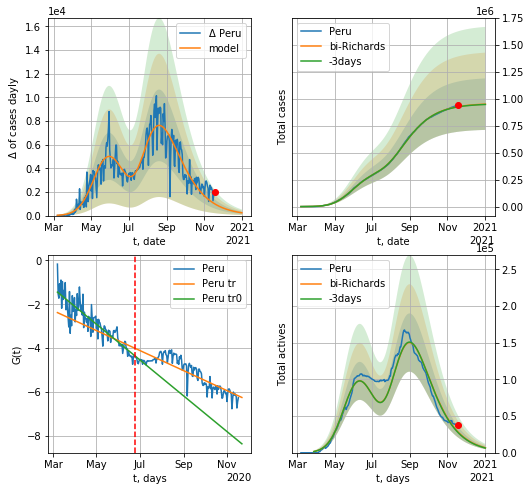

Peru data at: 2020-11-18
+3 day model MAPE: 0.002294
model: bi-Richards
coeffs: [5.90257859e+05 3.87321942e+00 1.76302424e+01 8.61606311e-03]
rational stdev: 0.251270
forecast at the end of period: +45 days
	 deltaDaycases: 235
	 total cases: 951752 ± 239146
	 total death: 35770 ± 26963
bi-Richards approximation splitting point: 110
actives k: 21
trend coefficient of determination: 0.799742
 intercept: -1.447667
 slope: -0.026609
trend coefficient of determination: 0.760319
 intercept: -2.382020
 slope: -0.014885


In [819]:
vL = 110
x = forecastRR("Peru",dfPU[:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Peru",dfPU[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.625)
#x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

In [820]:
#x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date    cases    active     death
259 2020-11-14  8814902  479500.0  129674.0
260 2020-11-15  8845617  465929.0  130109.0
261 2020-11-16  8874290  453361.0  130559.0
262 2020-11-17  8912907  446767.0  131031.0
263 2020-11-18  8960098  444857.0  131639.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


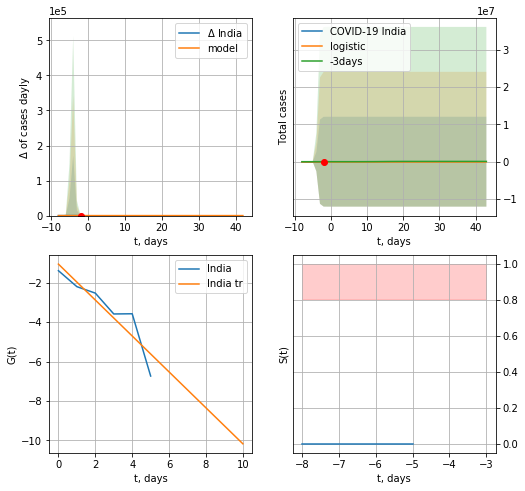

India data at: 2020-11-18
+3 day model MAPE: 0.19486002826260063
model: logistic
coeffs:  [29.4003363   4.01436821 -3.67575825]
rational stdev:  409417.6299021335
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  29 ± 12037016
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


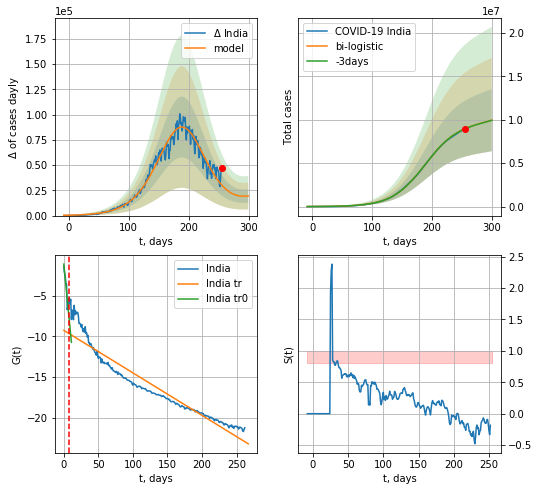

India data at: 2020-11-18
+3 day model MAPE: 0.0018507275452159318
model: bi-logistic
coeffs:  [9.67049141e+06 3.61433484e-02 1.88744692e+02] [29.4003363   4.01436821 -3.67575825]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.35937832439751893
forecast at the end of period: +45 days
	 deltaDaycases:  19566
	 total cases:  9964610 ± 3581065
	 total death:  146396 ± 157834
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.912740
 intercept: -9.271494
 slope: -0.052308


In [821]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*T18-dT)
xx = forecast2("India",dfID[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

In [822]:
dfID.head()

,date,cases,active,death
0,2020-01-30,1,0.0,0.0
1,2020-02-02,2,0.0,0.0
2,2020-02-04,3,0.0,0.0
3,2020-03-03,5,0.0,0.0
4,2020-03-04,6,0.0,0.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


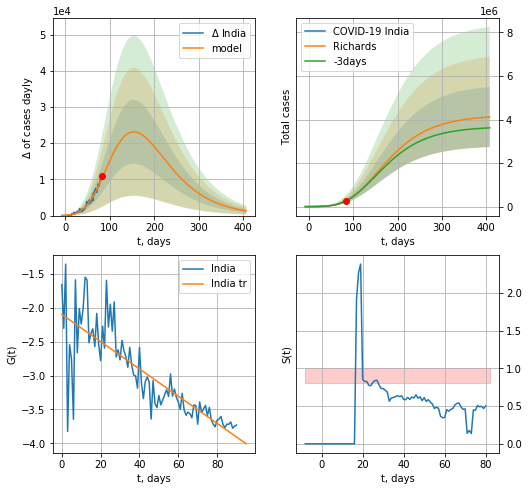

India data at: 2020-11-18
+3 day model MAPE: 0.006742
model: Richards
coeffs: [ 4.20225634e+06  3.29565236e-01 -4.59203879e+01  4.64727771e-02]
rational stdev: 0.335203
forecast at the end of period: +325 days
	 deltaDaycases: 1306
	 total cases: 4116684 ± 1379922
	 total death: 60481 ± 60820
trend coefficient of determination: 0.670933
 intercept: -2.097175
 slope: -0.020112
diffStd0a 0.354646285427924


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


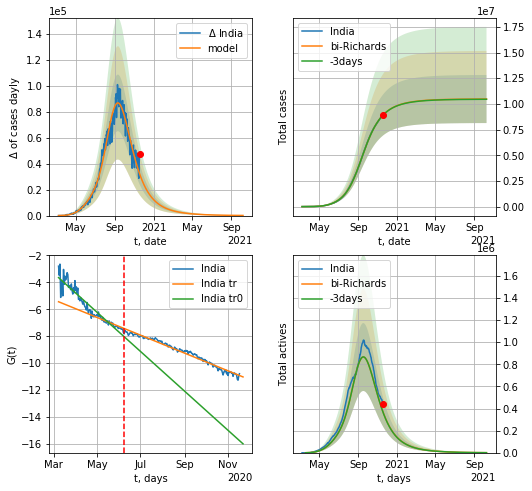

India data at: 2020-11-18
+3 day model MAPE: 0.000911
model: bi-Richards
coeffs: [6.27727594e+06 9.49939606e-02 1.48333756e+02 3.46505154e-01]
rational stdev: 0.223416
forecast at the end of period: +325 days
	 deltaDaycases: 108
	 total cases: 10472505 ± 2339725
	 total death: 153858 ± 103123
bi-Richards approximation splitting point: 92
actives k: 11
trend coefficient of determination: 0.903860
 intercept: -3.644904
 slope: -0.047743
trend coefficient of determination: 0.977079
 intercept: -5.440955
 slope: -0.021599


In [823]:
vL = 100
x = forecastRR("India",dfID[8:vL],d1,80*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("India",dfID[8:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-8,amc=1./3.)

In [824]:
#x = forecastRRR("India",dfID[31:].fillna(0),d1,86*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date      cases    active    death
255 2020-11-14  1304846.0  150173.0  35307.0
256 2020-11-15  1310491.0  145953.0  35436.0
257 2020-11-16  1318384.0  142461.0  35727.0
258 2020-11-17  1329005.0  144066.0  36106.0
259 2020-11-18  1339337.0  146516.0  36347.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


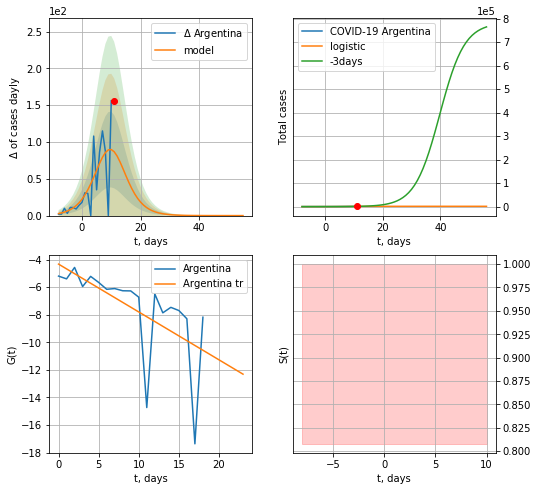

Argentina data at: 2020-11-18
+3 day model MAPE: 0.34277903234874524
model: logistic
coeffs:  [1.30607345e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.27772613105407934
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  1306 ± 362
	 total death:  35 ± 29
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


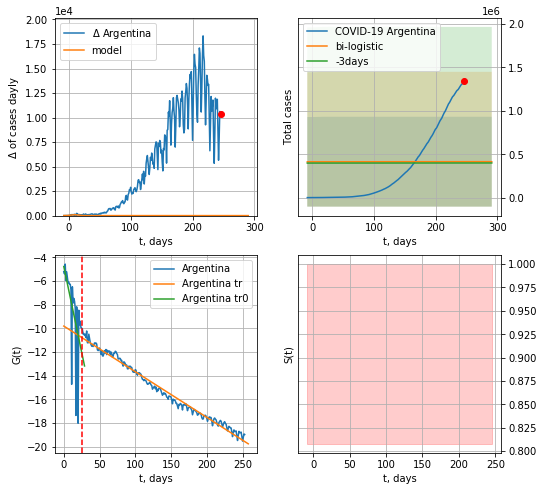

Argentina data at: 2020-11-18
+3 day model MAPE: 0.03715623860829737
model: bi-logistic
coeffs:  [ 3.30345771e+05 -2.72001328e+01  6.51463851e+02] [1.30607345e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.2500832038572682
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  414238 ± 517832
	 total death:  11241 ± 42156
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.984922
 intercept: -9.804877
 slope: -0.038592


In [825]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*T18-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,T18*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


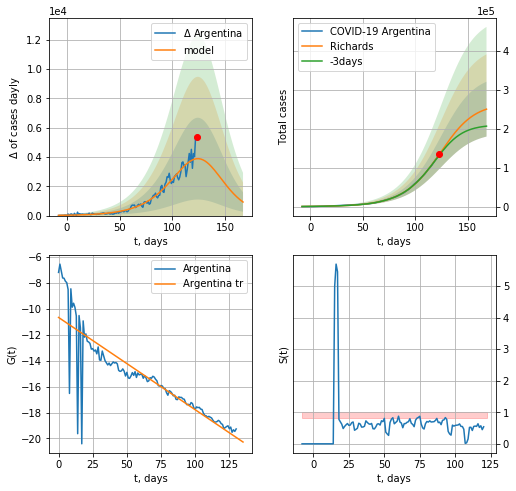

Argentina data at: 2020-11-18
+3 day model MAPE: 0.019206
model: Richards
coeffs: [2.65005155e+05 4.79026563e-02 1.29327238e+02 1.35592311e+00]
rational stdev: 0.281344
forecast at the end of period: +45 days
	 deltaDaycases: 925
	 total cases: 250192 ± 70390
	 total death: 6789 ± 5730
trend coefficient of determination: 0.758651
 intercept: -10.677920
 slope: -0.071075
diffStd0a 0.42460442500538975


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


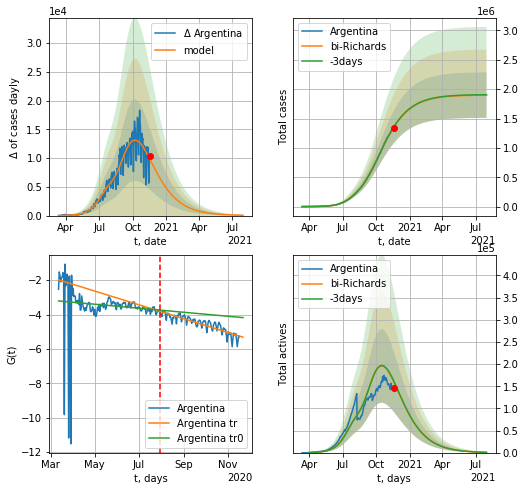

Argentina data at: 2020-11-18
+3 day model MAPE: 0.002305
model: bi-Richards
coeffs: [1.63660347e+06 7.34446823e-01 4.29370646e+01 2.98809655e-02]
rational stdev: 0.203956
forecast at the end of period: +255 days
	 deltaDaycases: 55
	 total cases: 1899090 ± 387330
	 total death: 51537 ± 31533
bi-Richards approximation splitting point: 140
actives k: 16
trend coefficient of determination: 0.015158
 intercept: -3.210054
 slope: -0.003799
trend coefficient of determination: 0.779800
 intercept: -1.981366
 slope: -0.013073


In [826]:
vL = 140+8#38
x = forecastRR('Argentina',dfAG[8:vL-8].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Argentina',dfAG[8:].fillna(0),d1,70*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-8,amc=0.475)

In [827]:
#x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

In [828]:
#vL=33
#x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*T18-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
#xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

QR
           date   cases  active  death
254 2020-11-14  135570  2759.0  234.0
255 2020-11-15  135785  2767.0  234.0
256 2020-11-16  136028  2783.0  235.0
257 2020-11-17  136222  2770.0  235.0
258 2020-11-18  136441  2733.0  235.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


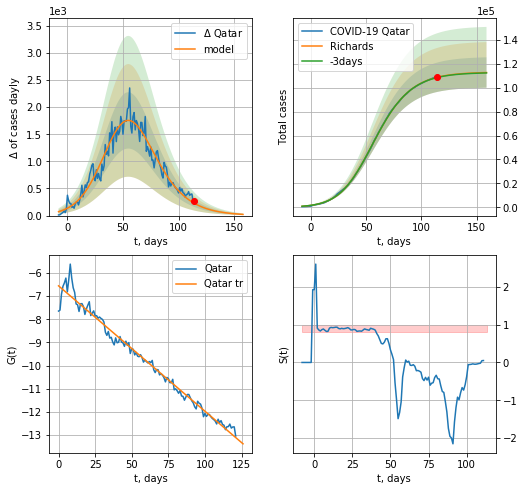

Qatar data at: 2020-11-18
+3 day model MAPE: 0.001883
model: Richards
coeffs: [1.13070089e+05 8.99170413e-02 4.60810469e+01 6.06536184e-01]
rational stdev: 0.112907
forecast at the end of period: +45 days
	 deltaDaycases: 21
	 total cases: 112676 ± 12721
	 total death: 194 ± 65
trend coefficient of determination: 0.979229
 intercept: -6.558422
 slope: -0.054146
diffStd0a 0.3187233447133911


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


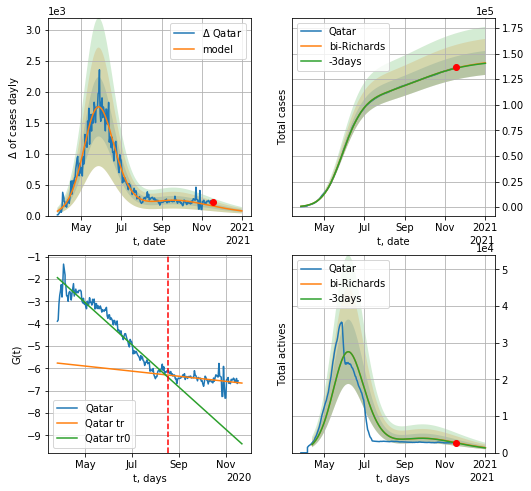

Qatar data at: 2020-11-18
+3 day model MAPE: 0.001320
model: bi-Richards
coeffs: [ 3.16549245e+04  1.98921522e+00 -4.66565466e+01  1.03515218e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.083136
forecast at the end of period: +45 days
	 deltaDaycases: 75
	 total cases: 140838 ± 11708
	 total death: 242 ± 60
bi-Richards approximation splitting point: 144
actives k: 17
trend coefficient of determination: 0.918246
 intercept: -1.939778
 slope: -0.030850
trend coefficient of determination: 0.170275
 intercept: -5.761837
 slope: -0.003712


In [829]:
iL = 21
vL = 144 + iL
dfQR = read_df(pd.DataFrame(),"QR")
x = forecastRR('Qatar',dfQR[iL:vL-iL].fillna(0),d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Qatar',dfQR[iL:].fillna(0),d12f(1),40*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)

In [830]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date     cases  active  death
273 2020-11-14  149135.0    6046  528.0
274 2020-11-15  150345.0    6563  530.0
275 2020-11-16  151554.0    7088  534.0
276 2020-11-17  152809.0    7624  538.0
277 2020-11-18  154101.0    8022  542.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


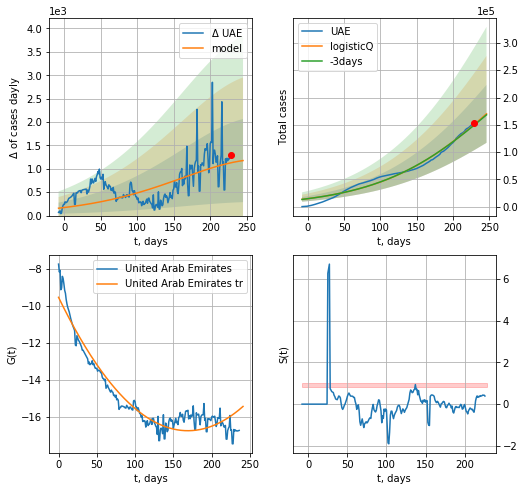

UAE data at: 2020-11-18
+3 day model MAPE: 0.007548
model: logisticQ
coeffs: [ 3.99233153e+05  1.39705681e-07  2.71105550e+02 -8.59266395e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311644
forecast at the end of period: +17 days
	 deltaDaycases: 1176
	 total cases: 170172 ± 53033
	 total death: 598 ± 559
trend coefficient of determination: 0.922599
 intercept_: -9.52795117227439
 coeffs_: [ 0.         -0.08540644  0.00025278]


In [831]:
try:
    dfUAE = read_df(pd.DataFrame(),"UAE")
    x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


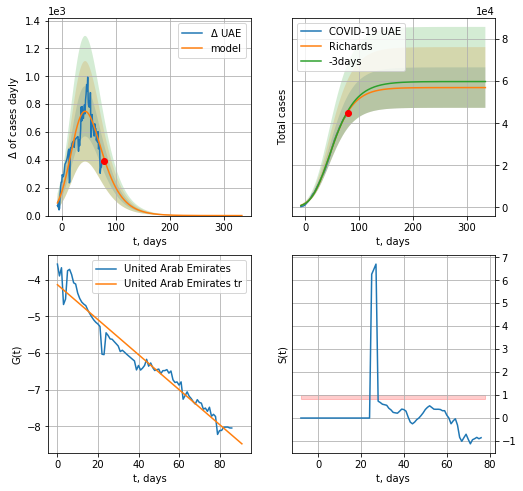

UAE data at: 2020-11-18
+3 day model MAPE: 0.009891
model: Richards
coeffs: [5.69575832e+04 1.33404785e-01 1.50634020e+01 3.08321872e-01]
rational stdev: 0.168958
forecast at the end of period: +255 days
	 deltaDaycases: 0
	 total cases: 56957 ± 9623
	 total death: 200 ± 101
trend coefficient of determination: 0.950927
 intercept: -4.139656
 slope: -0.047646


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


diffStd0a 0.9185904696038395


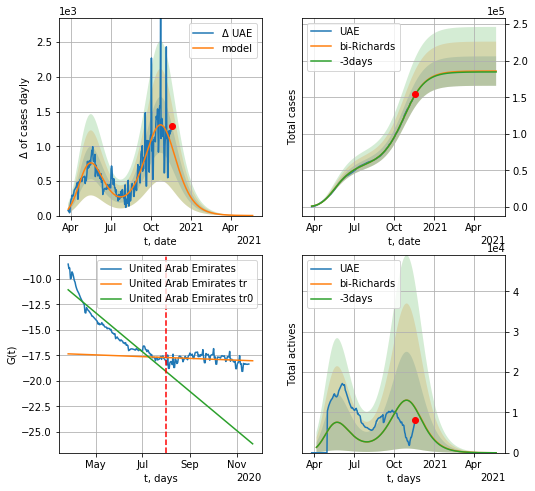

UAE data at: 2020-11-18
+3 day model MAPE: 0.001006
model: bi-Richards
coeffs: [1.28915632e+05 3.71384591e-02 2.06374708e+02 1.13575520e+00]
rational stdev: 0.108392
forecast at the end of period: +185 days
	 deltaDaycases: 0
	 total cases: 185855 ± 20145
	 total death: 653 ± 212
bi-Richards approximation splitting point: 128
actives k: 11
trend coefficient of determination: 0.897246
 intercept: -11.064938
 slope: -0.062698
trend coefficient of determination: 0.038136
 intercept: -17.350105
 slope: -0.002809


In [832]:
iL = 40
vL = 128 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('UAE',dfUAE[iL:],d1,60*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.33)
#x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [833]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

In [834]:
dfSA = read_df(pd.DataFrame(),"SA")
#x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

SA
           date     cases  active   death
256 2020-11-14  352950.0    7362  5641.0
257 2020-11-15  353255.0    7294  5657.0
258 2020-11-16  353556.0    7212  5676.0
259 2020-11-17  353918.0    7122  5692.0
260 2020-11-18  354208.0    6983  5710.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


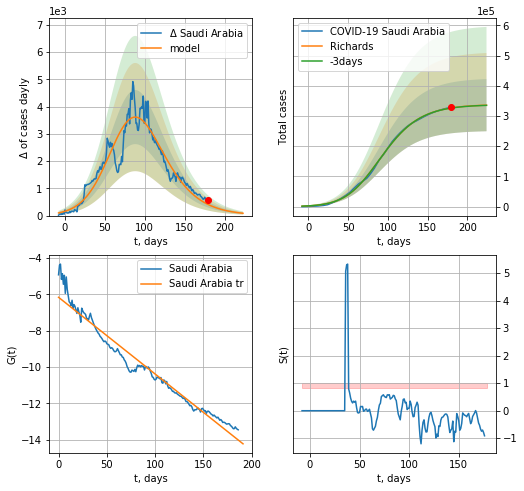

Saudi Arabia data at: 2020-11-18
+3 day model MAPE: 0.001288
model: Richards
coeffs: [3.38127321e+05 6.59352178e-02 7.28001513e+01 5.59722104e-01]
rational stdev: 0.257065
forecast at the end of period: +45 days
	 deltaDaycases: 84
	 total cases: 335860 ± 86337
	 total death: 5414 ± 4175
trend coefficient of determination: 0.960421
 intercept: -6.158396
 slope: -0.042260
diffStd0a 0.4388932805804526


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


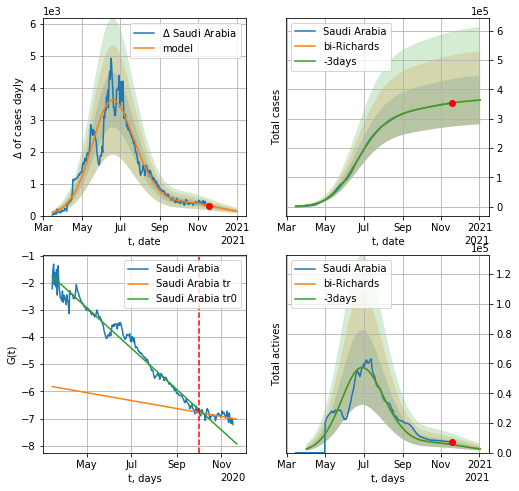

Saudi Arabia data at: 2020-11-18
+3 day model MAPE: 0.000511
model: bi-Richards
coeffs: [3.18219557e+04 2.81357596e+00 3.54696439e+01 9.00122000e-03]
rational stdev: 0.228316
forecast at the end of period: +45 days
	 deltaDaycases: 142
	 total cases: 363944 ± 83094
	 total death: 5866 ± 4017
bi-Richards approximation splitting point: 200
actives k: 17
trend coefficient of determination: 0.970598
 intercept: -1.767234
 slope: -0.024462
trend coefficient of determination: 0.227288
 intercept: -5.824409
 slope: -0.004759


In [835]:
iL = 12
vL = 200 + iL
x = forecastRR('Saudi Arabia',dfSA[iL:vL-iL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Saudi Arabia',dfSA[iL:],d1,T18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)
#x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [836]:
try:
    dfSri = read_df(pd.DataFrame(),"Sri")
    vL= 30
    #x = forecastRRR('Sri Lanka',dfSri[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    #xx = forecast2RRR('Sri Lanka',dfSri[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

Sri
           date    cases  active  death
249 2020-11-14  16583.0    5206   53.0
250 2020-11-15  17287.0    5734   58.0
251 2020-11-16  17674.0    5807   61.0
252 2020-11-17  18075.0    5799   66.0
253 2020-11-18  18402.0    5746   69.0


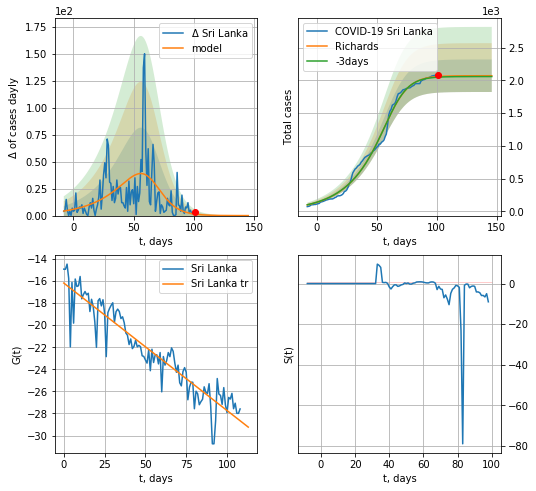

Sri Lanka data at: 2020-11-18
+3 day model MAPE: 0.004977
model: Richards
coeffs: [2.07051731e+03 4.15080701e-02 6.51914811e+01 2.75459097e+00]
rational stdev: 0.119919
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 2070 ± 248
	 total death: 7 ± 2
trend coefficient of determination: 0.877174
 intercept: -16.184142
 slope: -0.115477
diffStd0a 4.01276173401128


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


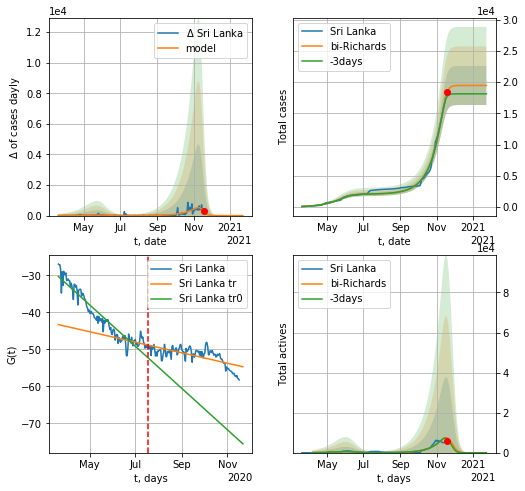

Sri Lanka data at: 2020-11-18
+3 day model MAPE: 0.040896
model: bi-Richards
coeffs: [1.74012745e+04 5.01710828e-02 2.32388312e+02 5.52526959e+00]
rational stdev: 0.160502
forecast at the end of period: +66 days
	 deltaDaycases: 0
	 total cases: 19471 ± 3125
	 total death: 73 ± 35
bi-Richards approximation splitting point: 120
actives k: 17
trend coefficient of determination: 0.905209
 intercept: -30.318373
 slope: -0.183139
trend coefficient of determination: 0.474166
 intercept: -43.316550
 slope: -0.046139


In [837]:
vL=130#88
x = forecastRR('Sri Lanka',dfSri[10:vL-10],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Sri Lanka',dfSri[10:],d1,43*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10,amc=0.5)
#x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
261 2020-11-14  356904.0   26538  7141.0
262 2020-11-15  359032.0   28048  7160.0
263 2020-11-16  361082.0   29055  7193.0
264 2020-11-17  363380.0   30362  7230.0
265 2020-11-18  365927.0   32005  7248.0


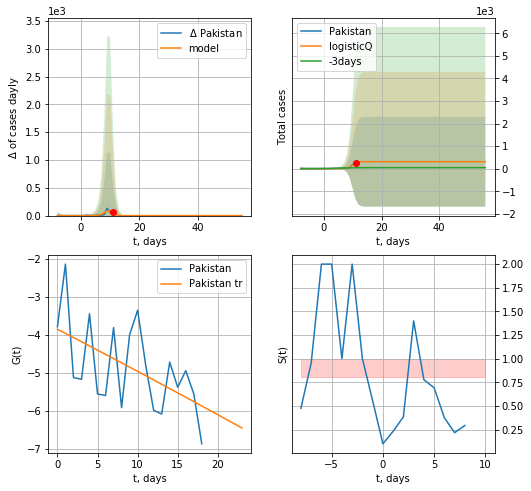

Pakistan data at: 2020-11-18
+3 day model MAPE: 5.954392
model: logisticQ
coeffs: [ 3.10300108e+02  5.80299149e-02  9.88962592e+00 -1.18245382e+01]
rational stdev: 6.420495
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


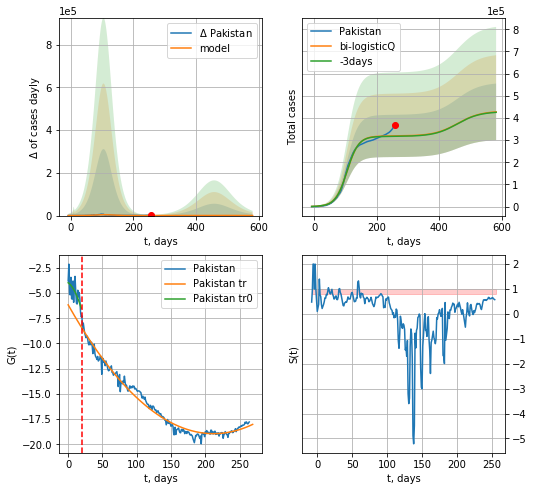

Pakistan data at: 2020-11-18
+3 day model MAPE: 0.005701
model: bi-logisticQ
coeffs: [ 3.18066567e+05  8.01303682e-08  1.05204173e+02 -6.72568647e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.299036
forecast at the end of period: +325 days
	 deltaDaycases: 101
	 total cases: 427199 ± 127748
	 total death: 8461 ± 7590
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.980886
 intercept_: -6.169891339158031
 coeffs_: [ 0.         -0.12041205  0.00028387]


In [838]:
try:
    dfPS = read_df(pd.DataFrame(),"PS")
    vL= 20
    x = forecastRRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


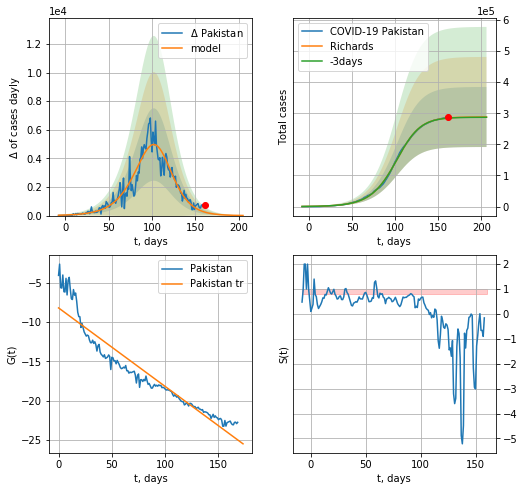

Pakistan data at: 2020-11-18
+3 day model MAPE: 0.002417
model: Richards
coeffs: [2.88169103e+05 5.68558279e-02 1.06265073e+02 1.33731169e+00]
rational stdev: 0.335042
forecast at the end of period: +45 days
	 deltaDaycases: 8
	 total cases: 288059 ± 96512
	 total death: 5705 ± 5734
trend coefficient of determination: 0.903657
 intercept: -8.180854
 slope: -0.100161
diffStd0a 0.17277429691949828


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


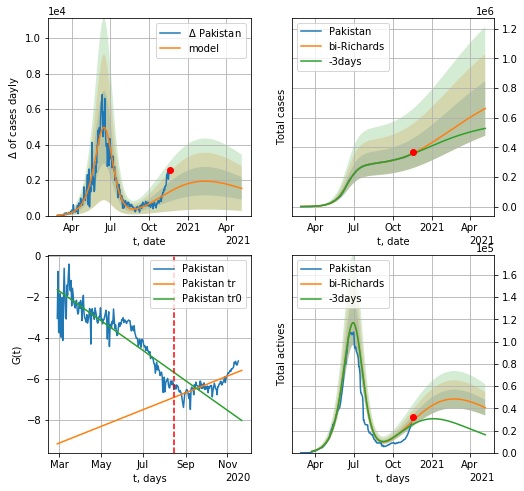

Pakistan data at: 2020-11-18
+3 day model MAPE: 0.009931
model: bi-Richards
coeffs: [ 5.86919600e+05  6.99314428e-01 -1.39277817e+02  1.29421016e-02]
rational stdev: 0.277654
forecast at the end of period: +171 days
	 deltaDaycases: 1530
	 total cases: 660947 ± 183515
	 total death: 13091 ± 10904
bi-Richards approximation splitting point: 170
actives k: 26
trend coefficient of determination: 0.749732
 intercept: -1.654720
 slope: -0.023719
trend coefficient of determination: 0.582891
 intercept: -9.174173
 slope: 0.013320


In [839]:
vL = 170#25
x = forecastRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Pakistan',dfPS[:],d12f(1),58*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.75)
#x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
251 2020-11-14  430496.0   76474  6173.0
252 2020-11-15  432333.0   76597  6194.0
253 2020-11-16  434472.0   77111  6215.0
254 2020-11-17  436684.0   77535  6254.0
255 2020-11-18  438795.0   77732  6275.0


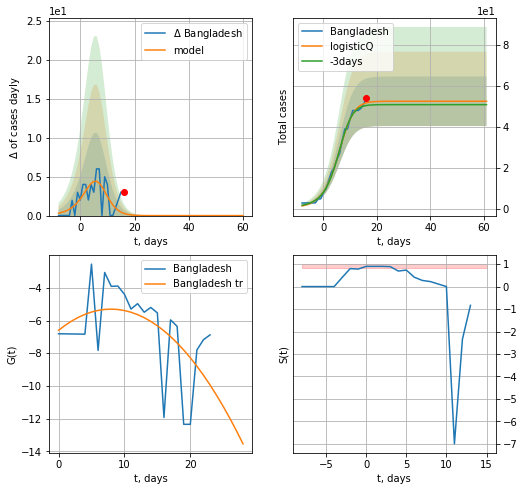

Bangladesh data at: 2020-11-18
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923910e+01  5.83606353e-03  5.49443194e+00 -5.18823422e+01]
rational stdev: 0.229682
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


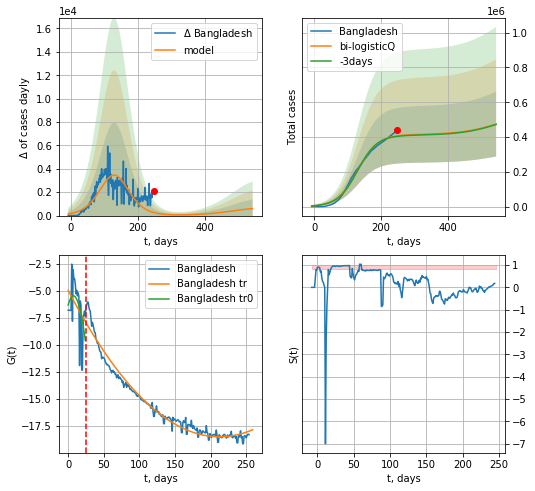

Bangladesh data at: 2020-11-18
+3 day model MAPE: 0.007333
model: bi-logisticQ
coeffs: [ 4.13738496e+05  6.52959691e-08  1.29567810e+02 -5.12404408e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392509
forecast at the end of period: +297 days
	 deltaDaycases: 597
	 total cases: 474399 ± 186205
	 total death: 6784 ± 7988
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.970814
 intercept_: -4.973266319443072
 coeffs_: [ 0.         -0.1274504   0.00029986]


In [840]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
try:
    x = forecastRRR('Bangladesh',dfBN[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


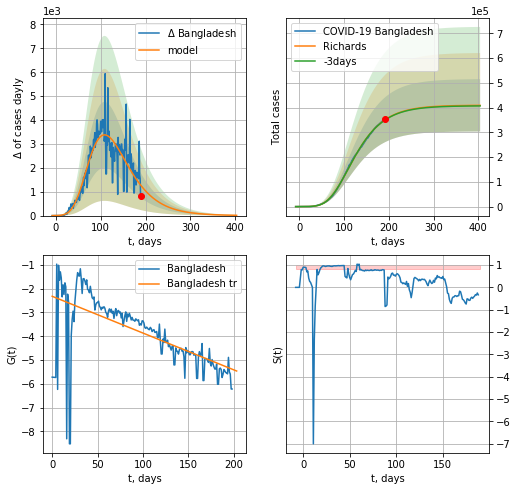

Bangladesh data at: 2020-11-18
+3 day model MAPE: 0.002602
model: Richards
coeffs: [ 4.09448499e+05  1.69324920e+00 -8.20191843e+01  1.33360757e-02]
rational stdev: 0.258135
forecast at the end of period: +213 days
	 deltaDaycases: 11
	 total cases: 408923 ± 105557
	 total death: 5847 ± 4527
trend coefficient of determination: 0.402732
 intercept: -2.317249
 slope: -0.015497


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


diffStd0a 0.2855862719369372


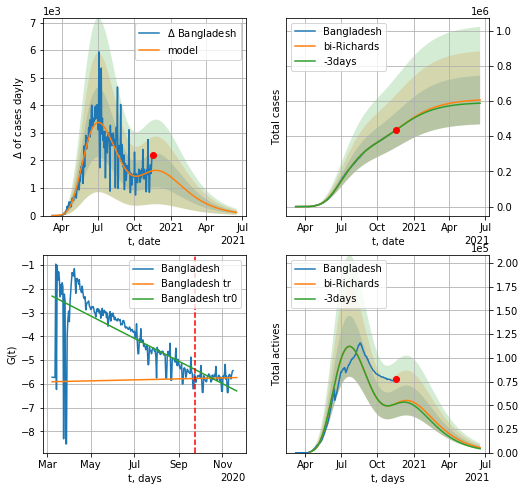

Bangladesh data at: 2020-11-18
+3 day model MAPE: 0.001107
model: bi-Richards
coeffs: [2.02521382e+05 1.52778970e+00 2.80756802e+01 1.20043875e-02]
rational stdev: 0.228643
forecast at the end of period: +213 days
	 deltaDaycases: 115
	 total cases: 605679 ± 138484
	 total death: 8661 ± 5940
bi-Richards approximation splitting point: 200
actives k: 35
trend coefficient of determination: 0.404767
 intercept: -2.308710
 slope: -0.015461
trend coefficient of determination: 0.001681
 intercept: -5.910203
 slope: 0.000678


In [841]:
vL=200
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Bangladesh',dfBN[:-1],d1,64*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date     cases  active  death
264 2020-11-14  136341.0    8604  835.0
265 2020-11-15  136840.0    8417  838.0
266 2020-11-16  137329.0    8073  842.0
267 2020-11-17  137885.0    7996  848.0
268 2020-11-18  138337.0    7641  857.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


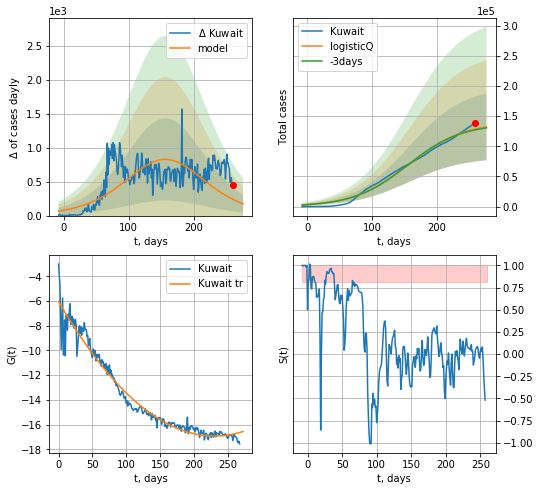

Kuwait data at: 2020-11-18
+3 day model MAPE: 0.010339
model: logisticQ
coeffs: [ 1.39884230e+05  4.95016172e-08  1.56788150e+02 -4.77897637e+05]
rational stdev: 0.418433
forecast at the end of period: +17 days
	 deltaDaycases: 173
	 total cases: 132202 ± 55317
	 total death: 818 ± 1026
trend coefficient of determination: 0.957477
 intercept_: -6.028785924481691
 coeffs_: [ 0.         -0.09484959  0.0002063 ]


In [842]:
try:
    dfKW = read_df(pd.DataFrame(),"KW")
    x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


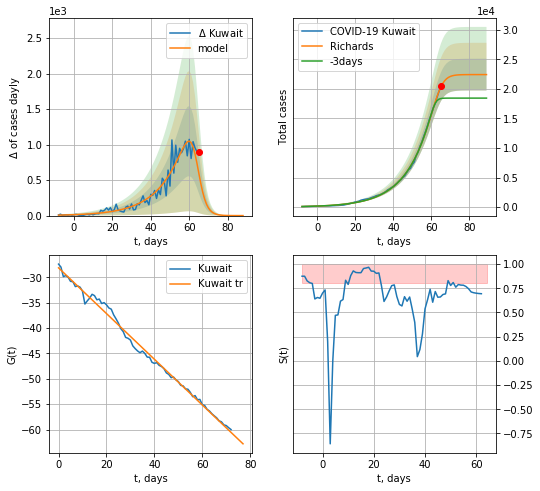

Kuwait data at: 2020-11-18
+3 day model MAPE: 0.136577
model: Richards
coeffs: [2.24365718e+04 7.66634183e-02 6.43548409e+01 5.72971780e+00]
rational stdev: 0.119998
forecast at the end of period: +24 days
	 deltaDaycases: 0
	 total cases: 22436 ± 2692
	 total death: 138 ± 49
trend coefficient of determination: 0.993036
 intercept: -28.143720
 slope: -0.450232
diffStd0a 0.20945944496818858


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


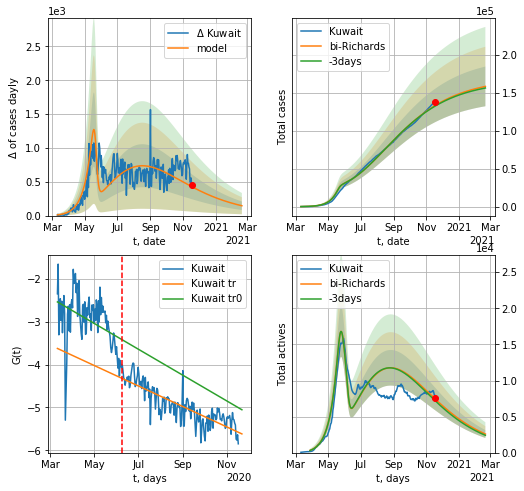

Kuwait data at: 2020-11-18
+3 day model MAPE: 0.006038
model: bi-Richards
coeffs: [ 1.47180054e+05  1.30442791e+00 -1.81903307e+02  1.04865545e-02]
rational stdev: 0.164976
forecast at the end of period: +94 days
	 deltaDaycases: 145
	 total cases: 158609 ± 26166
	 total death: 982 ± 486
bi-Richards approximation splitting point: 90
actives k: 17
trend coefficient of determination: 0.169925
 intercept: -2.538776
 slope: -0.009823
trend coefficient of determination: 0.693569
 intercept: -3.624473
 slope: -0.007782


In [843]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Kuwait',dfKW[iL:],d1,47*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)

DM
           date     cases  active   death
258 2020-11-14  133225.0   21353  2282.0
259 2020-11-15  133724.0   21458  2285.0
260 2020-11-16  134203.0   21536  2286.0
261 2020-11-17  134697.0   21646  2290.0
262 2020-11-18  135157.0   21993  2293.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


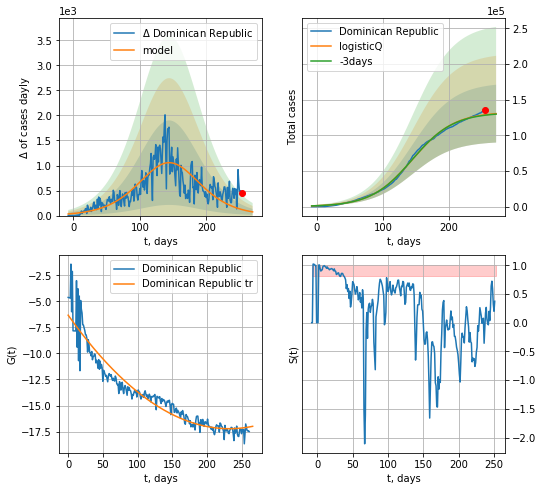

Dominican Republic data at: 2020-11-18
+3 day model MAPE: 0.004947
model: logisticQ
coeffs: [ 1.32737927e+05  1.82068767e-07  1.44641973e+02 -1.74807647e+05]
rational stdev: 0.310904
forecast at the end of period: +17 days
	 deltaDaycases: 73
	 total cases: 130414 ± 40546
	 total death: 2212 ± 2063
trend coefficient of determination: 0.912833
 intercept_: -6.327786904547338
 coeffs_: [ 0.         -0.09376     0.00020173]


In [844]:
try:
    dfDM = read_df(pd.DataFrame(),"DM")
    x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


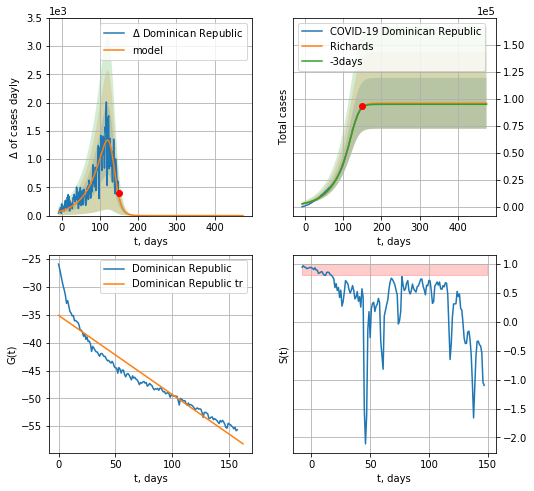

Dominican Republic data at: 2020-11-18
+3 day model MAPE: 0.005387
model: Richards
coeffs: [9.58537061e+04 2.51311168e-02 1.33920330e+02 4.38991064e+00]
rational stdev: 0.245847
forecast at the end of period: +325 days
	 deltaDaycases: 0
	 total cases: 95853 ± 23565
	 total death: 1626 ± 1199
trend coefficient of determination: 0.911154
 intercept: -35.091723
 slope: -0.142399
diffStd0a 0.24983399150105745


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


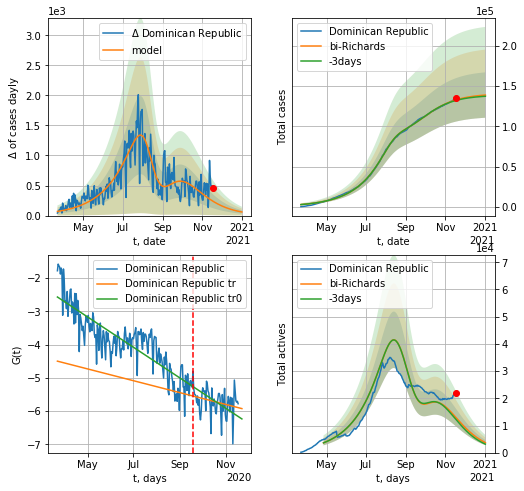

Dominican Republic data at: 2020-11-18
+3 day model MAPE: 0.005467
model: bi-Richards
coeffs: [4.48041767e+04 4.26202330e+00 4.31783105e+01 8.03434871e-03]
rational stdev: 0.203258
forecast at the end of period: +45 days
	 deltaDaycases: 60
	 total cases: 138897 ± 28232
	 total death: 2356 ± 1436
bi-Richards approximation splitting point: 180
actives k: 35
trend coefficient of determination: 0.729126
 intercept: -2.572567
 slope: -0.014946
trend coefficient of determination: 0.068862
 intercept: -4.499218
 slope: -0.005815


In [845]:
vL = 180+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Dominican Republic',dfDM[21:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active   death
252 2020-11-14  88772.0   17240  2006.0
253 2020-11-15  89279.0   16448  2019.0
254 2020-11-16  89843.0   15934  2035.0
255 2020-11-17  90912.0   15799  2054.0
256 2020-11-18  92519.0   16218  2072.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


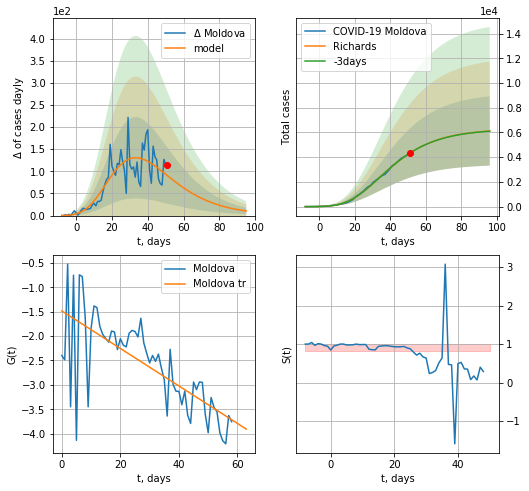

Moldova data at: 2020-11-18
+3 day model MAPE: 0.000798
model: Richards
coeffs: [ 6.30547519e+03  3.98861804e+00 -4.11482156e+01  1.42375767e-02]
rational stdev: 0.458356
forecast at the end of period: +45 days
	 deltaDaycases: 10
	 total cases: 6124 ± 2807
	 total death: 137 ± 188
trend coefficient of determination: 0.512178
 intercept: -1.485670
 slope: -0.038427
diffStd0a 0.20289634442397436


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


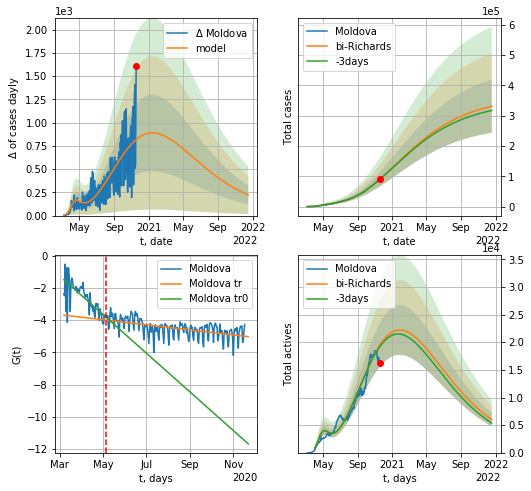

Moldova data at: 2020-11-18
+3 day model MAPE: 0.004722
model: bi-Richards
coeffs: [ 3.58647206e+05  3.55506129e-01 -2.76175020e+02  1.91548329e-02]
rational stdev: 0.263353
forecast at the end of period: +395 days
	 deltaDaycases: 220
	 total cases: 330901 ± 87144
	 total death: 7410 ± 5854
bi-Richards approximation splitting point: 60
actives k: 26
trend coefficient of determination: 0.534899
 intercept: -1.495686
 slope: -0.039117
trend coefficient of determination: 0.300994
 intercept: -3.694708
 slope: -0.005113


In [846]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("Moldova",dfMD[:],d1,90*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.75)
except:
    print("Exception occurs")

In [847]:
#np.diff(dfAF["cases"])

AF
           date     cases  active    death
254 2020-11-14  749182.0   35715  20206.0
255 2020-11-15  751024.0   37316  20241.0
256 2020-11-16  752269.0   36459  20314.0
257 2020-11-17  754256.0   37004  20432.0
258 2020-11-18  757144.0   35054  20556.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


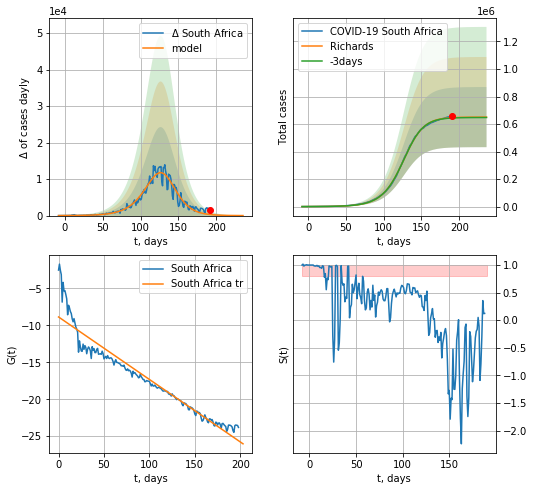

South Africa data at: 2020-11-18
+3 day model MAPE: 0.004049
model: Richards
coeffs: [6.50495420e+05 6.00130177e-02 1.30420741e+02 1.32516636e+00]
rational stdev: 0.335865
forecast at the end of period: +45 days
	 deltaDaycases: 9
	 total cases: 650384 ± 218441
	 total death: 17657 ± 17791
trend coefficient of determination: 0.917893
 intercept: -8.866953
 slope: -0.084547
diffStd0a 0.6320466268739631


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


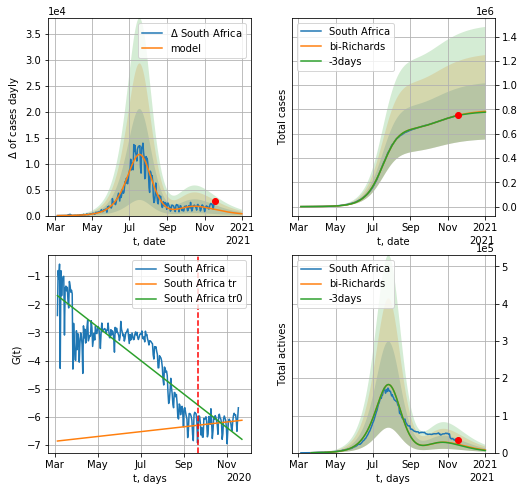

South Africa data at: 2020-11-18
+3 day model MAPE: 0.002914
model: bi-Richards
coeffs: [1.44394192e+05 4.24470258e+00 7.26365678e+01 7.82498389e-03]
rational stdev: 0.295768
forecast at the end of period: +45 days
	 deltaDaycases: 356
	 total cases: 783892 ± 231850
	 total death: 21282 ± 18883
bi-Richards approximation splitting point: 200
actives k: 17
trend coefficient of determination: 0.700134
 intercept: -1.693706
 slope: -0.019463
trend coefficient of determination: 0.026851
 intercept: -6.854915
 slope: 0.002811


In [848]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 200#30
    x = forecastRR("South Africa",dfAF[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("South Africa",dfAF[:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)
except:
    print("Exception occurs")

UB
           date  cases  active  death
244 2020-11-14  70102    2189  598.0
245 2020-11-15  70299    2175  598.0
246 2020-11-16  70444    2112  598.0
247 2020-11-17  70648    2122  599.0
248 2020-11-18  70858    2134  601.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


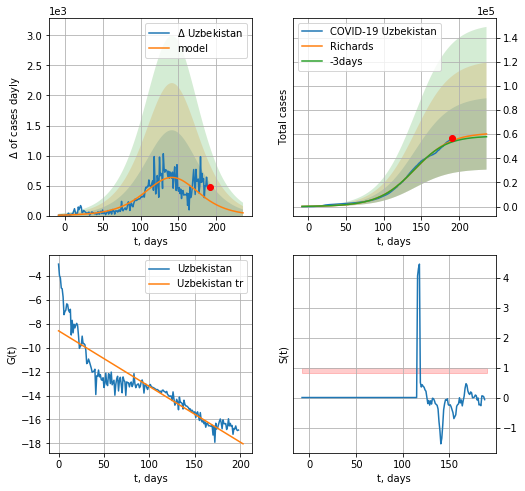

Uzbekistan data at: 2020-11-18
+3 day model MAPE: 0.018828
model: Richards
coeffs: [6.12494031e+04 3.87618713e-02 1.44107365e+02 1.10533721e+00]
rational stdev: 0.491066
forecast at the end of period: +45 days
	 deltaDaycases: 45
	 total cases: 60188 ± 29556
	 total death: 510 ± 751
trend coefficient of determination: 0.822556
 intercept: -8.575606
 slope: -0.046611
diffStd0a 0.5465929672884727


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


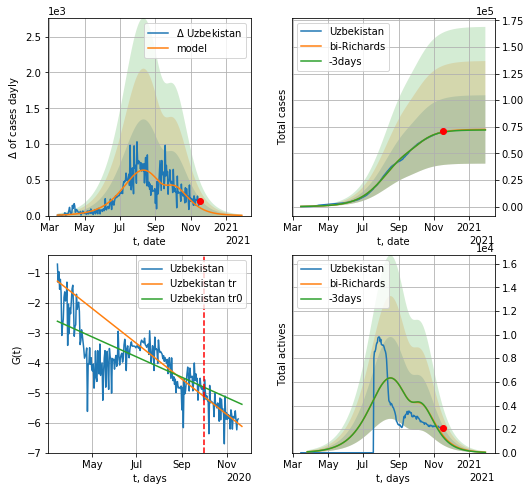

Uzbekistan data at: 2020-11-18
+3 day model MAPE: 0.003687
model: bi-Richards
coeffs: [1.12845902e+04 1.15530413e+01 1.01637665e+02 4.61990496e-03]
rational stdev: 0.443022
forecast at the end of period: +73 days
	 deltaDaycases: 3
	 total cases: 72463 ± 32102
	 total death: 614 ± 816
bi-Richards approximation splitting point: 200
actives k: 11
trend coefficient of determination: 0.459185
 intercept: -2.610998
 slope: -0.011004
trend coefficient of determination: 0.407843
 intercept: -1.271149
 slope: -0.019246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power


In [849]:
dfUB = read_df(pd.DataFrame(),"UB").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 200#45
    x = forecastRR("Uzbekistan",dfUB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("Uzbekistan",dfUB[:],d1,44*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.33)
except:
    print("Exception occurs")

In [850]:
dfAFG = read_df(pd.DataFrame(),"AFG").fillna(0)
#dfAFG['active'] = np.zeros(len(dfAFG))
#dfAFG.tail()

AFG
           date  cases  active   death
228 2020-11-14  43240  6531.0  1617.0
229 2020-11-15  43403  6640.0  1626.0
230 2020-11-16  43628  6830.0  1638.0
231 2020-11-17  43851  6911.0  1645.0
232 2020-11-18  44133  7144.0  1650.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


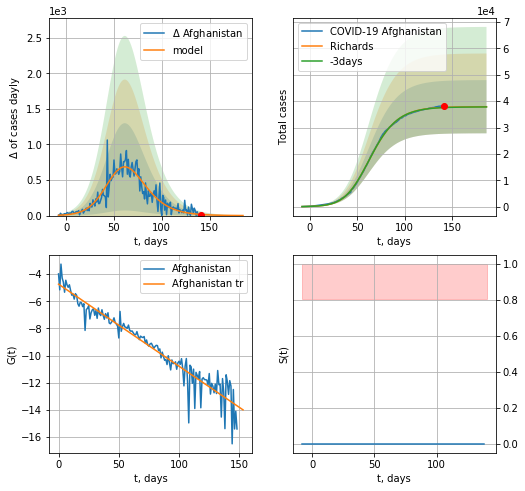

Afghanistan data at: 2020-11-18
+3 day model MAPE: 0.002095
model: Richards
coeffs: [3.79142308e+04 1.10640933e-01 5.26336374e+01 5.65351441e-01]
rational stdev: 0.266062
forecast at the end of period: +45 days
	 deltaDaycases: 1
	 total cases: 37898 ± 10083
	 total death: 1416 ± 1130
trend coefficient of determination: 0.920101
 intercept: -4.739385
 slope: -0.060561
diffStd0a 0.7344930352759028


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


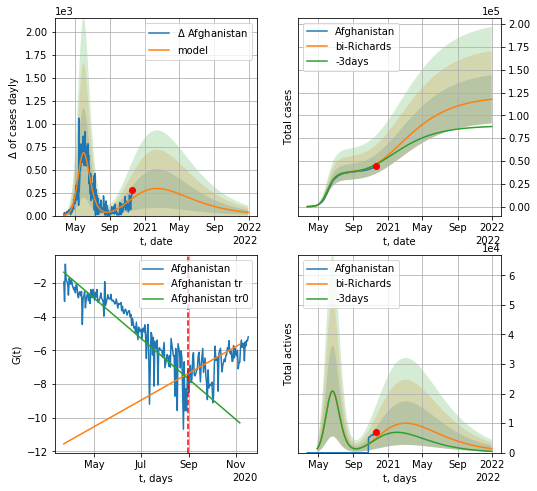

Afghanistan data at: 2020-11-18
+3 day model MAPE: 0.004009
model: bi-Richards
coeffs: [ 8.34682912e+04  7.05621994e-01 -1.23654393e+02  1.37425211e-02]
rational stdev: 0.224414
forecast at the end of period: +423 days
	 deltaDaycases: 34
	 total cases: 117736 ± 26421
	 total death: 4401 ± 2962
bi-Richards approximation splitting point: 150
actives k: 35
trend coefficient of determination: 0.789736
 intercept: -1.365520
 slope: -0.039230
trend coefficient of determination: 0.362896
 intercept: -11.557369
 slope: 0.025918


In [851]:
#dfAFG = read_df(pd.DataFrame(),"AFG").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 150 + 8
    x = forecastRR("Afghanistan",dfAFG[8:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("Afghanistan",dfAFG[8:],d1,94*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-8)
except:
    print("Exception occurs")

In [795]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [466]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[708, 708, 708, 708, 708, 708, 708, 708, 708, 708, 708, 708, 708, 708, 708, 708, 708, 708, 708]


In [467]:
df.head(10)
#df.columns[18]

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/\n1M pop\n,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"13,943,144","+3,959","383,096",506,"8,730,177","+4,096","4,829,871","26,194",,,,,,North America,\n,,
1,,\nAsia\n,"15,378,465","+17,810","271,395",260,"13,809,192","+19,149","1,297,878","25,136",,,,,,Asia,\n,,
2,,\nSouth America\n,"10,504,498",96,"313,513",9,"9,498,954",544,"692,031","17,363",,,,,,South America,\n,,
3,,\nEurope\n,"14,723,139","+47,075","338,335",998,"5,633,186","+46,778","8,751,618","30,140",,,,,,Europe,\n,,
4,,\nAfrica\n,"2,027,128",541,"48,518",9,"1,709,945",666,"268,665","2,573",,,,,,Africa,\n,,
5,,\nOceania\n,"43,075",11,"1,003",,"32,951",30,"9,121",24,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,659,,47,4,,,,,,,\n,,
7,,World,"56,620,170","+69,492","1,355,875","+1,782","39,415,064","+71,263","15,849,231","101,434","7,264",173.9,,,,All,\n,,
8,1,USA,"11,873,863",,"256,262",,"7,166,996",,"4,450,605","22,195","35,792",772,"173,235,829","522,190","331,748,637",North America,28,"1,295",2
9,2,India,"8,960,098","+1,955","131,639",21,"8,383,602","+1,832","444,857","8,944","6,468",95,"128,508,389","92,773","1,385,197,188",Asia,155,"10,523",11


In [468]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"13,943,144","+3,959","383,096",506,"8,730,177","+4,096","4,829,871","26,194",,,,,,North America,\n,,
1,,\nAsia\n,"15,378,465","+17,810","271,395",260,"13,809,192","+19,149","1,297,878","25,136",,,,,,Asia,\n,,
2,,\nSouth America\n,"10,504,498",96,"313,513",9,"9,498,954",544,"692,031","17,363",,,,,,South America,\n,,
3,,\nEurope\n,"14,723,139","+47,075","338,335",998,"5,633,186","+46,778","8,751,618","30,140",,,,,,Europe,\n,,
4,,\nAfrica\n,"2,027,128",541,"48,518",9,"1,709,945",666,"268,665","2,573",,,,,,Africa,\n,,


In [469]:
df[df["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
94,87,Lithuania,"38,810",,323,,"9,362",,"29,125",107,"14,335",119,"1,212,239","447,749","2,707,410",Europe,70,"8,382",2
332,88,Lithuania,"38,810","+1,935",323,24,"9,362",796,"29,125",107,"14,335",119,"1,212,239","447,749","2,707,410",Europe,70,"8,382",2
568,88,Lithuania,"36,875",965,299,14,"8,566",684,"28,010",107,"13,620",110,"1,200,154","443,285","2,707,410",Europe,73,"9,055",2


In [470]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

236


In [471]:
df.head(55)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"13,943,144","+3,959","383,096",506,"8,730,177","+4,096","4,829,871","26,194",,,,,,North America,\n,,
1,,\nAsia\n,"15,378,465","+17,810","271,395",260,"13,809,192","+19,149","1,297,878","25,136",,,,,,Asia,\n,,
2,,\nSouth America\n,"10,504,498",96,"313,513",9,"9,498,954",544,"692,031","17,363",,,,,,South America,\n,,
3,,\nEurope\n,"14,723,139","+47,075","338,335",998,"5,633,186","+46,778","8,751,618","30,140",,,,,,Europe,\n,,
4,,\nAfrica\n,"2,027,128",541,"48,518",9,"1,709,945",666,"268,665","2,573",,,,,,Africa,\n,,
5,,\nOceania\n,"43,075",11,"1,003",,"32,951",30,"9,121",24,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,659,,47,4,,,,,,,\n,,
7,,World,"56,620,170","+69,492","1,355,875","+1,782","39,415,064","+71,263","15,849,231","101,434","7,264",173.9,,,,All,\n,,
8,1,USA,"11,873,863",,"256,262",,"7,166,996",,"4,450,605","22,195","35,792",772,"173,235,829","522,190","331,748,637",North America,28,"1,295",2
9,2,India,"8,960,098","+1,955","131,639",21,"8,383,602","+1,832","444,857","8,944","6,468",95,"128,508,389","92,773","1,385,197,188",Asia,155,"10,523",11


In [472]:
df.at[14, 'TotalRecovered'] = 0
df.at[13, 'TotalRecovered'] = 0
df.at[30, 'TotalRecovered'] = 0
df.at[44, 'TotalRecovered'] = 0
#df.at[109, 'TotalRecovered'] = 0
df.at[14,"ActiveCases"] = 0
df.at[13,"ActiveCases"] = 0
df.at[30,"ActiveCases"] = 0
df.at[44,"ActiveCases"] = 0
#df.at[109,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [473]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,13943144,3959.0,383096.0,506.0,8730177.0,"+4,096",4829871,26194.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,\nAsia\n,15378465,17810.0,271395.0,260.0,13809192.0,"+19,149",1297878,25136.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,\nSouth America\n,10504498,96.0,313513.0,9.0,9498954.0,544,692031,17363.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,\nEurope\n,14723139,47075.0,338335.0,998.0,5633186.0,"+46,778",8751618,30140.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,\nAfrica\n,2027128,541.0,48518.0,9.0,1709945.0,666,268665,2573.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,\nOceania\n,43075,11.0,1003.0,NaN,32951.0,30,9121,24.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
6,,\n\n,721,NaN,15.0,NaN,659.0,,47,4.0,NaN,NaN,NaN,NaN,,,\n,,
7,,World,56620170,69492.0,1355875.0,1782.0,39415064.0,"+71,263",15849231,101434.0,7264.0,173.9,NaN,NaN,,All,\n,,
8,1,USA,11873863,NaN,256262.0,NaN,7166996.0,,4450605,22195.0,35792.0,772.0,173235829.0,522190.0,"331,748,637",North America,28,"1,295",2
9,2,India,8960098,1955.0,131639.0,21.0,8383602.0,"+1,832",444857,8944.0,6468.0,95.0,128508389.0,92773.0,"1,385,197,188",Asia,155,"10,523",11


In [474]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
231,,Total:,14723139,47075.0,338335.0,998.0,5633186.0,"+46,778",8751618,30140.0,NaN,NaN,NaN,NaN,,Europe,,,
232,,Total:,2027128,541.0,48518.0,9.0,1709945.0,666,268665,2573.0,NaN,NaN,NaN,NaN,,Africa,,,
233,,Total:,43075,11.0,1003.0,NaN,32951.0,,9121,24.0,NaN,NaN,NaN,NaN,,Australia/Oceania,,,
234,,Total:,721,NaN,15.0,NaN,659.0,,47,4.0,NaN,NaN,NaN,NaN,,,,,
235,NaN,European Union,9879897,10108.0,226822.0,278.0,2835082.0,NaN,4674526,25034.0,22189.524075,509.425577,138308502.0,310630.752018,NaN,Europe,NaN,NaN,NaN


In [475]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,13943144,3959.0,383096.0,506.0,8730177.0,"+4,096",4829871,26194.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,15378465,17810.0,271395.0,260.0,13809192.0,"+19,149",1297878,25136.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,10504498,96.0,313513.0,9.0,9498954.0,544,692031,17363.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,14723139,47075.0,338335.0,998.0,5633186.0,"+46,778",8751618,30140.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,2027128,541.0,48518.0,9.0,1709945.0,666,268665,2573.0,NaN,NaN,NaN,NaN,,Africa,\n,,


In [476]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [477]:
#df

In [478]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,13943144,3959.0,383096.0,506.0,8730177.0,"+4,096",4829871,26194.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,15378465,17810.0,271395.0,260.0,13809192.0,"+19,149",1297878,25136.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,10504498,96.0,313513.0,9.0,9498954.0,544,692031,17363.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,14723139,47075.0,338335.0,998.0,5633186.0,"+46,778",8751618,30140.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,2027128,541.0,48518.0,9.0,1709945.0,666,268665,2573.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,Oceania,43075,11.0,1003.0,NaN,32951.0,30,9121,24.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
7,,World,56620170,69492.0,1355875.0,1782.0,39415064.0,"+71,263",15849231,101434.0,7264.0,173.9,NaN,NaN,,All,\n,,
8,1,USA,11873863,NaN,256262.0,NaN,7166996.0,,4450605,22195.0,35792.0,772.0,173235829.0,522190.0,"331,748,637",North America,28,"1,295",2
9,2,India,8960098,1955.0,131639.0,21.0,8383602.0,"+1,832",444857,8944.0,6468.0,95.0,128508389.0,92773.0,"1,385,197,188",Asia,155,"10,523",11
10,3,Brazil,5947403,NaN,167497.0,NaN,5389863.0,,390043,8318.0,27904.0,786.0,21900000.0,102750.0,"213,139,380",South America,36,"1,272",10


In [479]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [480]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD",
    "Uzbekistan":"UB",
    "Afghanistan":"AFG"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

USA US
Italy IT
Spain SP
Germany GR
France FR
Iran IN
UK GB
Switzerland SZ
S. Korea KR
Norway NG
Sweden SW
Israel IS
Denmark DK
Poland PL
Estonia ES
Ukraine Ukr
Latvia LV
Lithuania LT
China CN
Russia RS
Japan JP
Netherlands NL
Belgium BG
Singapore SG
Austria AT
Turkey TR
Canada CA
Portugal PT
World World
Australia AS
Brazil BZ
Malaysia ML
New Zealand ZL
Belarus BR
Ireland IR
Chile CL
Czechia CH
Romania RM
Finland FI
India ID
Ecuador ED
Philippines PH
Luxembourg LX
Saudi Arabia SA
Thailand TH
Indonesia IE
Mexico MX
Panama PM
Peru PU
Serbia SB
South Africa AF
UAE UAE
Argentina AG
Iceland IC
Colombia CB
Qatar QR
Algeria AR
Croatia CT
Egypt EG
Slovenia SV
Morocco MR
Iraq IQ
European Union EU
Bulgaria BL
Hungary HG
Malta MT
Slovakia SL
Cyprus CP
Greece GC
Dominican Republic DM
Kuwait KW
Bangladesh BN
Sri Lanka Sri
Pakistan PS
Moldova MD
Uzbekistan UB
Afghanistan AFG


In [481]:
len(countryDic)

77

In [482]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    print (c)
    #if c in ['North America','South America','Asia','Europe','Africa','Oceania','World']:
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America
North America 2020-11-18,13943144,4829871,383096.0
Asia
Asia
Asia 2020-11-18,15378465,1297878,271395.0
South America
South America
South America 2020-11-18,10504498,692031,313513.0
Europe
Europe
Europe 2020-11-18,14723139,8751618,338335.0
Africa
Africa
Africa 2020-11-18,2027128,268665,48518.0
Oceania
Oceania
Oceania 2020-11-18,43075,9121,1003.0
World
World
World 2020-11-18,56620170,15849231,1355875.0
USA
USA
USA 2020-11-18,11873863,4450605,256262.0
India
India
India 2020-11-18,8960098,444857,131639.0
Brazil
Brazil
Brazil 2020-11-18,5947403,390043,167497.0
France
France
France 2020-11-18,2065138,1873049,46698.0
Russia
Russia
Russia 2020-11-18,2015608,454102,34850.0
Spain
Spain
Spain 2020-11-18,1542467,0,42039.0
UK
UK
UK 2020-11-18,1430341,0,53274.0
Argentina
Argentina
Argentina 2020-11-18,1339337,146516,36347.0
Italy
Italy
Italy 2020-11-18,1272352,743168,47217.0
Colombia
Colombia
Colombia 2020-11-18,1218003,58256,34563.0
Mexico
Mexico
Mexico 2020-11-18,101507

New Zealand 2020-11-18,2010,37,25.0
Chad
Chad
Chad 2020-11-18,1616,58,101.0
Liberia
Liberia
Liberia 2020-11-18,1528,118,82.0
Curaçao
Curaçao
Curaçao 2020-11-18,1482,527,2.0
San Marino
San Marino
San Marino 2020-11-18,1358,296,43.0
Niger
Niger
Niger 2020-11-18,1331,110,70.0
Vietnam
Vietnam
Vietnam 2020-11-18,1300,141,35.0
Channel Islands
Channel Islands
Channel Islands 2020-11-18,1068,168,48.0
Liechtenstein
Liechtenstein
Liechtenstein 2020-11-18,1051,202,8.0
Sao Tome and Principe
Sao Tome and Principe
Sao Tome and Principe 2020-11-18,967,31,16.0
Sint Maarten
Sint Maarten
Sint Maarten 2020-11-18,964,66,24.0
Gibraltar
Gibraltar
Gibraltar 2020-11-18,926,134,2.0
Turks and Caicos
Turks and Caicos
Turks and Caicos 2020-11-18,720,19,6.0
Diamond Princess
Diamond Princess
Diamond Princess 2020-11-18,712,40,13.0
Saint Martin
Saint Martin
Saint Martin 2020-11-18,690,80,12.0
Burundi
Burundi
Burundi 2020-11-18,641,65,1.0
Taiwan
Taiwan
Taiwan 2020-11-18,609,57,7.0
Papua New Guinea
Papua New Guinea
Pa

In [483]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [484]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaUS.csv 2020-11-18,11873863,4450605,256262.0

append data/coronaIT.csv 2020-11-18,1272352,743168,47217.0

append data/coronaSP.csv 2020-11-18,1542467,0,42039.0

append data/coronaGR.csv 2020-11-18,854533,294541,13492.0

append data/coronaFR.csv 2020-11-18,2065138,1873049,46698.0

append data/coronaIN.csv 2020-11-18,801894,181970,42941.0

append data/coronaGB.csv 2020-11-18,1430341,0,53274.0

append data/coronaSZ.csv 2020-11-18,280648,96183,3765.0

append data/coronaKR.csv 2020-11-18,29654,3058,498.0

append data/coronaNG.csv 2020-11-18,30770,11445,300.0

append data/coronaSW.csv 2020-11-18,196446,0,6321.0

append data/coronaIS.csv 2020-11-18,326331,8274,2739.0

append data/coronaDK.csv 2020-11-18,65808,13821,770.0

append data/coronaPL.csv 2020-11-18,772823,418489,11451.0

append data/coronaES.csv 2020-11-18,8715,3366,85.0

append data/coronaUkr.csv 2020-11-18,583510,306662,10369.0

append data/coronaLV.csv 2020-11-18,11356,9662,137.0

append data/coronaLT.csv 2020-11-

In [485]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [486]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF","Afghanistan":"AFG"}
    
for  c in cD3:#countryDic1:
    if c != "Afghanistan":
        continue
    dfc = pd.read_csv("data/europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/data1/corona%s.csv'%(cD3[c]), index=False)#countryDic1

Afghanistan 43851


In [582]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [583]:
dfc.tail()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2019,continentExp,Cumulative_number_for_14_days_of_COVID-19_cases_per_100000
4,2020-11-04,4,11,2020,41814,4,Afghanistan,AF,AFG,38041757.0,Asia,3.782685
3,2020-11-05,5,11,2020,41935,6,Afghanistan,AF,AFG,38041757.0,Asia,3.745884
2,2020-11-06,6,11,2020,41975,0,Afghanistan,AF,AFG,38041757.0,Asia,3.546103
1,2020-11-07,7,11,2020,42033,2,Afghanistan,AF,AFG,38041757.0,Asia,3.538217
0,2020-11-08,8,11,2020,42159,6,Afghanistan,AF,AFG,38041757.0,Asia,3.656508


In [584]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [585]:
len(countriesEU)

27

In [586]:
dfc = pd.read_csv("data/europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('data/corona%s_new.csv'%("EU"), index=False)

Afghanistan 7862826


In [3589]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [3590]:
#dfD

In [3591]:
#dfAll[dfAll['Country'].isin(cLst)]

In [3592]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

825115267.0 106088.67349825139


In [3593]:
TT/7.7776e3

106088.67349825139

In [3594]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

257921.18232119546

In [3595]:
sum(dfp.Population)/1e6

16014.157998

In [3596]:
dfAll[dfAll.TotalTests>0]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
7,1.0,USA,9475788,1877.0,236501.0,30.0,6104417.0,812,3134870,17205.0,28571.00000,713.000000,145042416.0,437324.000000,"331,658,650",North America,35,"1,402",2
8,2.0,India,8230711,1389.0,122651.0,9.0,7544798.0,"+1,893",563262,8944.0,5945.00000,89.000000,110743103.0,79984.000000,"1,384,567,503",Asia,168,"11,289",13
9,3.0,Brazil,5545705,0.0,160104.0,0.0,4980942.0,0,404659,8318.0,26028.00000,751.000000,21900000.0,102783.000000,"213,069,306",South America,38,"1,331",10
10,4.0,Russia,1655038,18257.0,28473.0,238.0,1236033.0,"+10,360",390532,2300.0,11339.00000,195.000000,61541970.0,421648.000000,"145,955,748",Europe,88,"5,126",2
11,5.0,France,1413915,0.0,37019.0,0.0,118227.0,0,1258669,3578.0,21645.00000,567.000000,16303968.0,249592.000000,"65,322,540",Europe,46,"1,765",4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
218,212.0,Solomon Islands,13,5.0,0.0,0.0,4.0,0,9,0.0,19.00000,0.000000,115.0,166.000000,"692,441",Australia/Oceania,"53,265",0,"6,021"
221,215.0,Anguilla,3,0.0,0.0,0.0,3.0,0,0,0.0,199.00000,0.000000,1329.0,88317.000000,"15,048",North America,"5,016",0,11
223,217.0,Wallis and Futuna,1,0.0,0.0,0.0,1.0,0,0,0.0,90.00000,0.000000,1046.0,93635.000000,"11,171",Australia/Oceania,"11,171",0,11
224,218.0,China,86021,24.0,4634.0,0.0,81024.0,20,363,12.0,60.00000,3.000000,160000000.0,111163.000000,"1,439,323,776",Asia,"16,732","310,601",9


In [3597]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [3598]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [3599]:
#cDicEU["Ireland"][1]

In [3600]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

257921.18232119546

In [3601]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [3602]:
#dfAll

In [3603]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

112540.02452969245

In [3604]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China","Uzbekistan"         
]

In [3605]:
len(CList)

73

In [3606]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

5610505190

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400